In [1]:
import numpy as np
import time
import os

import tensorflow as tf
from tensorflow.examples.tutorials.mnist import input_data

from matplotlib import pyplot as plt
%matplotlib inline

In [2]:
x_height, x_width = [28, 28]
num_channels = 1
num_classes = 10
latent_size = 100
labeled_rate = 0.1

log_path = './SSL_GAN_log.csv'
model_path ='./SSL_GAN_model.ckpt'

In [3]:
def normalize(x):
    # normalize data
    x = (x - 127.5) / 127.5
    return x.reshape((-1, x_height, x_width, 1))

In [4]:
 def get_data():
    # MNIST data
    mnist_data = input_data.read_data_sets('mnist_data', one_hot = True)
    return mnist_data

In [5]:
def D(x, dropout_rate, is_training, reuse = True, print_summary = True):
    # discriminator (x -> n + 1 class)

    with tf.variable_scope('Discriminator', reuse = reuse) as scope:
        # layer1 - do not use Batch Normalization on the first layer of Discriminator
        conv1 = tf.layers.conv2d(x, 32, [5, 5],
                                 strides = [2, 2],
                                 padding = 'same')
        lrelu1 = tf.maximum(0.2 * conv1, conv1) #leaky relu
        dropout1 = tf.layers.dropout(lrelu1, dropout_rate)

        # layer2
        conv2 = tf.layers.conv2d(dropout1, 64, [3, 3],
                                 strides = [2, 2],
                                 padding = 'same')
        batch_norm2 = tf.layers.batch_normalization(conv2, training = is_training)
        lrelu2 = tf.maximum(0.2 * batch_norm2, batch_norm2)

        # layer3
        conv3 = tf.layers.conv2d(lrelu2, 128, [2, 2],
                                 strides = [2, 2],
                                 padding = 'same')
        batch_norm3 = tf.layers.batch_normalization(conv3, training = is_training)
        lrelu3 = tf.maximum(0.2 * batch_norm3, batch_norm3)
        dropout3 = tf.layers.dropout(lrelu3, dropout_rate)

        # layer 4
        conv4 = tf.layers.conv2d(dropout3, 128, [2, 2],
                                 strides = [2, 2],
                                 padding = 'same')
        # do not use batch_normalization on this layer - next layer, "flatten5",
        # will be used for "Feature Matching"
        lrelu4 = tf.maximum(0.2 * conv4, conv4)

        # layer 5
        flatten_length = lrelu4.get_shape().as_list()[1] * \
                         lrelu4.get_shape().as_list()[2] * lrelu4.get_shape().as_list()[3]
        flatten5 = tf.reshape(lrelu4, (-1, flatten_length)) # used for "Feature Matching" 
        fc5 = tf.layers.dense(flatten5, (num_classes + 1))
        output = tf.nn.softmax(fc5)

        assert output.get_shape()[1:] == [num_classes + 1]

        if print_summary:
            print('Discriminator summary:\n x: %s\n' \
                  ' D1: %s\n D2: %s\n D3: %s\n D4: %s\n' %(x.get_shape(), 
                                                           dropout1.get_shape(),
                                                           lrelu2.get_shape(), 
                                                           dropout3.get_shape(),
                                                           lrelu4.get_shape()))
        return flatten5, fc5, output

In [6]:
def G(z, is_training, reuse = False, print_summary = False):
    # generator (z -> x)

    with tf.variable_scope('Generator', reuse = reuse) as scope:
        # layer 0
        z_reshaped = tf.reshape(z, [-1, 1, 1, latent_size])

        # layer 1
        deconv1 = tf.layers.conv2d_transpose(z_reshaped,
                                             filters = latent_size,
                                             kernel_size = [2, 2],
                                             strides = [1, 1],
                                             padding = 'valid')
        batch_norm1 = tf.layers.batch_normalization(deconv1, training = is_training)
        relu1 = tf.nn.relu(batch_norm1)

        # layer 2
        deconv2 = tf.layers.conv2d_transpose(relu1,
                                             filters = 64,
                                             kernel_size = [3, 3],
                                             strides = [2, 2],
                                             padding = 'valid')
        batch_norm2 = tf.layers.batch_normalization(deconv2, training = is_training)
        relu2 = tf.nn.relu(batch_norm2)

        # layer 3
        deconv3 = tf.layers.conv2d_transpose(relu2,
                                             filters = 32,
                                             kernel_size = [4, 4],
                                             strides = [2, 2],
                                             padding = 'valid')
        batch_norm3 = tf.layers.batch_normalization(deconv3, training = is_training)
        relu3 = tf.nn.relu(batch_norm3)

        # layer 4 - do not use Batch Normalization on the last layer of Generator
        deconv4 = tf.layers.conv2d_transpose(relu3,
                                             filters = num_channels,
                                             kernel_size = [6, 6],
                                             strides = [2, 2],
                                             padding = 'valid')
        tanh4 = tf.tanh(deconv4)

        assert tanh4.get_shape()[1:] == [x_height, x_width, num_channels]
        if print_summary:
            print('Generator summary:\n z: %s\n' \
                  ' G0: %s\n G1: %s\n G2: %s\n G3: %s\n G4: %s\n' %(z.get_shape(),
                                                                    z_reshaped.get_shape(),
                                                                    relu1.get_shape(),
                                                                    relu2.get_shape(),
                                                                    relu3.get_shape(),
                                                                    tanh4.get_shape()))
        return tanh4

In [7]:
def build_model(x_real, z, label, dropout_rate, is_training, print_summary = False):
    # build model
    D_real_features, D_real_logit, D_real_prob = D(x_real, dropout_rate, is_training,
                                                   reuse = False, print_summary = print_summary)
    x_fake = G(z, is_training, reuse = False, print_summary = print_summary)
    D_fake_features, D_fake_logit, D_fake_prob = D(x_fake, dropout_rate, is_training,
                                                   reuse = True, print_summary = print_summary)

    return D_real_features, D_real_logit, D_real_prob, D_fake_features, D_fake_logit, D_fake_prob, x_fake

In [8]:
def prepare_labels(label):
    # add extra label for fake data
    extended_label = tf.concat([label, tf.zeros([tf.shape(label)[0], 1])], axis = 1)

    return extended_label

In [9]:
def loss_accuracy(D_real_features, D_real_logit, D_real_prob, D_fake_features,
                  D_fake_logit, D_fake_prob, extended_label, labeled_mask):
    epsilon = 1e-8 # used to avoid NAN loss
    # *** Discriminator loss ***
    # supervised loss
    # which class the real data belongs to
    tmp = tf.nn.softmax_cross_entropy_with_logits(logits = D_real_logit,
                                                  labels = extended_label)
    D_L_supervised = tf.reduce_sum(labeled_mask * tmp) / tf.reduce_sum(labeled_mask) # to ignore
                                                                                     # unlabeled
                                                                                     # data

    # unsupervised loss
    # data is real
    prob_real_be_real = 1 - D_real_prob[:, -1] + epsilon
    tmp_log = tf.log(prob_real_be_real)
    D_L_unsupervised1 = -1 * tf.reduce_mean(tmp_log)

    # data is fake
    prob_fake_be_fake = D_fake_prob[:, -1] + epsilon
    tmp_log = tf.log(prob_fake_be_fake)
    D_L_unsupervised2 = -1 * tf.reduce_mean(tmp_log)

    D_L = D_L_supervised + D_L_unsupervised1 + D_L_unsupervised2

    # *** Generator loss ***
    # fake data is mistaken to be real
    prob_fake_be_real = 1 - D_fake_prob[:, -1] + epsilon
    tmp_log =  tf.log(prob_fake_be_real)
    G_L1 = -1 * tf.reduce_mean(tmp_log)

    # Feature Maching
    tmp1 = tf.reduce_mean(D_real_features, axis = 0)
    tmp2 = tf.reduce_mean(D_fake_features, axis = 0)
    G_L2 = tf.reduce_mean(tf.square(tmp1 - tmp2))

    G_L = G_L1 + G_L2

    # accuracy
    correct_prediction = tf.equal(tf.argmax(D_real_prob[:, :-1], 1),
                                  tf.argmax(extended_label[:, :-1], 1))
    accuracy = tf.reduce_mean(tf.cast(correct_prediction, tf.float32))

    return D_L_supervised, D_L_unsupervised1, D_L_unsupervised2, D_L, G_L, accuracy

In [10]:
def optimizer(D_Loss, G_Loss, D_learning_rate, G_learning_rate):
    # D and G optimizer
    extra_update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS)
    with tf.control_dependencies(extra_update_ops):
        all_vars = tf.trainable_variables()
        D_vars = [var for var in all_vars if var.name.startswith('Discriminator')]
        G_vars = [var for var in all_vars if var.name.startswith('Generator')]

        D_optimizer = tf.train.AdamOptimizer(D_learning_rate).minimize(D_Loss, var_list = D_vars)
        G_optimizer = tf.train.AdamOptimizer(G_learning_rate).minimize(G_Loss, var_list = G_vars)
        return D_optimizer, G_optimizer

In [11]:
def plot_fake_data(data, grid_size = [5, 5]):
    # visualize some data generated by G
    _, axes = plt.subplots(figsize = grid_size, nrows = grid_size[0], ncols = grid_size[1],
                           sharey = True, sharex = True)

    size = grid_size[0] * grid_size[1]
    index = np.int_(np.random.uniform(0, data.shape[0], size = (size)))
    figs = data[index].reshape(-1, x_height, x_width)

    for idx, ax in enumerate(axes.flatten()):
        ax.axis('off')
        ax.imshow(figs[idx], cmap = 'gray')
    plt.tight_layout()
    plt.show()

In [12]:
def save_model_on_imporvemnet(file_path, sess, cv_acc, cv_accs):
  #  # save model when there is improvemnet in cv_acc value
    if cv_accs == [] or cv_acc > np.max(cv_accs):
        saver = tf.train.Saver(max_to_keep = 1)
        saver.save(sess, file_path)
        print('Model saved')
    print('')

In [13]:
def get_labled_mask(labeled_rate, batch_size):
    # get labeled mask to mask some data unlabeled
    labeled_mask = np.zeros([batch_size], dtype = np.float32)
    labeled_count = np.int(batch_size * labeled_rate)
    labeled_mask[range(labeled_count)] = 1.0
    #np.random.shuffle(labeled_mask)

    return labeled_mask

In [14]:
def log_loss_acc(file_path, epoch, train_loss_D, train_loss_G, train_Acc,
                 cv_loss_D, cv_loss_G, cv_Acc, log_mode = 'a'):
    # log train and cv losses as well as accuracy
    mode = log_mode if epoch == 0 else 'a'

    with open(file_path, mode) as f:
        if mode == 'w':
            header = 'epoch, train_loss_D, train_loss_G,' \
                     'train_Acc, cv_loss_D, cv_loss_G, cv_Acc\n'
            f.write(header)

        line = '%d, %f, %f, %f, %f, %f, %f\n' %(epoch, train_loss_D, train_loss_G, train_Acc,
                                                cv_loss_D, cv_loss_G, cv_Acc)
        f.write(line)

In [15]:
def train_SSL_GAN(batch_size, epochs):
    # train Semi-Supervised Learning GAN
    train_D_losses, train_G_losses, train_Accs = [], [], []
    cv_D_losses, cv_G_losses, cv_Accs = [], [], []

    tf.reset_default_graph()

    x = tf.placeholder(tf.float32, name = 'x', shape = [None, x_height, x_width, num_channels])
    label = tf.placeholder(tf.float32, name = 'label', shape = [None, num_classes])
    labeled_mask = tf.placeholder(tf.float32, name = 'labeled_mask', shape = [None])
    z = tf.placeholder(tf.float32, name = 'z', shape = [None, latent_size])
    dropout_rate = tf.placeholder(tf.float32, name = 'dropout_rate')
    is_training = tf.placeholder(tf.bool, name = 'is_training')
    G_learning_rate = tf.placeholder(tf.float32, name = 'G_learning_rate')
    D_learning_rate = tf.placeholder(tf.float32, name = 'D_learning_rate')

    model = build_model(x, z, label, dropout_rate, is_training, print_summary = True)
    D_real_features, D_real_logit, D_real_prob, D_fake_features, D_fake_logit, D_fake_prob, fake_data = model
    extended_label = prepare_labels(label)
    loss_acc  = loss_accuracy(D_real_features, D_real_logit, D_real_prob,
                              D_fake_features, D_fake_logit, D_fake_prob,
                              extended_label, labeled_mask)
    _, _, _, D_L, G_L, accuracy = loss_acc
    D_optimizer, G_optimizer = optimizer(D_L, G_L, G_learning_rate, D_learning_rate)

    print('training....')

    with tf.Session() as sess:       
        sess.run(tf.global_variables_initializer())
        mnist_set = get_data()

        for epoch in range(epochs):
            t_total = 0
            for iter in range(int(mnist_set.train.images.shape[0] / batch_size) + 1):
                t_start = time.time()
                batch = mnist_set.train.next_batch(batch_size, shuffle = False)
                batch_z = np.random.uniform(-1.0, 1.0, size = (batch_size, latent_size))
                mask = get_labled_mask(labeled_rate, batch_size)
                train_feed_dictionary = {x:  normalize(batch[0]),
                                         z: batch_z,
                                         label: batch[1],
                                         labeled_mask: mask,
                                         dropout_rate: 0.5,
                                         G_learning_rate: 1e-5,
                                         D_learning_rate: 1e-5,
                                         is_training: True}

                D_optimizer.run(feed_dict = train_feed_dictionary)
                G_optimizer.run(feed_dict = train_feed_dictionary)

                train_D_loss = D_L.eval(feed_dict = train_feed_dictionary)
                train_G_loss = G_L.eval(feed_dict = train_feed_dictionary)
                train_accuracy = accuracy.eval(feed_dict = train_feed_dictionary)
                t_total += (time.time() - t_start)

                print('epoch: %d, time: %f | train_G_Loss: %f, ' \
                      'train_D_loss: %f, train_acc: %f' %(epoch, t_total,
                                                          train_G_loss, train_D_loss,
                                                          train_accuracy), end = '\r')
            train_D_losses.append(train_D_loss)
            train_G_losses.append(train_G_loss)
            train_Accs.append(train_accuracy)

            # Cross-Validation
            cv_size = mnist_set.test.labels.shape[0]
            cv_batch_z = np.random.uniform(-1.0, 1.0, size = (cv_size, latent_size))
            mask = get_labled_mask(1, cv_size)
            cv_feed_dictionary = {x: normalize(mnist_set.test.images),
                                  z: cv_batch_z,
                                  label: mnist_set.test.labels,
                                  labeled_mask: mask,
                                  dropout_rate: 0.0,
                                  is_training: False}

            cv_D_loss = D_L.eval(feed_dict = cv_feed_dictionary)
            cv_G_loss = G_L.eval(feed_dict = cv_feed_dictionary)
            cv_accuracy = accuracy.eval(feed_dict = cv_feed_dictionary)

            log_loss_acc(log_path, epoch, train_D_loss, train_G_loss, train_accuracy,
                         cv_D_loss, cv_G_loss, cv_accuracy, log_mode = 'w')
            print('\ncv_G_Loss: %f, cv_D_loss: %f, cv_acc: %f' %(cv_G_loss,
                                                                 cv_D_loss,
                                                                 cv_accuracy))
            save_model_on_imporvemnet(model_path, sess, cv_accuracy, cv_Accs)
            cv_D_losses.append(cv_D_loss)
            cv_G_losses.append(cv_G_loss)
            cv_Accs.append(cv_accuracy)

            if epoch % 10 == 0:
                fakes = fake_data.eval(feed_dict = cv_feed_dictionary)
                plot_fake_data(fakes, [5, 5])

    return train_D_losses, train_G_losses, train_Accs, cv_D_losses, cv_G_losses, cv_Accs

Discriminator summary:
 x: (?, 28, 28, 1)
 D1: (?, 14, 14, 32)
 D2: (?, 7, 7, 64)
 D3: (?, 4, 4, 128)
 D4: (?, 2, 2, 128)

Generator summary:
 z: (?, 100)
 G0: (?, 1, 1, 100)
 G1: (?, 2, 2, 100)
 G2: (?, 5, 5, 64)
 G3: (?, 12, 12, 32)
 G4: (?, 28, 28, 1)

Discriminator summary:
 x: (?, 28, 28, 1)
 D1: (?, 14, 14, 32)
 D2: (?, 7, 7, 64)
 D3: (?, 4, 4, 128)
 D4: (?, 2, 2, 128)

training....
Extracting mnist_data\train-images-idx3-ubyte.gz
Extracting mnist_data\train-labels-idx1-ubyte.gz
Extracting mnist_data\t10k-images-idx3-ubyte.gz
Extracting mnist_data\t10k-labels-idx1-ubyte.gz
epoch: 0, time: 6.253529 | train_G_Loss: 0.265911, train_D_loss: 4.772695, train_acc: 0.087891
cv_G_Loss: 0.305371, cv_D_loss: 4.647015, cv_acc: 0.100900
Model saved



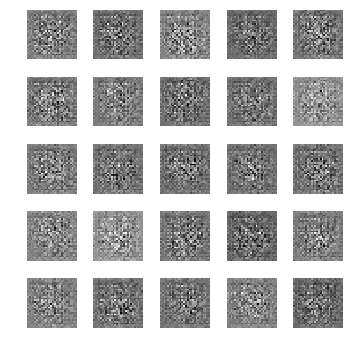

epoch: 1, time: 5.037717 | train_G_Loss: 0.368942, train_D_loss: 4.072649, train_acc: 0.101562
cv_G_Loss: 1.292434, cv_D_loss: 5.908274, cv_acc: 0.102800
Model saved

epoch: 2, time: 5.086814 | train_G_Loss: 0.597717, train_D_loss: 3.505599, train_acc: 0.111328
cv_G_Loss: 1.946424, cv_D_loss: 8.350479, cv_acc: 0.102800

epoch: 3, time: 4.996193 | train_G_Loss: 0.825497, train_D_loss: 3.244739, train_acc: 0.140625
cv_G_Loss: 2.707535, cv_D_loss: 11.230498, cv_acc: 0.102800

epoch: 4, time: 5.046940 | train_G_Loss: 1.047800, train_D_loss: 2.937657, train_acc: 0.113281
cv_G_Loss: 3.178027, cv_D_loss: 13.728926, cv_acc: 0.100900

epoch: 5, time: 4.981742 | train_G_Loss: 1.200408, train_D_loss: 2.991773, train_acc: 0.109375
cv_G_Loss: 3.190800, cv_D_loss: 15.318503, cv_acc: 0.100900

epoch: 6, time: 5.104877 | train_G_Loss: 1.650485, train_D_loss: 2.720243, train_acc: 0.105469
cv_G_Loss: 3.579325, cv_D_loss: 15.716872, cv_acc: 0.100900

epoch: 7, time: 5.089187 | train_G_Loss: 1.827150, tra

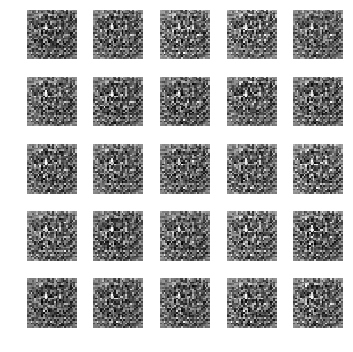

epoch: 11, time: 5.173581 | train_G_Loss: 2.334858, train_D_loss: 2.459008, train_acc: 0.189453
cv_G_Loss: 5.912007, cv_D_loss: 21.686068, cv_acc: 0.098200

epoch: 12, time: 5.201201 | train_G_Loss: 2.421969, train_D_loss: 2.608230, train_acc: 0.121094
cv_G_Loss: 5.821530, cv_D_loss: 22.399744, cv_acc: 0.098200

epoch: 13, time: 5.156482 | train_G_Loss: 2.529767, train_D_loss: 2.397247, train_acc: 0.107422
cv_G_Loss: 5.895455, cv_D_loss: 24.199322, cv_acc: 0.098200

epoch: 14, time: 5.128206 | train_G_Loss: 2.541498, train_D_loss: 2.538668, train_acc: 0.111328
cv_G_Loss: 6.023991, cv_D_loss: 25.555653, cv_acc: 0.095800

epoch: 15, time: 5.120521 | train_G_Loss: 2.718925, train_D_loss: 2.303018, train_acc: 0.119141
cv_G_Loss: 6.125520, cv_D_loss: 26.642105, cv_acc: 0.105100
Model saved

epoch: 16, time: 5.116304 | train_G_Loss: 2.878630, train_D_loss: 2.377992, train_acc: 0.125000
cv_G_Loss: 6.247248, cv_D_loss: 27.506855, cv_acc: 0.100900

epoch: 17, time: 5.156533 | train_G_Loss: 2.94

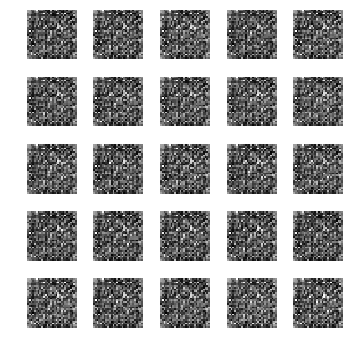

epoch: 21, time: 5.117235 | train_G_Loss: 3.287854, train_D_loss: 2.320018, train_acc: 0.091797
cv_G_Loss: 6.449034, cv_D_loss: 34.101295, cv_acc: 0.100900

epoch: 22, time: 5.100472 | train_G_Loss: 3.422475, train_D_loss: 2.295682, train_acc: 0.091797
cv_G_Loss: 6.401508, cv_D_loss: 35.127083, cv_acc: 0.100900

epoch: 23, time: 5.098794 | train_G_Loss: 3.362090, train_D_loss: 2.384390, train_acc: 0.130859
cv_G_Loss: 6.342018, cv_D_loss: 35.792591, cv_acc: 0.100900

epoch: 24, time: 5.078565 | train_G_Loss: 3.453273, train_D_loss: 2.365979, train_acc: 0.101562
cv_G_Loss: 6.482090, cv_D_loss: 38.506969, cv_acc: 0.100900

epoch: 25, time: 5.083565 | train_G_Loss: 3.309714, train_D_loss: 2.424855, train_acc: 0.111328
cv_G_Loss: 5.757716, cv_D_loss: 38.091995, cv_acc: 0.100900

epoch: 26, time: 5.108567 | train_G_Loss: 3.032892, train_D_loss: 2.357767, train_acc: 0.126953
cv_G_Loss: 4.756725, cv_D_loss: 35.057194, cv_acc: 0.100900

epoch: 27, time: 5.087008 | train_G_Loss: 2.949069, train_

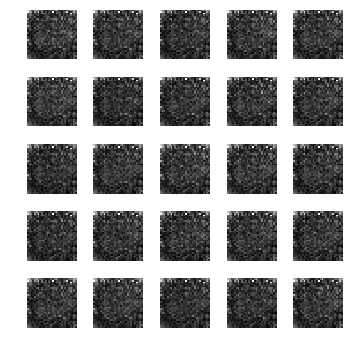

epoch: 31, time: 5.079082 | train_G_Loss: 2.543870, train_D_loss: 2.408280, train_acc: 0.138672
cv_G_Loss: 3.071690, cv_D_loss: 26.902283, cv_acc: 0.100900

epoch: 32, time: 5.118553 | train_G_Loss: 2.392318, train_D_loss: 2.395388, train_acc: 0.115234
cv_G_Loss: 2.681577, cv_D_loss: 27.559860, cv_acc: 0.100900

epoch: 33, time: 5.088470 | train_G_Loss: 2.309401, train_D_loss: 2.475651, train_acc: 0.103516
cv_G_Loss: 2.476249, cv_D_loss: 25.864208, cv_acc: 0.100900

epoch: 34, time: 5.101331 | train_G_Loss: 2.021448, train_D_loss: 2.557278, train_acc: 0.136719
cv_G_Loss: 2.086866, cv_D_loss: 22.972410, cv_acc: 0.100900

epoch: 35, time: 5.082577 | train_G_Loss: 2.027046, train_D_loss: 2.649593, train_acc: 0.144531
cv_G_Loss: 1.800335, cv_D_loss: 23.680374, cv_acc: 0.100900

epoch: 36, time: 5.094118 | train_G_Loss: 1.902113, train_D_loss: 2.663121, train_acc: 0.105469
cv_G_Loss: 1.670022, cv_D_loss: 22.318502, cv_acc: 0.100900

epoch: 37, time: 5.096018 | train_G_Loss: 1.864500, train_

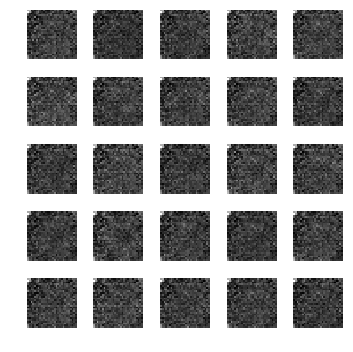

epoch: 41, time: 5.083854 | train_G_Loss: 1.267246, train_D_loss: 2.869774, train_acc: 0.158203
cv_G_Loss: 1.467515, cv_D_loss: 17.181768, cv_acc: 0.100900

epoch: 42, time: 4.998584 | train_G_Loss: 1.186300, train_D_loss: 2.989202, train_acc: 0.136719
cv_G_Loss: 1.559493, cv_D_loss: 17.022860, cv_acc: 0.103600

epoch: 43, time: 4.990165 | train_G_Loss: 1.128003, train_D_loss: 3.016481, train_acc: 0.173828
cv_G_Loss: 1.328201, cv_D_loss: 15.899114, cv_acc: 0.108400
Model saved

epoch: 44, time: 4.974658 | train_G_Loss: 0.999061, train_D_loss: 3.076643, train_acc: 0.173828
cv_G_Loss: 1.363159, cv_D_loss: 14.228251, cv_acc: 0.145400
Model saved

epoch: 45, time: 4.981938 | train_G_Loss: 0.932349, train_D_loss: 3.180365, train_acc: 0.109375
cv_G_Loss: 1.236163, cv_D_loss: 14.872309, cv_acc: 0.097400

epoch: 46, time: 4.957851 | train_G_Loss: 0.803896, train_D_loss: 3.332755, train_acc: 0.125000
cv_G_Loss: 1.063882, cv_D_loss: 14.544785, cv_acc: 0.098000

epoch: 47, time: 4.944998 | train_

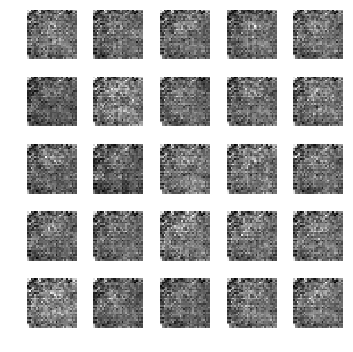

epoch: 51, time: 4.977825 | train_G_Loss: 0.589897, train_D_loss: 3.462155, train_acc: 0.119141
cv_G_Loss: 0.571046, cv_D_loss: 9.331707, cv_acc: 0.100900

epoch: 52, time: 4.962629 | train_G_Loss: 0.673447, train_D_loss: 3.534453, train_acc: 0.183594
cv_G_Loss: 0.914433, cv_D_loss: 11.317247, cv_acc: 0.143100

epoch: 53, time: 4.947788 | train_G_Loss: 0.674744, train_D_loss: 3.706101, train_acc: 0.140625
cv_G_Loss: 1.116631, cv_D_loss: 11.523393, cv_acc: 0.131900

epoch: 54, time: 4.950201 | train_G_Loss: 0.606445, train_D_loss: 3.719521, train_acc: 0.076172
cv_G_Loss: 0.580642, cv_D_loss: 8.020660, cv_acc: 0.114200

epoch: 55, time: 4.957433 | train_G_Loss: 0.600984, train_D_loss: 3.702985, train_acc: 0.218750
cv_G_Loss: 0.430086, cv_D_loss: 7.798905, cv_acc: 0.213200
Model saved

epoch: 56, time: 4.965911 | train_G_Loss: 0.541545, train_D_loss: 3.760892, train_acc: 0.207031
cv_G_Loss: 0.350428, cv_D_loss: 8.993317, cv_acc: 0.097400

epoch: 57, time: 4.946831 | train_G_Loss: 0.501192

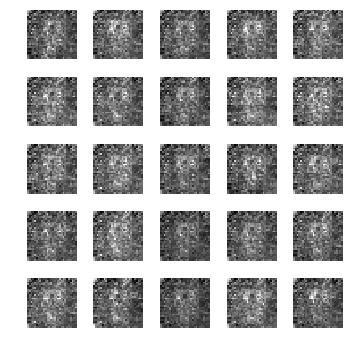

epoch: 61, time: 4.965693 | train_G_Loss: 0.502806, train_D_loss: 3.769125, train_acc: 0.197266
cv_G_Loss: 0.420268, cv_D_loss: 7.085355, cv_acc: 0.130200

epoch: 62, time: 4.940660 | train_G_Loss: 0.517017, train_D_loss: 3.970217, train_acc: 0.189453
cv_G_Loss: 0.701610, cv_D_loss: 5.517302, cv_acc: 0.205800

epoch: 63, time: 4.947599 | train_G_Loss: 0.497724, train_D_loss: 3.890886, train_acc: 0.164062
cv_G_Loss: 0.668332, cv_D_loss: 7.286940, cv_acc: 0.097400

epoch: 64, time: 4.972654 | train_G_Loss: 0.493704, train_D_loss: 4.092052, train_acc: 0.119141
cv_G_Loss: 0.246715, cv_D_loss: 5.313661, cv_acc: 0.113500

epoch: 65, time: 5.004219 | train_G_Loss: 0.562879, train_D_loss: 3.934344, train_acc: 0.109375
cv_G_Loss: 1.220013, cv_D_loss: 7.595597, cv_acc: 0.187200

epoch: 66, time: 4.951632 | train_G_Loss: 0.470629, train_D_loss: 3.916492, train_acc: 0.240234
cv_G_Loss: 0.767793, cv_D_loss: 6.529394, cv_acc: 0.269900

epoch: 67, time: 4.942813 | train_G_Loss: 0.416516, train_D_loss

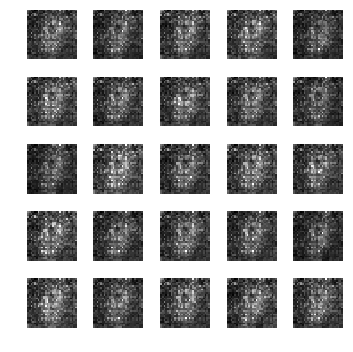

epoch: 71, time: 4.975376 | train_G_Loss: 0.480607, train_D_loss: 3.965077, train_acc: 0.107422
cv_G_Loss: 0.364962, cv_D_loss: 5.220184, cv_acc: 0.101000

epoch: 72, time: 4.933874 | train_G_Loss: 0.487286, train_D_loss: 3.837554, train_acc: 0.146484
cv_G_Loss: 0.460105, cv_D_loss: 4.886840, cv_acc: 0.113900

epoch: 73, time: 4.962643 | train_G_Loss: 0.452530, train_D_loss: 3.943161, train_acc: 0.099609
cv_G_Loss: 0.688432, cv_D_loss: 5.866894, cv_acc: 0.103800

epoch: 74, time: 4.950334 | train_G_Loss: 0.457798, train_D_loss: 4.030421, train_acc: 0.195312
cv_G_Loss: 0.355188, cv_D_loss: 5.033061, cv_acc: 0.125500

epoch: 75, time: 5.838789 | train_G_Loss: 0.486637, train_D_loss: 3.842718, train_acc: 0.123047
cv_G_Loss: 0.388695, cv_D_loss: 4.764763, cv_acc: 0.113500

epoch: 76, time: 4.943986 | train_G_Loss: 0.470749, train_D_loss: 3.851902, train_acc: 0.292969
cv_G_Loss: 0.440211, cv_D_loss: 4.737524, cv_acc: 0.273700

epoch: 77, time: 4.940299 | train_G_Loss: 0.390505, train_D_loss

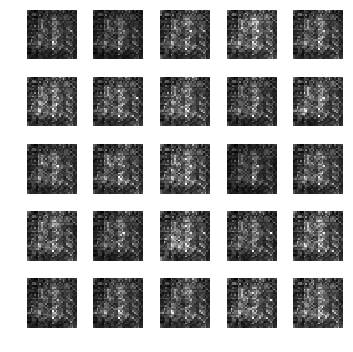

epoch: 81, time: 4.958343 | train_G_Loss: 0.460643, train_D_loss: 4.048328, train_acc: 0.343750
cv_G_Loss: 1.377035, cv_D_loss: 5.938252, cv_acc: 0.120700

epoch: 82, time: 4.921862 | train_G_Loss: 0.427378, train_D_loss: 4.147115, train_acc: 0.296875
cv_G_Loss: 0.434720, cv_D_loss: 4.712564, cv_acc: 0.247800

epoch: 83, time: 4.936758 | train_G_Loss: 0.460951, train_D_loss: 3.872563, train_acc: 0.126953
cv_G_Loss: 0.310333, cv_D_loss: 4.506371, cv_acc: 0.128200

epoch: 84, time: 5.016611 | train_G_Loss: 0.428019, train_D_loss: 4.135356, train_acc: 0.375000
cv_G_Loss: 0.471935, cv_D_loss: 4.718076, cv_acc: 0.187100

epoch: 85, time: 4.929991 | train_G_Loss: 0.406953, train_D_loss: 4.006708, train_acc: 0.111328
cv_G_Loss: 0.295583, cv_D_loss: 4.609761, cv_acc: 0.103000

epoch: 86, time: 4.934739 | train_G_Loss: 0.424640, train_D_loss: 4.142190, train_acc: 0.154297
cv_G_Loss: 0.459097, cv_D_loss: 4.602115, cv_acc: 0.112200

epoch: 87, time: 4.923196 | train_G_Loss: 0.400319, train_D_loss

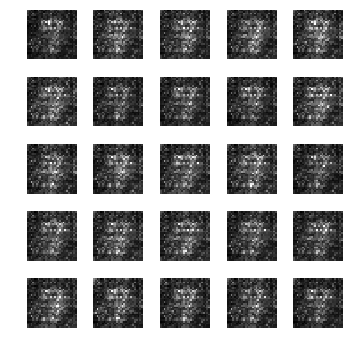

epoch: 91, time: 4.952631 | train_G_Loss: 0.367772, train_D_loss: 4.088571, train_acc: 0.253906
cv_G_Loss: 0.109225, cv_D_loss: 4.950105, cv_acc: 0.204200

epoch: 92, time: 4.931675 | train_G_Loss: 0.464369, train_D_loss: 4.090353, train_acc: 0.203125
cv_G_Loss: 0.603629, cv_D_loss: 4.761581, cv_acc: 0.202700

epoch: 93, time: 4.926441 | train_G_Loss: 0.440570, train_D_loss: 4.106011, train_acc: 0.101562
cv_G_Loss: 0.582661, cv_D_loss: 4.748247, cv_acc: 0.206300

epoch: 94, time: 4.928838 | train_G_Loss: 0.456645, train_D_loss: 3.896262, train_acc: 0.357422
cv_G_Loss: 0.751603, cv_D_loss: 4.941096, cv_acc: 0.224000

epoch: 95, time: 4.925368 | train_G_Loss: 0.418658, train_D_loss: 4.105782, train_acc: 0.216797
cv_G_Loss: 0.249650, cv_D_loss: 4.229153, cv_acc: 0.237500

epoch: 96, time: 4.935949 | train_G_Loss: 0.399708, train_D_loss: 4.173340, train_acc: 0.185547
cv_G_Loss: 0.184828, cv_D_loss: 4.477952, cv_acc: 0.177500

epoch: 97, time: 4.925227 | train_G_Loss: 0.412691, train_D_loss

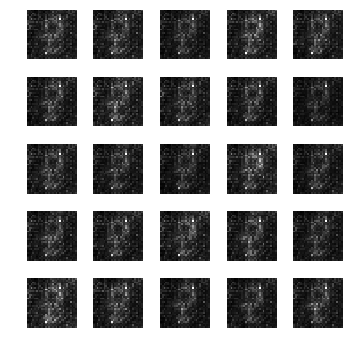

epoch: 101, time: 4.950958 | train_G_Loss: 0.395520, train_D_loss: 4.136555, train_acc: 0.326172
cv_G_Loss: 0.582248, cv_D_loss: 4.491813, cv_acc: 0.345400
Model saved

epoch: 102, time: 4.962982 | train_G_Loss: 0.421031, train_D_loss: 4.018302, train_acc: 0.314453
cv_G_Loss: 0.523956, cv_D_loss: 4.589131, cv_acc: 0.245400

epoch: 103, time: 4.898162 | train_G_Loss: 0.407796, train_D_loss: 4.109459, train_acc: 0.314453
cv_G_Loss: 0.254869, cv_D_loss: 4.302300, cv_acc: 0.283300

epoch: 104, time: 4.915405 | train_G_Loss: 0.445852, train_D_loss: 4.052727, train_acc: 0.324219
cv_G_Loss: 0.295366, cv_D_loss: 4.311159, cv_acc: 0.244800

epoch: 105, time: 4.916320 | train_G_Loss: 0.418645, train_D_loss: 4.163763, train_acc: 0.359375
cv_G_Loss: 0.485681, cv_D_loss: 4.397453, cv_acc: 0.231700

epoch: 106, time: 4.911292 | train_G_Loss: 0.419961, train_D_loss: 3.910186, train_acc: 0.386719
cv_G_Loss: 0.139658, cv_D_loss: 4.608387, cv_acc: 0.339900

epoch: 107, time: 4.915583 | train_G_Loss: 0.4

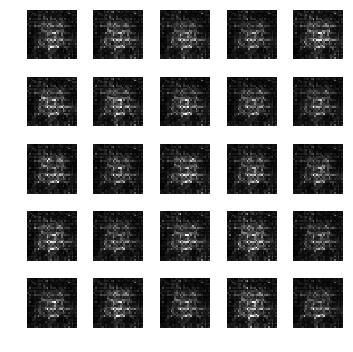

epoch: 111, time: 4.947710 | train_G_Loss: 0.449902, train_D_loss: 4.100618, train_acc: 0.332031
cv_G_Loss: 0.309340, cv_D_loss: 4.221226, cv_acc: 0.368300
Model saved

epoch: 112, time: 4.938814 | train_G_Loss: 0.400967, train_D_loss: 3.854002, train_acc: 0.320312
cv_G_Loss: 0.387120, cv_D_loss: 4.299942, cv_acc: 0.343000

epoch: 113, time: 4.911572 | train_G_Loss: 0.436194, train_D_loss: 3.917823, train_acc: 0.447266
cv_G_Loss: 1.515624, cv_D_loss: 5.592752, cv_acc: 0.430300
Model saved

epoch: 114, time: 4.942111 | train_G_Loss: 0.431999, train_D_loss: 3.933939, train_acc: 0.296875
cv_G_Loss: 0.350801, cv_D_loss: 4.304733, cv_acc: 0.343200

epoch: 115, time: 4.923524 | train_G_Loss: 0.401906, train_D_loss: 3.847425, train_acc: 0.306641
cv_G_Loss: 0.419266, cv_D_loss: 4.203897, cv_acc: 0.346500

epoch: 116, time: 4.924842 | train_G_Loss: 0.459074, train_D_loss: 4.107013, train_acc: 0.310547
cv_G_Loss: 0.480925, cv_D_loss: 4.196150, cv_acc: 0.185800

epoch: 117, time: 4.939431 | train

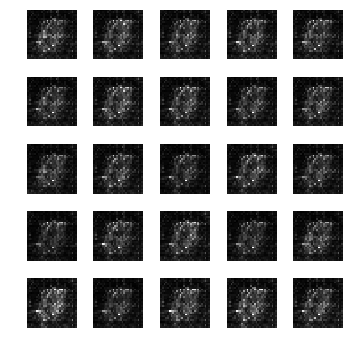

epoch: 121, time: 4.953304 | train_G_Loss: 0.397061, train_D_loss: 4.012808, train_acc: 0.414062
cv_G_Loss: 0.249038, cv_D_loss: 4.239021, cv_acc: 0.255400

epoch: 122, time: 4.923052 | train_G_Loss: 0.414372, train_D_loss: 3.886229, train_acc: 0.261719
cv_G_Loss: 0.279534, cv_D_loss: 4.194066, cv_acc: 0.133000

epoch: 123, time: 4.918535 | train_G_Loss: 0.400950, train_D_loss: 4.046063, train_acc: 0.386719
cv_G_Loss: 0.646091, cv_D_loss: 4.277864, cv_acc: 0.330300

epoch: 124, time: 4.945212 | train_G_Loss: 0.393460, train_D_loss: 3.972507, train_acc: 0.380859
cv_G_Loss: 0.670122, cv_D_loss: 4.154280, cv_acc: 0.264500

epoch: 125, time: 4.924788 | train_G_Loss: 0.482786, train_D_loss: 3.984497, train_acc: 0.390625
cv_G_Loss: 0.853660, cv_D_loss: 4.474347, cv_acc: 0.416100

epoch: 126, time: 4.919132 | train_G_Loss: 0.386161, train_D_loss: 4.036151, train_acc: 0.412109
cv_G_Loss: 0.813142, cv_D_loss: 4.421847, cv_acc: 0.315100

epoch: 127, time: 4.921505 | train_G_Loss: 0.414635, train

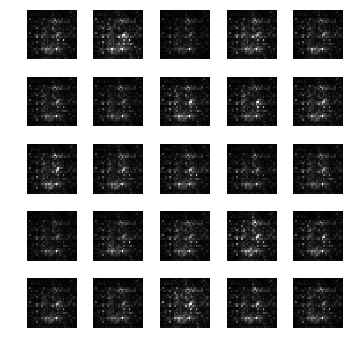

epoch: 131, time: 4.953358 | train_G_Loss: 0.436404, train_D_loss: 4.067619, train_acc: 0.406250
cv_G_Loss: 0.350968, cv_D_loss: 4.161820, cv_acc: 0.383400

epoch: 132, time: 4.907109 | train_G_Loss: 0.466314, train_D_loss: 3.912582, train_acc: 0.396484
cv_G_Loss: 0.276396, cv_D_loss: 4.046059, cv_acc: 0.371500

epoch: 133, time: 4.926483 | train_G_Loss: 0.394625, train_D_loss: 4.126474, train_acc: 0.468750
cv_G_Loss: 0.268489, cv_D_loss: 4.126472, cv_acc: 0.275600

epoch: 134, time: 4.916765 | train_G_Loss: 0.456926, train_D_loss: 3.752110, train_acc: 0.388672
cv_G_Loss: 0.259863, cv_D_loss: 4.114491, cv_acc: 0.302900

epoch: 135, time: 4.910917 | train_G_Loss: 0.427654, train_D_loss: 4.017200, train_acc: 0.490234
cv_G_Loss: 0.470590, cv_D_loss: 3.962147, cv_acc: 0.527500
Model saved

epoch: 136, time: 4.935644 | train_G_Loss: 0.412648, train_D_loss: 3.955299, train_acc: 0.466797
cv_G_Loss: 0.289076, cv_D_loss: 4.001860, cv_acc: 0.378500

epoch: 137, time: 4.924709 | train_G_Loss: 0.5

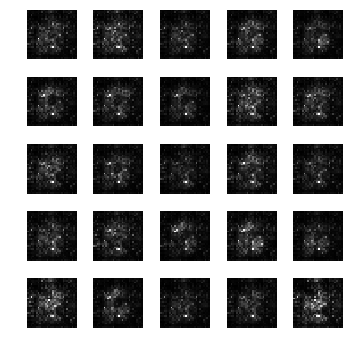

epoch: 141, time: 4.948010 | train_G_Loss: 0.451629, train_D_loss: 3.940642, train_acc: 0.443359
cv_G_Loss: 0.519870, cv_D_loss: 4.000978, cv_acc: 0.390600

epoch: 142, time: 4.930272 | train_G_Loss: 0.415664, train_D_loss: 3.806077, train_acc: 0.398438
cv_G_Loss: 0.530407, cv_D_loss: 3.938127, cv_acc: 0.408400

epoch: 143, time: 4.925699 | train_G_Loss: 0.404963, train_D_loss: 3.871886, train_acc: 0.554688
cv_G_Loss: 0.492568, cv_D_loss: 3.877750, cv_acc: 0.355800

epoch: 144, time: 4.928100 | train_G_Loss: 0.370572, train_D_loss: 3.903984, train_acc: 0.632812
cv_G_Loss: 0.166155, cv_D_loss: 4.209937, cv_acc: 0.435600

epoch: 145, time: 4.918223 | train_G_Loss: 0.407565, train_D_loss: 3.916062, train_acc: 0.550781
cv_G_Loss: 0.715168, cv_D_loss: 4.003009, cv_acc: 0.473500

epoch: 146, time: 4.915032 | train_G_Loss: 0.381172, train_D_loss: 3.963598, train_acc: 0.574219
cv_G_Loss: 0.273424, cv_D_loss: 3.914464, cv_acc: 0.483300

epoch: 147, time: 4.918441 | train_G_Loss: 0.403018, train

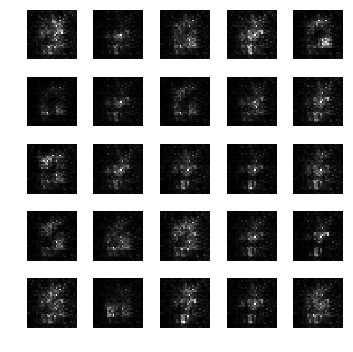

epoch: 151, time: 4.936580 | train_G_Loss: 0.474954, train_D_loss: 4.052466, train_acc: 0.402344
cv_G_Loss: 0.636987, cv_D_loss: 4.039896, cv_acc: 0.459200

epoch: 152, time: 4.922189 | train_G_Loss: 0.424588, train_D_loss: 3.511868, train_acc: 0.568359
cv_G_Loss: 0.367459, cv_D_loss: 3.841127, cv_acc: 0.534100

epoch: 153, time: 4.923415 | train_G_Loss: 0.382009, train_D_loss: 3.653245, train_acc: 0.494141
cv_G_Loss: 0.441858, cv_D_loss: 3.896810, cv_acc: 0.366100

epoch: 154, time: 4.919700 | train_G_Loss: 0.425105, train_D_loss: 3.995070, train_acc: 0.585938
cv_G_Loss: 0.674384, cv_D_loss: 3.986042, cv_acc: 0.569500

epoch: 155, time: 4.916024 | train_G_Loss: 0.362884, train_D_loss: 3.620687, train_acc: 0.621094
cv_G_Loss: 0.201668, cv_D_loss: 4.103915, cv_acc: 0.395200

epoch: 156, time: 4.929789 | train_G_Loss: 0.436130, train_D_loss: 3.627849, train_acc: 0.599609
cv_G_Loss: 0.198206, cv_D_loss: 4.018109, cv_acc: 0.557600

epoch: 157, time: 4.908236 | train_G_Loss: 0.466512, train

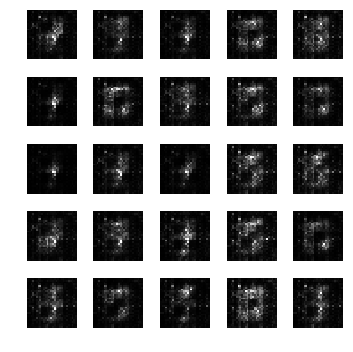

epoch: 161, time: 4.953959 | train_G_Loss: 0.461062, train_D_loss: 3.476191, train_acc: 0.525391
cv_G_Loss: 0.811748, cv_D_loss: 4.174030, cv_acc: 0.430300

epoch: 162, time: 4.930957 | train_G_Loss: 0.463801, train_D_loss: 3.973906, train_acc: 0.617188
cv_G_Loss: 0.261879, cv_D_loss: 3.920968, cv_acc: 0.474200

epoch: 163, time: 4.928693 | train_G_Loss: 0.446344, train_D_loss: 3.763097, train_acc: 0.599609
cv_G_Loss: 0.828305, cv_D_loss: 4.149993, cv_acc: 0.572000

epoch: 164, time: 4.918762 | train_G_Loss: 0.381186, train_D_loss: 3.539054, train_acc: 0.572266
cv_G_Loss: 0.215949, cv_D_loss: 4.022907, cv_acc: 0.326400

epoch: 165, time: 4.935211 | train_G_Loss: 0.477909, train_D_loss: 3.758710, train_acc: 0.648438
cv_G_Loss: 0.401088, cv_D_loss: 3.667486, cv_acc: 0.675700
Model saved

epoch: 166, time: 4.933146 | train_G_Loss: 0.389445, train_D_loss: 3.299874, train_acc: 0.603516
cv_G_Loss: 0.562796, cv_D_loss: 4.015584, cv_acc: 0.389300

epoch: 167, time: 4.910931 | train_G_Loss: 0.4

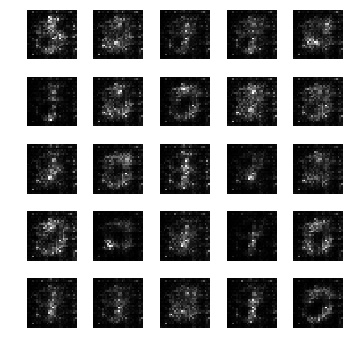

epoch: 171, time: 4.950887 | train_G_Loss: 0.411229, train_D_loss: 3.528049, train_acc: 0.656250
cv_G_Loss: 0.249114, cv_D_loss: 3.750422, cv_acc: 0.619600

epoch: 172, time: 4.909938 | train_G_Loss: 0.417040, train_D_loss: 3.136785, train_acc: 0.617188
cv_G_Loss: 0.372494, cv_D_loss: 3.781004, cv_acc: 0.562100

epoch: 173, time: 4.914198 | train_G_Loss: 0.413609, train_D_loss: 3.402924, train_acc: 0.664062
cv_G_Loss: 0.570409, cv_D_loss: 3.619807, cv_acc: 0.634500

epoch: 174, time: 4.913442 | train_G_Loss: 0.451174, train_D_loss: 3.486035, train_acc: 0.652344
cv_G_Loss: 0.382669, cv_D_loss: 3.928148, cv_acc: 0.255800

epoch: 175, time: 4.929019 | train_G_Loss: 0.370323, train_D_loss: 3.610330, train_acc: 0.710938
cv_G_Loss: 0.198948, cv_D_loss: 3.881843, cv_acc: 0.502300

epoch: 176, time: 4.920018 | train_G_Loss: 0.415190, train_D_loss: 3.248374, train_acc: 0.701172
cv_G_Loss: 0.887933, cv_D_loss: 4.064620, cv_acc: 0.569700

epoch: 177, time: 4.921667 | train_G_Loss: 0.441575, train

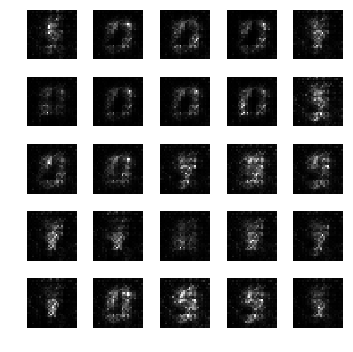

epoch: 181, time: 4.943151 | train_G_Loss: 0.382782, train_D_loss: 3.145188, train_acc: 0.712891
cv_G_Loss: 0.216739, cv_D_loss: 3.783532, cv_acc: 0.548200

epoch: 182, time: 4.920248 | train_G_Loss: 0.401377, train_D_loss: 3.535745, train_acc: 0.779297
cv_G_Loss: 0.433376, cv_D_loss: 3.597095, cv_acc: 0.636700

epoch: 183, time: 4.918367 | train_G_Loss: 0.489432, train_D_loss: 2.998398, train_acc: 0.763672
cv_G_Loss: 0.980956, cv_D_loss: 4.142613, cv_acc: 0.679300
Model saved

epoch: 184, time: 4.947525 | train_G_Loss: 0.437551, train_D_loss: 2.999132, train_acc: 0.751953
cv_G_Loss: 0.443350, cv_D_loss: 3.462884, cv_acc: 0.669000

epoch: 185, time: 4.912944 | train_G_Loss: 0.429576, train_D_loss: 3.254286, train_acc: 0.701172
cv_G_Loss: 0.191113, cv_D_loss: 3.765937, cv_acc: 0.550800

epoch: 186, time: 4.918792 | train_G_Loss: 0.407581, train_D_loss: 3.008151, train_acc: 0.660156
cv_G_Loss: 0.298580, cv_D_loss: 3.790667, cv_acc: 0.327700

epoch: 187, time: 4.909199 | train_G_Loss: 0.4

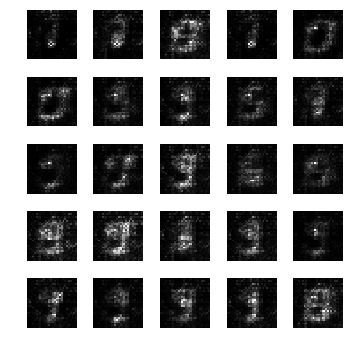

epoch: 191, time: 4.955526 | train_G_Loss: 0.397937, train_D_loss: 3.317868, train_acc: 0.798828
cv_G_Loss: 0.847827, cv_D_loss: 3.566615, cv_acc: 0.742800
Model saved

epoch: 192, time: 4.952127 | train_G_Loss: 0.399280, train_D_loss: 3.090419, train_acc: 0.720703
cv_G_Loss: 0.120906, cv_D_loss: 3.967824, cv_acc: 0.623600

epoch: 193, time: 4.904637 | train_G_Loss: 0.457694, train_D_loss: 3.325413, train_acc: 0.701172
cv_G_Loss: 0.364350, cv_D_loss: 3.374415, cv_acc: 0.643400

epoch: 194, time: 4.918194 | train_G_Loss: 0.401550, train_D_loss: 3.368288, train_acc: 0.673828
cv_G_Loss: 1.260976, cv_D_loss: 4.161667, cv_acc: 0.637700

epoch: 195, time: 4.919345 | train_G_Loss: 0.435817, train_D_loss: 3.531389, train_acc: 0.716797
cv_G_Loss: 0.608113, cv_D_loss: 3.375356, cv_acc: 0.740600

epoch: 196, time: 4.909225 | train_G_Loss: 0.458456, train_D_loss: 3.468198, train_acc: 0.701172
cv_G_Loss: 0.298593, cv_D_loss: 3.420903, cv_acc: 0.666400

epoch: 197, time: 4.908823 | train_G_Loss: 0.4

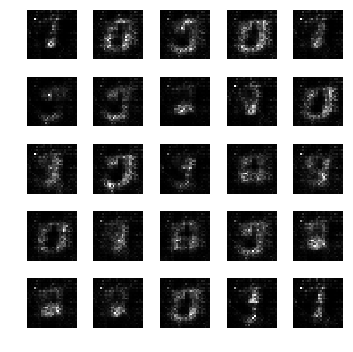

epoch: 201, time: 4.936045 | train_G_Loss: 0.498992, train_D_loss: 2.711892, train_acc: 0.748047
cv_G_Loss: 0.124075, cv_D_loss: 3.792302, cv_acc: 0.642400

epoch: 202, time: 4.921419 | train_G_Loss: 0.363147, train_D_loss: 3.054741, train_acc: 0.744141
cv_G_Loss: 0.099582, cv_D_loss: 4.610626, cv_acc: 0.237200

epoch: 203, time: 4.910270 | train_G_Loss: 0.459456, train_D_loss: 3.276509, train_acc: 0.716797
cv_G_Loss: 1.626909, cv_D_loss: 4.834373, cv_acc: 0.485300

epoch: 204, time: 4.909307 | train_G_Loss: 0.389534, train_D_loss: 2.915819, train_acc: 0.781250
cv_G_Loss: 0.491901, cv_D_loss: 3.134583, cv_acc: 0.691900

epoch: 205, time: 4.915485 | train_G_Loss: 0.482739, train_D_loss: 2.992258, train_acc: 0.773438
cv_G_Loss: 0.898171, cv_D_loss: 3.556854, cv_acc: 0.657700

epoch: 206, time: 4.924861 | train_G_Loss: 0.393143, train_D_loss: 3.146027, train_acc: 0.724609
cv_G_Loss: 0.394304, cv_D_loss: 3.307254, cv_acc: 0.556500

epoch: 207, time: 4.918935 | train_G_Loss: 0.399832, train

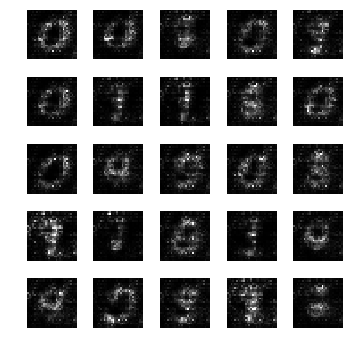

epoch: 211, time: 4.950561 | train_G_Loss: 0.371569, train_D_loss: 2.937274, train_acc: 0.691406
cv_G_Loss: 0.610066, cv_D_loss: 3.115312, cv_acc: 0.744400
Model saved

epoch: 212, time: 4.948191 | train_G_Loss: 0.411704, train_D_loss: 3.144002, train_acc: 0.681641
cv_G_Loss: 0.610552, cv_D_loss: 3.263954, cv_acc: 0.650300

epoch: 213, time: 4.912217 | train_G_Loss: 0.334490, train_D_loss: 3.683314, train_acc: 0.679688
cv_G_Loss: 0.451667, cv_D_loss: 3.100407, cv_acc: 0.739000

epoch: 214, time: 4.914950 | train_G_Loss: 0.382837, train_D_loss: 3.230213, train_acc: 0.726562
cv_G_Loss: 1.369845, cv_D_loss: 4.235627, cv_acc: 0.679800

epoch: 215, time: 4.908399 | train_G_Loss: 0.498088, train_D_loss: 3.006929, train_acc: 0.783203
cv_G_Loss: 0.643758, cv_D_loss: 3.208929, cv_acc: 0.714600

epoch: 216, time: 4.907295 | train_G_Loss: 0.474142, train_D_loss: 3.347179, train_acc: 0.726562
cv_G_Loss: 0.811549, cv_D_loss: 3.358374, cv_acc: 0.740200

epoch: 217, time: 4.909375 | train_G_Loss: 0.4

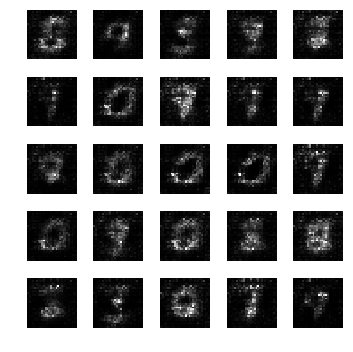

epoch: 221, time: 4.943806 | train_G_Loss: 0.442286, train_D_loss: 2.846837, train_acc: 0.779297
cv_G_Loss: 1.142104, cv_D_loss: 4.007531, cv_acc: 0.699400

epoch: 222, time: 4.929717 | train_G_Loss: 0.377272, train_D_loss: 3.084394, train_acc: 0.736328
cv_G_Loss: 0.278842, cv_D_loss: 3.130291, cv_acc: 0.700300

epoch: 223, time: 4.910489 | train_G_Loss: 0.347699, train_D_loss: 3.499022, train_acc: 0.710938
cv_G_Loss: 0.400523, cv_D_loss: 3.176447, cv_acc: 0.598200

epoch: 224, time: 4.910441 | train_G_Loss: 0.406798, train_D_loss: 2.863347, train_acc: 0.781250
cv_G_Loss: 0.563086, cv_D_loss: 3.047399, cv_acc: 0.744300

epoch: 225, time: 4.924397 | train_G_Loss: 0.391463, train_D_loss: 3.094227, train_acc: 0.785156
cv_G_Loss: 0.929840, cv_D_loss: 3.574037, cv_acc: 0.561900

epoch: 226, time: 4.929404 | train_G_Loss: 0.403988, train_D_loss: 3.194291, train_acc: 0.703125
cv_G_Loss: 0.365938, cv_D_loss: 3.182252, cv_acc: 0.716800

epoch: 227, time: 4.927723 | train_G_Loss: 0.304798, train

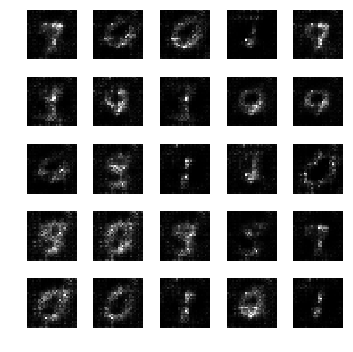

epoch: 231, time: 4.953493 | train_G_Loss: 0.454055, train_D_loss: 2.310036, train_acc: 0.835938
cv_G_Loss: 1.226421, cv_D_loss: 3.758161, cv_acc: 0.780400
Model saved

epoch: 232, time: 4.948147 | train_G_Loss: 0.431023, train_D_loss: 3.498756, train_acc: 0.814453
cv_G_Loss: 0.432231, cv_D_loss: 3.117697, cv_acc: 0.634200

epoch: 233, time: 4.924928 | train_G_Loss: 0.381360, train_D_loss: 2.926710, train_acc: 0.763672
cv_G_Loss: 0.575441, cv_D_loss: 3.065965, cv_acc: 0.769200

epoch: 234, time: 4.966478 | train_G_Loss: 0.489425, train_D_loss: 2.705135, train_acc: 0.773438
cv_G_Loss: 0.459186, cv_D_loss: 3.230972, cv_acc: 0.612900

epoch: 235, time: 4.903476 | train_G_Loss: 0.392242, train_D_loss: 2.781907, train_acc: 0.777344
cv_G_Loss: 0.414138, cv_D_loss: 3.049097, cv_acc: 0.692300

epoch: 236, time: 4.909487 | train_G_Loss: 0.444872, train_D_loss: 3.950009, train_acc: 0.740234
cv_G_Loss: 0.812949, cv_D_loss: 3.289127, cv_acc: 0.711400

epoch: 237, time: 4.932850 | train_G_Loss: 0.3

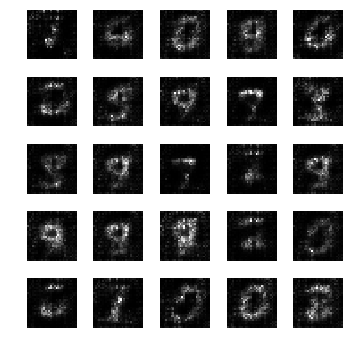

epoch: 241, time: 4.948774 | train_G_Loss: 0.394909, train_D_loss: 2.670355, train_acc: 0.792969
cv_G_Loss: 0.316344, cv_D_loss: 3.082122, cv_acc: 0.695500

epoch: 242, time: 4.933841 | train_G_Loss: 0.377561, train_D_loss: 3.136980, train_acc: 0.802734
cv_G_Loss: 1.368452, cv_D_loss: 3.947047, cv_acc: 0.748800

epoch: 243, time: 4.914340 | train_G_Loss: 0.326832, train_D_loss: 2.938066, train_acc: 0.849609
cv_G_Loss: 1.070168, cv_D_loss: 3.545508, cv_acc: 0.790500
Model saved

epoch: 244, time: 4.950200 | train_G_Loss: 0.416214, train_D_loss: 2.483589, train_acc: 0.767578
cv_G_Loss: 0.344485, cv_D_loss: 3.184221, cv_acc: 0.667700

epoch: 245, time: 4.927801 | train_G_Loss: 0.401232, train_D_loss: 3.053535, train_acc: 0.718750
cv_G_Loss: 0.702954, cv_D_loss: 2.985844, cv_acc: 0.770200

epoch: 246, time: 4.907649 | train_G_Loss: 0.385792, train_D_loss: 2.871690, train_acc: 0.753906
cv_G_Loss: 0.736994, cv_D_loss: 2.888693, cv_acc: 0.764400

epoch: 247, time: 4.911029 | train_G_Loss: 0.4

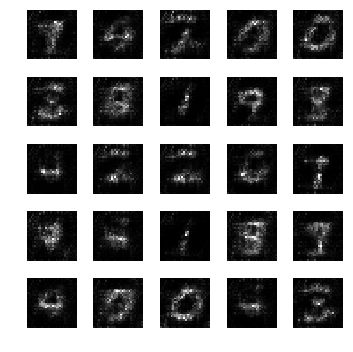

epoch: 251, time: 4.947586 | train_G_Loss: 0.399436, train_D_loss: 2.970692, train_acc: 0.755859
cv_G_Loss: 0.274676, cv_D_loss: 3.265688, cv_acc: 0.638200

epoch: 252, time: 4.919245 | train_G_Loss: 0.399586, train_D_loss: 2.486716, train_acc: 0.722656
cv_G_Loss: 0.607143, cv_D_loss: 3.519862, cv_acc: 0.579900

epoch: 253, time: 4.913053 | train_G_Loss: 0.412173, train_D_loss: 2.974982, train_acc: 0.751953
cv_G_Loss: 0.655342, cv_D_loss: 3.004077, cv_acc: 0.782100

epoch: 254, time: 4.922255 | train_G_Loss: 0.435777, train_D_loss: 3.486300, train_acc: 0.796875
cv_G_Loss: 0.768984, cv_D_loss: 3.397223, cv_acc: 0.698300

epoch: 255, time: 4.921627 | train_G_Loss: 0.437973, train_D_loss: 2.308331, train_acc: 0.798828
cv_G_Loss: 1.096501, cv_D_loss: 3.572848, cv_acc: 0.755700

epoch: 256, time: 4.926858 | train_G_Loss: 0.368864, train_D_loss: 2.775999, train_acc: 0.824219
cv_G_Loss: 0.360680, cv_D_loss: 2.981912, cv_acc: 0.741300

epoch: 257, time: 4.896319 | train_G_Loss: 0.376634, train

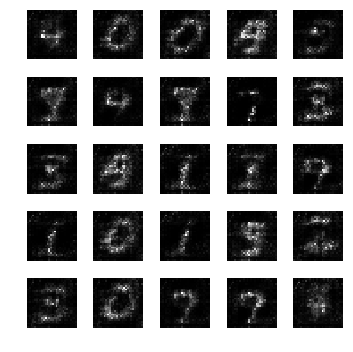

epoch: 261, time: 4.951821 | train_G_Loss: 0.393135, train_D_loss: 3.041634, train_acc: 0.755859
cv_G_Loss: 0.356541, cv_D_loss: 3.308707, cv_acc: 0.576200

epoch: 262, time: 4.920613 | train_G_Loss: 0.314741, train_D_loss: 3.117942, train_acc: 0.773438
cv_G_Loss: 0.347346, cv_D_loss: 2.959781, cv_acc: 0.760100

epoch: 263, time: 4.936456 | train_G_Loss: 0.351436, train_D_loss: 3.271849, train_acc: 0.816406
cv_G_Loss: 0.476264, cv_D_loss: 2.809590, cv_acc: 0.776500

epoch: 264, time: 4.925729 | train_G_Loss: 0.364653, train_D_loss: 2.800578, train_acc: 0.804688
cv_G_Loss: 0.259234, cv_D_loss: 2.996120, cv_acc: 0.799600
Model saved

epoch: 265, time: 4.951712 | train_G_Loss: 0.417023, train_D_loss: 2.908628, train_acc: 0.789062
cv_G_Loss: 0.296328, cv_D_loss: 2.951841, cv_acc: 0.799100

epoch: 266, time: 4.920373 | train_G_Loss: 0.366875, train_D_loss: 2.737522, train_acc: 0.796875
cv_G_Loss: 0.278990, cv_D_loss: 2.946971, cv_acc: 0.785000

epoch: 267, time: 4.922174 | train_G_Loss: 0.4

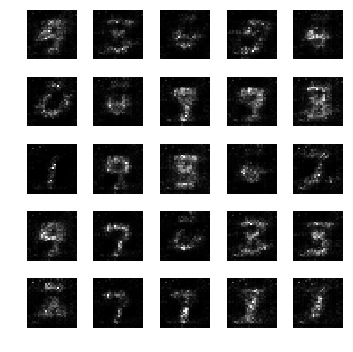

epoch: 271, time: 4.954773 | train_G_Loss: 0.493425, train_D_loss: 2.368795, train_acc: 0.722656
cv_G_Loss: 0.638280, cv_D_loss: 3.156402, cv_acc: 0.735700

epoch: 272, time: 4.917446 | train_G_Loss: 0.270213, train_D_loss: 2.708720, train_acc: 0.703125
cv_G_Loss: 0.424255, cv_D_loss: 2.936295, cv_acc: 0.776400

epoch: 273, time: 4.933565 | train_G_Loss: 0.365561, train_D_loss: 2.900447, train_acc: 0.769531
cv_G_Loss: 0.800373, cv_D_loss: 3.231298, cv_acc: 0.783000

epoch: 274, time: 4.919517 | train_G_Loss: 0.443524, train_D_loss: 2.997519, train_acc: 0.753906
cv_G_Loss: 1.073401, cv_D_loss: 3.506638, cv_acc: 0.775400

epoch: 275, time: 4.937599 | train_G_Loss: 0.443294, train_D_loss: 3.841186, train_acc: 0.726562
cv_G_Loss: 0.526198, cv_D_loss: 2.921341, cv_acc: 0.778900

epoch: 276, time: 4.921329 | train_G_Loss: 0.446309, train_D_loss: 2.728266, train_acc: 0.787109
cv_G_Loss: 0.744577, cv_D_loss: 2.959714, cv_acc: 0.796200

epoch: 277, time: 4.911705 | train_G_Loss: 0.313780, train

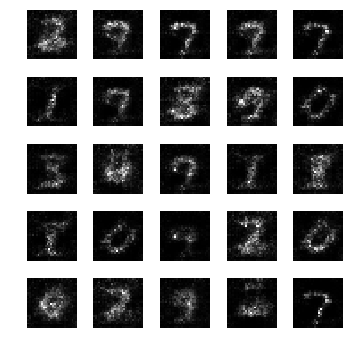

epoch: 281, time: 4.945280 | train_G_Loss: 0.400390, train_D_loss: 2.778716, train_acc: 0.742188
cv_G_Loss: 1.146269, cv_D_loss: 3.540551, cv_acc: 0.732600

epoch: 282, time: 4.915954 | train_G_Loss: 0.374215, train_D_loss: 2.499583, train_acc: 0.812500
cv_G_Loss: 0.456173, cv_D_loss: 2.917280, cv_acc: 0.788900

epoch: 283, time: 4.894562 | train_G_Loss: 0.417939, train_D_loss: 2.473645, train_acc: 0.851562
cv_G_Loss: 0.500008, cv_D_loss: 2.889666, cv_acc: 0.779400

epoch: 284, time: 4.917449 | train_G_Loss: 0.355993, train_D_loss: 2.432205, train_acc: 0.867188
cv_G_Loss: 0.474522, cv_D_loss: 2.836079, cv_acc: 0.817300
Model saved

epoch: 285, time: 4.944125 | train_G_Loss: 0.393545, train_D_loss: 2.510848, train_acc: 0.812500
cv_G_Loss: 0.323761, cv_D_loss: 2.848217, cv_acc: 0.799300

epoch: 286, time: 4.915846 | train_G_Loss: 0.427577, train_D_loss: 2.981768, train_acc: 0.759766
cv_G_Loss: 0.346136, cv_D_loss: 2.833694, cv_acc: 0.787200

epoch: 287, time: 4.907947 | train_G_Loss: 0.3

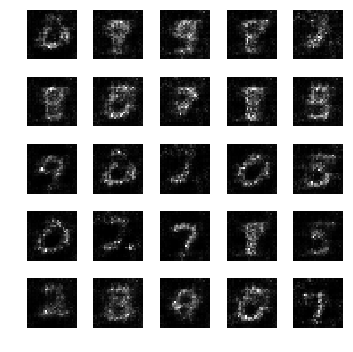

epoch: 291, time: 4.925474 | train_G_Loss: 0.337161, train_D_loss: 2.939042, train_acc: 0.794922
cv_G_Loss: 0.292620, cv_D_loss: 3.132578, cv_acc: 0.741200

epoch: 292, time: 4.912616 | train_G_Loss: 0.400769, train_D_loss: 2.486172, train_acc: 0.814453
cv_G_Loss: 0.445195, cv_D_loss: 2.883400, cv_acc: 0.796400

epoch: 293, time: 4.908792 | train_G_Loss: 0.366891, train_D_loss: 3.048035, train_acc: 0.851562
cv_G_Loss: 0.484471, cv_D_loss: 2.942329, cv_acc: 0.804200

epoch: 294, time: 4.908092 | train_G_Loss: 0.497996, train_D_loss: 2.783016, train_acc: 0.785156
cv_G_Loss: 1.368793, cv_D_loss: 4.072222, cv_acc: 0.722000

epoch: 295, time: 4.915968 | train_G_Loss: 0.446632, train_D_loss: 2.862949, train_acc: 0.750000
cv_G_Loss: 0.936221, cv_D_loss: 3.266502, cv_acc: 0.794700

epoch: 296, time: 4.899294 | train_G_Loss: 0.468900, train_D_loss: 3.064001, train_acc: 0.787109
cv_G_Loss: 1.456968, cv_D_loss: 4.283588, cv_acc: 0.760600

epoch: 297, time: 4.922692 | train_G_Loss: 0.348921, train

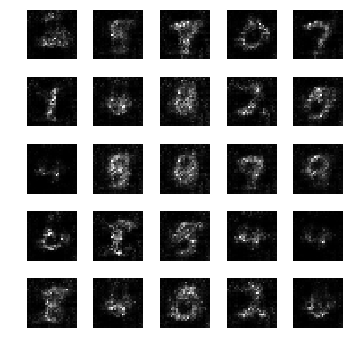

epoch: 301, time: 4.943773 | train_G_Loss: 0.371389, train_D_loss: 2.761576, train_acc: 0.804688
cv_G_Loss: 0.523467, cv_D_loss: 3.013149, cv_acc: 0.752600

epoch: 302, time: 4.912846 | train_G_Loss: 0.451368, train_D_loss: 2.798831, train_acc: 0.767578
cv_G_Loss: 1.140020, cv_D_loss: 3.568829, cv_acc: 0.802700

epoch: 303, time: 4.912907 | train_G_Loss: 0.417039, train_D_loss: 3.125158, train_acc: 0.775391
cv_G_Loss: 2.260451, cv_D_loss: 5.707892, cv_acc: 0.800200

epoch: 304, time: 4.907883 | train_G_Loss: 0.352449, train_D_loss: 3.267277, train_acc: 0.783203
cv_G_Loss: 0.442249, cv_D_loss: 2.926023, cv_acc: 0.796700

epoch: 305, time: 4.918799 | train_G_Loss: 0.364516, train_D_loss: 3.270173, train_acc: 0.798828
cv_G_Loss: 0.383090, cv_D_loss: 3.005244, cv_acc: 0.770100

epoch: 306, time: 4.917758 | train_G_Loss: 0.395715, train_D_loss: 2.866976, train_acc: 0.787109
cv_G_Loss: 0.272983, cv_D_loss: 3.285251, cv_acc: 0.662600

epoch: 307, time: 4.910453 | train_G_Loss: 0.305550, train

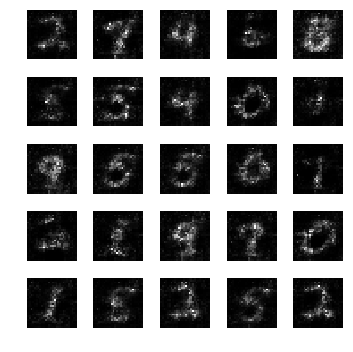

epoch: 311, time: 4.922742 | train_G_Loss: 0.399901, train_D_loss: 2.539089, train_acc: 0.753906
cv_G_Loss: 0.570595, cv_D_loss: 3.173153, cv_acc: 0.725800

epoch: 312, time: 4.916665 | train_G_Loss: 0.376162, train_D_loss: 3.728091, train_acc: 0.748047
cv_G_Loss: 1.072919, cv_D_loss: 3.526063, cv_acc: 0.703000

epoch: 313, time: 4.901485 | train_G_Loss: 0.422463, train_D_loss: 3.165217, train_acc: 0.792969
cv_G_Loss: 0.619520, cv_D_loss: 3.087360, cv_acc: 0.782900

epoch: 314, time: 4.914557 | train_G_Loss: 0.415472, train_D_loss: 2.374507, train_acc: 0.789062
cv_G_Loss: 0.796845, cv_D_loss: 3.187876, cv_acc: 0.810800

epoch: 315, time: 4.916926 | train_G_Loss: 0.376171, train_D_loss: 2.760488, train_acc: 0.830078
cv_G_Loss: 0.570939, cv_D_loss: 2.955188, cv_acc: 0.790700

epoch: 316, time: 4.907920 | train_G_Loss: 0.424705, train_D_loss: 2.501757, train_acc: 0.845703
cv_G_Loss: 0.391325, cv_D_loss: 2.912237, cv_acc: 0.806900

epoch: 317, time: 4.907221 | train_G_Loss: 0.374077, train

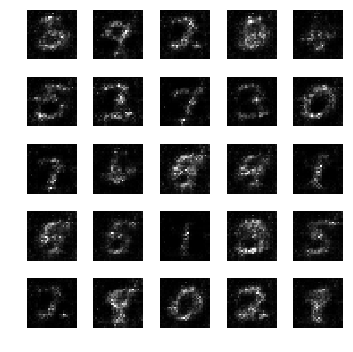

epoch: 321, time: 4.942803 | train_G_Loss: 0.375304, train_D_loss: 2.751767, train_acc: 0.806641
cv_G_Loss: 0.348715, cv_D_loss: 3.153582, cv_acc: 0.700800

epoch: 322, time: 4.904440 | train_G_Loss: 0.492281, train_D_loss: 3.363664, train_acc: 0.833984
cv_G_Loss: 1.064105, cv_D_loss: 3.718622, cv_acc: 0.805600

epoch: 323, time: 4.907137 | train_G_Loss: 0.347460, train_D_loss: 3.031387, train_acc: 0.796875
cv_G_Loss: 0.450755, cv_D_loss: 2.949836, cv_acc: 0.775600

epoch: 324, time: 4.909343 | train_G_Loss: 0.329425, train_D_loss: 3.254853, train_acc: 0.806641
cv_G_Loss: 0.291802, cv_D_loss: 2.882006, cv_acc: 0.804200

epoch: 325, time: 4.909042 | train_G_Loss: 0.426775, train_D_loss: 2.752264, train_acc: 0.769531
cv_G_Loss: 0.300034, cv_D_loss: 3.028259, cv_acc: 0.757500

epoch: 326, time: 4.906971 | train_G_Loss: 0.341714, train_D_loss: 3.053089, train_acc: 0.830078
cv_G_Loss: 0.289110, cv_D_loss: 3.161151, cv_acc: 0.736300

epoch: 327, time: 4.905194 | train_G_Loss: 0.413235, train

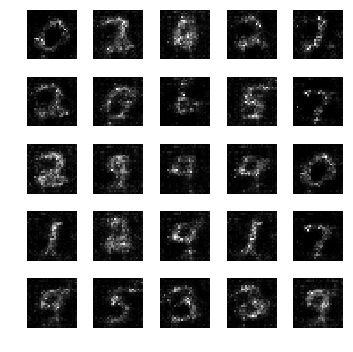

epoch: 331, time: 4.934658 | train_G_Loss: 0.349188, train_D_loss: 2.665113, train_acc: 0.816406
cv_G_Loss: 0.690820, cv_D_loss: 3.065959, cv_acc: 0.809800

epoch: 332, time: 4.911026 | train_G_Loss: 0.407031, train_D_loss: 3.391613, train_acc: 0.839844
cv_G_Loss: 0.501882, cv_D_loss: 2.875547, cv_acc: 0.817900

epoch: 333, time: 4.903258 | train_G_Loss: 0.373622, train_D_loss: 3.488578, train_acc: 0.837891
cv_G_Loss: 0.557836, cv_D_loss: 2.948641, cv_acc: 0.809700

epoch: 334, time: 4.914165 | train_G_Loss: 0.340693, train_D_loss: 3.348176, train_acc: 0.798828
cv_G_Loss: 0.318632, cv_D_loss: 2.847482, cv_acc: 0.814400

epoch: 335, time: 4.908500 | train_G_Loss: 0.392104, train_D_loss: 3.171134, train_acc: 0.773438
cv_G_Loss: 0.905618, cv_D_loss: 3.458676, cv_acc: 0.795500

epoch: 336, time: 4.900665 | train_G_Loss: 0.368137, train_D_loss: 3.672733, train_acc: 0.792969
cv_G_Loss: 1.156846, cv_D_loss: 3.802385, cv_acc: 0.730800

epoch: 337, time: 4.904063 | train_G_Loss: 0.347679, train

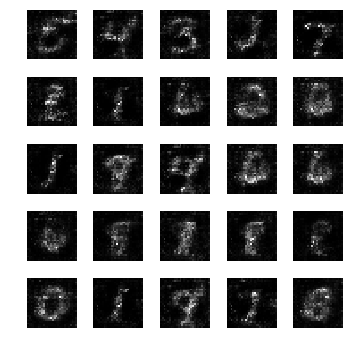

epoch: 341, time: 4.953602 | train_G_Loss: 0.432545, train_D_loss: 2.777176, train_acc: 0.804688
cv_G_Loss: 1.340996, cv_D_loss: 4.264231, cv_acc: 0.821200

epoch: 342, time: 4.927917 | train_G_Loss: 0.421813, train_D_loss: 3.138608, train_acc: 0.792969
cv_G_Loss: 0.475481, cv_D_loss: 3.043736, cv_acc: 0.798200

epoch: 343, time: 4.908224 | train_G_Loss: 0.364369, train_D_loss: 2.619833, train_acc: 0.853516
cv_G_Loss: 0.777984, cv_D_loss: 3.279585, cv_acc: 0.531000

epoch: 344, time: 4.917708 | train_G_Loss: 0.411156, train_D_loss: 2.719633, train_acc: 0.816406
cv_G_Loss: 1.024746, cv_D_loss: 3.749503, cv_acc: 0.507900

epoch: 345, time: 4.913908 | train_G_Loss: 0.441785, train_D_loss: 2.604746, train_acc: 0.794922
cv_G_Loss: 1.227953, cv_D_loss: 3.856005, cv_acc: 0.783700

epoch: 346, time: 4.920382 | train_G_Loss: 0.371192, train_D_loss: 3.238448, train_acc: 0.820312
cv_G_Loss: 1.583840, cv_D_loss: 4.686148, cv_acc: 0.764000

epoch: 347, time: 4.929020 | train_G_Loss: 0.339702, train

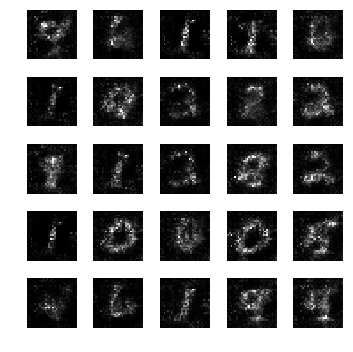

epoch: 351, time: 4.941913 | train_G_Loss: 0.371534, train_D_loss: 2.898270, train_acc: 0.822266
cv_G_Loss: 0.198499, cv_D_loss: 3.220017, cv_acc: 0.746300

epoch: 352, time: 4.920911 | train_G_Loss: 0.367991, train_D_loss: 3.595163, train_acc: 0.824219
cv_G_Loss: 0.488877, cv_D_loss: 2.935573, cv_acc: 0.794200

epoch: 353, time: 4.919767 | train_G_Loss: 0.403462, train_D_loss: 2.736493, train_acc: 0.851562
cv_G_Loss: 1.365958, cv_D_loss: 4.183088, cv_acc: 0.778600

epoch: 354, time: 4.916826 | train_G_Loss: 0.375915, train_D_loss: 2.461680, train_acc: 0.820312
cv_G_Loss: 0.783971, cv_D_loss: 3.173030, cv_acc: 0.794900

epoch: 355, time: 4.912845 | train_G_Loss: 0.301042, train_D_loss: 2.903270, train_acc: 0.824219
cv_G_Loss: 0.575894, cv_D_loss: 2.962524, cv_acc: 0.777900

epoch: 356, time: 4.916730 | train_G_Loss: 0.330380, train_D_loss: 2.792104, train_acc: 0.837891
cv_G_Loss: 0.233813, cv_D_loss: 2.901931, cv_acc: 0.822800

epoch: 357, time: 4.922624 | train_G_Loss: 0.375355, train

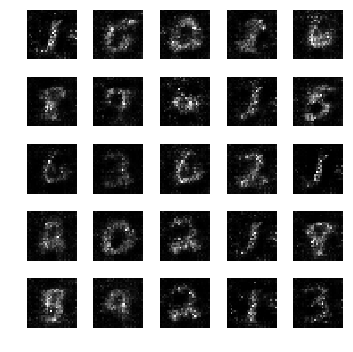

epoch: 361, time: 4.952200 | train_G_Loss: 0.311069, train_D_loss: 3.143130, train_acc: 0.851562
cv_G_Loss: 0.303022, cv_D_loss: 2.896183, cv_acc: 0.822700

epoch: 362, time: 4.908247 | train_G_Loss: 0.335091, train_D_loss: 3.314944, train_acc: 0.830078
cv_G_Loss: 1.250018, cv_D_loss: 4.139455, cv_acc: 0.808300

epoch: 363, time: 4.917518 | train_G_Loss: 0.306625, train_D_loss: 3.549733, train_acc: 0.824219
cv_G_Loss: 0.267449, cv_D_loss: 3.054794, cv_acc: 0.786500

epoch: 364, time: 4.906569 | train_G_Loss: 0.363996, train_D_loss: 2.807165, train_acc: 0.855469
cv_G_Loss: 0.925139, cv_D_loss: 3.459318, cv_acc: 0.831900
Model saved

epoch: 365, time: 4.923349 | train_G_Loss: 0.345431, train_D_loss: 2.666466, train_acc: 0.886719
cv_G_Loss: 0.683625, cv_D_loss: 3.182309, cv_acc: 0.806400

epoch: 366, time: 4.910646 | train_G_Loss: 0.414806, train_D_loss: 2.328143, train_acc: 0.880859
cv_G_Loss: 0.654162, cv_D_loss: 3.290842, cv_acc: 0.790900

epoch: 367, time: 4.922272 | train_G_Loss: 0.4

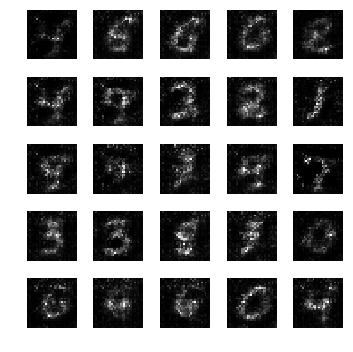

epoch: 371, time: 4.939920 | train_G_Loss: 0.285837, train_D_loss: 2.451073, train_acc: 0.839844
cv_G_Loss: 0.192860, cv_D_loss: 3.149281, cv_acc: 0.752700

epoch: 372, time: 4.915047 | train_G_Loss: 0.460119, train_D_loss: 2.465647, train_acc: 0.792969
cv_G_Loss: 0.728219, cv_D_loss: 3.396480, cv_acc: 0.764100

epoch: 373, time: 4.903232 | train_G_Loss: 0.329062, train_D_loss: 3.265221, train_acc: 0.826172
cv_G_Loss: 0.794029, cv_D_loss: 3.120793, cv_acc: 0.816800

epoch: 374, time: 4.914490 | train_G_Loss: 0.332262, train_D_loss: 2.560322, train_acc: 0.822266
cv_G_Loss: 0.280183, cv_D_loss: 2.979207, cv_acc: 0.813900

epoch: 375, time: 4.922055 | train_G_Loss: 0.313671, train_D_loss: 2.741170, train_acc: 0.857422
cv_G_Loss: 0.290920, cv_D_loss: 2.938221, cv_acc: 0.806500

epoch: 376, time: 4.917174 | train_G_Loss: 0.363139, train_D_loss: 2.833993, train_acc: 0.837891
cv_G_Loss: 0.931720, cv_D_loss: 3.453226, cv_acc: 0.776600

epoch: 377, time: 4.918402 | train_G_Loss: 0.499743, train

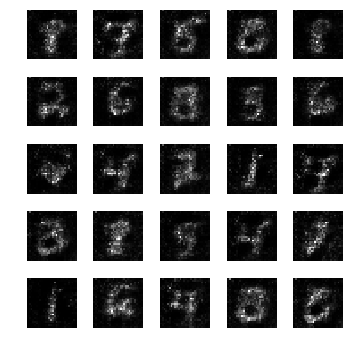

epoch: 381, time: 4.902839 | train_G_Loss: 0.413308, train_D_loss: 2.572102, train_acc: 0.791016
cv_G_Loss: 0.303371, cv_D_loss: 2.968761, cv_acc: 0.776000

epoch: 382, time: 4.906655 | train_G_Loss: 0.359748, train_D_loss: 2.672065, train_acc: 0.794922
cv_G_Loss: 1.948607, cv_D_loss: 4.910675, cv_acc: 0.578400

epoch: 383, time: 4.910288 | train_G_Loss: 0.325199, train_D_loss: 2.469305, train_acc: 0.779297
cv_G_Loss: 0.267930, cv_D_loss: 2.802612, cv_acc: 0.832100
Model saved

epoch: 384, time: 4.933956 | train_G_Loss: 0.388690, train_D_loss: 3.293373, train_acc: 0.746094
cv_G_Loss: 0.571150, cv_D_loss: 3.130462, cv_acc: 0.774500

epoch: 385, time: 4.923570 | train_G_Loss: 0.333783, train_D_loss: 3.069967, train_acc: 0.804688
cv_G_Loss: 0.455097, cv_D_loss: 2.804328, cv_acc: 0.821700

epoch: 386, time: 4.911849 | train_G_Loss: 0.365423, train_D_loss: 3.182829, train_acc: 0.835938
cv_G_Loss: 0.341363, cv_D_loss: 2.832757, cv_acc: 0.834400
Model saved

epoch: 387, time: 4.940124 | train

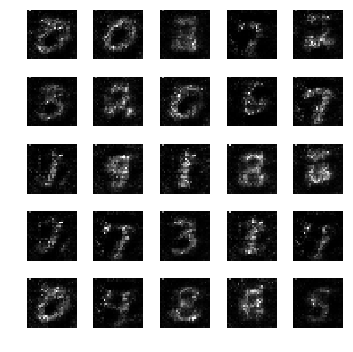

epoch: 391, time: 4.935457 | train_G_Loss: 0.379960, train_D_loss: 2.637516, train_acc: 0.843750
cv_G_Loss: 0.971389, cv_D_loss: 3.511446, cv_acc: 0.831100

epoch: 392, time: 4.923345 | train_G_Loss: 0.341701, train_D_loss: 2.502412, train_acc: 0.855469
cv_G_Loss: 0.570138, cv_D_loss: 3.090589, cv_acc: 0.804800

epoch: 393, time: 4.909088 | train_G_Loss: 0.388847, train_D_loss: 2.875337, train_acc: 0.814453
cv_G_Loss: 0.928927, cv_D_loss: 4.138634, cv_acc: 0.630800

epoch: 394, time: 4.914428 | train_G_Loss: 0.349815, train_D_loss: 2.879751, train_acc: 0.769531
cv_G_Loss: 0.287968, cv_D_loss: 2.979620, cv_acc: 0.795300

epoch: 395, time: 4.910873 | train_G_Loss: 0.387882, train_D_loss: 3.413485, train_acc: 0.794922
cv_G_Loss: 0.606483, cv_D_loss: 3.101115, cv_acc: 0.768600

epoch: 396, time: 4.908636 | train_G_Loss: 0.297537, train_D_loss: 3.039739, train_acc: 0.802734
cv_G_Loss: 1.093083, cv_D_loss: 3.755799, cv_acc: 0.813200

epoch: 397, time: 4.910656 | train_G_Loss: 0.464527, train

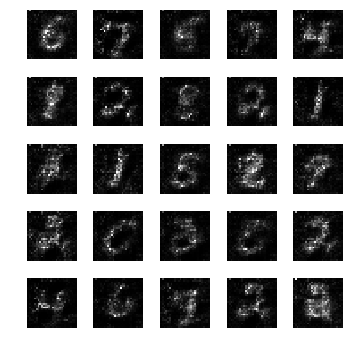

epoch: 401, time: 4.948473 | train_G_Loss: 0.426430, train_D_loss: 2.544918, train_acc: 0.828125
cv_G_Loss: 0.309261, cv_D_loss: 3.177475, cv_acc: 0.751500

epoch: 402, time: 4.919804 | train_G_Loss: 0.399594, train_D_loss: 2.507622, train_acc: 0.808594
cv_G_Loss: 0.631366, cv_D_loss: 3.014360, cv_acc: 0.810200

epoch: 403, time: 4.934216 | train_G_Loss: 0.359191, train_D_loss: 2.753374, train_acc: 0.802734
cv_G_Loss: 0.993736, cv_D_loss: 3.386376, cv_acc: 0.824200

epoch: 404, time: 5.030758 | train_G_Loss: 0.455511, train_D_loss: 3.107793, train_acc: 0.812500
cv_G_Loss: 0.279579, cv_D_loss: 2.949968, cv_acc: 0.828500

epoch: 405, time: 5.042531 | train_G_Loss: 0.390955, train_D_loss: 3.754684, train_acc: 0.832031
cv_G_Loss: 0.375920, cv_D_loss: 2.739248, cv_acc: 0.836600
Model saved

epoch: 406, time: 5.019843 | train_G_Loss: 0.425468, train_D_loss: 2.732700, train_acc: 0.839844
cv_G_Loss: 0.732506, cv_D_loss: 2.953477, cv_acc: 0.829800

epoch: 407, time: 4.964546 | train_G_Loss: 0.3

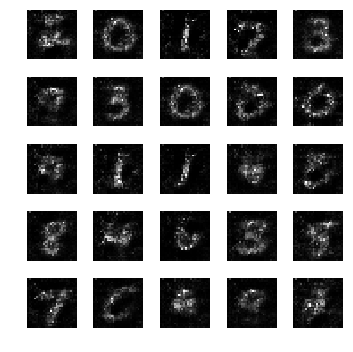

epoch: 411, time: 4.936477 | train_G_Loss: 0.343581, train_D_loss: 3.169408, train_acc: 0.824219
cv_G_Loss: 0.231207, cv_D_loss: 3.142206, cv_acc: 0.753000

epoch: 412, time: 4.917808 | train_G_Loss: 0.307056, train_D_loss: 2.716137, train_acc: 0.800781
cv_G_Loss: 0.125912, cv_D_loss: 3.250083, cv_acc: 0.816300

epoch: 413, time: 4.920808 | train_G_Loss: 0.340519, train_D_loss: 2.553511, train_acc: 0.789062
cv_G_Loss: 0.329810, cv_D_loss: 3.012792, cv_acc: 0.739600

epoch: 414, time: 4.899521 | train_G_Loss: 0.349463, train_D_loss: 2.492852, train_acc: 0.798828
cv_G_Loss: 0.745130, cv_D_loss: 3.186934, cv_acc: 0.782400

epoch: 415, time: 4.929626 | train_G_Loss: 0.448990, train_D_loss: 2.807603, train_acc: 0.828125
cv_G_Loss: 1.007093, cv_D_loss: 3.351624, cv_acc: 0.782400

epoch: 416, time: 4.919184 | train_G_Loss: 0.390738, train_D_loss: 2.431971, train_acc: 0.865234
cv_G_Loss: 0.811278, cv_D_loss: 3.242188, cv_acc: 0.821800

epoch: 417, time: 4.914891 | train_G_Loss: 0.401219, train

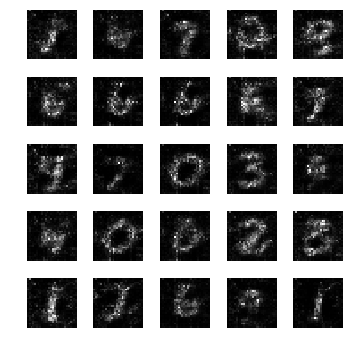

epoch: 421, time: 4.946989 | train_G_Loss: 0.374290, train_D_loss: 2.727038, train_acc: 0.863281
cv_G_Loss: 0.898643, cv_D_loss: 3.364985, cv_acc: 0.814300

epoch: 422, time: 4.905006 | train_G_Loss: 0.311505, train_D_loss: 2.621716, train_acc: 0.867188
cv_G_Loss: 0.318868, cv_D_loss: 3.118780, cv_acc: 0.717700

epoch: 423, time: 4.911586 | train_G_Loss: 0.382719, train_D_loss: 2.713459, train_acc: 0.839844
cv_G_Loss: 0.196118, cv_D_loss: 3.105585, cv_acc: 0.787200

epoch: 424, time: 4.917921 | train_G_Loss: 0.351332, train_D_loss: 3.118919, train_acc: 0.853516
cv_G_Loss: 0.535669, cv_D_loss: 2.929797, cv_acc: 0.830000

epoch: 425, time: 4.916992 | train_G_Loss: 0.408914, train_D_loss: 2.748825, train_acc: 0.832031
cv_G_Loss: 0.600088, cv_D_loss: 2.991501, cv_acc: 0.829400

epoch: 426, time: 4.907151 | train_G_Loss: 0.383192, train_D_loss: 2.671921, train_acc: 0.816406
cv_G_Loss: 0.231754, cv_D_loss: 2.823607, cv_acc: 0.837300
Model saved

epoch: 427, time: 4.945053 | train_G_Loss: 0.4

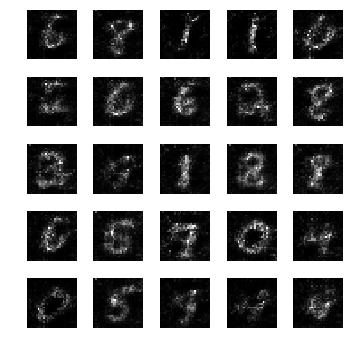

epoch: 431, time: 4.920862 | train_G_Loss: 0.458622, train_D_loss: 2.605844, train_acc: 0.773438
cv_G_Loss: 0.690125, cv_D_loss: 2.881911, cv_acc: 0.831000

epoch: 432, time: 4.916382 | train_G_Loss: 0.402106, train_D_loss: 2.329854, train_acc: 0.810547
cv_G_Loss: 0.345343, cv_D_loss: 2.878743, cv_acc: 0.815500

epoch: 433, time: 4.891818 | train_G_Loss: 0.431862, train_D_loss: 2.311275, train_acc: 0.837891
cv_G_Loss: 0.606280, cv_D_loss: 2.992895, cv_acc: 0.778500

epoch: 434, time: 4.900707 | train_G_Loss: 0.317053, train_D_loss: 2.744409, train_acc: 0.849609
cv_G_Loss: 0.306788, cv_D_loss: 2.824398, cv_acc: 0.816900

epoch: 435, time: 4.907757 | train_G_Loss: 0.419928, train_D_loss: 2.502424, train_acc: 0.824219
cv_G_Loss: 0.433903, cv_D_loss: 3.084296, cv_acc: 0.767800

epoch: 436, time: 4.915389 | train_G_Loss: 0.454490, train_D_loss: 2.299294, train_acc: 0.841797
cv_G_Loss: 0.375004, cv_D_loss: 2.842728, cv_acc: 0.833200

epoch: 437, time: 4.909568 | train_G_Loss: 0.407401, train

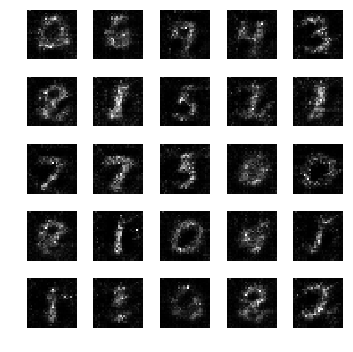

epoch: 441, time: 4.957087 | train_G_Loss: 0.347931, train_D_loss: 2.637993, train_acc: 0.873047
cv_G_Loss: 0.446539, cv_D_loss: 2.720758, cv_acc: 0.824700

epoch: 442, time: 4.919909 | train_G_Loss: 0.433039, train_D_loss: 2.490144, train_acc: 0.878906
cv_G_Loss: 0.368866, cv_D_loss: 3.064254, cv_acc: 0.789000

epoch: 443, time: 4.923537 | train_G_Loss: 0.358088, train_D_loss: 2.445393, train_acc: 0.859375
cv_G_Loss: 0.697394, cv_D_loss: 3.402502, cv_acc: 0.752800

epoch: 444, time: 4.911788 | train_G_Loss: 0.332889, train_D_loss: 2.868046, train_acc: 0.818359
cv_G_Loss: 0.640824, cv_D_loss: 2.939954, cv_acc: 0.799500

epoch: 445, time: 4.918709 | train_G_Loss: 0.414541, train_D_loss: 3.005135, train_acc: 0.839844
cv_G_Loss: 0.779645, cv_D_loss: 3.176142, cv_acc: 0.822300

epoch: 446, time: 4.911380 | train_G_Loss: 0.366723, train_D_loss: 2.933947, train_acc: 0.828125
cv_G_Loss: 0.477434, cv_D_loss: 2.777547, cv_acc: 0.838300

epoch: 447, time: 4.904826 | train_G_Loss: 0.332086, train

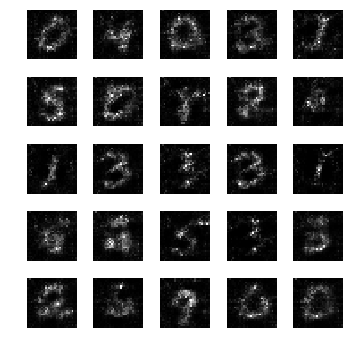

epoch: 451, time: 4.934888 | train_G_Loss: 0.430616, train_D_loss: 2.748935, train_acc: 0.833984
cv_G_Loss: 0.619767, cv_D_loss: 3.272768, cv_acc: 0.769600

epoch: 452, time: 4.915919 | train_G_Loss: 0.350341, train_D_loss: 3.010472, train_acc: 0.826172
cv_G_Loss: 0.566103, cv_D_loss: 2.879801, cv_acc: 0.811300

epoch: 453, time: 4.903814 | train_G_Loss: 0.397003, train_D_loss: 2.562334, train_acc: 0.791016
cv_G_Loss: 0.513058, cv_D_loss: 2.739351, cv_acc: 0.826700

epoch: 454, time: 4.931866 | train_G_Loss: 0.424690, train_D_loss: 2.962682, train_acc: 0.828125
cv_G_Loss: 0.749480, cv_D_loss: 2.978506, cv_acc: 0.795800

epoch: 455, time: 4.915843 | train_G_Loss: 0.279079, train_D_loss: 2.923300, train_acc: 0.804688
cv_G_Loss: 0.275319, cv_D_loss: 2.756687, cv_acc: 0.840700

epoch: 456, time: 4.915424 | train_G_Loss: 0.351453, train_D_loss: 2.763820, train_acc: 0.779297
cv_G_Loss: 0.329891, cv_D_loss: 2.720034, cv_acc: 0.845000
Model saved

epoch: 457, time: 4.947982 | train_G_Loss: 0.4

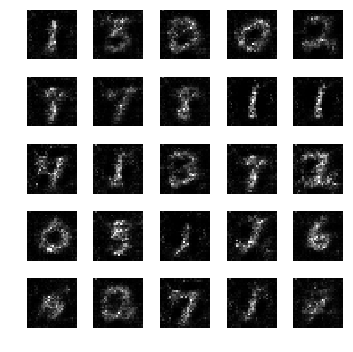

epoch: 461, time: 4.974977 | train_G_Loss: 0.406688, train_D_loss: 2.850431, train_acc: 0.781250
cv_G_Loss: 0.832714, cv_D_loss: 3.794094, cv_acc: 0.517800

epoch: 462, time: 4.909202 | train_G_Loss: 0.357198, train_D_loss: 2.546036, train_acc: 0.802734
cv_G_Loss: 0.490078, cv_D_loss: 2.840994, cv_acc: 0.834000

epoch: 463, time: 4.917787 | train_G_Loss: 0.410778, train_D_loss: 2.434377, train_acc: 0.796875
cv_G_Loss: 0.399197, cv_D_loss: 2.963354, cv_acc: 0.795400

epoch: 464, time: 4.924414 | train_G_Loss: 0.364158, train_D_loss: 2.988515, train_acc: 0.763672
cv_G_Loss: 0.806561, cv_D_loss: 2.961561, cv_acc: 0.848400
Model saved

epoch: 465, time: 4.944052 | train_G_Loss: 0.316914, train_D_loss: 3.097993, train_acc: 0.830078
cv_G_Loss: 0.173022, cv_D_loss: 3.126418, cv_acc: 0.810400

epoch: 466, time: 4.915783 | train_G_Loss: 0.306885, train_D_loss: 3.341362, train_acc: 0.843750
cv_G_Loss: 0.333366, cv_D_loss: 3.030124, cv_acc: 0.772900

epoch: 467, time: 4.917186 | train_G_Loss: 0.3

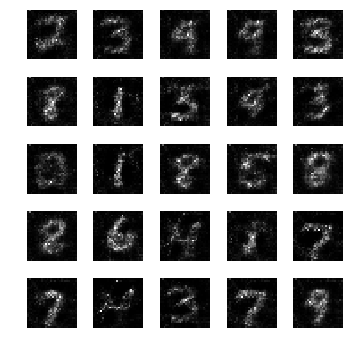

epoch: 471, time: 4.947628 | train_G_Loss: 0.333699, train_D_loss: 2.750201, train_acc: 0.849609
cv_G_Loss: 0.380470, cv_D_loss: 2.821352, cv_acc: 0.823100

epoch: 472, time: 4.921127 | train_G_Loss: 0.393114, train_D_loss: 2.734234, train_acc: 0.810547
cv_G_Loss: 0.441280, cv_D_loss: 2.887330, cv_acc: 0.789500

epoch: 473, time: 4.921226 | train_G_Loss: 0.353988, train_D_loss: 2.898564, train_acc: 0.814453
cv_G_Loss: 0.405764, cv_D_loss: 2.688745, cv_acc: 0.832100

epoch: 474, time: 4.916554 | train_G_Loss: 0.337125, train_D_loss: 3.321226, train_acc: 0.802734
cv_G_Loss: 0.415952, cv_D_loss: 2.746270, cv_acc: 0.826600

epoch: 475, time: 4.920097 | train_G_Loss: 0.471690, train_D_loss: 2.575013, train_acc: 0.814453
cv_G_Loss: 0.282598, cv_D_loss: 2.848572, cv_acc: 0.814400

epoch: 476, time: 4.918353 | train_G_Loss: 0.389442, train_D_loss: 2.306285, train_acc: 0.851562
cv_G_Loss: 0.352788, cv_D_loss: 2.835079, cv_acc: 0.806800

epoch: 477, time: 4.921146 | train_G_Loss: 0.406128, train

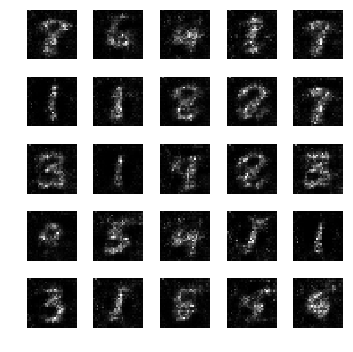

epoch: 481, time: 4.924271 | train_G_Loss: 0.287382, train_D_loss: 3.347440, train_acc: 0.779297
cv_G_Loss: 0.398145, cv_D_loss: 2.683516, cv_acc: 0.843000

epoch: 482, time: 4.903633 | train_G_Loss: 0.354905, train_D_loss: 2.778606, train_acc: 0.812500
cv_G_Loss: 0.637227, cv_D_loss: 2.850771, cv_acc: 0.805300

epoch: 483, time: 4.915045 | train_G_Loss: 0.323357, train_D_loss: 2.921329, train_acc: 0.839844
cv_G_Loss: 0.656004, cv_D_loss: 3.013684, cv_acc: 0.804600

epoch: 484, time: 4.910122 | train_G_Loss: 0.485801, train_D_loss: 3.316155, train_acc: 0.859375
cv_G_Loss: 0.831458, cv_D_loss: 3.254812, cv_acc: 0.693100

epoch: 485, time: 4.904999 | train_G_Loss: 0.303924, train_D_loss: 2.632017, train_acc: 0.851562
cv_G_Loss: 0.350629, cv_D_loss: 3.222192, cv_acc: 0.708600

epoch: 486, time: 4.912522 | train_G_Loss: 0.316528, train_D_loss: 2.912349, train_acc: 0.888672
cv_G_Loss: 0.651089, cv_D_loss: 2.670777, cv_acc: 0.839000

epoch: 487, time: 4.909799 | train_G_Loss: 0.472471, train

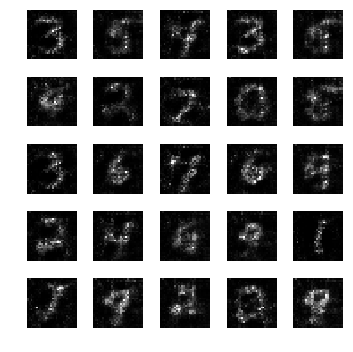

epoch: 491, time: 4.962934 | train_G_Loss: 0.402535, train_D_loss: 2.844893, train_acc: 0.824219
cv_G_Loss: 0.442490, cv_D_loss: 3.098773, cv_acc: 0.764200

epoch: 492, time: 4.920601 | train_G_Loss: 0.452560, train_D_loss: 2.494589, train_acc: 0.851562
cv_G_Loss: 0.621268, cv_D_loss: 2.926828, cv_acc: 0.734100

epoch: 493, time: 4.928285 | train_G_Loss: 0.410421, train_D_loss: 2.514011, train_acc: 0.855469
cv_G_Loss: 0.737719, cv_D_loss: 2.836347, cv_acc: 0.842900

epoch: 494, time: 4.929090 | train_G_Loss: 0.353599, train_D_loss: 2.620732, train_acc: 0.783203
cv_G_Loss: 0.748372, cv_D_loss: 2.970889, cv_acc: 0.831400

epoch: 495, time: 4.922863 | train_G_Loss: 0.449066, train_D_loss: 2.730947, train_acc: 0.798828
cv_G_Loss: 1.567783, cv_D_loss: 4.241206, cv_acc: 0.799400

epoch: 496, time: 4.930012 | train_G_Loss: 0.405835, train_D_loss: 2.528003, train_acc: 0.832031
cv_G_Loss: 1.123849, cv_D_loss: 3.356961, cv_acc: 0.845200

epoch: 497, time: 4.937684 | train_G_Loss: 0.298701, train

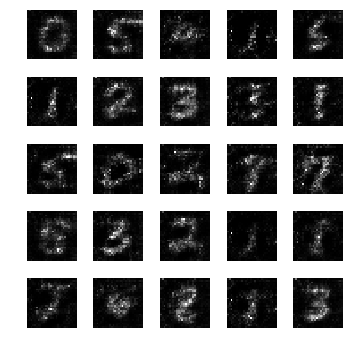

epoch: 501, time: 4.944206 | train_G_Loss: 0.378685, train_D_loss: 2.811276, train_acc: 0.839844
cv_G_Loss: 0.619309, cv_D_loss: 2.998904, cv_acc: 0.773600

epoch: 502, time: 4.917757 | train_G_Loss: 0.334866, train_D_loss: 2.685557, train_acc: 0.859375
cv_G_Loss: 0.456495, cv_D_loss: 2.869649, cv_acc: 0.807500

epoch: 503, time: 4.915725 | train_G_Loss: 0.359225, train_D_loss: 2.898343, train_acc: 0.824219
cv_G_Loss: 0.435020, cv_D_loss: 2.697668, cv_acc: 0.830800

epoch: 504, time: 4.906540 | train_G_Loss: 0.442171, train_D_loss: 2.345664, train_acc: 0.796875
cv_G_Loss: 1.117880, cv_D_loss: 3.504246, cv_acc: 0.823500

epoch: 505, time: 4.928157 | train_G_Loss: 0.406640, train_D_loss: 2.587883, train_acc: 0.857422
cv_G_Loss: 0.686775, cv_D_loss: 2.867017, cv_acc: 0.849100

epoch: 506, time: 4.927351 | train_G_Loss: 0.393953, train_D_loss: 2.187299, train_acc: 0.861328
cv_G_Loss: 0.585736, cv_D_loss: 2.754577, cv_acc: 0.827800

epoch: 507, time: 4.927060 | train_G_Loss: 0.352332, train

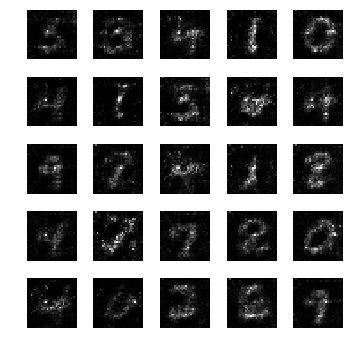

epoch: 511, time: 4.943496 | train_G_Loss: 0.280397, train_D_loss: 2.918653, train_acc: 0.824219
cv_G_Loss: 0.404676, cv_D_loss: 2.790061, cv_acc: 0.820700

epoch: 512, time: 4.931802 | train_G_Loss: 0.327087, train_D_loss: 3.061800, train_acc: 0.849609
cv_G_Loss: 0.822130, cv_D_loss: 2.958633, cv_acc: 0.844500

epoch: 513, time: 4.923759 | train_G_Loss: 0.474985, train_D_loss: 2.314364, train_acc: 0.837891
cv_G_Loss: 0.949420, cv_D_loss: 3.289021, cv_acc: 0.820000

epoch: 514, time: 4.929303 | train_G_Loss: 0.390846, train_D_loss: 2.247203, train_acc: 0.832031
cv_G_Loss: 0.365860, cv_D_loss: 2.921942, cv_acc: 0.780400

epoch: 515, time: 4.907288 | train_G_Loss: 0.329511, train_D_loss: 2.738060, train_acc: 0.830078
cv_G_Loss: 0.325218, cv_D_loss: 2.855902, cv_acc: 0.829400

epoch: 516, time: 4.919645 | train_G_Loss: 0.411689, train_D_loss: 3.197820, train_acc: 0.833984
cv_G_Loss: 0.728792, cv_D_loss: 2.995736, cv_acc: 0.834700

epoch: 517, time: 4.918971 | train_G_Loss: 0.356180, train

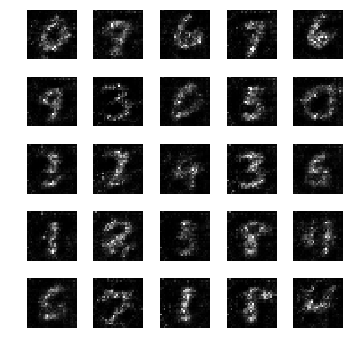

epoch: 521, time: 4.957219 | train_G_Loss: 0.528323, train_D_loss: 3.027617, train_acc: 0.789062
cv_G_Loss: 1.417072, cv_D_loss: 3.842985, cv_acc: 0.842600

epoch: 522, time: 4.911786 | train_G_Loss: 0.347733, train_D_loss: 2.951264, train_acc: 0.808594
cv_G_Loss: 1.189569, cv_D_loss: 3.499003, cv_acc: 0.767800

epoch: 523, time: 4.928725 | train_G_Loss: 0.386508, train_D_loss: 2.545028, train_acc: 0.855469
cv_G_Loss: 0.456867, cv_D_loss: 2.766200, cv_acc: 0.810600

epoch: 524, time: 4.917108 | train_G_Loss: 0.432594, train_D_loss: 3.756386, train_acc: 0.843750
cv_G_Loss: 0.753358, cv_D_loss: 3.012065, cv_acc: 0.784200

epoch: 525, time: 4.933508 | train_G_Loss: 0.395355, train_D_loss: 2.441455, train_acc: 0.828125
cv_G_Loss: 1.124343, cv_D_loss: 4.224363, cv_acc: 0.723900

epoch: 526, time: 4.938195 | train_G_Loss: 0.341271, train_D_loss: 2.707448, train_acc: 0.826172
cv_G_Loss: 0.464044, cv_D_loss: 2.917744, cv_acc: 0.818600

epoch: 527, time: 4.929291 | train_G_Loss: 0.375572, train

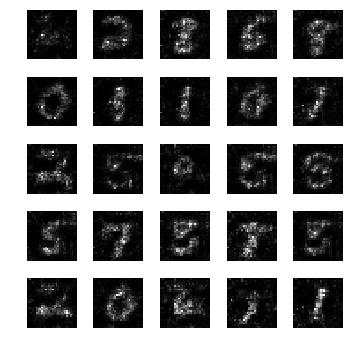

epoch: 531, time: 4.954380 | train_G_Loss: 0.319620, train_D_loss: 3.096154, train_acc: 0.822266
cv_G_Loss: 0.549607, cv_D_loss: 2.730965, cv_acc: 0.829300

epoch: 532, time: 4.928729 | train_G_Loss: 0.373703, train_D_loss: 2.582171, train_acc: 0.876953
cv_G_Loss: 0.295200, cv_D_loss: 2.903457, cv_acc: 0.817900

epoch: 533, time: 4.939322 | train_G_Loss: 0.303398, train_D_loss: 2.376629, train_acc: 0.828125
cv_G_Loss: 0.368489, cv_D_loss: 3.182993, cv_acc: 0.709100

epoch: 534, time: 4.935133 | train_G_Loss: 0.437243, train_D_loss: 2.693666, train_acc: 0.820312
cv_G_Loss: 0.279325, cv_D_loss: 2.806758, cv_acc: 0.815600

epoch: 535, time: 4.930032 | train_G_Loss: 0.473757, train_D_loss: 2.642133, train_acc: 0.835938
cv_G_Loss: 0.842941, cv_D_loss: 3.069076, cv_acc: 0.817400

epoch: 536, time: 4.925245 | train_G_Loss: 0.328332, train_D_loss: 2.542831, train_acc: 0.851562
cv_G_Loss: 0.336377, cv_D_loss: 2.638725, cv_acc: 0.853100
Model saved

epoch: 537, time: 4.949631 | train_G_Loss: 0.4

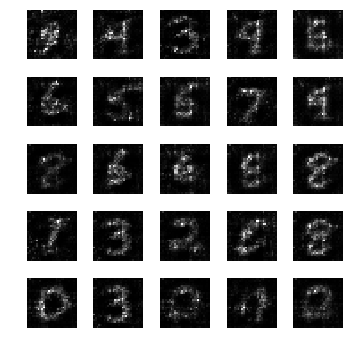

epoch: 541, time: 4.954546 | train_G_Loss: 0.333851, train_D_loss: 2.278732, train_acc: 0.863281
cv_G_Loss: 0.384074, cv_D_loss: 2.697796, cv_acc: 0.849000

epoch: 542, time: 4.927740 | train_G_Loss: 0.413359, train_D_loss: 2.172194, train_acc: 0.867188
cv_G_Loss: 0.681382, cv_D_loss: 3.355943, cv_acc: 0.731100

epoch: 543, time: 4.909175 | train_G_Loss: 0.425898, train_D_loss: 3.027181, train_acc: 0.863281
cv_G_Loss: 0.650501, cv_D_loss: 2.796675, cv_acc: 0.838600

epoch: 544, time: 4.917459 | train_G_Loss: 0.333698, train_D_loss: 2.462259, train_acc: 0.884766
cv_G_Loss: 0.338227, cv_D_loss: 2.763711, cv_acc: 0.830200

epoch: 545, time: 4.925412 | train_G_Loss: 0.390676, train_D_loss: 2.486862, train_acc: 0.882812
cv_G_Loss: 0.380590, cv_D_loss: 2.656981, cv_acc: 0.808600

epoch: 546, time: 4.922740 | train_G_Loss: 0.413745, train_D_loss: 2.784138, train_acc: 0.865234
cv_G_Loss: 0.378788, cv_D_loss: 2.632941, cv_acc: 0.850700

epoch: 547, time: 4.923009 | train_G_Loss: 0.420694, train

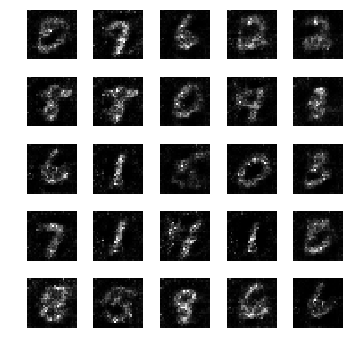

epoch: 551, time: 4.952785 | train_G_Loss: 0.349467, train_D_loss: 3.007241, train_acc: 0.898438
cv_G_Loss: 0.553407, cv_D_loss: 2.630330, cv_acc: 0.855500
Model saved

epoch: 552, time: 4.944971 | train_G_Loss: 0.415267, train_D_loss: 2.122113, train_acc: 0.908203
cv_G_Loss: 0.187697, cv_D_loss: 3.053766, cv_acc: 0.799800

epoch: 553, time: 4.919381 | train_G_Loss: 0.352273, train_D_loss: 2.564485, train_acc: 0.917969
cv_G_Loss: 0.173302, cv_D_loss: 3.148279, cv_acc: 0.790400

epoch: 554, time: 4.906549 | train_G_Loss: 0.449085, train_D_loss: 2.475086, train_acc: 0.929688
cv_G_Loss: 1.647130, cv_D_loss: 4.884109, cv_acc: 0.739600

epoch: 555, time: 4.907581 | train_G_Loss: 0.394745, train_D_loss: 2.788739, train_acc: 0.906250
cv_G_Loss: 0.774117, cv_D_loss: 3.088952, cv_acc: 0.752300

epoch: 556, time: 4.901090 | train_G_Loss: 0.413965, train_D_loss: 3.127530, train_acc: 0.908203
cv_G_Loss: 1.689079, cv_D_loss: 4.861530, cv_acc: 0.731800

epoch: 557, time: 4.905477 | train_G_Loss: 0.2

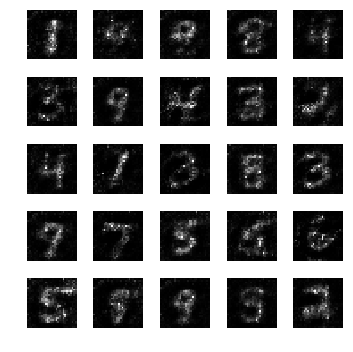

epoch: 561, time: 4.943092 | train_G_Loss: 0.286132, train_D_loss: 3.798895, train_acc: 0.847656
cv_G_Loss: 0.229670, cv_D_loss: 3.258177, cv_acc: 0.726300

epoch: 562, time: 4.914459 | train_G_Loss: 0.452670, train_D_loss: 2.227214, train_acc: 0.855469
cv_G_Loss: 0.426616, cv_D_loss: 2.638138, cv_acc: 0.857800
Model saved

epoch: 563, time: 4.927870 | train_G_Loss: 0.400915, train_D_loss: 2.734681, train_acc: 0.845703
cv_G_Loss: 1.371748, cv_D_loss: 4.363873, cv_acc: 0.786400

epoch: 564, time: 4.897441 | train_G_Loss: 0.402417, train_D_loss: 2.486547, train_acc: 0.826172
cv_G_Loss: 0.606712, cv_D_loss: 2.811741, cv_acc: 0.850200

epoch: 565, time: 4.897540 | train_G_Loss: 0.408625, train_D_loss: 2.438059, train_acc: 0.833984
cv_G_Loss: 0.194223, cv_D_loss: 2.949993, cv_acc: 0.816000

epoch: 566, time: 4.899063 | train_G_Loss: 0.338820, train_D_loss: 3.354659, train_acc: 0.847656
cv_G_Loss: 0.532106, cv_D_loss: 2.712376, cv_acc: 0.847100

epoch: 567, time: 4.909374 | train_G_Loss: 0.3

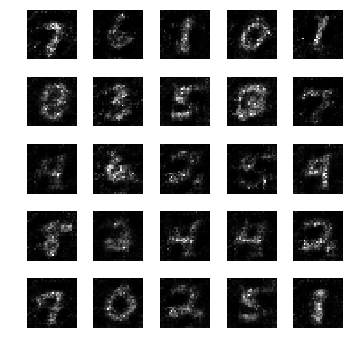

epoch: 571, time: 4.923406 | train_G_Loss: 0.431344, train_D_loss: 2.324253, train_acc: 0.865234
cv_G_Loss: 0.803799, cv_D_loss: 3.166965, cv_acc: 0.828800

epoch: 572, time: 4.911115 | train_G_Loss: 0.401494, train_D_loss: 3.289726, train_acc: 0.839844
cv_G_Loss: 0.139937, cv_D_loss: 3.183831, cv_acc: 0.799300

epoch: 573, time: 4.904364 | train_G_Loss: 0.413241, train_D_loss: 2.600068, train_acc: 0.851562
cv_G_Loss: 1.484459, cv_D_loss: 3.923031, cv_acc: 0.833400

epoch: 574, time: 4.916434 | train_G_Loss: 0.388134, train_D_loss: 2.203119, train_acc: 0.892578
cv_G_Loss: 0.621319, cv_D_loss: 2.615837, cv_acc: 0.838800

epoch: 575, time: 4.899202 | train_G_Loss: 0.392391, train_D_loss: 2.238911, train_acc: 0.876953
cv_G_Loss: 0.335474, cv_D_loss: 2.634396, cv_acc: 0.858400
Model saved

epoch: 576, time: 4.945712 | train_G_Loss: 0.384924, train_D_loss: 2.571219, train_acc: 0.880859
cv_G_Loss: 0.381570, cv_D_loss: 2.685297, cv_acc: 0.849900

epoch: 577, time: 4.943950 | train_G_Loss: 0.3

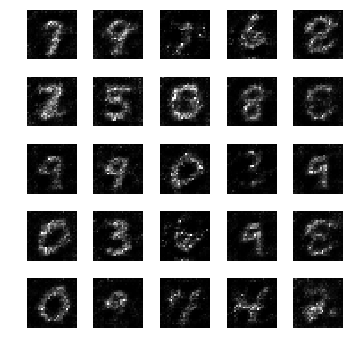

epoch: 581, time: 4.933001 | train_G_Loss: 0.441395, train_D_loss: 2.610278, train_acc: 0.859375
cv_G_Loss: 0.645907, cv_D_loss: 2.956321, cv_acc: 0.805100

epoch: 582, time: 4.907827 | train_G_Loss: 0.331888, train_D_loss: 2.568444, train_acc: 0.824219
cv_G_Loss: 0.975276, cv_D_loss: 3.184452, cv_acc: 0.854500

epoch: 583, time: 4.921383 | train_G_Loss: 0.407564, train_D_loss: 2.369363, train_acc: 0.845703
cv_G_Loss: 0.198962, cv_D_loss: 2.946317, cv_acc: 0.830800

epoch: 584, time: 4.908645 | train_G_Loss: 0.351902, train_D_loss: 3.500871, train_acc: 0.802734
cv_G_Loss: 0.488969, cv_D_loss: 2.948167, cv_acc: 0.774600

epoch: 585, time: 4.909736 | train_G_Loss: 0.314545, train_D_loss: 2.962151, train_acc: 0.789062
cv_G_Loss: 0.461920, cv_D_loss: 2.677476, cv_acc: 0.851700

epoch: 586, time: 4.906002 | train_G_Loss: 0.496295, train_D_loss: 2.208614, train_acc: 0.847656
cv_G_Loss: 1.281304, cv_D_loss: 4.444691, cv_acc: 0.657800

epoch: 587, time: 4.904775 | train_G_Loss: 0.311259, train

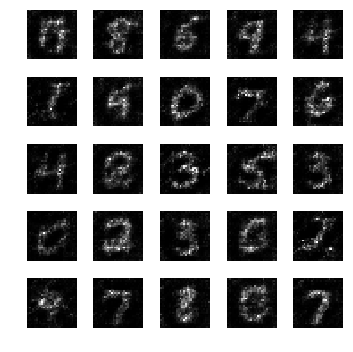

epoch: 591, time: 4.941891 | train_G_Loss: 0.337943, train_D_loss: 2.654442, train_acc: 0.863281
cv_G_Loss: 0.797209, cv_D_loss: 2.854206, cv_acc: 0.855800

epoch: 592, time: 4.927125 | train_G_Loss: 0.429366, train_D_loss: 2.767617, train_acc: 0.859375
cv_G_Loss: 0.741507, cv_D_loss: 3.508577, cv_acc: 0.737400

epoch: 593, time: 4.927640 | train_G_Loss: 0.342086, train_D_loss: 2.362730, train_acc: 0.833984
cv_G_Loss: 0.496164, cv_D_loss: 2.639107, cv_acc: 0.860200

epoch: 594, time: 4.919393 | train_G_Loss: 0.407695, train_D_loss: 3.030002, train_acc: 0.796875
cv_G_Loss: 0.585776, cv_D_loss: 2.818564, cv_acc: 0.837000

epoch: 595, time: 4.916200 | train_G_Loss: 0.487794, train_D_loss: 2.323302, train_acc: 0.837891
cv_G_Loss: 0.443647, cv_D_loss: 2.742253, cv_acc: 0.844800

epoch: 596, time: 4.923940 | train_G_Loss: 0.404646, train_D_loss: 2.985376, train_acc: 0.875000
cv_G_Loss: 0.899189, cv_D_loss: 2.966075, cv_acc: 0.858700

epoch: 597, time: 4.905970 | train_G_Loss: 0.408803, train

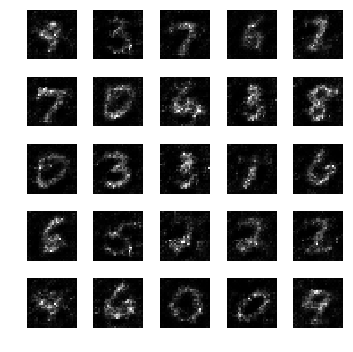

epoch: 601, time: 4.943246 | train_G_Loss: 0.405483, train_D_loss: 2.533063, train_acc: 0.867188
cv_G_Loss: 1.580898, cv_D_loss: 4.163749, cv_acc: 0.859000

epoch: 602, time: 4.917096 | train_G_Loss: 0.455813, train_D_loss: 2.523718, train_acc: 0.898438
cv_G_Loss: 0.668481, cv_D_loss: 2.888889, cv_acc: 0.854000

epoch: 603, time: 4.929507 | train_G_Loss: 0.381229, train_D_loss: 2.354805, train_acc: 0.894531
cv_G_Loss: 0.851155, cv_D_loss: 3.165275, cv_acc: 0.863600
Model saved

epoch: 604, time: 4.943826 | train_G_Loss: 0.471924, train_D_loss: 2.453517, train_acc: 0.886719
cv_G_Loss: 0.931696, cv_D_loss: 3.053840, cv_acc: 0.843800

epoch: 605, time: 4.923466 | train_G_Loss: 0.341099, train_D_loss: 2.511170, train_acc: 0.857422
cv_G_Loss: 0.343270, cv_D_loss: 3.087950, cv_acc: 0.750000

epoch: 606, time: 4.925897 | train_G_Loss: 0.417124, train_D_loss: 2.721532, train_acc: 0.863281
cv_G_Loss: 0.482122, cv_D_loss: 2.719078, cv_acc: 0.834300

epoch: 607, time: 4.925643 | train_G_Loss: 0.3

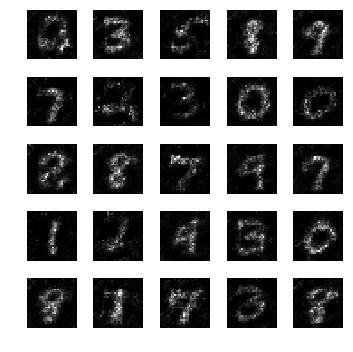

epoch: 611, time: 4.926172 | train_G_Loss: 0.415588, train_D_loss: 2.915191, train_acc: 0.845703
cv_G_Loss: 0.763591, cv_D_loss: 2.975725, cv_acc: 0.854100

epoch: 612, time: 4.917903 | train_G_Loss: 0.428438, train_D_loss: 2.950946, train_acc: 0.837891
cv_G_Loss: 0.560976, cv_D_loss: 2.809131, cv_acc: 0.847700

epoch: 613, time: 4.914362 | train_G_Loss: 0.429554, train_D_loss: 2.685998, train_acc: 0.845703
cv_G_Loss: 0.422080, cv_D_loss: 2.882001, cv_acc: 0.781700

epoch: 614, time: 4.903581 | train_G_Loss: 0.376815, train_D_loss: 2.780765, train_acc: 0.896484
cv_G_Loss: 0.540931, cv_D_loss: 2.815687, cv_acc: 0.830000

epoch: 615, time: 4.929440 | train_G_Loss: 0.375852, train_D_loss: 2.596001, train_acc: 0.875000
cv_G_Loss: 0.339007, cv_D_loss: 2.753289, cv_acc: 0.834000

epoch: 616, time: 4.927088 | train_G_Loss: 0.314489, train_D_loss: 2.717989, train_acc: 0.837891
cv_G_Loss: 0.527020, cv_D_loss: 2.845660, cv_acc: 0.831600

epoch: 617, time: 4.916248 | train_G_Loss: 0.469986, train

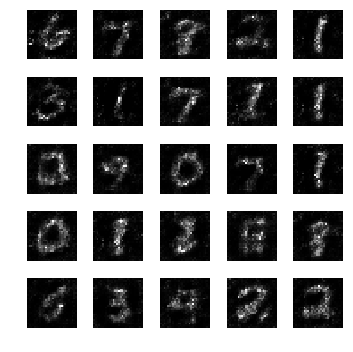

epoch: 621, time: 4.944230 | train_G_Loss: 0.379991, train_D_loss: 2.535681, train_acc: 0.855469
cv_G_Loss: 0.207719, cv_D_loss: 3.182605, cv_acc: 0.699800

epoch: 622, time: 4.902982 | train_G_Loss: 0.284683, train_D_loss: 2.267838, train_acc: 0.857422
cv_G_Loss: 0.391444, cv_D_loss: 2.944675, cv_acc: 0.786300

epoch: 623, time: 4.923963 | train_G_Loss: 0.376956, train_D_loss: 2.752042, train_acc: 0.820312
cv_G_Loss: 0.248642, cv_D_loss: 2.893077, cv_acc: 0.827800

epoch: 624, time: 4.902220 | train_G_Loss: 0.289134, train_D_loss: 3.292501, train_acc: 0.814453
cv_G_Loss: 0.838415, cv_D_loss: 3.139799, cv_acc: 0.825700

epoch: 625, time: 4.915701 | train_G_Loss: 0.422430, train_D_loss: 2.430357, train_acc: 0.865234
cv_G_Loss: 0.470094, cv_D_loss: 2.750856, cv_acc: 0.846100

epoch: 626, time: 4.903329 | train_G_Loss: 0.418635, train_D_loss: 2.521356, train_acc: 0.873047
cv_G_Loss: 0.650924, cv_D_loss: 2.724623, cv_acc: 0.866700
Model saved

epoch: 627, time: 4.951260 | train_G_Loss: 0.3

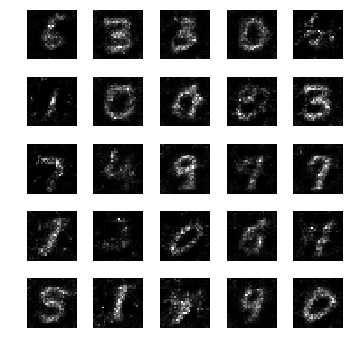

epoch: 631, time: 4.944328 | train_G_Loss: 0.338712, train_D_loss: 3.037484, train_acc: 0.859375
cv_G_Loss: 0.295525, cv_D_loss: 2.703733, cv_acc: 0.865400

epoch: 632, time: 4.926842 | train_G_Loss: 0.352049, train_D_loss: 2.633859, train_acc: 0.853516
cv_G_Loss: 0.351302, cv_D_loss: 2.696279, cv_acc: 0.820700

epoch: 633, time: 4.920674 | train_G_Loss: 0.343734, train_D_loss: 3.182661, train_acc: 0.845703
cv_G_Loss: 0.387126, cv_D_loss: 2.850887, cv_acc: 0.799600

epoch: 634, time: 4.915501 | train_G_Loss: 0.315558, train_D_loss: 2.650647, train_acc: 0.869141
cv_G_Loss: 0.309054, cv_D_loss: 2.776274, cv_acc: 0.826300

epoch: 635, time: 4.908203 | train_G_Loss: 0.413723, train_D_loss: 2.319775, train_acc: 0.876953
cv_G_Loss: 0.520538, cv_D_loss: 2.649866, cv_acc: 0.848200

epoch: 636, time: 4.913156 | train_G_Loss: 0.304554, train_D_loss: 2.901997, train_acc: 0.857422
cv_G_Loss: 0.232844, cv_D_loss: 2.962011, cv_acc: 0.812400

epoch: 637, time: 4.909542 | train_G_Loss: 0.426086, train

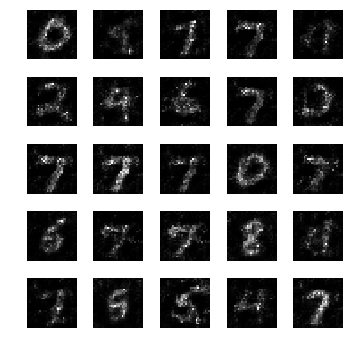

epoch: 641, time: 4.936894 | train_G_Loss: 0.372275, train_D_loss: 2.261430, train_acc: 0.830078
cv_G_Loss: 0.421332, cv_D_loss: 2.717043, cv_acc: 0.850100

epoch: 642, time: 4.910492 | train_G_Loss: 0.339173, train_D_loss: 2.990342, train_acc: 0.812500
cv_G_Loss: 0.350768, cv_D_loss: 2.873916, cv_acc: 0.814100

epoch: 643, time: 4.908683 | train_G_Loss: 0.331618, train_D_loss: 2.528249, train_acc: 0.833984
cv_G_Loss: 0.494241, cv_D_loss: 2.697895, cv_acc: 0.860100

epoch: 644, time: 4.899738 | train_G_Loss: 0.349392, train_D_loss: 2.620954, train_acc: 0.810547
cv_G_Loss: 0.673558, cv_D_loss: 2.818021, cv_acc: 0.846500

epoch: 645, time: 4.913078 | train_G_Loss: 0.373430, train_D_loss: 2.742396, train_acc: 0.832031
cv_G_Loss: 1.212395, cv_D_loss: 4.051233, cv_acc: 0.547600

epoch: 646, time: 4.904610 | train_G_Loss: 0.365830, train_D_loss: 3.175217, train_acc: 0.849609
cv_G_Loss: 0.337892, cv_D_loss: 2.739482, cv_acc: 0.849900

epoch: 647, time: 4.904583 | train_G_Loss: 0.300143, train

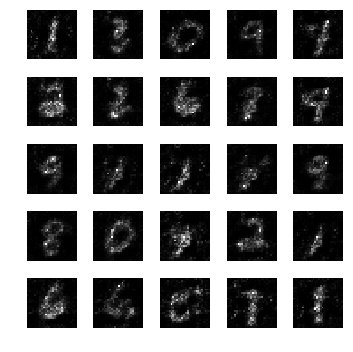

epoch: 651, time: 4.942218 | train_G_Loss: 0.342931, train_D_loss: 2.981381, train_acc: 0.869141
cv_G_Loss: 0.397406, cv_D_loss: 2.675631, cv_acc: 0.864700

epoch: 652, time: 4.914499 | train_G_Loss: 0.386764, train_D_loss: 3.461961, train_acc: 0.884766
cv_G_Loss: 0.936033, cv_D_loss: 3.399926, cv_acc: 0.598700

epoch: 653, time: 4.914492 | train_G_Loss: 0.342969, train_D_loss: 2.670688, train_acc: 0.871094
cv_G_Loss: 0.373061, cv_D_loss: 2.841431, cv_acc: 0.842800

epoch: 654, time: 4.912029 | train_G_Loss: 0.472142, train_D_loss: 2.759921, train_acc: 0.888672
cv_G_Loss: 0.505544, cv_D_loss: 3.078864, cv_acc: 0.761200

epoch: 655, time: 4.910642 | train_G_Loss: 0.333209, train_D_loss: 2.389775, train_acc: 0.904297
cv_G_Loss: 0.363218, cv_D_loss: 2.689403, cv_acc: 0.849000

epoch: 656, time: 4.919570 | train_G_Loss: 0.357214, train_D_loss: 2.510183, train_acc: 0.888672
cv_G_Loss: 0.579396, cv_D_loss: 2.788692, cv_acc: 0.866000

epoch: 657, time: 4.912418 | train_G_Loss: 0.391668, train

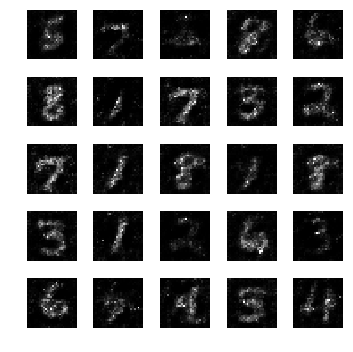

epoch: 661, time: 4.934593 | train_G_Loss: 0.426161, train_D_loss: 2.809001, train_acc: 0.873047
cv_G_Loss: 1.181675, cv_D_loss: 3.500974, cv_acc: 0.863200

epoch: 662, time: 4.908246 | train_G_Loss: 0.470080, train_D_loss: 2.600895, train_acc: 0.878906
cv_G_Loss: 0.271099, cv_D_loss: 2.754039, cv_acc: 0.866100

epoch: 663, time: 4.903329 | train_G_Loss: 0.461026, train_D_loss: 2.940898, train_acc: 0.871094
cv_G_Loss: 0.848667, cv_D_loss: 3.048524, cv_acc: 0.858800

epoch: 664, time: 4.916454 | train_G_Loss: 0.457181, train_D_loss: 2.266329, train_acc: 0.871094
cv_G_Loss: 0.943789, cv_D_loss: 3.282140, cv_acc: 0.753800

epoch: 665, time: 4.919810 | train_G_Loss: 0.317758, train_D_loss: 2.310819, train_acc: 0.892578
cv_G_Loss: 0.369607, cv_D_loss: 2.735289, cv_acc: 0.852800

epoch: 666, time: 4.905868 | train_G_Loss: 0.317630, train_D_loss: 2.334174, train_acc: 0.855469
cv_G_Loss: 0.166971, cv_D_loss: 2.934835, cv_acc: 0.858000

epoch: 667, time: 4.905527 | train_G_Loss: 0.340016, train

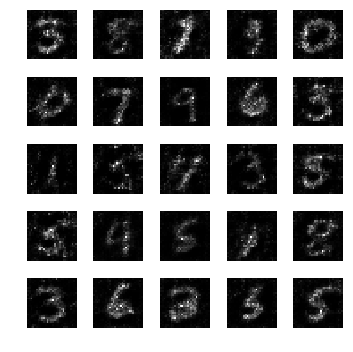

epoch: 671, time: 4.933928 | train_G_Loss: 0.346707, train_D_loss: 2.685883, train_acc: 0.882812
cv_G_Loss: 0.339860, cv_D_loss: 2.669727, cv_acc: 0.872000
Model saved

epoch: 672, time: 4.930523 | train_G_Loss: 0.357732, train_D_loss: 2.800803, train_acc: 0.898438
cv_G_Loss: 0.438938, cv_D_loss: 2.525712, cv_acc: 0.865600

epoch: 673, time: 4.910023 | train_G_Loss: 0.381026, train_D_loss: 2.518429, train_acc: 0.839844
cv_G_Loss: 0.776246, cv_D_loss: 2.916009, cv_acc: 0.868500

epoch: 674, time: 4.909887 | train_G_Loss: 0.373878, train_D_loss: 2.227663, train_acc: 0.841797
cv_G_Loss: 0.807629, cv_D_loss: 2.929390, cv_acc: 0.867000

epoch: 675, time: 4.902978 | train_G_Loss: 0.335326, train_D_loss: 2.396609, train_acc: 0.816406
cv_G_Loss: 0.520998, cv_D_loss: 3.001883, cv_acc: 0.825700

epoch: 676, time: 4.898721 | train_G_Loss: 0.446669, train_D_loss: 2.348304, train_acc: 0.841797
cv_G_Loss: 0.660754, cv_D_loss: 2.964742, cv_acc: 0.841100

epoch: 677, time: 4.917289 | train_G_Loss: 0.3

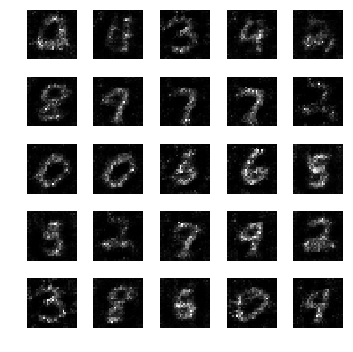

epoch: 681, time: 4.939959 | train_G_Loss: 0.365718, train_D_loss: 2.555762, train_acc: 0.826172
cv_G_Loss: 0.619076, cv_D_loss: 2.889435, cv_acc: 0.854700

epoch: 682, time: 4.901891 | train_G_Loss: 0.321399, train_D_loss: 2.626411, train_acc: 0.832031
cv_G_Loss: 0.841726, cv_D_loss: 2.876249, cv_acc: 0.869500

epoch: 683, time: 4.903431 | train_G_Loss: 0.422928, train_D_loss: 2.536136, train_acc: 0.802734
cv_G_Loss: 0.423685, cv_D_loss: 2.864450, cv_acc: 0.745000

epoch: 684, time: 4.900978 | train_G_Loss: 0.294865, train_D_loss: 2.787237, train_acc: 0.839844
cv_G_Loss: 0.406203, cv_D_loss: 2.575004, cv_acc: 0.872100
Model saved

epoch: 685, time: 4.958927 | train_G_Loss: 0.390995, train_D_loss: 2.783255, train_acc: 0.865234
cv_G_Loss: 0.966663, cv_D_loss: 3.173792, cv_acc: 0.851400

epoch: 686, time: 4.925694 | train_G_Loss: 0.450106, train_D_loss: 2.719525, train_acc: 0.867188
cv_G_Loss: 0.446334, cv_D_loss: 2.680687, cv_acc: 0.841100

epoch: 687, time: 4.917596 | train_G_Loss: 0.3

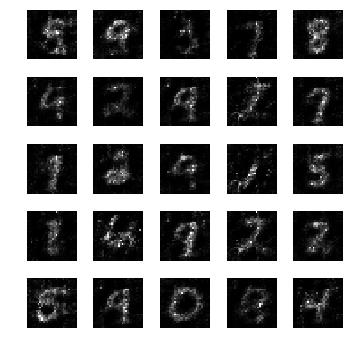

epoch: 691, time: 4.945751 | train_G_Loss: 0.333959, train_D_loss: 2.465267, train_acc: 0.906250
cv_G_Loss: 0.407232, cv_D_loss: 2.691871, cv_acc: 0.859500

epoch: 692, time: 4.912545 | train_G_Loss: 0.356479, train_D_loss: 2.741029, train_acc: 0.880859
cv_G_Loss: 0.517697, cv_D_loss: 2.661081, cv_acc: 0.865900

epoch: 693, time: 4.923001 | train_G_Loss: 0.310817, train_D_loss: 2.722277, train_acc: 0.863281
cv_G_Loss: 0.791358, cv_D_loss: 3.511878, cv_acc: 0.764300

epoch: 694, time: 4.920941 | train_G_Loss: 0.444696, train_D_loss: 2.694440, train_acc: 0.880859
cv_G_Loss: 0.669437, cv_D_loss: 2.879184, cv_acc: 0.871700

epoch: 695, time: 4.934647 | train_G_Loss: 0.405550, train_D_loss: 2.408050, train_acc: 0.876953
cv_G_Loss: 0.376844, cv_D_loss: 2.768085, cv_acc: 0.848300

epoch: 696, time: 4.930861 | train_G_Loss: 0.379804, train_D_loss: 3.366213, train_acc: 0.843750
cv_G_Loss: 0.680622, cv_D_loss: 2.808704, cv_acc: 0.864200

epoch: 697, time: 4.918295 | train_G_Loss: 0.329963, train

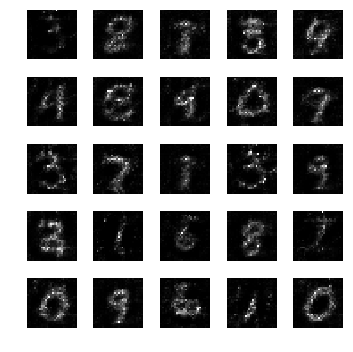

epoch: 701, time: 4.950292 | train_G_Loss: 0.379811, train_D_loss: 2.990742, train_acc: 0.863281
cv_G_Loss: 0.264199, cv_D_loss: 2.865089, cv_acc: 0.810200

epoch: 702, time: 4.928045 | train_G_Loss: 0.377176, train_D_loss: 2.429841, train_acc: 0.855469
cv_G_Loss: 0.937688, cv_D_loss: 3.590365, cv_acc: 0.787500

epoch: 703, time: 4.931946 | train_G_Loss: 0.391369, train_D_loss: 2.724385, train_acc: 0.851562
cv_G_Loss: 0.355336, cv_D_loss: 2.740760, cv_acc: 0.836500

epoch: 704, time: 4.921163 | train_G_Loss: 0.376989, train_D_loss: 2.325546, train_acc: 0.900391
cv_G_Loss: 0.589949, cv_D_loss: 2.816464, cv_acc: 0.863000

epoch: 705, time: 4.930647 | train_G_Loss: 0.332244, train_D_loss: 2.409840, train_acc: 0.875000
cv_G_Loss: 0.323702, cv_D_loss: 3.071542, cv_acc: 0.736000

epoch: 706, time: 4.929047 | train_G_Loss: 0.331250, train_D_loss: 2.762221, train_acc: 0.839844
cv_G_Loss: 0.733138, cv_D_loss: 2.869911, cv_acc: 0.871600

epoch: 707, time: 4.932998 | train_G_Loss: 0.260340, train

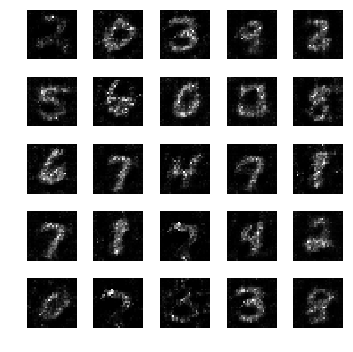

epoch: 711, time: 4.952675 | train_G_Loss: 0.414476, train_D_loss: 2.383337, train_acc: 0.861328
cv_G_Loss: 0.903113, cv_D_loss: 3.130780, cv_acc: 0.860800

epoch: 712, time: 4.917236 | train_G_Loss: 0.293231, train_D_loss: 2.683692, train_acc: 0.845703
cv_G_Loss: 0.622419, cv_D_loss: 2.890314, cv_acc: 0.834200

epoch: 713, time: 4.919543 | train_G_Loss: 0.445668, train_D_loss: 2.969028, train_acc: 0.837891
cv_G_Loss: 0.491446, cv_D_loss: 2.887423, cv_acc: 0.856700

epoch: 714, time: 4.932922 | train_G_Loss: 0.331049, train_D_loss: 2.842111, train_acc: 0.865234
cv_G_Loss: 0.789008, cv_D_loss: 2.860195, cv_acc: 0.875900
Model saved

epoch: 715, time: 4.952486 | train_G_Loss: 0.485785, train_D_loss: 2.262474, train_acc: 0.904297
cv_G_Loss: 1.344520, cv_D_loss: 3.754963, cv_acc: 0.853500

epoch: 716, time: 4.928506 | train_G_Loss: 0.326533, train_D_loss: 2.944848, train_acc: 0.865234
cv_G_Loss: 0.299140, cv_D_loss: 2.700614, cv_acc: 0.869900

epoch: 717, time: 4.921580 | train_G_Loss: 0.3

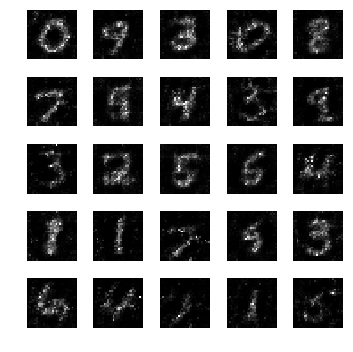

epoch: 721, time: 4.954314 | train_G_Loss: 0.434861, train_D_loss: 2.630768, train_acc: 0.894531
cv_G_Loss: 1.037969, cv_D_loss: 3.178025, cv_acc: 0.837200

epoch: 722, time: 4.925030 | train_G_Loss: 0.425058, train_D_loss: 2.746070, train_acc: 0.876953
cv_G_Loss: 0.787823, cv_D_loss: 2.874646, cv_acc: 0.864000

epoch: 723, time: 4.924843 | train_G_Loss: 0.354662, train_D_loss: 2.604299, train_acc: 0.875000
cv_G_Loss: 0.390799, cv_D_loss: 2.740087, cv_acc: 0.844400

epoch: 724, time: 4.927127 | train_G_Loss: 0.372276, train_D_loss: 2.960278, train_acc: 0.898438
cv_G_Loss: 0.253784, cv_D_loss: 2.701812, cv_acc: 0.871100

epoch: 725, time: 4.909039 | train_G_Loss: 0.286785, train_D_loss: 2.776927, train_acc: 0.878906
cv_G_Loss: 0.288256, cv_D_loss: 2.679125, cv_acc: 0.849900

epoch: 726, time: 4.924661 | train_G_Loss: 0.360168, train_D_loss: 2.417895, train_acc: 0.869141
cv_G_Loss: 0.567435, cv_D_loss: 2.719449, cv_acc: 0.817400

epoch: 727, time: 4.930059 | train_G_Loss: 0.358261, train

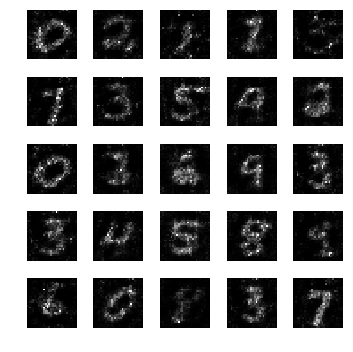

epoch: 731, time: 4.946521 | train_G_Loss: 0.350377, train_D_loss: 2.581270, train_acc: 0.865234
cv_G_Loss: 0.760452, cv_D_loss: 3.118693, cv_acc: 0.830900

epoch: 732, time: 4.947926 | train_G_Loss: 0.292378, train_D_loss: 3.205807, train_acc: 0.902344
cv_G_Loss: 0.519001, cv_D_loss: 2.648299, cv_acc: 0.854000

epoch: 733, time: 4.928480 | train_G_Loss: 0.451902, train_D_loss: 2.315710, train_acc: 0.882812
cv_G_Loss: 0.609750, cv_D_loss: 3.248960, cv_acc: 0.728700

epoch: 734, time: 4.927200 | train_G_Loss: 0.446568, train_D_loss: 2.349467, train_acc: 0.833984
cv_G_Loss: 0.440718, cv_D_loss: 2.691212, cv_acc: 0.850600

epoch: 735, time: 4.929222 | train_G_Loss: 0.335420, train_D_loss: 2.878659, train_acc: 0.886719
cv_G_Loss: 0.272183, cv_D_loss: 2.711566, cv_acc: 0.852800

epoch: 736, time: 4.932056 | train_G_Loss: 0.344452, train_D_loss: 2.539930, train_acc: 0.896484
cv_G_Loss: 0.528745, cv_D_loss: 2.711958, cv_acc: 0.872200

epoch: 737, time: 4.936221 | train_G_Loss: 0.378578, train

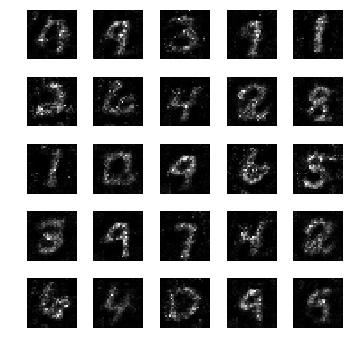

epoch: 741, time: 4.932225 | train_G_Loss: 0.478634, train_D_loss: 2.245083, train_acc: 0.912109
cv_G_Loss: 2.045543, cv_D_loss: 5.126622, cv_acc: 0.821700

epoch: 742, time: 4.907401 | train_G_Loss: 0.362151, train_D_loss: 2.895717, train_acc: 0.929688
cv_G_Loss: 0.465015, cv_D_loss: 2.738024, cv_acc: 0.853500

epoch: 743, time: 4.920731 | train_G_Loss: 0.368261, train_D_loss: 2.724749, train_acc: 0.882812
cv_G_Loss: 1.538221, cv_D_loss: 4.362645, cv_acc: 0.746300

epoch: 744, time: 4.918178 | train_G_Loss: 0.441204, train_D_loss: 2.260762, train_acc: 0.869141
cv_G_Loss: 1.245135, cv_D_loss: 3.510651, cv_acc: 0.880900
Model saved

epoch: 745, time: 4.943536 | train_G_Loss: 0.308443, train_D_loss: 3.614156, train_acc: 0.876953
cv_G_Loss: 0.368345, cv_D_loss: 3.014254, cv_acc: 0.753300

epoch: 746, time: 4.945459 | train_G_Loss: 0.315075, train_D_loss: 2.747175, train_acc: 0.904297
cv_G_Loss: 0.563314, cv_D_loss: 2.658619, cv_acc: 0.879100

epoch: 747, time: 4.920500 | train_G_Loss: 0.3

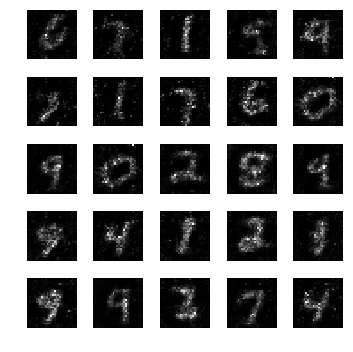

epoch: 751, time: 4.922111 | train_G_Loss: 0.308913, train_D_loss: 2.497602, train_acc: 0.888672
cv_G_Loss: 0.292123, cv_D_loss: 2.608316, cv_acc: 0.881200
Model saved

epoch: 752, time: 4.945548 | train_G_Loss: 0.392927, train_D_loss: 2.439400, train_acc: 0.878906
cv_G_Loss: 0.935050, cv_D_loss: 3.274518, cv_acc: 0.831600

epoch: 753, time: 4.916194 | train_G_Loss: 0.320261, train_D_loss: 2.878055, train_acc: 0.875000
cv_G_Loss: 0.539700, cv_D_loss: 2.685045, cv_acc: 0.856000

epoch: 754, time: 4.932784 | train_G_Loss: 0.406637, train_D_loss: 2.680976, train_acc: 0.859375
cv_G_Loss: 0.694376, cv_D_loss: 3.137610, cv_acc: 0.813500

epoch: 755, time: 4.927068 | train_G_Loss: 0.361023, train_D_loss: 3.269084, train_acc: 0.820312
cv_G_Loss: 0.550354, cv_D_loss: 2.630154, cv_acc: 0.871100

epoch: 756, time: 4.924003 | train_G_Loss: 0.371412, train_D_loss: 2.726996, train_acc: 0.855469
cv_G_Loss: 0.521998, cv_D_loss: 2.847076, cv_acc: 0.837300

epoch: 757, time: 4.931094 | train_G_Loss: 0.3

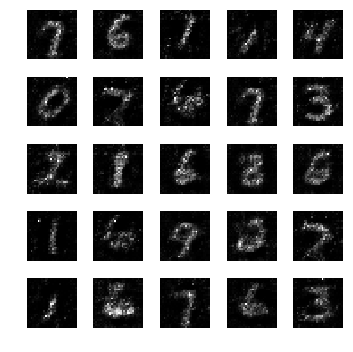

epoch: 761, time: 4.954465 | train_G_Loss: 0.350515, train_D_loss: 3.348203, train_acc: 0.892578
cv_G_Loss: 0.645259, cv_D_loss: 3.109205, cv_acc: 0.812500

epoch: 762, time: 4.914397 | train_G_Loss: 0.366079, train_D_loss: 2.216347, train_acc: 0.894531
cv_G_Loss: 0.799714, cv_D_loss: 2.916481, cv_acc: 0.857400

epoch: 763, time: 4.923747 | train_G_Loss: 0.350369, train_D_loss: 2.625671, train_acc: 0.890625
cv_G_Loss: 0.457226, cv_D_loss: 2.626542, cv_acc: 0.859400

epoch: 764, time: 4.920430 | train_G_Loss: 0.388282, train_D_loss: 2.589847, train_acc: 0.898438
cv_G_Loss: 0.619342, cv_D_loss: 2.754787, cv_acc: 0.872600

epoch: 765, time: 4.918716 | train_G_Loss: 0.380069, train_D_loss: 2.528754, train_acc: 0.876953
cv_G_Loss: 0.446621, cv_D_loss: 2.495000, cv_acc: 0.871400

epoch: 766, time: 4.923377 | train_G_Loss: 0.379517, train_D_loss: 2.318129, train_acc: 0.845703
cv_G_Loss: 0.451646, cv_D_loss: 2.743783, cv_acc: 0.859500

epoch: 767, time: 4.909509 | train_G_Loss: 0.327828, train

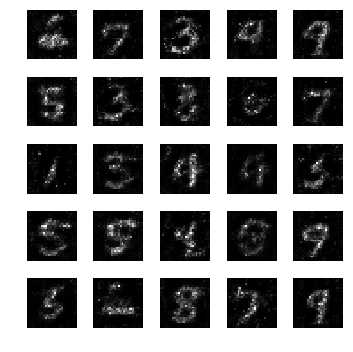

epoch: 771, time: 4.926881 | train_G_Loss: 0.390474, train_D_loss: 2.904920, train_acc: 0.855469
cv_G_Loss: 0.614551, cv_D_loss: 3.050141, cv_acc: 0.822800

epoch: 772, time: 4.916411 | train_G_Loss: 0.306976, train_D_loss: 2.297709, train_acc: 0.880859
cv_G_Loss: 0.477594, cv_D_loss: 2.609661, cv_acc: 0.877700

epoch: 773, time: 4.914778 | train_G_Loss: 0.340653, train_D_loss: 2.489469, train_acc: 0.865234
cv_G_Loss: 0.687773, cv_D_loss: 2.707086, cv_acc: 0.870500

epoch: 774, time: 4.914409 | train_G_Loss: 0.359159, train_D_loss: 2.555361, train_acc: 0.835938
cv_G_Loss: 0.567468, cv_D_loss: 2.727899, cv_acc: 0.871300

epoch: 775, time: 4.918986 | train_G_Loss: 0.387048, train_D_loss: 2.419893, train_acc: 0.841797
cv_G_Loss: 0.418060, cv_D_loss: 2.742279, cv_acc: 0.860000

epoch: 776, time: 4.909082 | train_G_Loss: 0.404902, train_D_loss: 3.264687, train_acc: 0.851562
cv_G_Loss: 0.644618, cv_D_loss: 2.879376, cv_acc: 0.865100

epoch: 777, time: 4.974660 | train_G_Loss: 0.345444, train

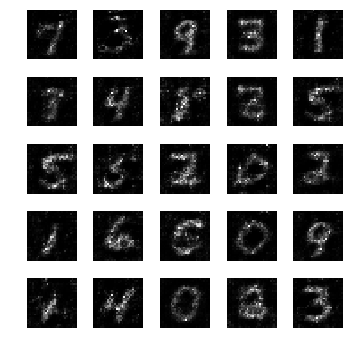

epoch: 781, time: 4.944596 | train_G_Loss: 0.372100, train_D_loss: 2.746535, train_acc: 0.869141
cv_G_Loss: 0.507316, cv_D_loss: 2.625415, cv_acc: 0.871000

epoch: 782, time: 4.916010 | train_G_Loss: 0.326033, train_D_loss: 2.384714, train_acc: 0.900391
cv_G_Loss: 1.097372, cv_D_loss: 3.507847, cv_acc: 0.853600

epoch: 783, time: 4.915999 | train_G_Loss: 0.370940, train_D_loss: 2.492282, train_acc: 0.863281
cv_G_Loss: 0.225115, cv_D_loss: 2.790072, cv_acc: 0.849400

epoch: 784, time: 4.915581 | train_G_Loss: 0.381167, train_D_loss: 2.262400, train_acc: 0.863281
cv_G_Loss: 0.285356, cv_D_loss: 2.743437, cv_acc: 0.852100

epoch: 785, time: 4.926862 | train_G_Loss: 0.365967, train_D_loss: 2.293450, train_acc: 0.867188
cv_G_Loss: 0.519691, cv_D_loss: 2.641325, cv_acc: 0.874800

epoch: 786, time: 4.918741 | train_G_Loss: 0.275437, train_D_loss: 2.425791, train_acc: 0.863281
cv_G_Loss: 0.541268, cv_D_loss: 2.600698, cv_acc: 0.879200

epoch: 787, time: 4.908332 | train_G_Loss: 0.325570, train

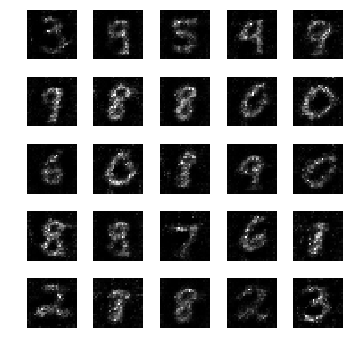

epoch: 791, time: 4.963574 | train_G_Loss: 0.468410, train_D_loss: 2.403198, train_acc: 0.876953
cv_G_Loss: 0.481929, cv_D_loss: 2.749094, cv_acc: 0.862400

epoch: 792, time: 4.928452 | train_G_Loss: 0.365251, train_D_loss: 2.393088, train_acc: 0.888672
cv_G_Loss: 0.685018, cv_D_loss: 2.754934, cv_acc: 0.879900

epoch: 793, time: 4.929609 | train_G_Loss: 0.332479, train_D_loss: 2.461233, train_acc: 0.910156
cv_G_Loss: 0.433766, cv_D_loss: 2.592618, cv_acc: 0.883400

epoch: 794, time: 4.926433 | train_G_Loss: 0.330475, train_D_loss: 2.700874, train_acc: 0.875000
cv_G_Loss: 0.658535, cv_D_loss: 2.969455, cv_acc: 0.838200

epoch: 795, time: 4.936812 | train_G_Loss: 0.323611, train_D_loss: 2.286310, train_acc: 0.900391
cv_G_Loss: 0.739274, cv_D_loss: 2.986041, cv_acc: 0.855700

epoch: 796, time: 4.922782 | train_G_Loss: 0.340305, train_D_loss: 2.316482, train_acc: 0.898438
cv_G_Loss: 0.553936, cv_D_loss: 2.845471, cv_acc: 0.817600

epoch: 797, time: 4.927515 | train_G_Loss: 0.354741, train

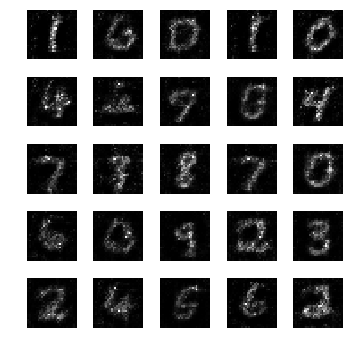

epoch: 801, time: 4.955001 | train_G_Loss: 0.453226, train_D_loss: 2.291276, train_acc: 0.910156
cv_G_Loss: 0.495819, cv_D_loss: 2.637930, cv_acc: 0.876700

epoch: 802, time: 4.943613 | train_G_Loss: 0.349710, train_D_loss: 2.823236, train_acc: 0.859375
cv_G_Loss: 0.683010, cv_D_loss: 2.904687, cv_acc: 0.872800

epoch: 803, time: 4.933984 | train_G_Loss: 0.385568, train_D_loss: 2.292604, train_acc: 0.847656
cv_G_Loss: 0.540946, cv_D_loss: 2.673353, cv_acc: 0.885400
Model saved

epoch: 804, time: 4.957788 | train_G_Loss: 0.338502, train_D_loss: 2.610089, train_acc: 0.900391
cv_G_Loss: 0.338425, cv_D_loss: 2.707592, cv_acc: 0.855900

epoch: 805, time: 4.921885 | train_G_Loss: 0.413513, train_D_loss: 2.342768, train_acc: 0.892578
cv_G_Loss: 0.718515, cv_D_loss: 2.860747, cv_acc: 0.876000

epoch: 806, time: 4.916463 | train_G_Loss: 0.350909, train_D_loss: 2.318453, train_acc: 0.876953
cv_G_Loss: 0.247765, cv_D_loss: 2.712627, cv_acc: 0.865600

epoch: 807, time: 4.935587 | train_G_Loss: 0.4

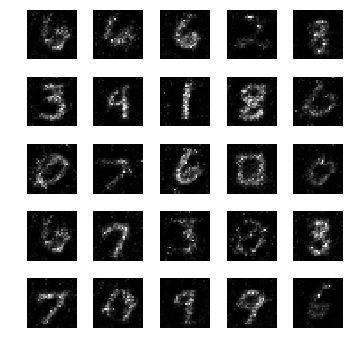

epoch: 811, time: 4.943952 | train_G_Loss: 0.369691, train_D_loss: 2.236774, train_acc: 0.865234
cv_G_Loss: 0.605184, cv_D_loss: 2.961339, cv_acc: 0.848100

epoch: 812, time: 4.913020 | train_G_Loss: 0.390317, train_D_loss: 2.747429, train_acc: 0.888672
cv_G_Loss: 0.411869, cv_D_loss: 2.810246, cv_acc: 0.823300

epoch: 813, time: 4.921382 | train_G_Loss: 0.414080, train_D_loss: 2.159304, train_acc: 0.908203
cv_G_Loss: 0.539002, cv_D_loss: 2.616779, cv_acc: 0.885000

epoch: 814, time: 4.924303 | train_G_Loss: 0.351796, train_D_loss: 2.505106, train_acc: 0.910156
cv_G_Loss: 0.497879, cv_D_loss: 2.880569, cv_acc: 0.823100

epoch: 815, time: 4.921242 | train_G_Loss: 0.465693, train_D_loss: 2.433630, train_acc: 0.898438
cv_G_Loss: 0.619012, cv_D_loss: 2.701447, cv_acc: 0.864800

epoch: 816, time: 4.907841 | train_G_Loss: 0.356237, train_D_loss: 2.362804, train_acc: 0.837891
cv_G_Loss: 0.587013, cv_D_loss: 3.023395, cv_acc: 0.803600

epoch: 817, time: 4.911671 | train_G_Loss: 0.384574, train

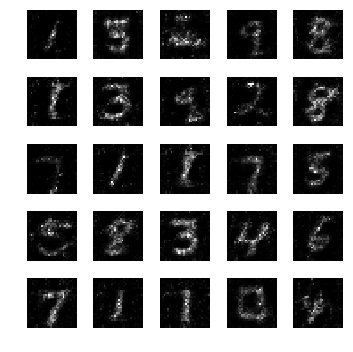

epoch: 821, time: 4.937008 | train_G_Loss: 0.459783, train_D_loss: 2.520022, train_acc: 0.892578
cv_G_Loss: 0.999115, cv_D_loss: 3.620780, cv_acc: 0.827100

epoch: 822, time: 4.915652 | train_G_Loss: 0.455859, train_D_loss: 2.328720, train_acc: 0.890625
cv_G_Loss: 0.694622, cv_D_loss: 2.816403, cv_acc: 0.886000
Model saved

epoch: 823, time: 4.931843 | train_G_Loss: 0.347484, train_D_loss: 3.134183, train_acc: 0.869141
cv_G_Loss: 0.596486, cv_D_loss: 2.747854, cv_acc: 0.852100

epoch: 824, time: 4.921261 | train_G_Loss: 0.319538, train_D_loss: 2.549545, train_acc: 0.847656
cv_G_Loss: 0.537773, cv_D_loss: 3.032859, cv_acc: 0.774900

epoch: 825, time: 4.901244 | train_G_Loss: 0.386635, train_D_loss: 3.152609, train_acc: 0.830078
cv_G_Loss: 0.739717, cv_D_loss: 2.891436, cv_acc: 0.852200

epoch: 826, time: 4.910047 | train_G_Loss: 0.359943, train_D_loss: 2.223683, train_acc: 0.851562
cv_G_Loss: 0.354588, cv_D_loss: 2.575463, cv_acc: 0.874900

epoch: 827, time: 4.911041 | train_G_Loss: 0.4

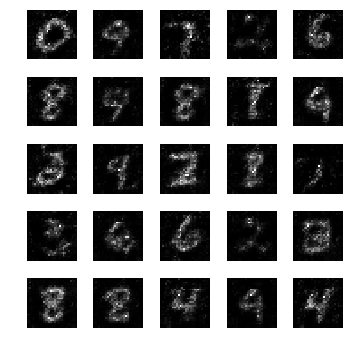

epoch: 831, time: 4.951194 | train_G_Loss: 0.438838, train_D_loss: 2.484278, train_acc: 0.859375
cv_G_Loss: 0.642172, cv_D_loss: 2.690000, cv_acc: 0.882700

epoch: 832, time: 4.917004 | train_G_Loss: 0.325717, train_D_loss: 2.353609, train_acc: 0.867188
cv_G_Loss: 0.492315, cv_D_loss: 2.656351, cv_acc: 0.874100

epoch: 833, time: 4.914310 | train_G_Loss: 0.354819, train_D_loss: 2.326671, train_acc: 0.853516
cv_G_Loss: 0.263190, cv_D_loss: 2.649627, cv_acc: 0.870600

epoch: 834, time: 4.908636 | train_G_Loss: 0.367983, train_D_loss: 3.059970, train_acc: 0.837891
cv_G_Loss: 0.539475, cv_D_loss: 2.628863, cv_acc: 0.881400

epoch: 835, time: 4.920760 | train_G_Loss: 0.304306, train_D_loss: 2.536293, train_acc: 0.810547
cv_G_Loss: 0.445295, cv_D_loss: 2.613889, cv_acc: 0.866500

epoch: 836, time: 4.916414 | train_G_Loss: 0.336441, train_D_loss: 2.873035, train_acc: 0.843750
cv_G_Loss: 0.482170, cv_D_loss: 2.757916, cv_acc: 0.835000

epoch: 837, time: 4.917967 | train_G_Loss: 0.398094, train

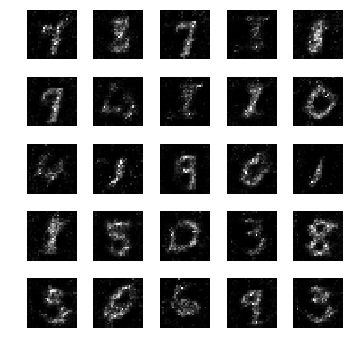

epoch: 841, time: 4.936621 | train_G_Loss: 0.346029, train_D_loss: 2.343112, train_acc: 0.912109
cv_G_Loss: 0.430835, cv_D_loss: 2.816481, cv_acc: 0.826100

epoch: 842, time: 4.920758 | train_G_Loss: 0.371297, train_D_loss: 2.564331, train_acc: 0.902344
cv_G_Loss: 0.319940, cv_D_loss: 2.649813, cv_acc: 0.874400

epoch: 843, time: 4.921474 | train_G_Loss: 0.368567, train_D_loss: 2.541436, train_acc: 0.853516
cv_G_Loss: 1.260239, cv_D_loss: 3.716592, cv_acc: 0.669000

epoch: 844, time: 4.917921 | train_G_Loss: 0.317625, train_D_loss: 2.999651, train_acc: 0.861328
cv_G_Loss: 0.545772, cv_D_loss: 2.587996, cv_acc: 0.882500

epoch: 845, time: 4.916972 | train_G_Loss: 0.305689, train_D_loss: 2.807836, train_acc: 0.880859
cv_G_Loss: 0.765279, cv_D_loss: 3.642288, cv_acc: 0.620500

epoch: 846, time: 4.931608 | train_G_Loss: 0.359574, train_D_loss: 2.260649, train_acc: 0.888672
cv_G_Loss: 0.262688, cv_D_loss: 2.625091, cv_acc: 0.887400
Model saved

epoch: 847, time: 4.947747 | train_G_Loss: 0.4

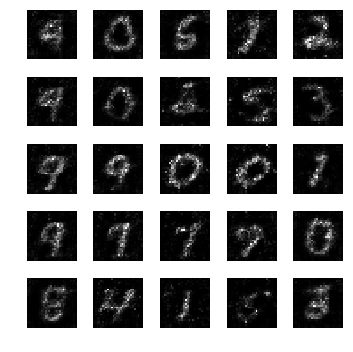

epoch: 851, time: 4.938179 | train_G_Loss: 0.374108, train_D_loss: 2.466854, train_acc: 0.884766
cv_G_Loss: 0.370880, cv_D_loss: 2.625493, cv_acc: 0.870800

epoch: 852, time: 4.918905 | train_G_Loss: 0.328484, train_D_loss: 2.390655, train_acc: 0.849609
cv_G_Loss: 0.673056, cv_D_loss: 2.815764, cv_acc: 0.881800

epoch: 853, time: 4.906173 | train_G_Loss: 0.277315, train_D_loss: 3.392817, train_acc: 0.835938
cv_G_Loss: 0.324555, cv_D_loss: 2.583888, cv_acc: 0.878200

epoch: 854, time: 4.915512 | train_G_Loss: 0.328004, train_D_loss: 2.866323, train_acc: 0.882812
cv_G_Loss: 0.290829, cv_D_loss: 2.559871, cv_acc: 0.881400

epoch: 855, time: 4.930135 | train_G_Loss: 0.347563, train_D_loss: 2.878315, train_acc: 0.894531
cv_G_Loss: 0.615010, cv_D_loss: 2.696307, cv_acc: 0.863800

epoch: 856, time: 4.918866 | train_G_Loss: 0.452022, train_D_loss: 2.145092, train_acc: 0.886719
cv_G_Loss: 1.004172, cv_D_loss: 3.130083, cv_acc: 0.871700

epoch: 857, time: 4.923799 | train_G_Loss: 0.353959, train

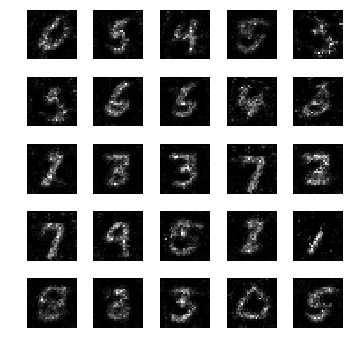

epoch: 861, time: 4.956408 | train_G_Loss: 0.295668, train_D_loss: 2.632647, train_acc: 0.863281
cv_G_Loss: 0.782417, cv_D_loss: 2.881226, cv_acc: 0.841100

epoch: 862, time: 4.917206 | train_G_Loss: 0.348171, train_D_loss: 2.525937, train_acc: 0.876953
cv_G_Loss: 0.556949, cv_D_loss: 2.724251, cv_acc: 0.863700

epoch: 863, time: 4.916629 | train_G_Loss: 0.368507, train_D_loss: 2.490342, train_acc: 0.888672
cv_G_Loss: 0.580552, cv_D_loss: 2.671527, cv_acc: 0.883400

epoch: 864, time: 4.923303 | train_G_Loss: 0.406093, train_D_loss: 2.999904, train_acc: 0.880859
cv_G_Loss: 0.876855, cv_D_loss: 2.965942, cv_acc: 0.866400

epoch: 865, time: 4.917810 | train_G_Loss: 0.348506, train_D_loss: 2.540360, train_acc: 0.873047
cv_G_Loss: 0.455024, cv_D_loss: 2.687863, cv_acc: 0.854500

epoch: 866, time: 4.918658 | train_G_Loss: 0.303608, train_D_loss: 2.999638, train_acc: 0.837891
cv_G_Loss: 0.406849, cv_D_loss: 3.030925, cv_acc: 0.768400

epoch: 867, time: 4.926665 | train_G_Loss: 0.378406, train

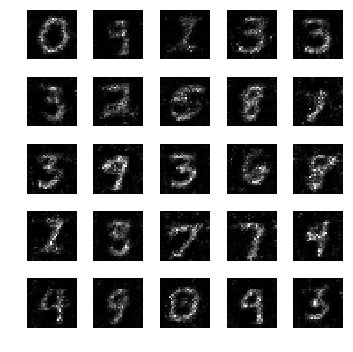

epoch: 871, time: 4.979341 | train_G_Loss: 0.447189, train_D_loss: 2.310225, train_acc: 0.861328
cv_G_Loss: 0.726831, cv_D_loss: 2.789568, cv_acc: 0.888800
Model saved

epoch: 872, time: 4.981158 | train_G_Loss: 0.433687, train_D_loss: 2.451887, train_acc: 0.886719
cv_G_Loss: 1.446536, cv_D_loss: 3.940962, cv_acc: 0.843900

epoch: 873, time: 4.931141 | train_G_Loss: 0.365813, train_D_loss: 2.443384, train_acc: 0.914062
cv_G_Loss: 0.955355, cv_D_loss: 3.172628, cv_acc: 0.875900

epoch: 874, time: 4.921798 | train_G_Loss: 0.294030, train_D_loss: 2.421670, train_acc: 0.884766
cv_G_Loss: 0.270651, cv_D_loss: 2.709096, cv_acc: 0.855300

epoch: 875, time: 4.926307 | train_G_Loss: 0.400658, train_D_loss: 2.636849, train_acc: 0.847656
cv_G_Loss: 0.752320, cv_D_loss: 2.771623, cv_acc: 0.887200

epoch: 876, time: 4.916623 | train_G_Loss: 0.401783, train_D_loss: 2.756292, train_acc: 0.869141
cv_G_Loss: 0.821749, cv_D_loss: 2.970200, cv_acc: 0.876300

epoch: 877, time: 4.923187 | train_G_Loss: 0.2

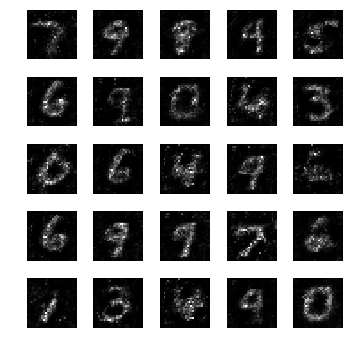

epoch: 881, time: 4.930246 | train_G_Loss: 0.373171, train_D_loss: 2.543074, train_acc: 0.880859
cv_G_Loss: 0.377508, cv_D_loss: 2.546923, cv_acc: 0.879800

epoch: 882, time: 4.924402 | train_G_Loss: 0.365599, train_D_loss: 2.193077, train_acc: 0.853516
cv_G_Loss: 0.252115, cv_D_loss: 2.693779, cv_acc: 0.872300

epoch: 883, time: 4.932884 | train_G_Loss: 0.297212, train_D_loss: 2.558321, train_acc: 0.882812
cv_G_Loss: 0.744207, cv_D_loss: 2.864589, cv_acc: 0.881300

epoch: 884, time: 4.919540 | train_G_Loss: 0.372937, train_D_loss: 2.448761, train_acc: 0.892578
cv_G_Loss: 0.428755, cv_D_loss: 2.797063, cv_acc: 0.849000

epoch: 885, time: 4.913458 | train_G_Loss: 0.277219, train_D_loss: 2.497126, train_acc: 0.875000
cv_G_Loss: 0.479921, cv_D_loss: 2.676497, cv_acc: 0.863200

epoch: 886, time: 4.926612 | train_G_Loss: 0.377267, train_D_loss: 2.503329, train_acc: 0.882812
cv_G_Loss: 0.697427, cv_D_loss: 2.666745, cv_acc: 0.873100

epoch: 887, time: 4.912090 | train_G_Loss: 0.405647, train

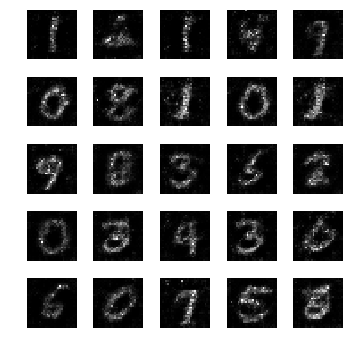

epoch: 891, time: 4.951865 | train_G_Loss: 0.314752, train_D_loss: 3.552466, train_acc: 0.873047
cv_G_Loss: 0.473591, cv_D_loss: 2.936715, cv_acc: 0.814400

epoch: 892, time: 4.917561 | train_G_Loss: 0.356297, train_D_loss: 2.456450, train_acc: 0.847656
cv_G_Loss: 0.479325, cv_D_loss: 2.601686, cv_acc: 0.881400

epoch: 893, time: 4.927752 | train_G_Loss: 0.365167, train_D_loss: 2.468982, train_acc: 0.830078
cv_G_Loss: 0.502332, cv_D_loss: 2.592076, cv_acc: 0.884600

epoch: 894, time: 4.924019 | train_G_Loss: 0.351629, train_D_loss: 2.766513, train_acc: 0.845703
cv_G_Loss: 0.404324, cv_D_loss: 2.704969, cv_acc: 0.856500

epoch: 895, time: 4.909104 | train_G_Loss: 0.402311, train_D_loss: 2.472633, train_acc: 0.892578
cv_G_Loss: 0.538086, cv_D_loss: 2.622232, cv_acc: 0.888900
Model saved

epoch: 896, time: 4.923853 | train_G_Loss: 0.324036, train_D_loss: 2.539640, train_acc: 0.865234
cv_G_Loss: 0.477178, cv_D_loss: 2.896154, cv_acc: 0.798100

epoch: 897, time: 4.908732 | train_G_Loss: 0.4

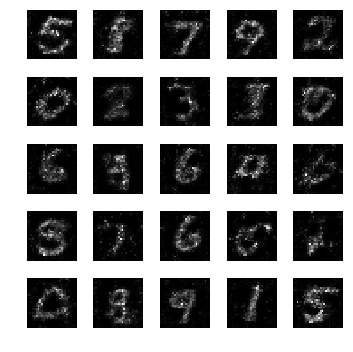

epoch: 901, time: 4.932254 | train_G_Loss: 0.405977, train_D_loss: 2.295413, train_acc: 0.906250
cv_G_Loss: 0.680934, cv_D_loss: 2.665899, cv_acc: 0.885800

epoch: 902, time: 4.904976 | train_G_Loss: 0.348502, train_D_loss: 2.363703, train_acc: 0.878906
cv_G_Loss: 0.760593, cv_D_loss: 2.758548, cv_acc: 0.874200

epoch: 903, time: 4.917110 | train_G_Loss: 0.350933, train_D_loss: 2.237999, train_acc: 0.878906
cv_G_Loss: 0.939744, cv_D_loss: 2.946926, cv_acc: 0.871900

epoch: 904, time: 4.909124 | train_G_Loss: 0.322179, train_D_loss: 2.327178, train_acc: 0.898438
cv_G_Loss: 0.326971, cv_D_loss: 2.714811, cv_acc: 0.853900

epoch: 905, time: 4.923022 | train_G_Loss: 0.329953, train_D_loss: 2.465987, train_acc: 0.845703
cv_G_Loss: 0.693768, cv_D_loss: 2.808741, cv_acc: 0.860700

epoch: 906, time: 4.906251 | train_G_Loss: 0.300547, train_D_loss: 2.309097, train_acc: 0.912109
cv_G_Loss: 0.446393, cv_D_loss: 2.853226, cv_acc: 0.801900

epoch: 907, time: 4.902128 | train_G_Loss: 0.472929, train

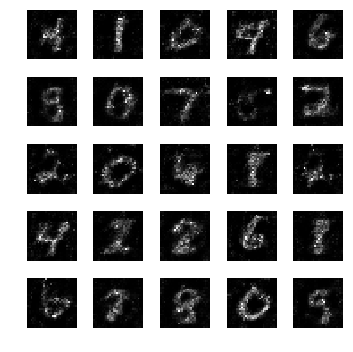

epoch: 911, time: 5.051786 | train_G_Loss: 0.382758, train_D_loss: 2.664336, train_acc: 0.875000
cv_G_Loss: 0.489022, cv_D_loss: 2.630023, cv_acc: 0.869600

epoch: 912, time: 4.912314 | train_G_Loss: 0.371581, train_D_loss: 2.355503, train_acc: 0.880859
cv_G_Loss: 0.823318, cv_D_loss: 2.885853, cv_acc: 0.868300

epoch: 913, time: 4.932796 | train_G_Loss: 0.350345, train_D_loss: 2.259714, train_acc: 0.912109
cv_G_Loss: 0.747833, cv_D_loss: 2.806457, cv_acc: 0.888000

epoch: 914, time: 4.916747 | train_G_Loss: 0.314875, train_D_loss: 3.035682, train_acc: 0.898438
cv_G_Loss: 0.392558, cv_D_loss: 2.904066, cv_acc: 0.787200

epoch: 915, time: 4.937919 | train_G_Loss: 0.356300, train_D_loss: 2.610459, train_acc: 0.914062
cv_G_Loss: 0.187391, cv_D_loss: 2.753784, cv_acc: 0.891000

epoch: 916, time: 4.916046 | train_G_Loss: 0.445697, train_D_loss: 2.310218, train_acc: 0.904297
cv_G_Loss: 0.618624, cv_D_loss: 2.790250, cv_acc: 0.867000

epoch: 917, time: 4.931664 | train_G_Loss: 0.386701, train

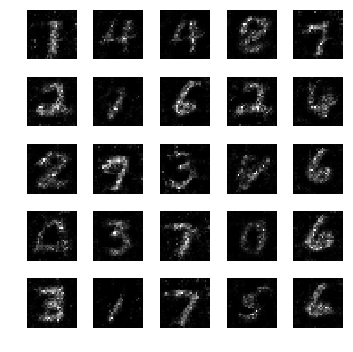

epoch: 921, time: 4.943753 | train_G_Loss: 0.408904, train_D_loss: 2.456392, train_acc: 0.892578
cv_G_Loss: 0.436940, cv_D_loss: 2.585930, cv_acc: 0.883500

epoch: 922, time: 4.899930 | train_G_Loss: 0.348770, train_D_loss: 2.401001, train_acc: 0.927734
cv_G_Loss: 0.224674, cv_D_loss: 2.690175, cv_acc: 0.880600

epoch: 923, time: 4.908247 | train_G_Loss: 0.476270, train_D_loss: 2.342194, train_acc: 0.927734
cv_G_Loss: 0.822192, cv_D_loss: 2.943773, cv_acc: 0.884100

epoch: 924, time: 4.912945 | train_G_Loss: 0.293215, train_D_loss: 2.169969, train_acc: 0.921875
cv_G_Loss: 0.767332, cv_D_loss: 3.618606, cv_acc: 0.635800

epoch: 925, time: 4.915020 | train_G_Loss: 0.314678, train_D_loss: 2.789376, train_acc: 0.943359
cv_G_Loss: 0.703748, cv_D_loss: 2.747708, cv_acc: 0.876900

epoch: 926, time: 4.918205 | train_G_Loss: 0.365164, train_D_loss: 2.216309, train_acc: 0.941406
cv_G_Loss: 0.301223, cv_D_loss: 2.646092, cv_acc: 0.877700

epoch: 927, time: 4.903671 | train_G_Loss: 0.438140, train

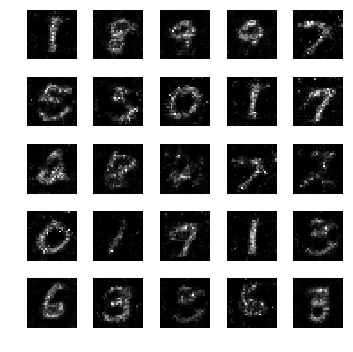

epoch: 931, time: 4.939921 | train_G_Loss: 0.314198, train_D_loss: 2.796224, train_acc: 0.896484
cv_G_Loss: 0.411521, cv_D_loss: 2.834300, cv_acc: 0.838600

epoch: 932, time: 4.917562 | train_G_Loss: 0.362091, train_D_loss: 2.443832, train_acc: 0.914062
cv_G_Loss: 0.447943, cv_D_loss: 2.640085, cv_acc: 0.866000

epoch: 933, time: 4.912073 | train_G_Loss: 0.402143, train_D_loss: 2.877962, train_acc: 0.912109
cv_G_Loss: 0.469349, cv_D_loss: 2.647996, cv_acc: 0.874700

epoch: 934, time: 4.911557 | train_G_Loss: 0.277385, train_D_loss: 2.980024, train_acc: 0.890625
cv_G_Loss: 0.324937, cv_D_loss: 2.673253, cv_acc: 0.882800

epoch: 935, time: 4.905962 | train_G_Loss: 0.313035, train_D_loss: 2.662083, train_acc: 0.880859
cv_G_Loss: 0.247507, cv_D_loss: 2.687971, cv_acc: 0.869100

epoch: 936, time: 4.922399 | train_G_Loss: 0.404599, train_D_loss: 2.897365, train_acc: 0.853516
cv_G_Loss: 0.647855, cv_D_loss: 3.708072, cv_acc: 0.597400

epoch: 937, time: 4.905655 | train_G_Loss: 0.360463, train

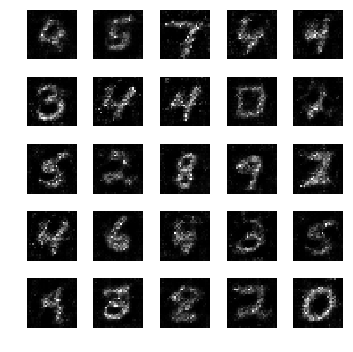

epoch: 941, time: 4.951208 | train_G_Loss: 0.478169, train_D_loss: 2.753782, train_acc: 0.855469
cv_G_Loss: 1.000630, cv_D_loss: 3.102311, cv_acc: 0.886900

epoch: 942, time: 4.904584 | train_G_Loss: 0.491001, train_D_loss: 2.494195, train_acc: 0.857422
cv_G_Loss: 0.492411, cv_D_loss: 2.617469, cv_acc: 0.888700

epoch: 943, time: 4.920654 | train_G_Loss: 0.324124, train_D_loss: 2.413484, train_acc: 0.894531
cv_G_Loss: 0.605284, cv_D_loss: 3.209054, cv_acc: 0.739400

epoch: 944, time: 4.928931 | train_G_Loss: 0.359537, train_D_loss: 2.733724, train_acc: 0.884766
cv_G_Loss: 0.665780, cv_D_loss: 2.610982, cv_acc: 0.885500

epoch: 945, time: 4.913642 | train_G_Loss: 0.283805, train_D_loss: 2.696321, train_acc: 0.898438
cv_G_Loss: 0.611539, cv_D_loss: 2.904081, cv_acc: 0.821800

epoch: 946, time: 4.917009 | train_G_Loss: 0.318361, train_D_loss: 2.556349, train_acc: 0.890625
cv_G_Loss: 0.332615, cv_D_loss: 2.515810, cv_acc: 0.882000

epoch: 947, time: 4.913711 | train_G_Loss: 0.400445, train

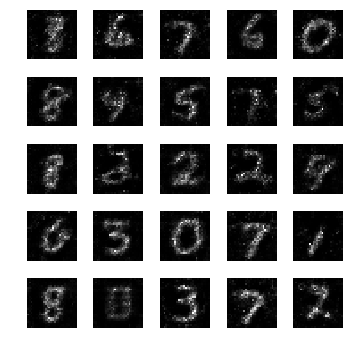

epoch: 951, time: 4.932923 | train_G_Loss: 0.419524, train_D_loss: 2.590977, train_acc: 0.859375
cv_G_Loss: 0.891513, cv_D_loss: 2.872717, cv_acc: 0.886000

epoch: 952, time: 4.909439 | train_G_Loss: 0.416156, train_D_loss: 2.886296, train_acc: 0.863281
cv_G_Loss: 0.652748, cv_D_loss: 2.956555, cv_acc: 0.855800

epoch: 953, time: 4.917729 | train_G_Loss: 0.283030, train_D_loss: 2.535229, train_acc: 0.898438
cv_G_Loss: 0.258690, cv_D_loss: 2.606053, cv_acc: 0.883600

epoch: 954, time: 4.903644 | train_G_Loss: 0.339848, train_D_loss: 2.324979, train_acc: 0.878906
cv_G_Loss: 0.337930, cv_D_loss: 2.523761, cv_acc: 0.884900

epoch: 955, time: 4.904098 | train_G_Loss: 0.339362, train_D_loss: 3.292988, train_acc: 0.878906
cv_G_Loss: 0.266597, cv_D_loss: 2.606211, cv_acc: 0.891200

epoch: 956, time: 4.917396 | train_G_Loss: 0.410239, train_D_loss: 2.637711, train_acc: 0.849609
cv_G_Loss: 0.726169, cv_D_loss: 2.688661, cv_acc: 0.879000

epoch: 957, time: 4.915870 | train_G_Loss: 0.387468, train

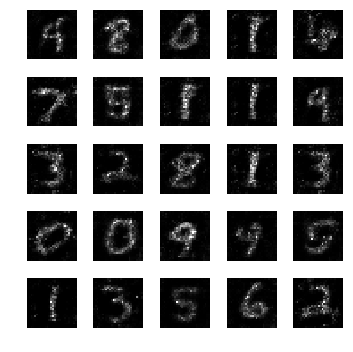

epoch: 961, time: 4.942980 | train_G_Loss: 0.305011, train_D_loss: 2.416634, train_acc: 0.845703
cv_G_Loss: 0.329616, cv_D_loss: 2.482497, cv_acc: 0.895200
Model saved

epoch: 962, time: 4.952578 | train_G_Loss: 0.302202, train_D_loss: 3.623686, train_acc: 0.849609
cv_G_Loss: 0.475426, cv_D_loss: 2.641842, cv_acc: 0.873100

epoch: 963, time: 4.926559 | train_G_Loss: 0.261597, train_D_loss: 2.375129, train_acc: 0.894531
cv_G_Loss: 0.530865, cv_D_loss: 2.534965, cv_acc: 0.888400

epoch: 964, time: 4.923007 | train_G_Loss: 0.289579, train_D_loss: 2.594862, train_acc: 0.906250
cv_G_Loss: 0.772065, cv_D_loss: 2.765041, cv_acc: 0.878700

epoch: 965, time: 4.931906 | train_G_Loss: 0.380108, train_D_loss: 2.835340, train_acc: 0.880859
cv_G_Loss: 0.422548, cv_D_loss: 2.521952, cv_acc: 0.894400

epoch: 966, time: 4.938530 | train_G_Loss: 0.333345, train_D_loss: 2.874636, train_acc: 0.832031
cv_G_Loss: 0.451017, cv_D_loss: 2.513532, cv_acc: 0.889700

epoch: 967, time: 4.930158 | train_G_Loss: 0.3

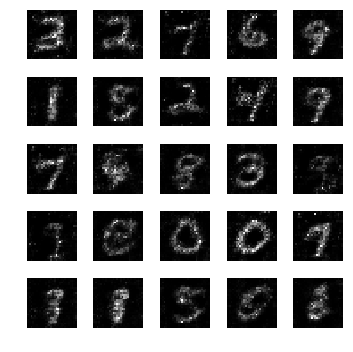

epoch: 971, time: 4.947211 | train_G_Loss: 0.256090, train_D_loss: 3.243755, train_acc: 0.853516
cv_G_Loss: 0.365161, cv_D_loss: 2.835941, cv_acc: 0.699200

epoch: 972, time: 4.942023 | train_G_Loss: 0.344148, train_D_loss: 2.911863, train_acc: 0.882812
cv_G_Loss: 0.418525, cv_D_loss: 2.573445, cv_acc: 0.884800

epoch: 973, time: 4.933116 | train_G_Loss: 0.394924, train_D_loss: 3.018543, train_acc: 0.912109
cv_G_Loss: 0.834577, cv_D_loss: 2.896988, cv_acc: 0.893200

epoch: 974, time: 4.931110 | train_G_Loss: 0.429564, train_D_loss: 2.612276, train_acc: 0.927734
cv_G_Loss: 0.610177, cv_D_loss: 2.661925, cv_acc: 0.884300

epoch: 975, time: 4.923452 | train_G_Loss: 0.445225, train_D_loss: 2.753901, train_acc: 0.914062
cv_G_Loss: 0.842043, cv_D_loss: 3.002829, cv_acc: 0.892500

epoch: 976, time: 4.925664 | train_G_Loss: 0.281736, train_D_loss: 2.650775, train_acc: 0.912109
cv_G_Loss: 0.235425, cv_D_loss: 2.755953, cv_acc: 0.859400

epoch: 977, time: 4.933527 | train_G_Loss: 0.410771, train

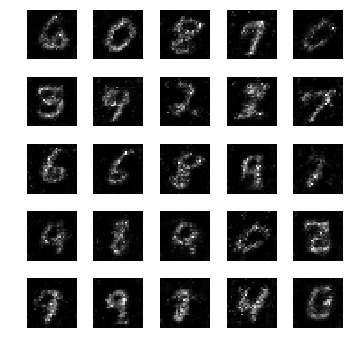

epoch: 981, time: 4.971980 | train_G_Loss: 0.269984, train_D_loss: 2.623637, train_acc: 0.910156
cv_G_Loss: 0.322562, cv_D_loss: 2.495738, cv_acc: 0.889400

epoch: 982, time: 4.952350 | train_G_Loss: 0.363282, train_D_loss: 2.259533, train_acc: 0.892578
cv_G_Loss: 0.499960, cv_D_loss: 2.671524, cv_acc: 0.880500

epoch: 983, time: 4.950288 | train_G_Loss: 0.356844, train_D_loss: 2.605614, train_acc: 0.880859
cv_G_Loss: 0.532991, cv_D_loss: 2.571778, cv_acc: 0.890200

epoch: 984, time: 4.951266 | train_G_Loss: 0.417806, train_D_loss: 2.134167, train_acc: 0.888672
cv_G_Loss: 0.568194, cv_D_loss: 3.051252, cv_acc: 0.762700

epoch: 985, time: 4.927064 | train_G_Loss: 0.384444, train_D_loss: 3.007740, train_acc: 0.900391
cv_G_Loss: 0.479869, cv_D_loss: 2.727956, cv_acc: 0.864400

epoch: 986, time: 4.946835 | train_G_Loss: 0.322267, train_D_loss: 2.770923, train_acc: 0.921875
cv_G_Loss: 0.211726, cv_D_loss: 2.747715, cv_acc: 0.873900

epoch: 987, time: 4.933743 | train_G_Loss: 0.385293, train

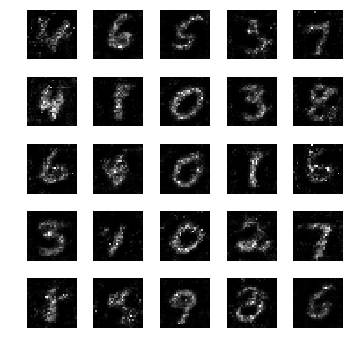

epoch: 991, time: 4.963361 | train_G_Loss: 0.370520, train_D_loss: 2.470888, train_acc: 0.908203
cv_G_Loss: 0.444558, cv_D_loss: 2.551987, cv_acc: 0.884900

epoch: 992, time: 4.937464 | train_G_Loss: 0.283571, train_D_loss: 2.340098, train_acc: 0.884766
cv_G_Loss: 0.300077, cv_D_loss: 2.561894, cv_acc: 0.889000

epoch: 993, time: 4.934731 | train_G_Loss: 0.387157, train_D_loss: 2.774441, train_acc: 0.876953
cv_G_Loss: 0.367046, cv_D_loss: 2.496879, cv_acc: 0.890600

epoch: 994, time: 4.935795 | train_G_Loss: 0.344733, train_D_loss: 2.417383, train_acc: 0.894531
cv_G_Loss: 0.684494, cv_D_loss: 2.758904, cv_acc: 0.890700

epoch: 995, time: 4.939789 | train_G_Loss: 0.391455, train_D_loss: 2.316042, train_acc: 0.859375
cv_G_Loss: 0.353596, cv_D_loss: 2.612945, cv_acc: 0.865700

epoch: 996, time: 4.943706 | train_G_Loss: 0.330141, train_D_loss: 2.466219, train_acc: 0.857422
cv_G_Loss: 0.347993, cv_D_loss: 2.705068, cv_acc: 0.856200

epoch: 997, time: 4.937738 | train_G_Loss: 0.371763, train

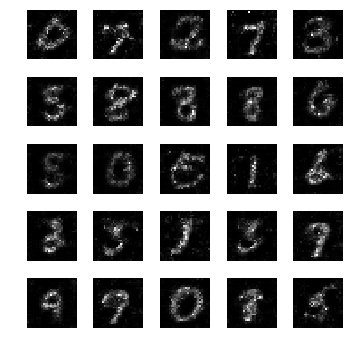

epoch: 1001, time: 4.962532 | train_G_Loss: 0.382204, train_D_loss: 2.262568, train_acc: 0.892578
cv_G_Loss: 0.476709, cv_D_loss: 2.556411, cv_acc: 0.890400

epoch: 1002, time: 4.936769 | train_G_Loss: 0.329822, train_D_loss: 3.961951, train_acc: 0.847656
cv_G_Loss: 0.489272, cv_D_loss: 2.643579, cv_acc: 0.876000

epoch: 1003, time: 4.940245 | train_G_Loss: 0.311740, train_D_loss: 2.465497, train_acc: 0.875000
cv_G_Loss: 0.239426, cv_D_loss: 2.614587, cv_acc: 0.878100

epoch: 1004, time: 4.957150 | train_G_Loss: 0.477955, train_D_loss: 2.364246, train_acc: 0.894531
cv_G_Loss: 0.660262, cv_D_loss: 2.887225, cv_acc: 0.831600

epoch: 1005, time: 4.931029 | train_G_Loss: 0.335398, train_D_loss: 2.587245, train_acc: 0.908203
cv_G_Loss: 0.319257, cv_D_loss: 2.581404, cv_acc: 0.878900

epoch: 1006, time: 4.929318 | train_G_Loss: 0.339857, train_D_loss: 2.243573, train_acc: 0.906250
cv_G_Loss: 0.346763, cv_D_loss: 2.529132, cv_acc: 0.891900

epoch: 1007, time: 4.946550 | train_G_Loss: 0.396485

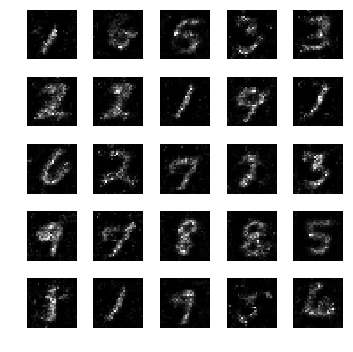

epoch: 1011, time: 4.958932 | train_G_Loss: 0.318640, train_D_loss: 2.240981, train_acc: 0.859375
cv_G_Loss: 0.282824, cv_D_loss: 2.588184, cv_acc: 0.891100

epoch: 1012, time: 4.936994 | train_G_Loss: 0.242098, train_D_loss: 2.703041, train_acc: 0.871094
cv_G_Loss: 0.454192, cv_D_loss: 2.700769, cv_acc: 0.848500

epoch: 1013, time: 4.924232 | train_G_Loss: 0.327639, train_D_loss: 2.931573, train_acc: 0.853516
cv_G_Loss: 0.341356, cv_D_loss: 2.669631, cv_acc: 0.871500

epoch: 1014, time: 4.931579 | train_G_Loss: 0.438464, train_D_loss: 2.489748, train_acc: 0.875000
cv_G_Loss: 0.842992, cv_D_loss: 2.912425, cv_acc: 0.841300

epoch: 1015, time: 4.935670 | train_G_Loss: 0.405578, train_D_loss: 2.469935, train_acc: 0.859375
cv_G_Loss: 0.569353, cv_D_loss: 2.840423, cv_acc: 0.824500

epoch: 1016, time: 4.933635 | train_G_Loss: 0.370180, train_D_loss: 2.772706, train_acc: 0.816406
cv_G_Loss: 0.579750, cv_D_loss: 2.632727, cv_acc: 0.852000

epoch: 1017, time: 4.940235 | train_G_Loss: 0.382082

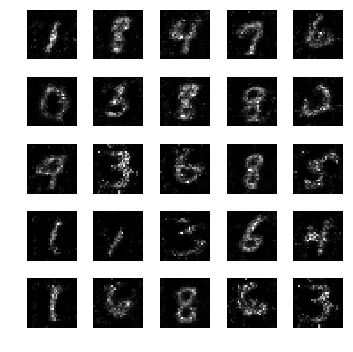

epoch: 1021, time: 4.960647 | train_G_Loss: 0.421403, train_D_loss: 2.327574, train_acc: 0.808594
cv_G_Loss: 0.562639, cv_D_loss: 2.921405, cv_acc: 0.825800

epoch: 1022, time: 4.933795 | train_G_Loss: 0.451850, train_D_loss: 2.436638, train_acc: 0.855469
cv_G_Loss: 0.806853, cv_D_loss: 2.916335, cv_acc: 0.855700

epoch: 1023, time: 4.923437 | train_G_Loss: 0.318241, train_D_loss: 2.434748, train_acc: 0.912109
cv_G_Loss: 0.251420, cv_D_loss: 2.681486, cv_acc: 0.870200

epoch: 1024, time: 4.928388 | train_G_Loss: 0.433478, train_D_loss: 2.359951, train_acc: 0.900391
cv_G_Loss: 0.259205, cv_D_loss: 2.561898, cv_acc: 0.896600
Model saved

epoch: 1025, time: 4.940494 | train_G_Loss: 0.367430, train_D_loss: 2.309926, train_acc: 0.906250
cv_G_Loss: 0.380325, cv_D_loss: 2.539987, cv_acc: 0.886000

epoch: 1026, time: 4.928111 | train_G_Loss: 0.443564, train_D_loss: 2.910395, train_acc: 0.929688
cv_G_Loss: 0.499605, cv_D_loss: 2.578162, cv_acc: 0.885700

epoch: 1027, time: 4.933254 | train_G_Lo

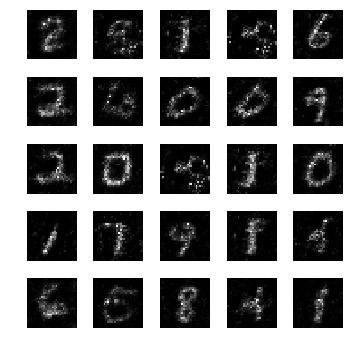

epoch: 1031, time: 4.941974 | train_G_Loss: 0.377760, train_D_loss: 2.242761, train_acc: 0.898438
cv_G_Loss: 0.504590, cv_D_loss: 2.565424, cv_acc: 0.882400

epoch: 1032, time: 4.919962 | train_G_Loss: 0.399464, train_D_loss: 2.480148, train_acc: 0.880859
cv_G_Loss: 0.264111, cv_D_loss: 2.720968, cv_acc: 0.843100

epoch: 1033, time: 4.922284 | train_G_Loss: 0.339995, train_D_loss: 2.272943, train_acc: 0.900391
cv_G_Loss: 0.353521, cv_D_loss: 2.555620, cv_acc: 0.891100

epoch: 1034, time: 4.911707 | train_G_Loss: 0.417042, train_D_loss: 2.421956, train_acc: 0.898438
cv_G_Loss: 0.942787, cv_D_loss: 3.014056, cv_acc: 0.878300

epoch: 1035, time: 4.926311 | train_G_Loss: 0.279303, train_D_loss: 2.336729, train_acc: 0.908203
cv_G_Loss: 0.252752, cv_D_loss: 2.624242, cv_acc: 0.889000

epoch: 1036, time: 4.919196 | train_G_Loss: 0.458912, train_D_loss: 2.353539, train_acc: 0.910156
cv_G_Loss: 0.601632, cv_D_loss: 2.828061, cv_acc: 0.850700

epoch: 1037, time: 4.917600 | train_G_Loss: 0.311859

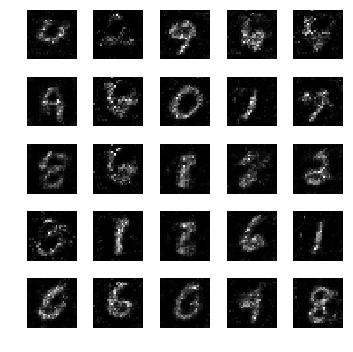

epoch: 1041, time: 4.948550 | train_G_Loss: 0.461238, train_D_loss: 2.769311, train_acc: 0.902344
cv_G_Loss: 0.822472, cv_D_loss: 2.849161, cv_acc: 0.893100

epoch: 1042, time: 4.915174 | train_G_Loss: 0.313695, train_D_loss: 2.479824, train_acc: 0.902344
cv_G_Loss: 0.314956, cv_D_loss: 2.510429, cv_acc: 0.889300

epoch: 1043, time: 4.907692 | train_G_Loss: 0.409314, train_D_loss: 2.911591, train_acc: 0.906250
cv_G_Loss: 0.646666, cv_D_loss: 2.652914, cv_acc: 0.892800

epoch: 1044, time: 4.920149 | train_G_Loss: 0.442885, train_D_loss: 2.407304, train_acc: 0.906250
cv_G_Loss: 0.464286, cv_D_loss: 2.733575, cv_acc: 0.848800

epoch: 1045, time: 4.932106 | train_G_Loss: 0.351514, train_D_loss: 2.434251, train_acc: 0.886719
cv_G_Loss: 0.264075, cv_D_loss: 2.641686, cv_acc: 0.877600

epoch: 1046, time: 4.922106 | train_G_Loss: 0.371534, train_D_loss: 2.378943, train_acc: 0.892578
cv_G_Loss: 0.348082, cv_D_loss: 2.511864, cv_acc: 0.885100

epoch: 1047, time: 4.928586 | train_G_Loss: 0.306421

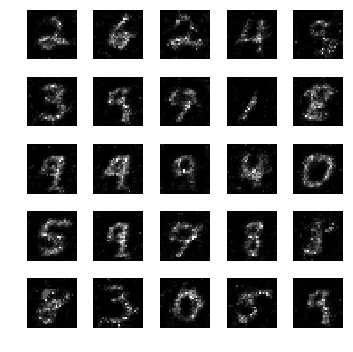

epoch: 1051, time: 4.945822 | train_G_Loss: 0.380758, train_D_loss: 2.690511, train_acc: 0.878906
cv_G_Loss: 0.963461, cv_D_loss: 3.435572, cv_acc: 0.634300

epoch: 1052, time: 4.916784 | train_G_Loss: 0.400877, train_D_loss: 2.546396, train_acc: 0.855469
cv_G_Loss: 0.797031, cv_D_loss: 2.817203, cv_acc: 0.884700

epoch: 1053, time: 4.918634 | train_G_Loss: 0.302597, train_D_loss: 2.474708, train_acc: 0.888672
cv_G_Loss: 0.451673, cv_D_loss: 2.535902, cv_acc: 0.899300

epoch: 1054, time: 4.920092 | train_G_Loss: 0.311775, train_D_loss: 2.910553, train_acc: 0.865234
cv_G_Loss: 0.241607, cv_D_loss: 2.547326, cv_acc: 0.897200

epoch: 1055, time: 4.917683 | train_G_Loss: 0.370609, train_D_loss: 2.171422, train_acc: 0.845703
cv_G_Loss: 0.960748, cv_D_loss: 3.134327, cv_acc: 0.852400

epoch: 1056, time: 4.932624 | train_G_Loss: 0.343861, train_D_loss: 2.951262, train_acc: 0.886719
cv_G_Loss: 0.601443, cv_D_loss: 2.878091, cv_acc: 0.810900

epoch: 1057, time: 4.927168 | train_G_Loss: 0.375515

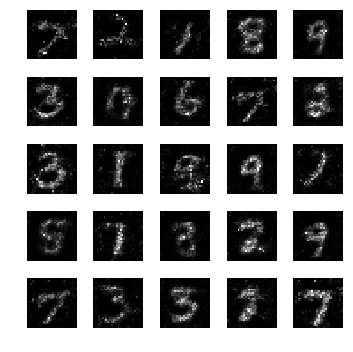

epoch: 1061, time: 4.948680 | train_G_Loss: 0.318629, train_D_loss: 2.261137, train_acc: 0.867188
cv_G_Loss: 0.610112, cv_D_loss: 2.695855, cv_acc: 0.885400

epoch: 1062, time: 4.934801 | train_G_Loss: 0.402275, train_D_loss: 2.161784, train_acc: 0.910156
cv_G_Loss: 0.427769, cv_D_loss: 2.552543, cv_acc: 0.890800

epoch: 1063, time: 4.924060 | train_G_Loss: 0.309155, train_D_loss: 2.895512, train_acc: 0.912109
cv_G_Loss: 0.407771, cv_D_loss: 2.578769, cv_acc: 0.866000

epoch: 1064, time: 4.922733 | train_G_Loss: 0.429654, train_D_loss: 2.340817, train_acc: 0.884766
cv_G_Loss: 0.743241, cv_D_loss: 2.862005, cv_acc: 0.878600

epoch: 1065, time: 4.924225 | train_G_Loss: 0.489966, train_D_loss: 2.848986, train_acc: 0.878906
cv_G_Loss: 1.104170, cv_D_loss: 3.388931, cv_acc: 0.871800

epoch: 1066, time: 4.909194 | train_G_Loss: 0.391194, train_D_loss: 2.159089, train_acc: 0.890625
cv_G_Loss: 0.787644, cv_D_loss: 2.795301, cv_acc: 0.887900

epoch: 1067, time: 5.012499 | train_G_Loss: 0.354732

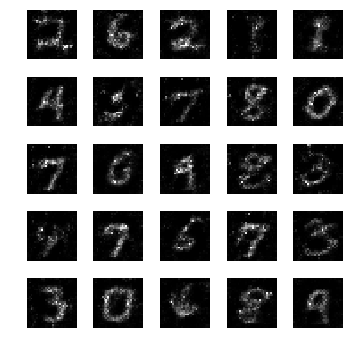

epoch: 1071, time: 4.948165 | train_G_Loss: 0.333332, train_D_loss: 2.433249, train_acc: 0.876953
cv_G_Loss: 0.481855, cv_D_loss: 2.875114, cv_acc: 0.818200

epoch: 1072, time: 4.926175 | train_G_Loss: 0.372293, train_D_loss: 2.600009, train_acc: 0.892578
cv_G_Loss: 0.347474, cv_D_loss: 2.700559, cv_acc: 0.863000

epoch: 1073, time: 4.935457 | train_G_Loss: 0.391651, train_D_loss: 2.178611, train_acc: 0.886719
cv_G_Loss: 0.479288, cv_D_loss: 2.576503, cv_acc: 0.890500

epoch: 1074, time: 4.920364 | train_G_Loss: 0.423060, train_D_loss: 3.080177, train_acc: 0.888672
cv_G_Loss: 1.214443, cv_D_loss: 3.498066, cv_acc: 0.891100

epoch: 1075, time: 4.922690 | train_G_Loss: 0.308338, train_D_loss: 2.615409, train_acc: 0.917969
cv_G_Loss: 0.369734, cv_D_loss: 2.707523, cv_acc: 0.851300

epoch: 1076, time: 4.916429 | train_G_Loss: 0.281297, train_D_loss: 2.564862, train_acc: 0.916016
cv_G_Loss: 0.614159, cv_D_loss: 2.637836, cv_acc: 0.868600

epoch: 1077, time: 4.912399 | train_G_Loss: 0.269561

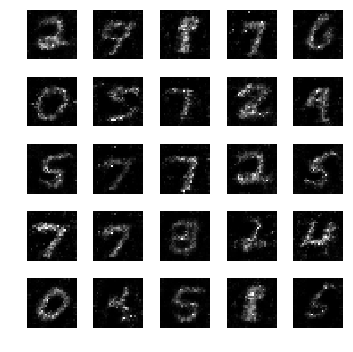

epoch: 1081, time: 4.949744 | train_G_Loss: 0.400029, train_D_loss: 2.653039, train_acc: 0.904297
cv_G_Loss: 0.513188, cv_D_loss: 2.614240, cv_acc: 0.890200

epoch: 1082, time: 4.928435 | train_G_Loss: 0.375498, train_D_loss: 2.224136, train_acc: 0.880859
cv_G_Loss: 0.335063, cv_D_loss: 2.685262, cv_acc: 0.852400

epoch: 1083, time: 4.917163 | train_G_Loss: 0.380648, train_D_loss: 2.600608, train_acc: 0.865234
cv_G_Loss: 0.583014, cv_D_loss: 2.616203, cv_acc: 0.893100

epoch: 1084, time: 4.924262 | train_G_Loss: 0.377113, train_D_loss: 2.640287, train_acc: 0.882812
cv_G_Loss: 0.487878, cv_D_loss: 2.490361, cv_acc: 0.895700

epoch: 1085, time: 4.942902 | train_G_Loss: 0.385451, train_D_loss: 2.429139, train_acc: 0.880859
cv_G_Loss: 0.251883, cv_D_loss: 2.632697, cv_acc: 0.886400

epoch: 1086, time: 4.917793 | train_G_Loss: 0.329690, train_D_loss: 2.758168, train_acc: 0.902344
cv_G_Loss: 0.275459, cv_D_loss: 2.547885, cv_acc: 0.899700

epoch: 1087, time: 4.909442 | train_G_Loss: 0.424602

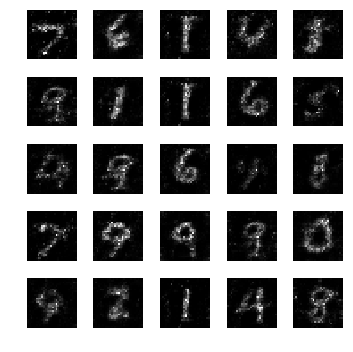

epoch: 1091, time: 4.943270 | train_G_Loss: 0.392463, train_D_loss: 2.398539, train_acc: 0.878906
cv_G_Loss: 0.518627, cv_D_loss: 2.677589, cv_acc: 0.858800

epoch: 1092, time: 4.921371 | train_G_Loss: 0.295941, train_D_loss: 3.091073, train_acc: 0.910156
cv_G_Loss: 0.402435, cv_D_loss: 2.435932, cv_acc: 0.897300

epoch: 1093, time: 4.922120 | train_G_Loss: 0.311985, train_D_loss: 2.743600, train_acc: 0.917969
cv_G_Loss: 0.427900, cv_D_loss: 2.609021, cv_acc: 0.855300

epoch: 1094, time: 4.928821 | train_G_Loss: 0.388492, train_D_loss: 2.253025, train_acc: 0.892578
cv_G_Loss: 0.653498, cv_D_loss: 2.642501, cv_acc: 0.886000

epoch: 1095, time: 4.938383 | train_G_Loss: 0.297729, train_D_loss: 2.664343, train_acc: 0.904297
cv_G_Loss: 0.388640, cv_D_loss: 3.020742, cv_acc: 0.760700

epoch: 1096, time: 4.920025 | train_G_Loss: 0.436946, train_D_loss: 2.209126, train_acc: 0.916016
cv_G_Loss: 0.946855, cv_D_loss: 3.044568, cv_acc: 0.882900

epoch: 1097, time: 4.919805 | train_G_Loss: 0.410093

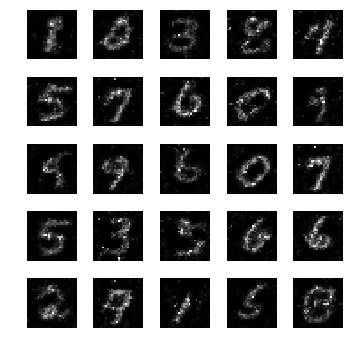

epoch: 1101, time: 4.939989 | train_G_Loss: 0.396007, train_D_loss: 2.329452, train_acc: 0.906250
cv_G_Loss: 0.828916, cv_D_loss: 2.888023, cv_acc: 0.891100

epoch: 1102, time: 4.910624 | train_G_Loss: 0.431894, train_D_loss: 2.242829, train_acc: 0.912109
cv_G_Loss: 0.720215, cv_D_loss: 3.016575, cv_acc: 0.841300

epoch: 1103, time: 4.907552 | train_G_Loss: 0.253828, train_D_loss: 2.585527, train_acc: 0.910156
cv_G_Loss: 0.248138, cv_D_loss: 2.666458, cv_acc: 0.883900

epoch: 1104, time: 4.911947 | train_G_Loss: 0.352639, train_D_loss: 2.214629, train_acc: 0.906250
cv_G_Loss: 0.596206, cv_D_loss: 2.607517, cv_acc: 0.898900

epoch: 1105, time: 4.926018 | train_G_Loss: 0.312576, train_D_loss: 2.769931, train_acc: 0.902344
cv_G_Loss: 0.251468, cv_D_loss: 2.712262, cv_acc: 0.863200

epoch: 1106, time: 4.905207 | train_G_Loss: 0.370517, train_D_loss: 2.130710, train_acc: 0.876953
cv_G_Loss: 0.122984, cv_D_loss: 2.956102, cv_acc: 0.895800

epoch: 1107, time: 5.004649 | train_G_Loss: 0.375134

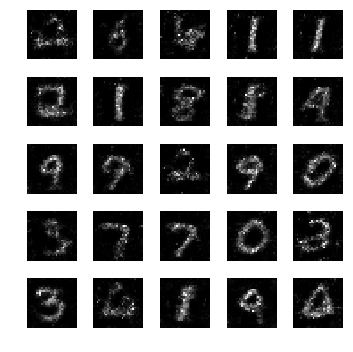

epoch: 1111, time: 4.937707 | train_G_Loss: 0.305529, train_D_loss: 2.518507, train_acc: 0.958984
cv_G_Loss: 0.473627, cv_D_loss: 2.497200, cv_acc: 0.905200
Model saved

epoch: 1112, time: 4.947904 | train_G_Loss: 0.332322, train_D_loss: 2.107314, train_acc: 0.935547
cv_G_Loss: 0.415493, cv_D_loss: 2.679760, cv_acc: 0.869700

epoch: 1113, time: 4.912424 | train_G_Loss: 0.395482, train_D_loss: 2.315155, train_acc: 0.906250
cv_G_Loss: 0.736162, cv_D_loss: 2.892967, cv_acc: 0.809300

epoch: 1114, time: 4.905894 | train_G_Loss: 0.381395, train_D_loss: 2.230779, train_acc: 0.927734
cv_G_Loss: 0.526274, cv_D_loss: 2.748744, cv_acc: 0.870700

epoch: 1115, time: 4.913234 | train_G_Loss: 0.441985, train_D_loss: 2.165673, train_acc: 0.884766
cv_G_Loss: 0.603806, cv_D_loss: 3.477315, cv_acc: 0.625400

epoch: 1116, time: 4.909596 | train_G_Loss: 0.351654, train_D_loss: 3.083945, train_acc: 0.876953
cv_G_Loss: 1.282388, cv_D_loss: 3.630017, cv_acc: 0.861600

epoch: 1117, time: 4.922973 | train_G_Lo

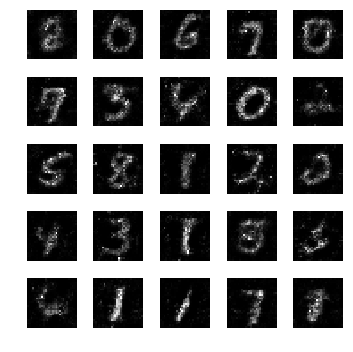

epoch: 1121, time: 4.926451 | train_G_Loss: 0.378004, train_D_loss: 3.008915, train_acc: 0.894531
cv_G_Loss: 0.580720, cv_D_loss: 2.729315, cv_acc: 0.866000

epoch: 1122, time: 4.912749 | train_G_Loss: 0.423820, train_D_loss: 2.694761, train_acc: 0.888672
cv_G_Loss: 0.626006, cv_D_loss: 2.734818, cv_acc: 0.879900

epoch: 1123, time: 4.918680 | train_G_Loss: 0.344914, train_D_loss: 2.911305, train_acc: 0.884766
cv_G_Loss: 0.474795, cv_D_loss: 2.535438, cv_acc: 0.889200

epoch: 1124, time: 4.908854 | train_G_Loss: 0.286630, train_D_loss: 2.579528, train_acc: 0.888672
cv_G_Loss: 0.711272, cv_D_loss: 2.800956, cv_acc: 0.892000

epoch: 1125, time: 4.921493 | train_G_Loss: 0.464812, train_D_loss: 2.417382, train_acc: 0.888672
cv_G_Loss: 0.412050, cv_D_loss: 2.530187, cv_acc: 0.899200

epoch: 1126, time: 4.924751 | train_G_Loss: 0.448513, train_D_loss: 2.171106, train_acc: 0.876953
cv_G_Loss: 1.349949, cv_D_loss: 3.588831, cv_acc: 0.899100

epoch: 1127, time: 4.918563 | train_G_Loss: 0.442496

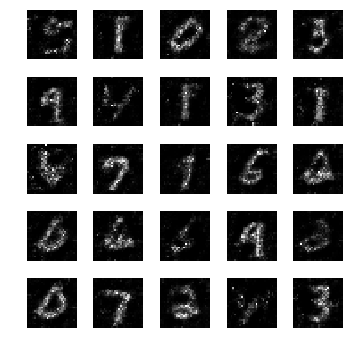

epoch: 1131, time: 4.933654 | train_G_Loss: 0.366532, train_D_loss: 2.418844, train_acc: 0.925781
cv_G_Loss: 0.663875, cv_D_loss: 2.776928, cv_acc: 0.833900

epoch: 1132, time: 4.904891 | train_G_Loss: 0.426565, train_D_loss: 2.841540, train_acc: 0.894531
cv_G_Loss: 0.724944, cv_D_loss: 2.665430, cv_acc: 0.895400

epoch: 1133, time: 4.917335 | train_G_Loss: 0.337698, train_D_loss: 2.417689, train_acc: 0.917969
cv_G_Loss: 0.993492, cv_D_loss: 3.447519, cv_acc: 0.824800

epoch: 1134, time: 4.919748 | train_G_Loss: 0.323349, train_D_loss: 2.460815, train_acc: 0.927734
cv_G_Loss: 0.422441, cv_D_loss: 2.661154, cv_acc: 0.860000

epoch: 1135, time: 4.922047 | train_G_Loss: 0.349711, train_D_loss: 2.934820, train_acc: 0.919922
cv_G_Loss: 0.525796, cv_D_loss: 2.502053, cv_acc: 0.890800

epoch: 1136, time: 4.912134 | train_G_Loss: 0.374318, train_D_loss: 2.425271, train_acc: 0.919922
cv_G_Loss: 0.468591, cv_D_loss: 2.817385, cv_acc: 0.822400

epoch: 1137, time: 4.903683 | train_G_Loss: 0.362976

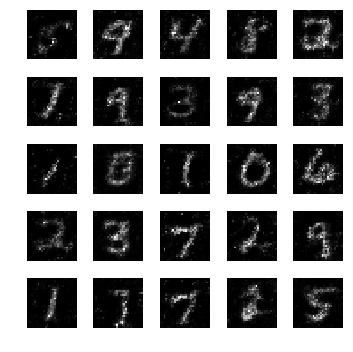

epoch: 1141, time: 4.958422 | train_G_Loss: 0.345027, train_D_loss: 2.503355, train_acc: 0.865234
cv_G_Loss: 0.515908, cv_D_loss: 2.918788, cv_acc: 0.788100

epoch: 1142, time: 4.902055 | train_G_Loss: 0.317630, train_D_loss: 2.388089, train_acc: 0.855469
cv_G_Loss: 0.336637, cv_D_loss: 2.447854, cv_acc: 0.897900

epoch: 1143, time: 4.916250 | train_G_Loss: 0.422350, train_D_loss: 2.407004, train_acc: 0.912109
cv_G_Loss: 0.935666, cv_D_loss: 3.029109, cv_acc: 0.895000

epoch: 1144, time: 4.913741 | train_G_Loss: 0.493123, train_D_loss: 2.603114, train_acc: 0.904297
cv_G_Loss: 0.843789, cv_D_loss: 2.907250, cv_acc: 0.896400

epoch: 1145, time: 4.943361 | train_G_Loss: 0.407667, train_D_loss: 2.463277, train_acc: 0.886719
cv_G_Loss: 0.666167, cv_D_loss: 2.682355, cv_acc: 0.895900

epoch: 1146, time: 4.927414 | train_G_Loss: 0.382969, train_D_loss: 2.361288, train_acc: 0.876953
cv_G_Loss: 0.512191, cv_D_loss: 2.550357, cv_acc: 0.872200

epoch: 1147, time: 4.920316 | train_G_Loss: 0.322674

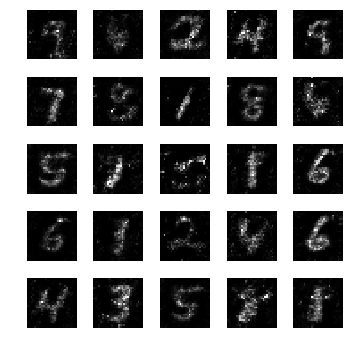

epoch: 1151, time: 4.948749 | train_G_Loss: 0.440860, train_D_loss: 2.236450, train_acc: 0.884766
cv_G_Loss: 0.425767, cv_D_loss: 2.675889, cv_acc: 0.871000

epoch: 1152, time: 4.914980 | train_G_Loss: 0.444783, train_D_loss: 2.982915, train_acc: 0.882812
cv_G_Loss: 0.435079, cv_D_loss: 2.461920, cv_acc: 0.901000

epoch: 1153, time: 4.917247 | train_G_Loss: 0.359650, train_D_loss: 2.528771, train_acc: 0.912109
cv_G_Loss: 0.687647, cv_D_loss: 2.683624, cv_acc: 0.897700

epoch: 1154, time: 4.916725 | train_G_Loss: 0.474003, train_D_loss: 2.142353, train_acc: 0.912109
cv_G_Loss: 1.282012, cv_D_loss: 3.424310, cv_acc: 0.892700

epoch: 1155, time: 4.920448 | train_G_Loss: 0.340348, train_D_loss: 2.409182, train_acc: 0.892578
cv_G_Loss: 0.557587, cv_D_loss: 2.499535, cv_acc: 0.884700

epoch: 1156, time: 4.914452 | train_G_Loss: 0.413557, train_D_loss: 2.678648, train_acc: 0.878906
cv_G_Loss: 0.710263, cv_D_loss: 2.609992, cv_acc: 0.895600

epoch: 1157, time: 4.924168 | train_G_Loss: 0.323956

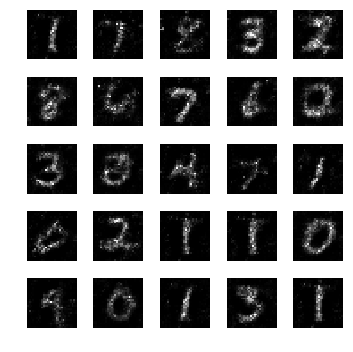

epoch: 1161, time: 4.936920 | train_G_Loss: 0.400218, train_D_loss: 2.229725, train_acc: 0.925781
cv_G_Loss: 0.556689, cv_D_loss: 2.613727, cv_acc: 0.884000

epoch: 1162, time: 4.909624 | train_G_Loss: 0.426706, train_D_loss: 2.853737, train_acc: 0.929688
cv_G_Loss: 1.023285, cv_D_loss: 3.589663, cv_acc: 0.555600

epoch: 1163, time: 4.922693 | train_G_Loss: 0.311094, train_D_loss: 2.643355, train_acc: 0.902344
cv_G_Loss: 0.555412, cv_D_loss: 2.554235, cv_acc: 0.894100

epoch: 1164, time: 4.923240 | train_G_Loss: 0.366760, train_D_loss: 2.934107, train_acc: 0.904297
cv_G_Loss: 0.597786, cv_D_loss: 2.562634, cv_acc: 0.899800

epoch: 1165, time: 4.906590 | train_G_Loss: 0.333362, train_D_loss: 2.145096, train_acc: 0.912109
cv_G_Loss: 0.432165, cv_D_loss: 2.597210, cv_acc: 0.866800

epoch: 1166, time: 4.915591 | train_G_Loss: 0.231677, train_D_loss: 2.674534, train_acc: 0.884766
cv_G_Loss: 0.292671, cv_D_loss: 2.522554, cv_acc: 0.898100

epoch: 1167, time: 4.916466 | train_G_Loss: 0.461794

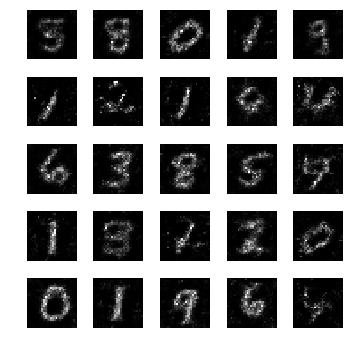

epoch: 1171, time: 4.936368 | train_G_Loss: 0.351405, train_D_loss: 2.612570, train_acc: 0.917969
cv_G_Loss: 0.668383, cv_D_loss: 2.639163, cv_acc: 0.904100

epoch: 1172, time: 4.924158 | train_G_Loss: 0.402498, train_D_loss: 2.424185, train_acc: 0.931641
cv_G_Loss: 1.131775, cv_D_loss: 3.177138, cv_acc: 0.898100

epoch: 1173, time: 4.913947 | train_G_Loss: 0.342817, train_D_loss: 2.180931, train_acc: 0.906250
cv_G_Loss: 0.299609, cv_D_loss: 2.571033, cv_acc: 0.894500

epoch: 1174, time: 4.912205 | train_G_Loss: 0.386269, train_D_loss: 2.428196, train_acc: 0.878906
cv_G_Loss: 0.457550, cv_D_loss: 2.508087, cv_acc: 0.900600

epoch: 1175, time: 4.918347 | train_G_Loss: 0.381252, train_D_loss: 2.681352, train_acc: 0.892578
cv_G_Loss: 0.339730, cv_D_loss: 2.484415, cv_acc: 0.900600

epoch: 1176, time: 4.917775 | train_G_Loss: 0.358169, train_D_loss: 2.824614, train_acc: 0.929688
cv_G_Loss: 0.680740, cv_D_loss: 2.728393, cv_acc: 0.889500

epoch: 1177, time: 4.913165 | train_G_Loss: 0.451867

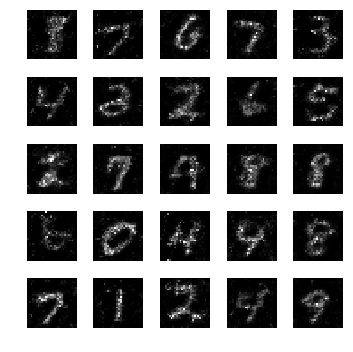

epoch: 1181, time: 4.938661 | train_G_Loss: 0.357508, train_D_loss: 3.704520, train_acc: 0.865234
cv_G_Loss: 0.430016, cv_D_loss: 2.465389, cv_acc: 0.893000

epoch: 1182, time: 4.922202 | train_G_Loss: 0.399178, train_D_loss: 2.675026, train_acc: 0.888672
cv_G_Loss: 0.649499, cv_D_loss: 2.843162, cv_acc: 0.788400

epoch: 1183, time: 4.906210 | train_G_Loss: 0.458113, train_D_loss: 2.491466, train_acc: 0.916016
cv_G_Loss: 0.545508, cv_D_loss: 2.535940, cv_acc: 0.892400

epoch: 1184, time: 4.904182 | train_G_Loss: 0.330711, train_D_loss: 2.373253, train_acc: 0.927734
cv_G_Loss: 0.318269, cv_D_loss: 2.469304, cv_acc: 0.903900

epoch: 1185, time: 4.913133 | train_G_Loss: 0.392384, train_D_loss: 3.370119, train_acc: 0.931641
cv_G_Loss: 0.569360, cv_D_loss: 2.611361, cv_acc: 0.904700

epoch: 1186, time: 4.916287 | train_G_Loss: 0.429118, train_D_loss: 2.281956, train_acc: 0.929688
cv_G_Loss: 0.589676, cv_D_loss: 3.170732, cv_acc: 0.734800

epoch: 1187, time: 4.932103 | train_G_Loss: 0.443755

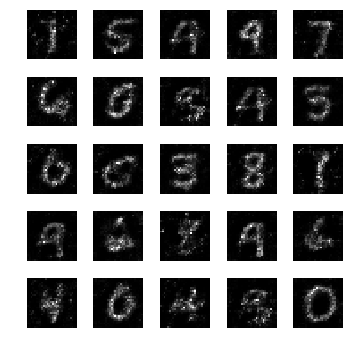

epoch: 1191, time: 4.924969 | train_G_Loss: 0.331425, train_D_loss: 2.566083, train_acc: 0.917969
cv_G_Loss: 0.370368, cv_D_loss: 2.620024, cv_acc: 0.890700

epoch: 1192, time: 4.922157 | train_G_Loss: 0.357629, train_D_loss: 2.335569, train_acc: 0.917969
cv_G_Loss: 0.701450, cv_D_loss: 2.842444, cv_acc: 0.875700

epoch: 1193, time: 4.916074 | train_G_Loss: 0.366980, train_D_loss: 2.638170, train_acc: 0.916016
cv_G_Loss: 0.479592, cv_D_loss: 3.195052, cv_acc: 0.676500

epoch: 1194, time: 4.909199 | train_G_Loss: 0.387110, train_D_loss: 2.459777, train_acc: 0.902344
cv_G_Loss: 0.417959, cv_D_loss: 2.508160, cv_acc: 0.884800

epoch: 1195, time: 4.919279 | train_G_Loss: 0.281887, train_D_loss: 2.498769, train_acc: 0.892578
cv_G_Loss: 0.457063, cv_D_loss: 2.815437, cv_acc: 0.814300

epoch: 1196, time: 4.910742 | train_G_Loss: 0.373081, train_D_loss: 2.782221, train_acc: 0.892578
cv_G_Loss: 0.675656, cv_D_loss: 2.720733, cv_acc: 0.895200

epoch: 1197, time: 4.909801 | train_G_Loss: 0.265102

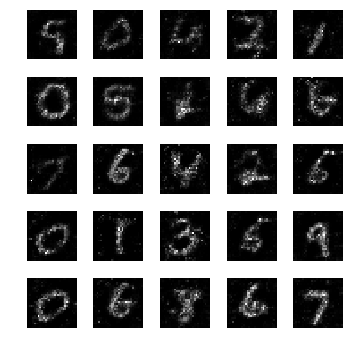

epoch: 1201, time: 4.944512 | train_G_Loss: 0.410705, train_D_loss: 2.395214, train_acc: 0.871094
cv_G_Loss: 0.803417, cv_D_loss: 3.016165, cv_acc: 0.756100

epoch: 1202, time: 4.919226 | train_G_Loss: 0.348202, train_D_loss: 2.462579, train_acc: 0.857422
cv_G_Loss: 0.214790, cv_D_loss: 2.732925, cv_acc: 0.860500

epoch: 1203, time: 4.918293 | train_G_Loss: 0.383013, train_D_loss: 2.940238, train_acc: 0.878906
cv_G_Loss: 0.929248, cv_D_loss: 3.251949, cv_acc: 0.868000

epoch: 1204, time: 4.919742 | train_G_Loss: 0.318713, train_D_loss: 2.256737, train_acc: 0.875000
cv_G_Loss: 0.254490, cv_D_loss: 2.550781, cv_acc: 0.903600

epoch: 1205, time: 4.934890 | train_G_Loss: 0.373990, train_D_loss: 2.400637, train_acc: 0.882812
cv_G_Loss: 0.492357, cv_D_loss: 2.580617, cv_acc: 0.878900

epoch: 1206, time: 4.934498 | train_G_Loss: 0.250300, train_D_loss: 2.824073, train_acc: 0.869141
cv_G_Loss: 0.168553, cv_D_loss: 2.891760, cv_acc: 0.847100

epoch: 1207, time: 4.907718 | train_G_Loss: 0.343921

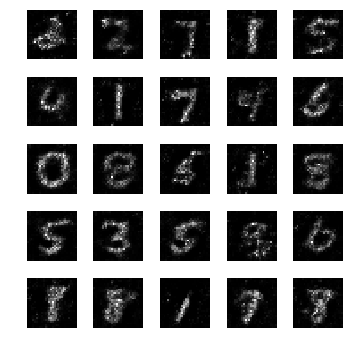

epoch: 1211, time: 4.955165 | train_G_Loss: 0.318720, train_D_loss: 2.842188, train_acc: 0.914062
cv_G_Loss: 0.318531, cv_D_loss: 2.513498, cv_acc: 0.899100

epoch: 1212, time: 4.928363 | train_G_Loss: 0.380544, train_D_loss: 2.268320, train_acc: 0.939453
cv_G_Loss: 0.601926, cv_D_loss: 2.796568, cv_acc: 0.870800

epoch: 1213, time: 4.931868 | train_G_Loss: 0.282735, train_D_loss: 2.326414, train_acc: 0.941406
cv_G_Loss: 0.257036, cv_D_loss: 2.518516, cv_acc: 0.902200

epoch: 1214, time: 4.936956 | train_G_Loss: 0.412297, train_D_loss: 2.267244, train_acc: 0.912109
cv_G_Loss: 0.423605, cv_D_loss: 2.646155, cv_acc: 0.863600

epoch: 1215, time: 4.921793 | train_G_Loss: 0.338160, train_D_loss: 2.222750, train_acc: 0.886719
cv_G_Loss: 0.394447, cv_D_loss: 2.491675, cv_acc: 0.898400

epoch: 1216, time: 4.922556 | train_G_Loss: 0.424306, train_D_loss: 2.532366, train_acc: 0.906250
cv_G_Loss: 0.367899, cv_D_loss: 2.488220, cv_acc: 0.905200

epoch: 1217, time: 4.936950 | train_G_Loss: 0.370580

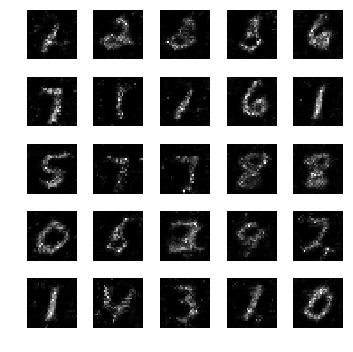

epoch: 1221, time: 4.945524 | train_G_Loss: 0.416841, train_D_loss: 2.706879, train_acc: 0.914062
cv_G_Loss: 0.843157, cv_D_loss: 3.092837, cv_acc: 0.845900

epoch: 1222, time: 4.913325 | train_G_Loss: 0.380759, train_D_loss: 2.496059, train_acc: 0.917969
cv_G_Loss: 0.655772, cv_D_loss: 2.732626, cv_acc: 0.895100

epoch: 1223, time: 4.924647 | train_G_Loss: 0.358692, train_D_loss: 2.301398, train_acc: 0.890625
cv_G_Loss: 0.437916, cv_D_loss: 2.512142, cv_acc: 0.901500

epoch: 1224, time: 4.920004 | train_G_Loss: 0.380294, train_D_loss: 2.962181, train_acc: 0.855469
cv_G_Loss: 0.842722, cv_D_loss: 2.868535, cv_acc: 0.899800

epoch: 1225, time: 4.921923 | train_G_Loss: 0.299350, train_D_loss: 2.292187, train_acc: 0.884766
cv_G_Loss: 0.690369, cv_D_loss: 2.714188, cv_acc: 0.876100

epoch: 1226, time: 4.934095 | train_G_Loss: 0.410887, train_D_loss: 2.519151, train_acc: 0.904297
cv_G_Loss: 0.628283, cv_D_loss: 2.597734, cv_acc: 0.900700

epoch: 1227, time: 4.968484 | train_G_Loss: 0.320332

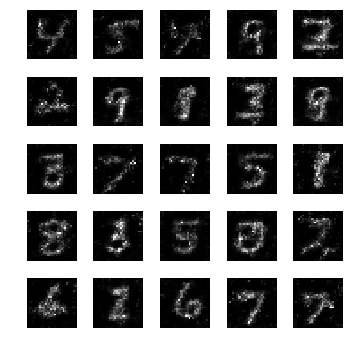

epoch: 1231, time: 4.949796 | train_G_Loss: 0.384762, train_D_loss: 2.775549, train_acc: 0.876953
cv_G_Loss: 0.610960, cv_D_loss: 2.818139, cv_acc: 0.873700

epoch: 1232, time: 4.935539 | train_G_Loss: 0.327892, train_D_loss: 3.409950, train_acc: 0.890625
cv_G_Loss: 0.559388, cv_D_loss: 2.600733, cv_acc: 0.893100

epoch: 1233, time: 4.941184 | train_G_Loss: 0.373179, train_D_loss: 2.506913, train_acc: 0.875000
cv_G_Loss: 0.397985, cv_D_loss: 2.491487, cv_acc: 0.900900

epoch: 1234, time: 4.935598 | train_G_Loss: 0.320641, train_D_loss: 2.513172, train_acc: 0.908203
cv_G_Loss: 0.628421, cv_D_loss: 2.683064, cv_acc: 0.897200

epoch: 1235, time: 4.924911 | train_G_Loss: 0.399575, train_D_loss: 2.195364, train_acc: 0.916016
cv_G_Loss: 0.442194, cv_D_loss: 2.566019, cv_acc: 0.891800

epoch: 1236, time: 4.927186 | train_G_Loss: 0.407062, train_D_loss: 2.893975, train_acc: 0.910156
cv_G_Loss: 0.467196, cv_D_loss: 2.612058, cv_acc: 0.888200

epoch: 1237, time: 4.915893 | train_G_Loss: 0.413858

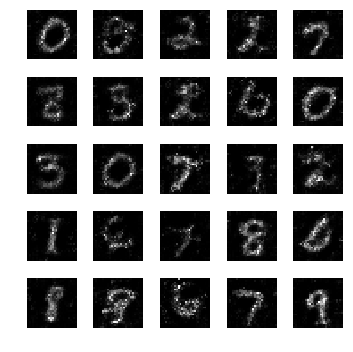

epoch: 1241, time: 4.940771 | train_G_Loss: 0.446270, train_D_loss: 2.476604, train_acc: 0.859375
cv_G_Loss: 0.383754, cv_D_loss: 2.507864, cv_acc: 0.903300

epoch: 1242, time: 4.923273 | train_G_Loss: 0.419685, train_D_loss: 2.302003, train_acc: 0.888672
cv_G_Loss: 1.381730, cv_D_loss: 4.511595, cv_acc: 0.479000

epoch: 1243, time: 4.927238 | train_G_Loss: 0.357553, train_D_loss: 2.420529, train_acc: 0.876953
cv_G_Loss: 0.821935, cv_D_loss: 2.896199, cv_acc: 0.894800

epoch: 1244, time: 4.910774 | train_G_Loss: 0.375548, train_D_loss: 2.778794, train_acc: 0.912109
cv_G_Loss: 0.375612, cv_D_loss: 2.409946, cv_acc: 0.904000

epoch: 1245, time: 4.919831 | train_G_Loss: 0.375606, train_D_loss: 2.195190, train_acc: 0.931641
cv_G_Loss: 0.553733, cv_D_loss: 2.565665, cv_acc: 0.905400

epoch: 1246, time: 4.916059 | train_G_Loss: 0.333258, train_D_loss: 2.177896, train_acc: 0.912109
cv_G_Loss: 0.828304, cv_D_loss: 2.759016, cv_acc: 0.895400

epoch: 1247, time: 4.929398 | train_G_Loss: 0.327477

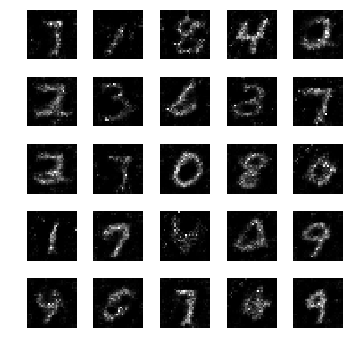

epoch: 1251, time: 4.935780 | train_G_Loss: 0.429165, train_D_loss: 2.301340, train_acc: 0.900391
cv_G_Loss: 0.206853, cv_D_loss: 2.616148, cv_acc: 0.906800

epoch: 1252, time: 4.919284 | train_G_Loss: 0.368758, train_D_loss: 2.509773, train_acc: 0.876953
cv_G_Loss: 0.741022, cv_D_loss: 2.765437, cv_acc: 0.902200

epoch: 1253, time: 4.924615 | train_G_Loss: 0.341241, train_D_loss: 2.255661, train_acc: 0.902344
cv_G_Loss: 0.265798, cv_D_loss: 2.531260, cv_acc: 0.905300

epoch: 1254, time: 4.929947 | train_G_Loss: 0.357993, train_D_loss: 2.677994, train_acc: 0.875000
cv_G_Loss: 0.972580, cv_D_loss: 3.091848, cv_acc: 0.850200

epoch: 1255, time: 4.937636 | train_G_Loss: 0.308663, train_D_loss: 2.274204, train_acc: 0.904297
cv_G_Loss: 0.501721, cv_D_loss: 2.830889, cv_acc: 0.822500

epoch: 1256, time: 4.958045 | train_G_Loss: 0.403605, train_D_loss: 2.084863, train_acc: 0.894531
cv_G_Loss: 0.831147, cv_D_loss: 2.991202, cv_acc: 0.869700

epoch: 1257, time: 4.916649 | train_G_Loss: 0.300986

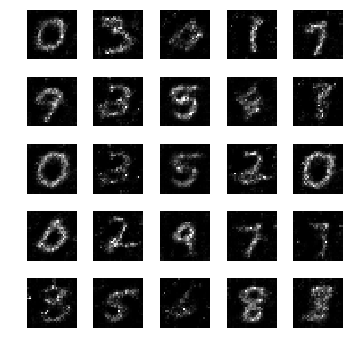

epoch: 1261, time: 4.939610 | train_G_Loss: 0.397873, train_D_loss: 2.240499, train_acc: 0.925781
cv_G_Loss: 0.538692, cv_D_loss: 2.524857, cv_acc: 0.902600

epoch: 1262, time: 4.916196 | train_G_Loss: 0.369378, train_D_loss: 2.327937, train_acc: 0.904297
cv_G_Loss: 0.448416, cv_D_loss: 2.905301, cv_acc: 0.813500

epoch: 1263, time: 4.922985 | train_G_Loss: 0.427848, train_D_loss: 2.144773, train_acc: 0.906250
cv_G_Loss: 0.632899, cv_D_loss: 2.771360, cv_acc: 0.889300

epoch: 1264, time: 4.902373 | train_G_Loss: 0.303757, train_D_loss: 2.717438, train_acc: 0.882812
cv_G_Loss: 0.216978, cv_D_loss: 2.596955, cv_acc: 0.898800

epoch: 1265, time: 4.922216 | train_G_Loss: 0.312126, train_D_loss: 3.538063, train_acc: 0.861328
cv_G_Loss: 0.806656, cv_D_loss: 2.973272, cv_acc: 0.892900

epoch: 1266, time: 4.916528 | train_G_Loss: 0.296559, train_D_loss: 2.715576, train_acc: 0.880859
cv_G_Loss: 0.416883, cv_D_loss: 2.428739, cv_acc: 0.901400

epoch: 1267, time: 4.913524 | train_G_Loss: 0.420969

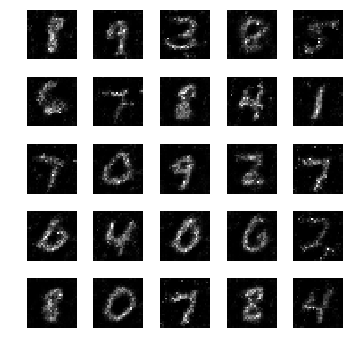

epoch: 1271, time: 4.937858 | train_G_Loss: 0.354534, train_D_loss: 2.824272, train_acc: 0.880859
cv_G_Loss: 0.282910, cv_D_loss: 2.637419, cv_acc: 0.864300

epoch: 1272, time: 4.924044 | train_G_Loss: 0.283484, train_D_loss: 3.167815, train_acc: 0.917969
cv_G_Loss: 0.234226, cv_D_loss: 2.772638, cv_acc: 0.835600

epoch: 1273, time: 4.927226 | train_G_Loss: 0.413149, train_D_loss: 2.258670, train_acc: 0.900391
cv_G_Loss: 0.631554, cv_D_loss: 2.805336, cv_acc: 0.886300

epoch: 1274, time: 4.920339 | train_G_Loss: 0.349778, train_D_loss: 2.187737, train_acc: 0.882812
cv_G_Loss: 0.615417, cv_D_loss: 2.727429, cv_acc: 0.884700

epoch: 1275, time: 4.922100 | train_G_Loss: 0.356024, train_D_loss: 2.781826, train_acc: 0.910156
cv_G_Loss: 0.668583, cv_D_loss: 2.677217, cv_acc: 0.897100

epoch: 1276, time: 4.909522 | train_G_Loss: 0.342055, train_D_loss: 2.402663, train_acc: 0.884766
cv_G_Loss: 0.211475, cv_D_loss: 2.672055, cv_acc: 0.889800

epoch: 1277, time: 4.920043 | train_G_Loss: 0.413452

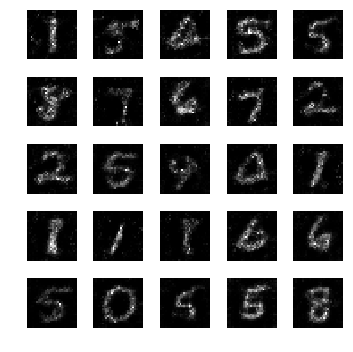

epoch: 1281, time: 4.948737 | train_G_Loss: 0.414031, train_D_loss: 2.383798, train_acc: 0.906250
cv_G_Loss: 1.052097, cv_D_loss: 3.523708, cv_acc: 0.853300

epoch: 1282, time: 4.919930 | train_G_Loss: 0.358337, train_D_loss: 2.284696, train_acc: 0.921875
cv_G_Loss: 0.463635, cv_D_loss: 2.561216, cv_acc: 0.900100

epoch: 1283, time: 4.914656 | train_G_Loss: 0.340392, train_D_loss: 3.763901, train_acc: 0.880859
cv_G_Loss: 0.416652, cv_D_loss: 2.587589, cv_acc: 0.879500

epoch: 1284, time: 4.924792 | train_G_Loss: 0.483280, train_D_loss: 2.622327, train_acc: 0.880859
cv_G_Loss: 0.867434, cv_D_loss: 2.996644, cv_acc: 0.833400

epoch: 1285, time: 4.915414 | train_G_Loss: 0.290930, train_D_loss: 2.537674, train_acc: 0.927734
cv_G_Loss: 0.296080, cv_D_loss: 2.552607, cv_acc: 0.885300

epoch: 1286, time: 4.921331 | train_G_Loss: 0.413747, train_D_loss: 2.374105, train_acc: 0.935547
cv_G_Loss: 0.200634, cv_D_loss: 2.768006, cv_acc: 0.869500

epoch: 1287, time: 4.917584 | train_G_Loss: 0.277939

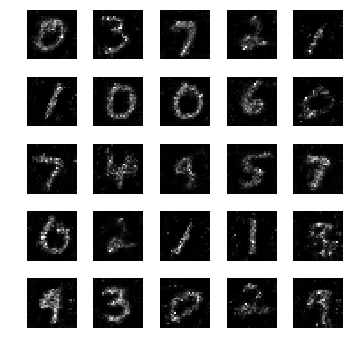

epoch: 1291, time: 4.943225 | train_G_Loss: 0.359289, train_D_loss: 2.600354, train_acc: 0.912109
cv_G_Loss: 0.478007, cv_D_loss: 2.594312, cv_acc: 0.898900

epoch: 1292, time: 4.942016 | train_G_Loss: 0.291813, train_D_loss: 2.617471, train_acc: 0.878906
cv_G_Loss: 0.679779, cv_D_loss: 2.707624, cv_acc: 0.893100

epoch: 1293, time: 4.915134 | train_G_Loss: 0.338876, train_D_loss: 2.394769, train_acc: 0.904297
cv_G_Loss: 0.347696, cv_D_loss: 2.667325, cv_acc: 0.852700

epoch: 1294, time: 4.922444 | train_G_Loss: 0.482013, train_D_loss: 2.410205, train_acc: 0.939453
cv_G_Loss: 0.349959, cv_D_loss: 2.534515, cv_acc: 0.904600

epoch: 1295, time: 4.921271 | train_G_Loss: 0.394651, train_D_loss: 2.458341, train_acc: 0.947266
cv_G_Loss: 1.250576, cv_D_loss: 3.424192, cv_acc: 0.898100

epoch: 1296, time: 4.904357 | train_G_Loss: 0.480810, train_D_loss: 2.352646, train_acc: 0.947266
cv_G_Loss: 0.378318, cv_D_loss: 2.547318, cv_acc: 0.891000

epoch: 1297, time: 4.920614 | train_G_Loss: 0.362698

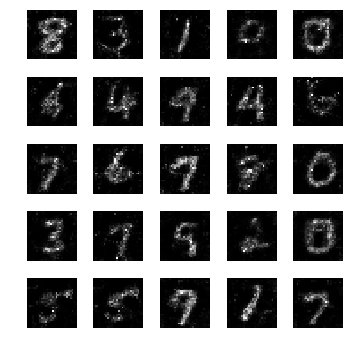

epoch: 1301, time: 4.963577 | train_G_Loss: 0.303600, train_D_loss: 2.218708, train_acc: 0.888672
cv_G_Loss: 0.351919, cv_D_loss: 2.479964, cv_acc: 0.904400

epoch: 1302, time: 4.928328 | train_G_Loss: 0.391778, train_D_loss: 2.495353, train_acc: 0.919922
cv_G_Loss: 0.935339, cv_D_loss: 2.956458, cv_acc: 0.876700

epoch: 1303, time: 4.908572 | train_G_Loss: 0.345473, train_D_loss: 2.595832, train_acc: 0.916016
cv_G_Loss: 0.383091, cv_D_loss: 2.513926, cv_acc: 0.901300

epoch: 1304, time: 4.912124 | train_G_Loss: 0.398507, train_D_loss: 2.910147, train_acc: 0.912109
cv_G_Loss: 0.626802, cv_D_loss: 2.607275, cv_acc: 0.899200

epoch: 1305, time: 4.918178 | train_G_Loss: 0.321113, train_D_loss: 2.524362, train_acc: 0.917969
cv_G_Loss: 0.552931, cv_D_loss: 2.538997, cv_acc: 0.903500

epoch: 1306, time: 4.928920 | train_G_Loss: 0.405934, train_D_loss: 2.744559, train_acc: 0.916016
cv_G_Loss: 0.692704, cv_D_loss: 3.204473, cv_acc: 0.767600

epoch: 1307, time: 4.919554 | train_G_Loss: 0.418778

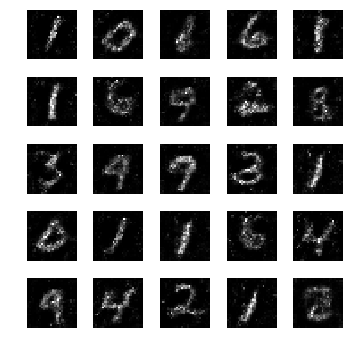

epoch: 1311, time: 4.959795 | train_G_Loss: 0.399601, train_D_loss: 2.867332, train_acc: 0.898438
cv_G_Loss: 0.429332, cv_D_loss: 2.536334, cv_acc: 0.902400

epoch: 1312, time: 4.923049 | train_G_Loss: 0.499437, train_D_loss: 2.457487, train_acc: 0.888672
cv_G_Loss: 0.777367, cv_D_loss: 2.909514, cv_acc: 0.886200

epoch: 1313, time: 4.920002 | train_G_Loss: 0.301733, train_D_loss: 2.612977, train_acc: 0.843750
cv_G_Loss: 0.499469, cv_D_loss: 2.626169, cv_acc: 0.888400

epoch: 1314, time: 4.923573 | train_G_Loss: 0.303060, train_D_loss: 4.728002, train_acc: 0.894531
cv_G_Loss: 0.494665, cv_D_loss: 2.484025, cv_acc: 0.888500

epoch: 1315, time: 4.917116 | train_G_Loss: 0.391007, train_D_loss: 2.222803, train_acc: 0.906250
cv_G_Loss: 0.378802, cv_D_loss: 2.503758, cv_acc: 0.906200

epoch: 1316, time: 4.918223 | train_G_Loss: 0.365877, train_D_loss: 3.011190, train_acc: 0.912109
cv_G_Loss: 0.400549, cv_D_loss: 2.464053, cv_acc: 0.899300

epoch: 1317, time: 4.917839 | train_G_Loss: 0.311537

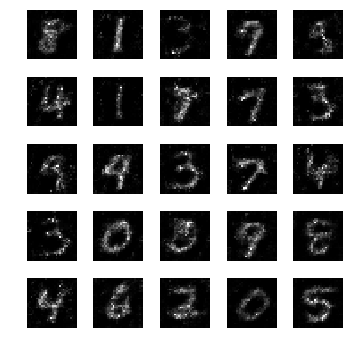

epoch: 1321, time: 4.939111 | train_G_Loss: 0.363687, train_D_loss: 2.468591, train_acc: 0.923828
cv_G_Loss: 0.473747, cv_D_loss: 2.574227, cv_acc: 0.895900

epoch: 1322, time: 4.914865 | train_G_Loss: 0.361125, train_D_loss: 2.391030, train_acc: 0.921875
cv_G_Loss: 0.529096, cv_D_loss: 2.478250, cv_acc: 0.900400

epoch: 1323, time: 4.927804 | train_G_Loss: 0.287727, train_D_loss: 2.342844, train_acc: 0.880859
cv_G_Loss: 0.246420, cv_D_loss: 2.535518, cv_acc: 0.906100

epoch: 1324, time: 4.925639 | train_G_Loss: 0.287908, train_D_loss: 2.497101, train_acc: 0.888672
cv_G_Loss: 0.383371, cv_D_loss: 2.678690, cv_acc: 0.838300

epoch: 1325, time: 4.930557 | train_G_Loss: 0.417969, train_D_loss: 2.563556, train_acc: 0.896484
cv_G_Loss: 0.736314, cv_D_loss: 3.031925, cv_acc: 0.850200

epoch: 1326, time: 4.926439 | train_G_Loss: 0.424552, train_D_loss: 2.414927, train_acc: 0.900391
cv_G_Loss: 0.691095, cv_D_loss: 2.638723, cv_acc: 0.878700

epoch: 1327, time: 4.912009 | train_G_Loss: 0.456847

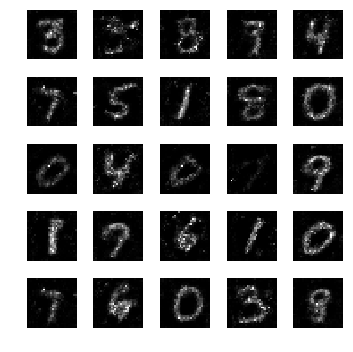

epoch: 1331, time: 4.967956 | train_G_Loss: 0.355563, train_D_loss: 2.792024, train_acc: 0.875000
cv_G_Loss: 0.884075, cv_D_loss: 3.219467, cv_acc: 0.833900

epoch: 1332, time: 4.911495 | train_G_Loss: 0.370004, train_D_loss: 2.132632, train_acc: 0.863281
cv_G_Loss: 0.851051, cv_D_loss: 3.161024, cv_acc: 0.833100

epoch: 1333, time: 4.921716 | train_G_Loss: 0.298519, train_D_loss: 2.707101, train_acc: 0.869141
cv_G_Loss: 0.449077, cv_D_loss: 2.427913, cv_acc: 0.902000

epoch: 1334, time: 4.933906 | train_G_Loss: 0.284231, train_D_loss: 3.423599, train_acc: 0.873047
cv_G_Loss: 0.317300, cv_D_loss: 2.464067, cv_acc: 0.907600

epoch: 1335, time: 4.917244 | train_G_Loss: 0.295038, train_D_loss: 2.165413, train_acc: 0.916016
cv_G_Loss: 0.279637, cv_D_loss: 2.542783, cv_acc: 0.892300

epoch: 1336, time: 4.929720 | train_G_Loss: 0.348971, train_D_loss: 2.375695, train_acc: 0.910156
cv_G_Loss: 0.412250, cv_D_loss: 2.508600, cv_acc: 0.875400

epoch: 1337, time: 4.919597 | train_G_Loss: 0.392699

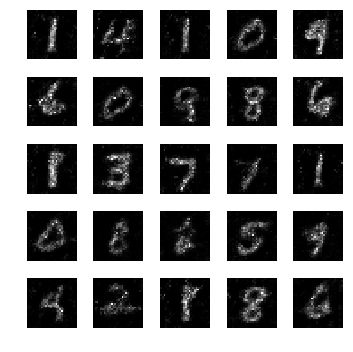

epoch: 1341, time: 4.957309 | train_G_Loss: 0.357428, train_D_loss: 2.189399, train_acc: 0.892578
cv_G_Loss: 0.863495, cv_D_loss: 2.817185, cv_acc: 0.877900

epoch: 1342, time: 4.915194 | train_G_Loss: 0.309174, train_D_loss: 2.592905, train_acc: 0.886719
cv_G_Loss: 0.318393, cv_D_loss: 2.611434, cv_acc: 0.878300

epoch: 1343, time: 4.916690 | train_G_Loss: 0.294644, train_D_loss: 2.265744, train_acc: 0.900391
cv_G_Loss: 0.227420, cv_D_loss: 2.550715, cv_acc: 0.903000

epoch: 1344, time: 4.918109 | train_G_Loss: 0.329721, train_D_loss: 2.709928, train_acc: 0.906250
cv_G_Loss: 0.515741, cv_D_loss: 2.501038, cv_acc: 0.901400

epoch: 1345, time: 4.921150 | train_G_Loss: 0.341903, train_D_loss: 2.398866, train_acc: 0.937500
cv_G_Loss: 0.393073, cv_D_loss: 2.424345, cv_acc: 0.902800

epoch: 1346, time: 4.923174 | train_G_Loss: 0.409833, train_D_loss: 2.392415, train_acc: 0.925781
cv_G_Loss: 1.263369, cv_D_loss: 3.458973, cv_acc: 0.885600

epoch: 1347, time: 4.922164 | train_G_Loss: 0.362185

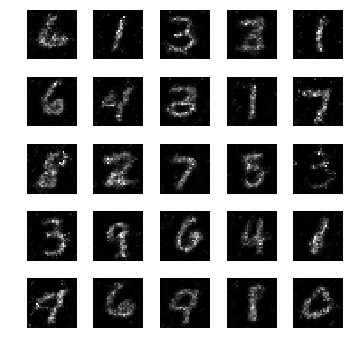

epoch: 1351, time: 4.947306 | train_G_Loss: 0.397962, train_D_loss: 2.274480, train_acc: 0.898438
cv_G_Loss: 0.465383, cv_D_loss: 2.541976, cv_acc: 0.902000

epoch: 1352, time: 4.930911 | train_G_Loss: 0.350424, train_D_loss: 2.203748, train_acc: 0.896484
cv_G_Loss: 0.373966, cv_D_loss: 2.554568, cv_acc: 0.877400

epoch: 1353, time: 4.928087 | train_G_Loss: 0.346431, train_D_loss: 2.385182, train_acc: 0.927734
cv_G_Loss: 0.294528, cv_D_loss: 2.659158, cv_acc: 0.844200

epoch: 1354, time: 4.930829 | train_G_Loss: 0.343601, train_D_loss: 3.134615, train_acc: 0.884766
cv_G_Loss: 0.301182, cv_D_loss: 2.503274, cv_acc: 0.901900

epoch: 1355, time: 4.935086 | train_G_Loss: 0.342012, train_D_loss: 2.445165, train_acc: 0.894531
cv_G_Loss: 0.228633, cv_D_loss: 2.709548, cv_acc: 0.870600

epoch: 1356, time: 4.925507 | train_G_Loss: 0.352802, train_D_loss: 2.318367, train_acc: 0.914062
cv_G_Loss: 0.496024, cv_D_loss: 2.549804, cv_acc: 0.898400

epoch: 1357, time: 4.924665 | train_G_Loss: 0.452738

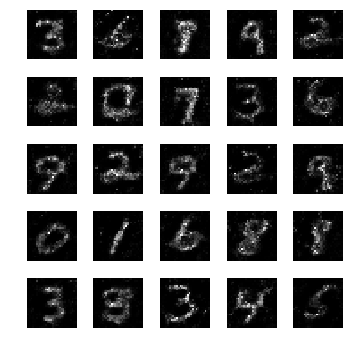

epoch: 1361, time: 4.959884 | train_G_Loss: 0.332449, train_D_loss: 2.904178, train_acc: 0.914062
cv_G_Loss: 0.566314, cv_D_loss: 2.484013, cv_acc: 0.905100

epoch: 1362, time: 4.933649 | train_G_Loss: 0.448811, train_D_loss: 2.189788, train_acc: 0.916016
cv_G_Loss: 0.398872, cv_D_loss: 2.556817, cv_acc: 0.898700

epoch: 1363, time: 4.932484 | train_G_Loss: 0.347284, train_D_loss: 2.833274, train_acc: 0.923828
cv_G_Loss: 0.409931, cv_D_loss: 2.460968, cv_acc: 0.906900

epoch: 1364, time: 4.931070 | train_G_Loss: 0.349863, train_D_loss: 2.321389, train_acc: 0.902344
cv_G_Loss: 0.311319, cv_D_loss: 2.451982, cv_acc: 0.908300

epoch: 1365, time: 4.919626 | train_G_Loss: 0.383750, train_D_loss: 3.001403, train_acc: 0.898438
cv_G_Loss: 0.612889, cv_D_loss: 2.667401, cv_acc: 0.900900

epoch: 1366, time: 4.928405 | train_G_Loss: 0.372553, train_D_loss: 2.526275, train_acc: 0.886719
cv_G_Loss: 0.556145, cv_D_loss: 2.700718, cv_acc: 0.867700

epoch: 1367, time: 4.933490 | train_G_Loss: 0.359710

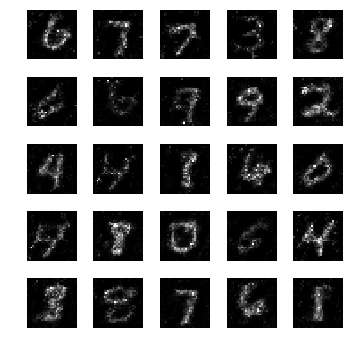

epoch: 1371, time: 4.957723 | train_G_Loss: 0.389375, train_D_loss: 2.184437, train_acc: 0.923828
cv_G_Loss: 0.569837, cv_D_loss: 2.811476, cv_acc: 0.866500

epoch: 1372, time: 4.927888 | train_G_Loss: 0.355861, train_D_loss: 2.379833, train_acc: 0.916016
cv_G_Loss: 0.355116, cv_D_loss: 2.416492, cv_acc: 0.901600

epoch: 1373, time: 4.923081 | train_G_Loss: 0.343867, train_D_loss: 2.279081, train_acc: 0.896484
cv_G_Loss: 0.482186, cv_D_loss: 2.465047, cv_acc: 0.909000

epoch: 1374, time: 4.919379 | train_G_Loss: 0.320989, train_D_loss: 2.438203, train_acc: 0.894531
cv_G_Loss: 0.738287, cv_D_loss: 2.761216, cv_acc: 0.895200

epoch: 1375, time: 4.930826 | train_G_Loss: 0.307509, train_D_loss: 2.525683, train_acc: 0.896484
cv_G_Loss: 0.250842, cv_D_loss: 2.518858, cv_acc: 0.907200

epoch: 1376, time: 4.922201 | train_G_Loss: 0.379704, train_D_loss: 2.270228, train_acc: 0.906250
cv_G_Loss: 0.711958, cv_D_loss: 2.667543, cv_acc: 0.894300

epoch: 1377, time: 4.922727 | train_G_Loss: 0.299459

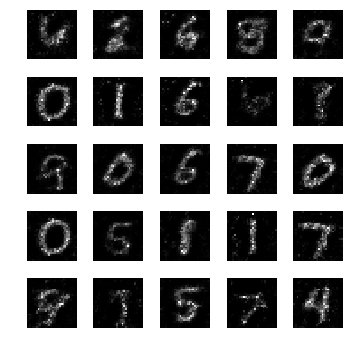

epoch: 1381, time: 4.939685 | train_G_Loss: 0.391663, train_D_loss: 2.402390, train_acc: 0.898438
cv_G_Loss: 0.409334, cv_D_loss: 2.468726, cv_acc: 0.893100

epoch: 1382, time: 4.920220 | train_G_Loss: 0.405072, train_D_loss: 2.863090, train_acc: 0.884766
cv_G_Loss: 0.493690, cv_D_loss: 2.588948, cv_acc: 0.901600

epoch: 1383, time: 4.916238 | train_G_Loss: 0.367811, train_D_loss: 3.127530, train_acc: 0.904297
cv_G_Loss: 0.574410, cv_D_loss: 2.653956, cv_acc: 0.894200

epoch: 1384, time: 4.913770 | train_G_Loss: 0.361646, train_D_loss: 2.131332, train_acc: 0.884766
cv_G_Loss: 0.346634, cv_D_loss: 2.566100, cv_acc: 0.886200

epoch: 1385, time: 4.925432 | train_G_Loss: 0.404658, train_D_loss: 2.346355, train_acc: 0.861328
cv_G_Loss: 0.380959, cv_D_loss: 2.606899, cv_acc: 0.852400

epoch: 1386, time: 4.921534 | train_G_Loss: 0.440735, train_D_loss: 2.953202, train_acc: 0.880859
cv_G_Loss: 0.856368, cv_D_loss: 3.132579, cv_acc: 0.849800

epoch: 1387, time: 4.928818 | train_G_Loss: 0.389016

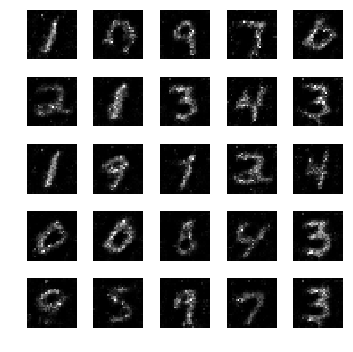

epoch: 1391, time: 4.946332 | train_G_Loss: 0.331811, train_D_loss: 2.741288, train_acc: 0.892578
cv_G_Loss: 0.199124, cv_D_loss: 2.647128, cv_acc: 0.903600

epoch: 1392, time: 4.940430 | train_G_Loss: 0.314495, train_D_loss: 2.888973, train_acc: 0.859375
cv_G_Loss: 0.510764, cv_D_loss: 2.576640, cv_acc: 0.875700

epoch: 1393, time: 4.911972 | train_G_Loss: 0.443074, train_D_loss: 2.494123, train_acc: 0.833984
cv_G_Loss: 0.396817, cv_D_loss: 2.640416, cv_acc: 0.869600

epoch: 1394, time: 4.921781 | train_G_Loss: 0.369849, train_D_loss: 2.534512, train_acc: 0.882812
cv_G_Loss: 0.922789, cv_D_loss: 3.654195, cv_acc: 0.739100

epoch: 1395, time: 4.919888 | train_G_Loss: 0.441824, train_D_loss: 2.276235, train_acc: 0.910156
cv_G_Loss: 0.326281, cv_D_loss: 2.657763, cv_acc: 0.856800

epoch: 1396, time: 4.921806 | train_G_Loss: 0.324978, train_D_loss: 2.462775, train_acc: 0.898438
cv_G_Loss: 0.860898, cv_D_loss: 2.897673, cv_acc: 0.898000

epoch: 1397, time: 4.919459 | train_G_Loss: 0.463081

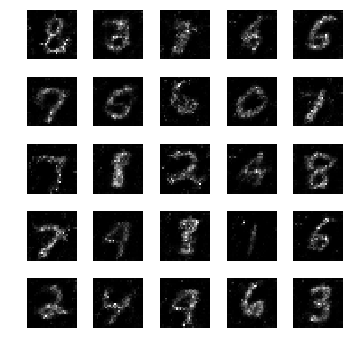

epoch: 1401, time: 4.957263 | train_G_Loss: 0.336213, train_D_loss: 2.267368, train_acc: 0.880859
cv_G_Loss: 0.280829, cv_D_loss: 2.594404, cv_acc: 0.871500

epoch: 1402, time: 4.916790 | train_G_Loss: 0.446312, train_D_loss: 2.143852, train_acc: 0.894531
cv_G_Loss: 0.781251, cv_D_loss: 2.892518, cv_acc: 0.897300

epoch: 1403, time: 4.908847 | train_G_Loss: 0.397573, train_D_loss: 2.161469, train_acc: 0.912109
cv_G_Loss: 0.429582, cv_D_loss: 2.477518, cv_acc: 0.906100

epoch: 1404, time: 4.920136 | train_G_Loss: 0.430961, train_D_loss: 2.417923, train_acc: 0.921875
cv_G_Loss: 0.660169, cv_D_loss: 2.695459, cv_acc: 0.897200

epoch: 1405, time: 4.930650 | train_G_Loss: 0.345292, train_D_loss: 2.204555, train_acc: 0.916016
cv_G_Loss: 0.438778, cv_D_loss: 2.464918, cv_acc: 0.910700
Model saved

epoch: 1406, time: 4.942619 | train_G_Loss: 0.367867, train_D_loss: 2.330512, train_acc: 0.890625
cv_G_Loss: 0.421620, cv_D_loss: 2.547074, cv_acc: 0.886500

epoch: 1407, time: 4.905769 | train_G_Lo

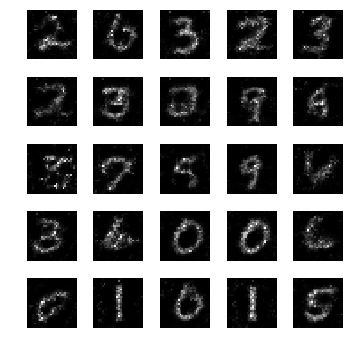

epoch: 1411, time: 4.943457 | train_G_Loss: 0.360726, train_D_loss: 2.606452, train_acc: 0.871094
cv_G_Loss: 0.665433, cv_D_loss: 2.623435, cv_acc: 0.906600

epoch: 1412, time: 4.924497 | train_G_Loss: 0.343711, train_D_loss: 2.408510, train_acc: 0.908203
cv_G_Loss: 0.446706, cv_D_loss: 2.844222, cv_acc: 0.789100

epoch: 1413, time: 4.932574 | train_G_Loss: 0.351922, train_D_loss: 2.244346, train_acc: 0.923828
cv_G_Loss: 0.346786, cv_D_loss: 2.486492, cv_acc: 0.909100

epoch: 1414, time: 4.926896 | train_G_Loss: 0.351033, train_D_loss: 2.483330, train_acc: 0.910156
cv_G_Loss: 0.444858, cv_D_loss: 2.744928, cv_acc: 0.847300

epoch: 1415, time: 4.934143 | train_G_Loss: 0.277851, train_D_loss: 2.597057, train_acc: 0.935547
cv_G_Loss: 0.466565, cv_D_loss: 2.510721, cv_acc: 0.903700

epoch: 1416, time: 4.923389 | train_G_Loss: 0.354995, train_D_loss: 3.135720, train_acc: 0.894531
cv_G_Loss: 0.523878, cv_D_loss: 2.518731, cv_acc: 0.887500

epoch: 1417, time: 4.923383 | train_G_Loss: 0.424562

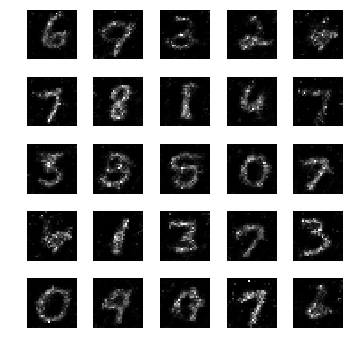

epoch: 1421, time: 4.951386 | train_G_Loss: 0.424325, train_D_loss: 2.166905, train_acc: 0.925781
cv_G_Loss: 1.195469, cv_D_loss: 3.422820, cv_acc: 0.904300

epoch: 1422, time: 4.919076 | train_G_Loss: 0.503936, train_D_loss: 2.362624, train_acc: 0.923828
cv_G_Loss: 0.850646, cv_D_loss: 2.996436, cv_acc: 0.887900

epoch: 1423, time: 4.915702 | train_G_Loss: 0.439194, train_D_loss: 2.373429, train_acc: 0.898438
cv_G_Loss: 0.563658, cv_D_loss: 2.513320, cv_acc: 0.902800

epoch: 1424, time: 4.923270 | train_G_Loss: 0.285335, train_D_loss: 2.417996, train_acc: 0.888672
cv_G_Loss: 0.482113, cv_D_loss: 2.454844, cv_acc: 0.909000

epoch: 1425, time: 4.931658 | train_G_Loss: 0.333596, train_D_loss: 2.422656, train_acc: 0.919922
cv_G_Loss: 0.421975, cv_D_loss: 2.512864, cv_acc: 0.908100

epoch: 1426, time: 4.935589 | train_G_Loss: 0.315937, train_D_loss: 2.553767, train_acc: 0.900391
cv_G_Loss: 0.550909, cv_D_loss: 2.506099, cv_acc: 0.910200

epoch: 1427, time: 4.913263 | train_G_Loss: 0.373993

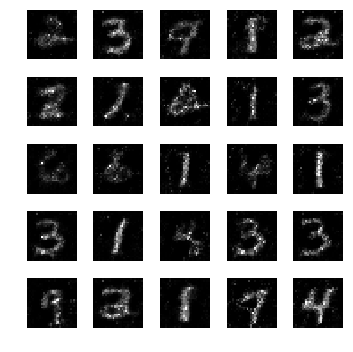

epoch: 1431, time: 4.947758 | train_G_Loss: 0.399229, train_D_loss: 2.319376, train_acc: 0.929688
cv_G_Loss: 0.807137, cv_D_loss: 2.724104, cv_acc: 0.902300

epoch: 1432, time: 4.922900 | train_G_Loss: 0.292006, train_D_loss: 3.169003, train_acc: 0.900391
cv_G_Loss: 0.202014, cv_D_loss: 2.610529, cv_acc: 0.907900

epoch: 1433, time: 4.926357 | train_G_Loss: 0.276300, train_D_loss: 2.649286, train_acc: 0.898438
cv_G_Loss: 0.686791, cv_D_loss: 3.236149, cv_acc: 0.551700

epoch: 1434, time: 4.965618 | train_G_Loss: 0.343172, train_D_loss: 2.397402, train_acc: 0.927734
cv_G_Loss: 0.555630, cv_D_loss: 2.735330, cv_acc: 0.876900

epoch: 1435, time: 4.926517 | train_G_Loss: 0.395906, train_D_loss: 2.201560, train_acc: 0.919922
cv_G_Loss: 0.497397, cv_D_loss: 2.552981, cv_acc: 0.909200

epoch: 1436, time: 4.927354 | train_G_Loss: 0.434134, train_D_loss: 2.268975, train_acc: 0.900391
cv_G_Loss: 0.639041, cv_D_loss: 2.576852, cv_acc: 0.898800

epoch: 1437, time: 4.930413 | train_G_Loss: 0.356273

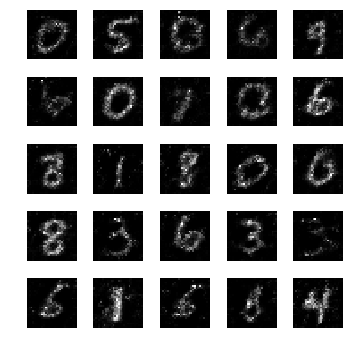

epoch: 1441, time: 4.940295 | train_G_Loss: 0.294589, train_D_loss: 2.641732, train_acc: 0.919922
cv_G_Loss: 0.361215, cv_D_loss: 2.476952, cv_acc: 0.903900

epoch: 1442, time: 4.924568 | train_G_Loss: 0.320819, train_D_loss: 2.504718, train_acc: 0.914062
cv_G_Loss: 0.328661, cv_D_loss: 2.470402, cv_acc: 0.910000

epoch: 1443, time: 4.918933 | train_G_Loss: 0.400291, train_D_loss: 2.096040, train_acc: 0.896484
cv_G_Loss: 1.052807, cv_D_loss: 3.158516, cv_acc: 0.901400

epoch: 1444, time: 4.929972 | train_G_Loss: 0.377783, train_D_loss: 2.913177, train_acc: 0.896484
cv_G_Loss: 0.313339, cv_D_loss: 2.507893, cv_acc: 0.904400

epoch: 1445, time: 4.926288 | train_G_Loss: 0.372115, train_D_loss: 2.618128, train_acc: 0.876953
cv_G_Loss: 0.964468, cv_D_loss: 3.113016, cv_acc: 0.826300

epoch: 1446, time: 4.928579 | train_G_Loss: 0.379433, train_D_loss: 2.239450, train_acc: 0.906250
cv_G_Loss: 0.501902, cv_D_loss: 2.552349, cv_acc: 0.888500

epoch: 1447, time: 4.912929 | train_G_Loss: 0.241486

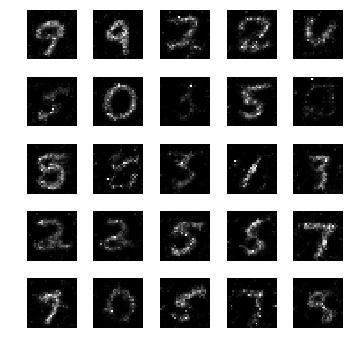

epoch: 1451, time: 4.940407 | train_G_Loss: 0.292119, train_D_loss: 2.372216, train_acc: 0.880859
cv_G_Loss: 1.250277, cv_D_loss: 3.566149, cv_acc: 0.800100

epoch: 1452, time: 4.911500 | train_G_Loss: 0.302795, train_D_loss: 2.606183, train_acc: 0.917969
cv_G_Loss: 0.333829, cv_D_loss: 2.471083, cv_acc: 0.910900

epoch: 1453, time: 4.906759 | train_G_Loss: 0.402232, train_D_loss: 2.160105, train_acc: 0.896484
cv_G_Loss: 0.555709, cv_D_loss: 2.729025, cv_acc: 0.877400

epoch: 1454, time: 4.913656 | train_G_Loss: 0.353617, train_D_loss: 2.263011, train_acc: 0.894531
cv_G_Loss: 0.422544, cv_D_loss: 2.437989, cv_acc: 0.911500

epoch: 1455, time: 4.917745 | train_G_Loss: 0.430237, train_D_loss: 2.233975, train_acc: 0.894531
cv_G_Loss: 0.501201, cv_D_loss: 2.450614, cv_acc: 0.905000

epoch: 1456, time: 4.919639 | train_G_Loss: 0.418017, train_D_loss: 2.312478, train_acc: 0.900391
cv_G_Loss: 0.968725, cv_D_loss: 3.190253, cv_acc: 0.879300

epoch: 1457, time: 4.920830 | train_G_Loss: 0.468802

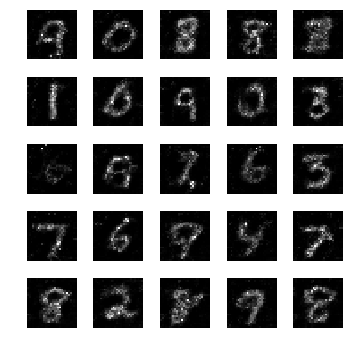

epoch: 1461, time: 4.942423 | train_G_Loss: 0.353850, train_D_loss: 2.286426, train_acc: 0.919922
cv_G_Loss: 0.380500, cv_D_loss: 2.478364, cv_acc: 0.908100

epoch: 1462, time: 4.926623 | train_G_Loss: 0.338100, train_D_loss: 2.300265, train_acc: 0.888672
cv_G_Loss: 0.397466, cv_D_loss: 2.585000, cv_acc: 0.873000

epoch: 1463, time: 4.923182 | train_G_Loss: 0.459147, train_D_loss: 2.550431, train_acc: 0.890625
cv_G_Loss: 0.589947, cv_D_loss: 2.482924, cv_acc: 0.904100

epoch: 1464, time: 4.913429 | train_G_Loss: 0.317080, train_D_loss: 2.422378, train_acc: 0.912109
cv_G_Loss: 0.425288, cv_D_loss: 2.494790, cv_acc: 0.906000

epoch: 1465, time: 4.919067 | train_G_Loss: 0.423054, train_D_loss: 2.148995, train_acc: 0.916016
cv_G_Loss: 0.575667, cv_D_loss: 2.621501, cv_acc: 0.896100

epoch: 1466, time: 4.917128 | train_G_Loss: 0.436144, train_D_loss: 2.273359, train_acc: 0.908203
cv_G_Loss: 0.545370, cv_D_loss: 2.519641, cv_acc: 0.899600

epoch: 1467, time: 4.910383 | train_G_Loss: 0.426215

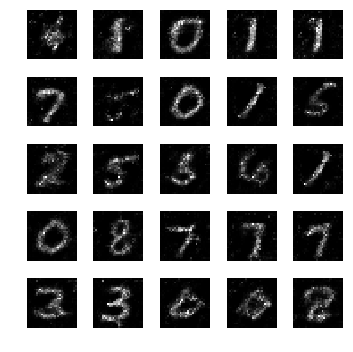

epoch: 1471, time: 4.951113 | train_G_Loss: 0.386047, train_D_loss: 2.439631, train_acc: 0.937500
cv_G_Loss: 0.564120, cv_D_loss: 2.559736, cv_acc: 0.907000

epoch: 1472, time: 4.925205 | train_G_Loss: 0.274738, train_D_loss: 2.379683, train_acc: 0.925781
cv_G_Loss: 0.434016, cv_D_loss: 2.599211, cv_acc: 0.882300

epoch: 1473, time: 4.927072 | train_G_Loss: 0.403630, train_D_loss: 3.130341, train_acc: 0.937500
cv_G_Loss: 0.480106, cv_D_loss: 2.526119, cv_acc: 0.909400

epoch: 1474, time: 4.929314 | train_G_Loss: 0.478486, train_D_loss: 2.599578, train_acc: 0.923828
cv_G_Loss: 0.582508, cv_D_loss: 2.645617, cv_acc: 0.886900

epoch: 1475, time: 4.922281 | train_G_Loss: 0.341436, train_D_loss: 2.271801, train_acc: 0.921875
cv_G_Loss: 0.562930, cv_D_loss: 2.584806, cv_acc: 0.882000

epoch: 1476, time: 4.923057 | train_G_Loss: 0.408051, train_D_loss: 2.417367, train_acc: 0.929688
cv_G_Loss: 0.607184, cv_D_loss: 2.609825, cv_acc: 0.899300

epoch: 1477, time: 4.920814 | train_G_Loss: 0.336156

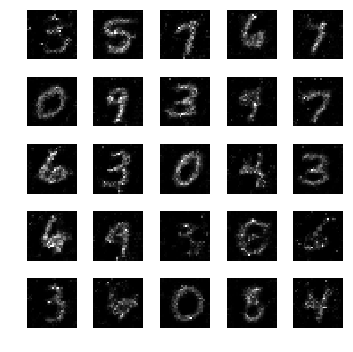

epoch: 1481, time: 4.954085 | train_G_Loss: 0.413284, train_D_loss: 2.074808, train_acc: 0.951172
cv_G_Loss: 0.881649, cv_D_loss: 2.850272, cv_acc: 0.900700

epoch: 1482, time: 4.916857 | train_G_Loss: 0.402910, train_D_loss: 2.177091, train_acc: 0.941406
cv_G_Loss: 0.509668, cv_D_loss: 2.537537, cv_acc: 0.902400

epoch: 1483, time: 4.938801 | train_G_Loss: 0.489805, train_D_loss: 2.432128, train_acc: 0.966797
cv_G_Loss: 0.750390, cv_D_loss: 2.750035, cv_acc: 0.906500

epoch: 1484, time: 4.923032 | train_G_Loss: 0.387721, train_D_loss: 2.223685, train_acc: 0.949219
cv_G_Loss: 0.426839, cv_D_loss: 2.533751, cv_acc: 0.890100

epoch: 1485, time: 4.928043 | train_G_Loss: 0.399850, train_D_loss: 2.778069, train_acc: 0.933594
cv_G_Loss: 0.370369, cv_D_loss: 2.469177, cv_acc: 0.912500

epoch: 1486, time: 4.928220 | train_G_Loss: 0.387602, train_D_loss: 2.363738, train_acc: 0.925781
cv_G_Loss: 0.888996, cv_D_loss: 2.903336, cv_acc: 0.910400

epoch: 1487, time: 4.939368 | train_G_Loss: 0.257166

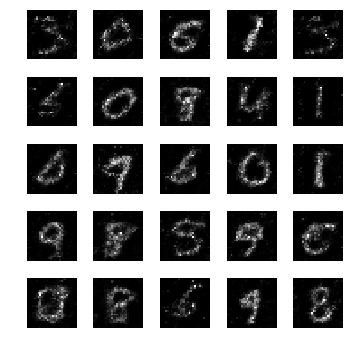

epoch: 1491, time: 4.955298 | train_G_Loss: 0.370008, train_D_loss: 2.065065, train_acc: 0.929688
cv_G_Loss: 0.617910, cv_D_loss: 2.599299, cv_acc: 0.904700

epoch: 1492, time: 4.936430 | train_G_Loss: 0.278275, train_D_loss: 3.070701, train_acc: 0.908203
cv_G_Loss: 0.623963, cv_D_loss: 2.581668, cv_acc: 0.887900

epoch: 1493, time: 4.925040 | train_G_Loss: 0.423409, train_D_loss: 2.372913, train_acc: 0.904297
cv_G_Loss: 0.495116, cv_D_loss: 2.482026, cv_acc: 0.912400

epoch: 1494, time: 4.931347 | train_G_Loss: 0.343490, train_D_loss: 4.038897, train_acc: 0.908203
cv_G_Loss: 0.470334, cv_D_loss: 2.510532, cv_acc: 0.907200

epoch: 1495, time: 4.921350 | train_G_Loss: 0.313259, train_D_loss: 2.937871, train_acc: 0.904297
cv_G_Loss: 0.434231, cv_D_loss: 2.475706, cv_acc: 0.905500

epoch: 1496, time: 4.937188 | train_G_Loss: 0.356896, train_D_loss: 2.520915, train_acc: 0.904297
cv_G_Loss: 0.641018, cv_D_loss: 2.600490, cv_acc: 0.908800

epoch: 1497, time: 4.919668 | train_G_Loss: 0.346556

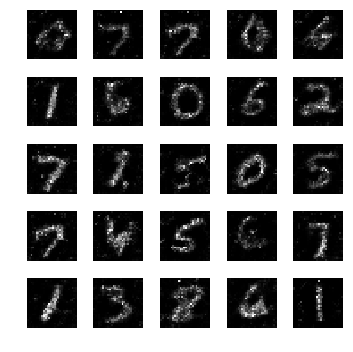

Discriminator summary:
 x: (?, 28, 28, 1)
 D1: (?, 14, 14, 32)
 D2: (?, 7, 7, 64)
 D3: (?, 4, 4, 128)
 D4: (?, 2, 2, 128)

Generator summary:
 z: (?, 100)
 G0: (?, 1, 1, 100)
 G1: (?, 2, 2, 100)
 G2: (?, 5, 5, 64)
 G3: (?, 12, 12, 32)
 G4: (?, 28, 28, 1)

Discriminator summary:
 x: (?, 28, 28, 1)
 D1: (?, 14, 14, 32)
 D2: (?, 7, 7, 64)
 D3: (?, 4, 4, 128)
 D4: (?, 2, 2, 128)

training....
Extracting mnist_data\train-images-idx3-ubyte.gz
Extracting mnist_data\train-labels-idx1-ubyte.gz
Extracting mnist_data\t10k-images-idx3-ubyte.gz
Extracting mnist_data\t10k-labels-idx1-ubyte.gz
epoch: 0, time: 6.255563 | train_G_Loss: 0.616643, train_D_loss: 3.616658, train_acc: 0.107422
cv_G_Loss: 0.490019, cv_D_loss: 4.803177, cv_acc: 0.113500
Model saved



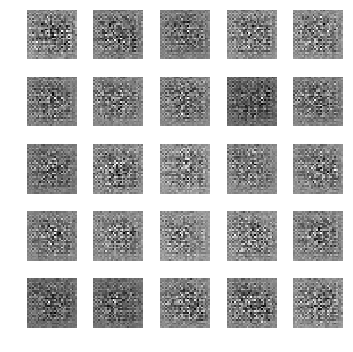

epoch: 1, time: 5.074048 | train_G_Loss: 0.895400, train_D_loss: 3.184912, train_acc: 0.101562
cv_G_Loss: 2.153637, cv_D_loss: 8.838809, cv_acc: 0.098000

epoch: 2, time: 5.041284 | train_G_Loss: 1.242453, train_D_loss: 2.917767, train_acc: 0.101562
cv_G_Loss: 3.276811, cv_D_loss: 11.595205, cv_acc: 0.098000

epoch: 3, time: 5.045286 | train_G_Loss: 1.626809, train_D_loss: 2.719025, train_acc: 0.113281
cv_G_Loss: 3.596109, cv_D_loss: 13.936287, cv_acc: 0.098000

epoch: 4, time: 5.045964 | train_G_Loss: 1.990795, train_D_loss: 2.581085, train_acc: 0.076172
cv_G_Loss: 4.112381, cv_D_loss: 16.345503, cv_acc: 0.098000

epoch: 5, time: 5.027980 | train_G_Loss: 1.991790, train_D_loss: 2.591231, train_acc: 0.109375
cv_G_Loss: 4.330566, cv_D_loss: 18.469751, cv_acc: 0.098000

epoch: 6, time: 5.042688 | train_G_Loss: 2.323384, train_D_loss: 2.535458, train_acc: 0.107422
cv_G_Loss: 4.620665, cv_D_loss: 20.288790, cv_acc: 0.098000

epoch: 7, time: 5.046417 | train_G_Loss: 2.656023, train_D_loss: 

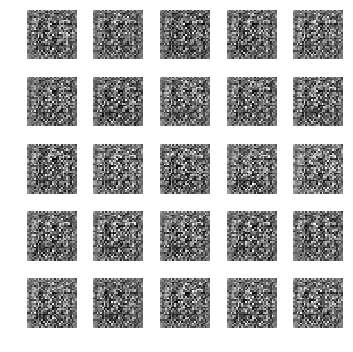

epoch: 11, time: 5.061239 | train_G_Loss: 3.505174, train_D_loss: 2.358806, train_acc: 0.115234
cv_G_Loss: 8.146937, cv_D_loss: 30.444427, cv_acc: 0.098000

epoch: 12, time: 5.052203 | train_G_Loss: 3.513997, train_D_loss: 2.355887, train_acc: 0.068359
cv_G_Loss: 7.848130, cv_D_loss: 30.776003, cv_acc: 0.098000

epoch: 13, time: 5.044166 | train_G_Loss: 3.519367, train_D_loss: 2.353358, train_acc: 0.158203
cv_G_Loss: 7.552565, cv_D_loss: 30.076569, cv_acc: 0.098000

epoch: 14, time: 5.020682 | train_G_Loss: 3.530416, train_D_loss: 2.372420, train_acc: 0.111328
cv_G_Loss: 7.304991, cv_D_loss: 30.342295, cv_acc: 0.102900

epoch: 15, time: 5.037918 | train_G_Loss: 3.509172, train_D_loss: 2.355593, train_acc: 0.121094
cv_G_Loss: 6.948718, cv_D_loss: 31.803921, cv_acc: 0.103200

epoch: 16, time: 5.034663 | train_G_Loss: 3.734244, train_D_loss: 2.346430, train_acc: 0.109375
cv_G_Loss: 6.627308, cv_D_loss: 32.644794, cv_acc: 0.103200

epoch: 17, time: 5.038349 | train_G_Loss: 3.864534, train_

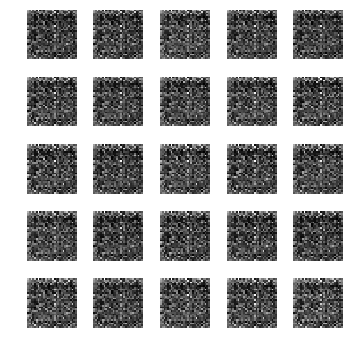

epoch: 21, time: 5.062013 | train_G_Loss: 3.786419, train_D_loss: 2.347217, train_acc: 0.109375
cv_G_Loss: 5.091703, cv_D_loss: 30.047792, cv_acc: 0.103200

epoch: 22, time: 5.025589 | train_G_Loss: 3.737547, train_D_loss: 2.362250, train_acc: 0.089844
cv_G_Loss: 4.730344, cv_D_loss: 29.273413, cv_acc: 0.103200

epoch: 23, time: 5.026171 | train_G_Loss: 3.589282, train_D_loss: 2.354010, train_acc: 0.115234
cv_G_Loss: 4.156721, cv_D_loss: 27.614227, cv_acc: 0.110400

epoch: 24, time: 5.035837 | train_G_Loss: 3.256702, train_D_loss: 2.372817, train_acc: 0.117188
cv_G_Loss: 3.304036, cv_D_loss: 25.788664, cv_acc: 0.102800

epoch: 25, time: 5.037169 | train_G_Loss: 3.071231, train_D_loss: 2.416396, train_acc: 0.111328
cv_G_Loss: 2.650557, cv_D_loss: 24.705639, cv_acc: 0.113500

epoch: 26, time: 5.054309 | train_G_Loss: 2.893263, train_D_loss: 2.411662, train_acc: 0.085938
cv_G_Loss: 2.538448, cv_D_loss: 23.108847, cv_acc: 0.096800

epoch: 27, time: 5.030390 | train_G_Loss: 2.782472, train_

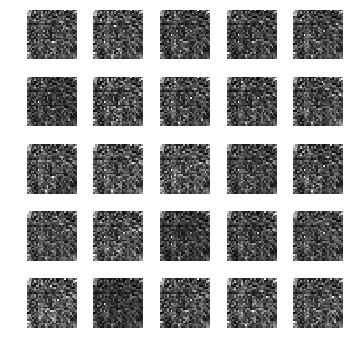

epoch: 31, time: 5.060109 | train_G_Loss: 2.303051, train_D_loss: 2.512005, train_acc: 0.099609
cv_G_Loss: 1.649629, cv_D_loss: 23.430441, cv_acc: 0.113500

epoch: 32, time: 5.028315 | train_G_Loss: 2.162379, train_D_loss: 2.566957, train_acc: 0.136719
cv_G_Loss: 1.498422, cv_D_loss: 22.986572, cv_acc: 0.113500

epoch: 33, time: 5.029162 | train_G_Loss: 1.977949, train_D_loss: 2.563962, train_acc: 0.144531
cv_G_Loss: 1.240410, cv_D_loss: 20.942636, cv_acc: 0.113500

epoch: 34, time: 5.031699 | train_G_Loss: 1.881006, train_D_loss: 2.582775, train_acc: 0.230469
cv_G_Loss: 1.090761, cv_D_loss: 21.041653, cv_acc: 0.113500

epoch: 35, time: 5.037337 | train_G_Loss: 1.647270, train_D_loss: 2.676271, train_acc: 0.115234
cv_G_Loss: 0.945764, cv_D_loss: 19.783184, cv_acc: 0.113500

epoch: 36, time: 5.019461 | train_G_Loss: 1.633634, train_D_loss: 2.745761, train_acc: 0.177734
cv_G_Loss: 1.072737, cv_D_loss: 18.472521, cv_acc: 0.113600

epoch: 37, time: 5.034224 | train_G_Loss: 1.428272, train_

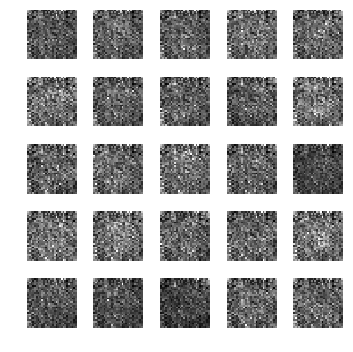

epoch: 41, time: 5.046278 | train_G_Loss: 1.023512, train_D_loss: 3.077121, train_acc: 0.304688
cv_G_Loss: 0.737166, cv_D_loss: 13.372814, cv_acc: 0.134500

epoch: 42, time: 5.022866 | train_G_Loss: 0.922847, train_D_loss: 3.191789, train_acc: 0.230469
cv_G_Loss: 0.660858, cv_D_loss: 12.426293, cv_acc: 0.173600
Model saved

epoch: 43, time: 5.050694 | train_G_Loss: 0.908628, train_D_loss: 3.257171, train_acc: 0.269531
cv_G_Loss: 0.637932, cv_D_loss: 11.288520, cv_acc: 0.121200

epoch: 44, time: 5.023553 | train_G_Loss: 0.918368, train_D_loss: 3.291309, train_acc: 0.136719
cv_G_Loss: 0.701196, cv_D_loss: 11.735757, cv_acc: 0.113700

epoch: 45, time: 5.021542 | train_G_Loss: 0.773331, train_D_loss: 3.343180, train_acc: 0.181641
cv_G_Loss: 0.588930, cv_D_loss: 10.158416, cv_acc: 0.206800
Model saved

epoch: 46, time: 5.059563 | train_G_Loss: 0.863783, train_D_loss: 3.404893, train_acc: 0.279297
cv_G_Loss: 0.605401, cv_D_loss: 9.742990, cv_acc: 0.216700
Model saved

epoch: 47, time: 5.0574

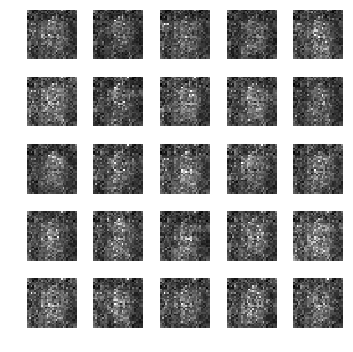

epoch: 51, time: 5.044370 | train_G_Loss: 0.659797, train_D_loss: 3.554279, train_acc: 0.384766
cv_G_Loss: 0.434933, cv_D_loss: 6.630342, cv_acc: 0.243800
Model saved

epoch: 52, time: 5.037739 | train_G_Loss: 0.760868, train_D_loss: 3.655272, train_acc: 0.488281
cv_G_Loss: 0.610702, cv_D_loss: 6.936144, cv_acc: 0.316700
Model saved

epoch: 53, time: 5.062832 | train_G_Loss: 0.602763, train_D_loss: 3.633147, train_acc: 0.324219
cv_G_Loss: 0.350788, cv_D_loss: 6.068230, cv_acc: 0.150000

epoch: 54, time: 5.024550 | train_G_Loss: 0.557503, train_D_loss: 3.625460, train_acc: 0.410156
cv_G_Loss: 0.322428, cv_D_loss: 6.225339, cv_acc: 0.178800

epoch: 55, time: 5.028485 | train_G_Loss: 0.552507, train_D_loss: 3.607046, train_acc: 0.367188
cv_G_Loss: 0.524312, cv_D_loss: 6.108268, cv_acc: 0.146700

epoch: 56, time: 5.031458 | train_G_Loss: 0.536794, train_D_loss: 3.703408, train_acc: 0.296875
cv_G_Loss: 0.317767, cv_D_loss: 5.679605, cv_acc: 0.251700

epoch: 57, time: 5.017063 | train_G_Loss

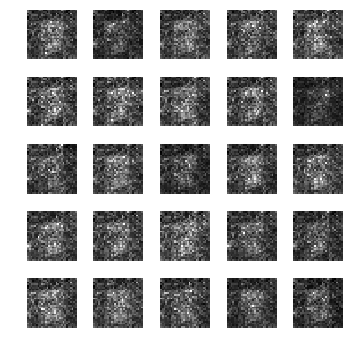

epoch: 61, time: 5.034645 | train_G_Loss: 0.583621, train_D_loss: 3.690752, train_acc: 0.406250
cv_G_Loss: 0.505267, cv_D_loss: 5.015383, cv_acc: 0.244400

epoch: 62, time: 5.019773 | train_G_Loss: 0.454840, train_D_loss: 3.723639, train_acc: 0.572266
cv_G_Loss: 0.264935, cv_D_loss: 4.920243, cv_acc: 0.360600
Model saved

epoch: 63, time: 5.078317 | train_G_Loss: 0.613592, train_D_loss: 3.757788, train_acc: 0.382812
cv_G_Loss: 0.660605, cv_D_loss: 5.151525, cv_acc: 0.262200

epoch: 64, time: 5.029960 | train_G_Loss: 0.485939, train_D_loss: 3.827493, train_acc: 0.373047
cv_G_Loss: 0.354388, cv_D_loss: 5.027204, cv_acc: 0.173500

epoch: 65, time: 5.027930 | train_G_Loss: 0.424861, train_D_loss: 3.795498, train_acc: 0.419922
cv_G_Loss: 0.320356, cv_D_loss: 4.790316, cv_acc: 0.161400

epoch: 66, time: 5.032420 | train_G_Loss: 0.503066, train_D_loss: 3.802314, train_acc: 0.539062
cv_G_Loss: 0.481437, cv_D_loss: 4.839554, cv_acc: 0.424800
Model saved

epoch: 67, time: 5.045249 | train_G_Loss

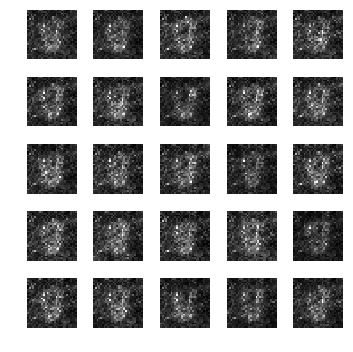

epoch: 71, time: 5.054823 | train_G_Loss: 0.402844, train_D_loss: 3.790224, train_acc: 0.660156
cv_G_Loss: 0.221249, cv_D_loss: 4.572773, cv_acc: 0.445300
Model saved

epoch: 72, time: 5.063887 | train_G_Loss: 0.466759, train_D_loss: 3.745163, train_acc: 0.507812
cv_G_Loss: 0.261619, cv_D_loss: 4.831038, cv_acc: 0.206100

epoch: 73, time: 5.038432 | train_G_Loss: 0.428859, train_D_loss: 3.858089, train_acc: 0.511719
cv_G_Loss: 0.445261, cv_D_loss: 4.865407, cv_acc: 0.408700

epoch: 74, time: 5.027722 | train_G_Loss: 0.448064, train_D_loss: 3.798203, train_acc: 0.515625
cv_G_Loss: 0.384946, cv_D_loss: 4.621557, cv_acc: 0.425600

epoch: 75, time: 5.030825 | train_G_Loss: 0.465037, train_D_loss: 3.717438, train_acc: 0.470703
cv_G_Loss: 0.380561, cv_D_loss: 4.768191, cv_acc: 0.158300

epoch: 76, time: 5.016407 | train_G_Loss: 0.463836, train_D_loss: 3.682993, train_acc: 0.587891
cv_G_Loss: 0.451039, cv_D_loss: 4.691733, cv_acc: 0.416500

epoch: 77, time: 5.019426 | train_G_Loss: 0.551614, 

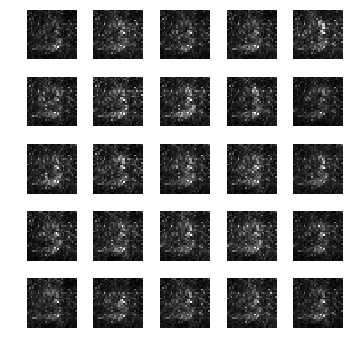

epoch: 81, time: 5.067502 | train_G_Loss: 0.490333, train_D_loss: 3.707782, train_acc: 0.701172
cv_G_Loss: 0.585918, cv_D_loss: 4.578438, cv_acc: 0.508800

epoch: 82, time: 5.007322 | train_G_Loss: 0.497429, train_D_loss: 3.778280, train_acc: 0.542969
cv_G_Loss: 0.203670, cv_D_loss: 4.579660, cv_acc: 0.357200

epoch: 83, time: 5.020441 | train_G_Loss: 0.451208, train_D_loss: 3.651418, train_acc: 0.621094
cv_G_Loss: 0.146125, cv_D_loss: 4.559317, cv_acc: 0.585500
Model saved

epoch: 84, time: 5.037416 | train_G_Loss: 0.498732, train_D_loss: 3.729692, train_acc: 0.494141
cv_G_Loss: 0.199828, cv_D_loss: 4.350811, cv_acc: 0.557500

epoch: 85, time: 5.019200 | train_G_Loss: 0.441425, train_D_loss: 3.741101, train_acc: 0.605469
cv_G_Loss: 0.766850, cv_D_loss: 4.946842, cv_acc: 0.393700

epoch: 86, time: 5.014258 | train_G_Loss: 0.553882, train_D_loss: 3.617987, train_acc: 0.662109
cv_G_Loss: 0.718736, cv_D_loss: 4.234295, cv_acc: 0.494200

epoch: 87, time: 5.111336 | train_G_Loss: 0.429530, 

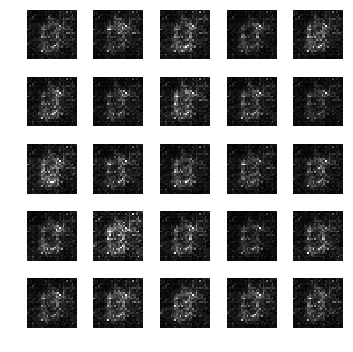

epoch: 91, time: 5.071353 | train_G_Loss: 0.496302, train_D_loss: 3.616963, train_acc: 0.644531
cv_G_Loss: 0.477604, cv_D_loss: 4.315034, cv_acc: 0.592400
Model saved

epoch: 92, time: 5.070364 | train_G_Loss: 0.348118, train_D_loss: 3.733234, train_acc: 0.603516
cv_G_Loss: 0.330020, cv_D_loss: 4.288536, cv_acc: 0.402300

epoch: 93, time: 5.011087 | train_G_Loss: 0.478535, train_D_loss: 3.555984, train_acc: 0.574219
cv_G_Loss: 0.480666, cv_D_loss: 4.052274, cv_acc: 0.557700

epoch: 94, time: 5.011842 | train_G_Loss: 0.583177, train_D_loss: 3.463859, train_acc: 0.636719
cv_G_Loss: 0.446337, cv_D_loss: 3.945560, cv_acc: 0.539000

epoch: 95, time: 5.020503 | train_G_Loss: 0.509498, train_D_loss: 3.597731, train_acc: 0.666016
cv_G_Loss: 0.894489, cv_D_loss: 4.610871, cv_acc: 0.459900

epoch: 96, time: 5.014190 | train_G_Loss: 0.565881, train_D_loss: 3.589369, train_acc: 0.644531
cv_G_Loss: 0.267046, cv_D_loss: 3.824324, cv_acc: 0.594700
Model saved

epoch: 97, time: 5.029521 | train_G_Loss

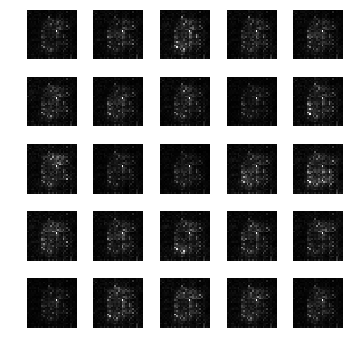

epoch: 101, time: 5.026129 | train_G_Loss: 0.478601, train_D_loss: 3.266784, train_acc: 0.681641
cv_G_Loss: 0.550416, cv_D_loss: 3.545129, cv_acc: 0.634700

epoch: 102, time: 4.997462 | train_G_Loss: 0.410865, train_D_loss: 3.385874, train_acc: 0.705078
cv_G_Loss: 0.292436, cv_D_loss: 3.892268, cv_acc: 0.582600

epoch: 103, time: 5.017368 | train_G_Loss: 0.476434, train_D_loss: 3.341110, train_acc: 0.685547
cv_G_Loss: 0.885988, cv_D_loss: 3.984038, cv_acc: 0.625000

epoch: 104, time: 5.006256 | train_G_Loss: 0.455732, train_D_loss: 3.310567, train_acc: 0.597656
cv_G_Loss: 0.281551, cv_D_loss: 3.863578, cv_acc: 0.460500

epoch: 105, time: 5.000624 | train_G_Loss: 0.505237, train_D_loss: 3.325825, train_acc: 0.705078
cv_G_Loss: 0.463708, cv_D_loss: 3.693264, cv_acc: 0.633900

epoch: 106, time: 5.004010 | train_G_Loss: 0.511157, train_D_loss: 3.178293, train_acc: 0.695312
cv_G_Loss: 0.351048, cv_D_loss: 3.787894, cv_acc: 0.511800

epoch: 107, time: 4.989080 | train_G_Loss: 0.546006, train

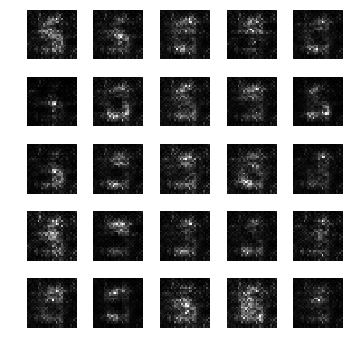

epoch: 111, time: 5.024252 | train_G_Loss: 0.366062, train_D_loss: 3.244977, train_acc: 0.736328
cv_G_Loss: 1.185095, cv_D_loss: 4.574871, cv_acc: 0.397500

epoch: 112, time: 4.994624 | train_G_Loss: 0.393895, train_D_loss: 3.071652, train_acc: 0.761719
cv_G_Loss: 0.345788, cv_D_loss: 3.408271, cv_acc: 0.695800

epoch: 113, time: 4.987203 | train_G_Loss: 0.442149, train_D_loss: 3.221434, train_acc: 0.746094
cv_G_Loss: 0.622538, cv_D_loss: 3.394639, cv_acc: 0.732100
Model saved

epoch: 114, time: 5.023535 | train_G_Loss: 0.607263, train_D_loss: 3.038764, train_acc: 0.775391
cv_G_Loss: 0.770622, cv_D_loss: 3.495583, cv_acc: 0.670000

epoch: 115, time: 4.987526 | train_G_Loss: 0.520288, train_D_loss: 2.988452, train_acc: 0.751953
cv_G_Loss: 0.223678, cv_D_loss: 3.509339, cv_acc: 0.643300

epoch: 116, time: 4.989770 | train_G_Loss: 0.384816, train_D_loss: 3.068564, train_acc: 0.734375
cv_G_Loss: 0.200644, cv_D_loss: 3.505242, cv_acc: 0.732600
Model saved

epoch: 117, time: 5.013678 | train

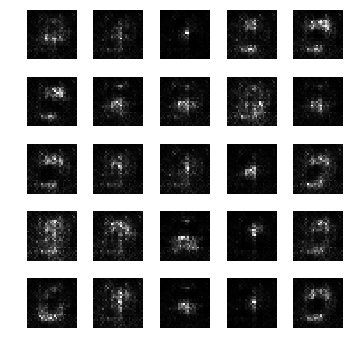

epoch: 121, time: 4.997965 | train_G_Loss: 0.507945, train_D_loss: 2.911716, train_acc: 0.753906
cv_G_Loss: 0.297305, cv_D_loss: 3.241420, cv_acc: 0.732800
Model saved

epoch: 122, time: 5.015253 | train_G_Loss: 0.510836, train_D_loss: 3.050220, train_acc: 0.746094
cv_G_Loss: 0.391917, cv_D_loss: 3.229744, cv_acc: 0.762600
Model saved

epoch: 123, time: 5.007917 | train_G_Loss: 0.400290, train_D_loss: 3.063097, train_acc: 0.707031
cv_G_Loss: 0.455006, cv_D_loss: 3.312251, cv_acc: 0.705400

epoch: 124, time: 4.972919 | train_G_Loss: 0.397786, train_D_loss: 3.292010, train_acc: 0.769531
cv_G_Loss: 0.158594, cv_D_loss: 3.654325, cv_acc: 0.640000

epoch: 125, time: 4.970402 | train_G_Loss: 0.394720, train_D_loss: 3.253398, train_acc: 0.761719
cv_G_Loss: 0.429827, cv_D_loss: 3.257810, cv_acc: 0.704600

epoch: 126, time: 4.982885 | train_G_Loss: 0.593000, train_D_loss: 2.992238, train_acc: 0.716797
cv_G_Loss: 0.358820, cv_D_loss: 3.258674, cv_acc: 0.765600
Model saved

epoch: 127, time: 5.02

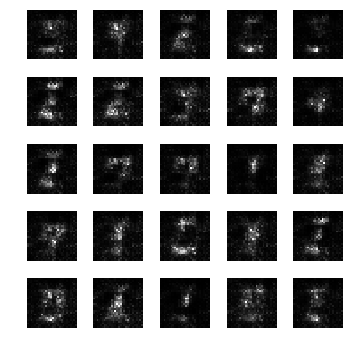

epoch: 131, time: 5.002578 | train_G_Loss: 0.415432, train_D_loss: 2.982573, train_acc: 0.818359
cv_G_Loss: 0.391723, cv_D_loss: 3.434748, cv_acc: 0.603900

epoch: 132, time: 4.985590 | train_G_Loss: 0.421357, train_D_loss: 2.978747, train_acc: 0.761719
cv_G_Loss: 0.364783, cv_D_loss: 3.166237, cv_acc: 0.736800

epoch: 133, time: 4.982528 | train_G_Loss: 0.409032, train_D_loss: 3.253730, train_acc: 0.796875
cv_G_Loss: 0.286463, cv_D_loss: 3.196547, cv_acc: 0.739500

epoch: 134, time: 4.978269 | train_G_Loss: 0.501707, train_D_loss: 2.751858, train_acc: 0.796875
cv_G_Loss: 0.685753, cv_D_loss: 3.619462, cv_acc: 0.546800

epoch: 135, time: 4.980757 | train_G_Loss: 0.458033, train_D_loss: 3.316861, train_acc: 0.763672
cv_G_Loss: 0.818055, cv_D_loss: 3.614088, cv_acc: 0.622200

epoch: 136, time: 4.991338 | train_G_Loss: 0.455756, train_D_loss: 3.067766, train_acc: 0.800781
cv_G_Loss: 0.813478, cv_D_loss: 3.480911, cv_acc: 0.763200

epoch: 137, time: 4.967903 | train_G_Loss: 0.415496, train

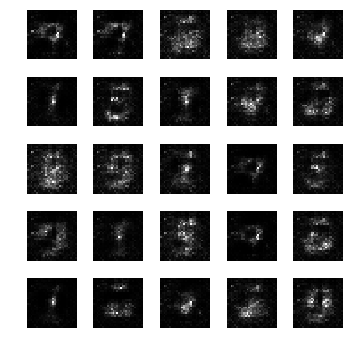

epoch: 141, time: 4.988812 | train_G_Loss: 0.415757, train_D_loss: 2.870459, train_acc: 0.832031
cv_G_Loss: 0.289948, cv_D_loss: 3.144123, cv_acc: 0.774500

epoch: 142, time: 4.978779 | train_G_Loss: 0.474722, train_D_loss: 2.691780, train_acc: 0.808594
cv_G_Loss: 0.390681, cv_D_loss: 3.047842, cv_acc: 0.751300

epoch: 143, time: 4.973984 | train_G_Loss: 0.485157, train_D_loss: 2.665083, train_acc: 0.767578
cv_G_Loss: 0.413954, cv_D_loss: 3.195329, cv_acc: 0.683600

epoch: 144, time: 4.982038 | train_G_Loss: 0.381467, train_D_loss: 3.113851, train_acc: 0.787109
cv_G_Loss: 0.485326, cv_D_loss: 3.046606, cv_acc: 0.796100
Model saved

epoch: 145, time: 5.012479 | train_G_Loss: 0.456202, train_D_loss: 2.763322, train_acc: 0.837891
cv_G_Loss: 0.296818, cv_D_loss: 3.168559, cv_acc: 0.772900

epoch: 146, time: 4.970747 | train_G_Loss: 0.482655, train_D_loss: 2.875514, train_acc: 0.822266
cv_G_Loss: 0.319555, cv_D_loss: 3.162288, cv_acc: 0.760000

epoch: 147, time: 4.963639 | train_G_Loss: 0.4

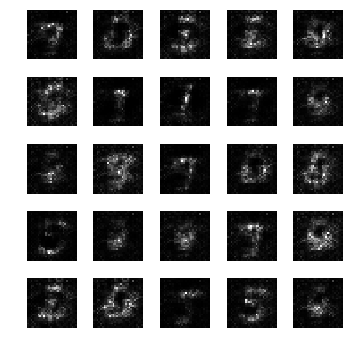

epoch: 151, time: 5.006584 | train_G_Loss: 0.313205, train_D_loss: 3.393542, train_acc: 0.736328
cv_G_Loss: 0.281177, cv_D_loss: 3.001510, cv_acc: 0.788600

epoch: 152, time: 4.968600 | train_G_Loss: 0.445424, train_D_loss: 2.783814, train_acc: 0.769531
cv_G_Loss: 0.841615, cv_D_loss: 3.310584, cv_acc: 0.768500

epoch: 153, time: 4.972950 | train_G_Loss: 0.595714, train_D_loss: 3.058842, train_acc: 0.775391
cv_G_Loss: 1.027257, cv_D_loss: 3.654281, cv_acc: 0.742200

epoch: 154, time: 4.971221 | train_G_Loss: 0.399104, train_D_loss: 2.962688, train_acc: 0.751953
cv_G_Loss: 0.224312, cv_D_loss: 3.141122, cv_acc: 0.801000
Model saved

epoch: 155, time: 4.995153 | train_G_Loss: 0.523810, train_D_loss: 2.768262, train_acc: 0.775391
cv_G_Loss: 0.692268, cv_D_loss: 3.228525, cv_acc: 0.786900

epoch: 156, time: 4.968372 | train_G_Loss: 0.423223, train_D_loss: 2.601710, train_acc: 0.796875
cv_G_Loss: 0.807109, cv_D_loss: 3.320623, cv_acc: 0.748500

epoch: 157, time: 4.971812 | train_G_Loss: 0.3

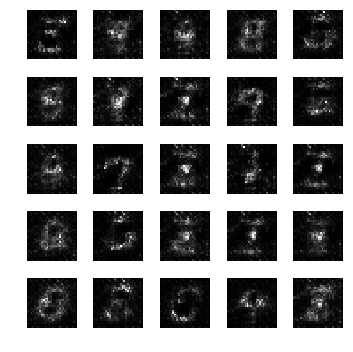

epoch: 161, time: 5.016070 | train_G_Loss: 0.392099, train_D_loss: 2.606906, train_acc: 0.779297
cv_G_Loss: 0.422279, cv_D_loss: 3.114249, cv_acc: 0.706100

epoch: 162, time: 4.961209 | train_G_Loss: 0.453817, train_D_loss: 3.010494, train_acc: 0.777344
cv_G_Loss: 0.461333, cv_D_loss: 2.949159, cv_acc: 0.803200
Model saved

epoch: 163, time: 5.002343 | train_G_Loss: 0.379683, train_D_loss: 2.892282, train_acc: 0.804688
cv_G_Loss: 0.514614, cv_D_loss: 3.031891, cv_acc: 0.807000
Model saved

epoch: 164, time: 4.984212 | train_G_Loss: 0.411713, train_D_loss: 2.572011, train_acc: 0.826172
cv_G_Loss: 0.388208, cv_D_loss: 2.863230, cv_acc: 0.795600

epoch: 165, time: 4.947739 | train_G_Loss: 0.345625, train_D_loss: 2.811546, train_acc: 0.816406
cv_G_Loss: 0.161484, cv_D_loss: 3.283299, cv_acc: 0.760400

epoch: 166, time: 4.964897 | train_G_Loss: 0.416633, train_D_loss: 2.701146, train_acc: 0.828125
cv_G_Loss: 0.608640, cv_D_loss: 3.056231, cv_acc: 0.783800

epoch: 167, time: 4.944292 | train

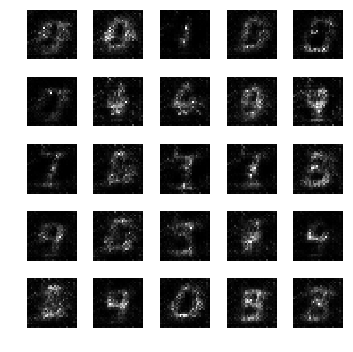

epoch: 171, time: 4.983323 | train_G_Loss: 0.377254, train_D_loss: 2.556525, train_acc: 0.828125
cv_G_Loss: 0.372571, cv_D_loss: 2.969529, cv_acc: 0.786800

epoch: 172, time: 4.959404 | train_G_Loss: 0.399280, train_D_loss: 2.574925, train_acc: 0.845703
cv_G_Loss: 0.417259, cv_D_loss: 3.081844, cv_acc: 0.772700

epoch: 173, time: 4.945879 | train_G_Loss: 0.544924, train_D_loss: 2.441673, train_acc: 0.832031
cv_G_Loss: 1.286397, cv_D_loss: 3.846514, cv_acc: 0.786600

epoch: 174, time: 4.942555 | train_G_Loss: 0.388287, train_D_loss: 2.698254, train_acc: 0.812500
cv_G_Loss: 1.210851, cv_D_loss: 3.689882, cv_acc: 0.784800

epoch: 175, time: 4.938438 | train_G_Loss: 0.483075, train_D_loss: 2.752627, train_acc: 0.837891
cv_G_Loss: 0.823463, cv_D_loss: 3.195935, cv_acc: 0.798400

epoch: 176, time: 4.957167 | train_G_Loss: 0.429733, train_D_loss: 2.329422, train_acc: 0.849609
cv_G_Loss: 0.437789, cv_D_loss: 2.989178, cv_acc: 0.739500

epoch: 177, time: 4.952308 | train_G_Loss: 0.368340, train

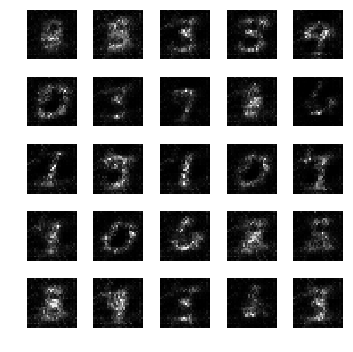

epoch: 181, time: 4.977368 | train_G_Loss: 0.522513, train_D_loss: 2.661079, train_acc: 0.875000
cv_G_Loss: 0.379377, cv_D_loss: 2.949393, cv_acc: 0.791500

epoch: 182, time: 4.953898 | train_G_Loss: 0.472390, train_D_loss: 2.544393, train_acc: 0.925781
cv_G_Loss: 0.685575, cv_D_loss: 3.071774, cv_acc: 0.795000

epoch: 183, time: 4.946099 | train_G_Loss: 0.527875, train_D_loss: 2.291172, train_acc: 0.882812
cv_G_Loss: 0.554631, cv_D_loss: 3.000301, cv_acc: 0.745300

epoch: 184, time: 4.944574 | train_G_Loss: 0.514230, train_D_loss: 2.375311, train_acc: 0.855469
cv_G_Loss: 2.216007, cv_D_loss: 5.161726, cv_acc: 0.734000

epoch: 185, time: 4.942159 | train_G_Loss: 0.446162, train_D_loss: 2.394807, train_acc: 0.861328
cv_G_Loss: 1.601656, cv_D_loss: 4.156160, cv_acc: 0.760900

epoch: 186, time: 4.937510 | train_G_Loss: 0.465299, train_D_loss: 2.247128, train_acc: 0.820312
cv_G_Loss: 0.678285, cv_D_loss: 3.080793, cv_acc: 0.742600

epoch: 187, time: 4.948039 | train_G_Loss: 0.398588, train

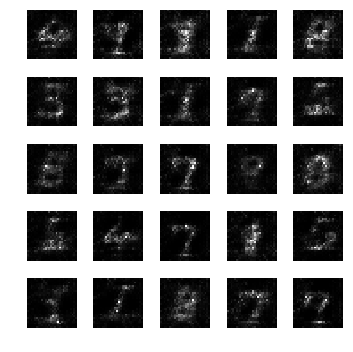

epoch: 191, time: 4.969984 | train_G_Loss: 0.448407, train_D_loss: 2.564094, train_acc: 0.841797
cv_G_Loss: 0.341356, cv_D_loss: 2.814320, cv_acc: 0.798900

epoch: 192, time: 4.950371 | train_G_Loss: 0.518491, train_D_loss: 2.357746, train_acc: 0.814453
cv_G_Loss: 1.451464, cv_D_loss: 3.902465, cv_acc: 0.793800

epoch: 193, time: 4.945092 | train_G_Loss: 0.371776, train_D_loss: 2.859414, train_acc: 0.769531
cv_G_Loss: 0.429249, cv_D_loss: 2.843332, cv_acc: 0.747800

epoch: 194, time: 4.949110 | train_G_Loss: 0.382204, train_D_loss: 2.900486, train_acc: 0.748047
cv_G_Loss: 0.819950, cv_D_loss: 3.001790, cv_acc: 0.782700

epoch: 195, time: 4.950145 | train_G_Loss: 0.485011, train_D_loss: 2.701834, train_acc: 0.785156
cv_G_Loss: 1.268415, cv_D_loss: 3.720835, cv_acc: 0.769900

epoch: 196, time: 4.948174 | train_G_Loss: 0.345619, train_D_loss: 2.742947, train_acc: 0.787109
cv_G_Loss: 1.324724, cv_D_loss: 3.836971, cv_acc: 0.803900

epoch: 197, time: 4.934057 | train_G_Loss: 0.408482, train

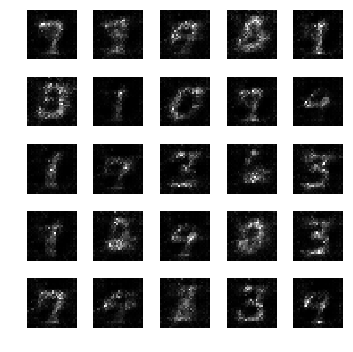

epoch: 201, time: 4.960257 | train_G_Loss: 0.437796, train_D_loss: 2.737100, train_acc: 0.830078
cv_G_Loss: 0.923543, cv_D_loss: 3.455207, cv_acc: 0.771300

epoch: 202, time: 4.966643 | train_G_Loss: 0.365301, train_D_loss: 2.641715, train_acc: 0.863281
cv_G_Loss: 1.356016, cv_D_loss: 4.575213, cv_acc: 0.651100

epoch: 203, time: 4.974763 | train_G_Loss: 0.572538, train_D_loss: 2.438657, train_acc: 0.859375
cv_G_Loss: 0.857975, cv_D_loss: 3.342234, cv_acc: 0.815800

epoch: 204, time: 4.956345 | train_G_Loss: 0.380163, train_D_loss: 2.553150, train_acc: 0.849609
cv_G_Loss: 0.263252, cv_D_loss: 3.007441, cv_acc: 0.777700

epoch: 205, time: 4.951310 | train_G_Loss: 0.422512, train_D_loss: 2.462223, train_acc: 0.839844
cv_G_Loss: 0.413123, cv_D_loss: 2.838859, cv_acc: 0.776200

epoch: 206, time: 4.947175 | train_G_Loss: 0.372760, train_D_loss: 2.825986, train_acc: 0.843750
cv_G_Loss: 0.201032, cv_D_loss: 2.994566, cv_acc: 0.808400

epoch: 207, time: 4.953572 | train_G_Loss: 0.401701, train

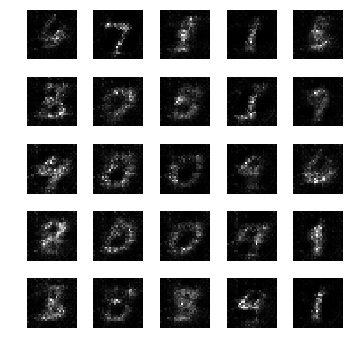

epoch: 211, time: 4.972705 | train_G_Loss: 0.411404, train_D_loss: 2.525784, train_acc: 0.773438
cv_G_Loss: 1.104510, cv_D_loss: 3.618930, cv_acc: 0.801100

epoch: 212, time: 4.960220 | train_G_Loss: 0.426698, train_D_loss: 2.835112, train_acc: 0.765625
cv_G_Loss: 0.839172, cv_D_loss: 3.196462, cv_acc: 0.799700

epoch: 213, time: 4.941132 | train_G_Loss: 0.495751, train_D_loss: 2.649940, train_acc: 0.757812
cv_G_Loss: 0.597042, cv_D_loss: 2.714206, cv_acc: 0.823400

epoch: 214, time: 4.956159 | train_G_Loss: 0.491288, train_D_loss: 2.954836, train_acc: 0.833984
cv_G_Loss: 2.234451, cv_D_loss: 5.453056, cv_acc: 0.810600

epoch: 215, time: 4.946911 | train_G_Loss: 0.464564, train_D_loss: 2.474595, train_acc: 0.830078
cv_G_Loss: 0.665122, cv_D_loss: 2.930110, cv_acc: 0.812100

epoch: 216, time: 4.940872 | train_G_Loss: 0.380212, train_D_loss: 2.695461, train_acc: 0.785156
cv_G_Loss: 0.380871, cv_D_loss: 2.839544, cv_acc: 0.786500

epoch: 217, time: 4.948982 | train_G_Loss: 0.447664, train

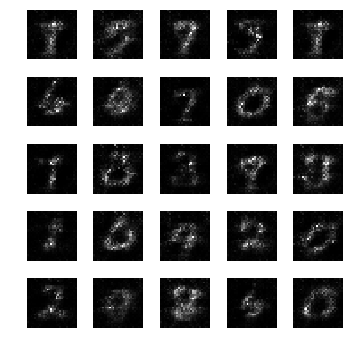

epoch: 221, time: 4.986018 | train_G_Loss: 0.436473, train_D_loss: 2.646665, train_acc: 0.845703
cv_G_Loss: 1.162599, cv_D_loss: 3.363599, cv_acc: 0.817900

epoch: 222, time: 4.949587 | train_G_Loss: 0.432025, train_D_loss: 2.630733, train_acc: 0.796875
cv_G_Loss: 0.165125, cv_D_loss: 3.464548, cv_acc: 0.669400

epoch: 223, time: 4.949533 | train_G_Loss: 0.319804, train_D_loss: 2.935145, train_acc: 0.787109
cv_G_Loss: 0.142855, cv_D_loss: 3.314384, cv_acc: 0.762000

epoch: 224, time: 4.939958 | train_G_Loss: 0.411230, train_D_loss: 2.570706, train_acc: 0.853516
cv_G_Loss: 0.593569, cv_D_loss: 2.871294, cv_acc: 0.831000
Model saved

epoch: 225, time: 4.971017 | train_G_Loss: 0.321272, train_D_loss: 2.633799, train_acc: 0.830078
cv_G_Loss: 0.223253, cv_D_loss: 2.915195, cv_acc: 0.784600

epoch: 226, time: 4.975404 | train_G_Loss: 0.377261, train_D_loss: 2.765407, train_acc: 0.789062
cv_G_Loss: 0.539261, cv_D_loss: 2.845912, cv_acc: 0.822000

epoch: 227, time: 4.955635 | train_G_Loss: 0.3

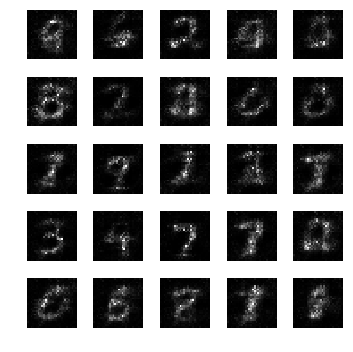

epoch: 231, time: 4.955263 | train_G_Loss: 0.414711, train_D_loss: 2.377208, train_acc: 0.873047
cv_G_Loss: 0.336527, cv_D_loss: 2.715719, cv_acc: 0.827700

epoch: 232, time: 4.953918 | train_G_Loss: 0.408664, train_D_loss: 2.744245, train_acc: 0.876953
cv_G_Loss: 0.260917, cv_D_loss: 2.819706, cv_acc: 0.823100

epoch: 233, time: 4.941532 | train_G_Loss: 0.431904, train_D_loss: 2.515860, train_acc: 0.845703
cv_G_Loss: 0.877181, cv_D_loss: 3.160903, cv_acc: 0.812000

epoch: 234, time: 4.950008 | train_G_Loss: 0.381682, train_D_loss: 2.670899, train_acc: 0.820312
cv_G_Loss: 1.348032, cv_D_loss: 3.967130, cv_acc: 0.834000
Model saved

epoch: 235, time: 4.999575 | train_G_Loss: 0.407693, train_D_loss: 2.759001, train_acc: 0.849609
cv_G_Loss: 0.477218, cv_D_loss: 2.790017, cv_acc: 0.818700

epoch: 236, time: 4.960819 | train_G_Loss: 0.447102, train_D_loss: 2.548135, train_acc: 0.853516
cv_G_Loss: 0.440708, cv_D_loss: 2.905154, cv_acc: 0.796600

epoch: 237, time: 4.968392 | train_G_Loss: 0.3

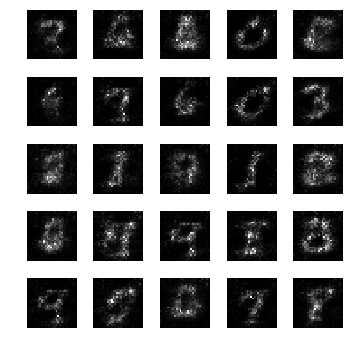

epoch: 241, time: 4.983878 | train_G_Loss: 0.427554, train_D_loss: 2.670918, train_acc: 0.853516
cv_G_Loss: 0.687750, cv_D_loss: 2.945135, cv_acc: 0.829900

epoch: 242, time: 4.957278 | train_G_Loss: 0.397093, train_D_loss: 2.991170, train_acc: 0.873047
cv_G_Loss: 0.468552, cv_D_loss: 2.790807, cv_acc: 0.826100

epoch: 243, time: 4.954536 | train_G_Loss: 0.430870, train_D_loss: 2.755147, train_acc: 0.869141
cv_G_Loss: 0.336561, cv_D_loss: 2.765237, cv_acc: 0.813700

epoch: 244, time: 4.940145 | train_G_Loss: 0.447964, train_D_loss: 2.486509, train_acc: 0.839844
cv_G_Loss: 1.598651, cv_D_loss: 4.210765, cv_acc: 0.830300

epoch: 245, time: 4.949326 | train_G_Loss: 0.384452, train_D_loss: 2.682579, train_acc: 0.802734
cv_G_Loss: 0.498647, cv_D_loss: 2.749673, cv_acc: 0.843100

epoch: 246, time: 4.952711 | train_G_Loss: 0.389290, train_D_loss: 2.782830, train_acc: 0.832031
cv_G_Loss: 0.970864, cv_D_loss: 3.356736, cv_acc: 0.845500
Model saved

epoch: 247, time: 4.992059 | train_G_Loss: 0.3

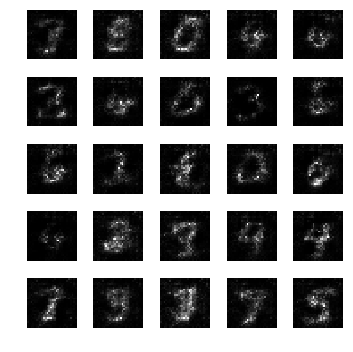

epoch: 251, time: 5.003083 | train_G_Loss: 0.434799, train_D_loss: 2.538686, train_acc: 0.832031
cv_G_Loss: 0.748881, cv_D_loss: 3.055578, cv_acc: 0.830500

epoch: 252, time: 4.975080 | train_G_Loss: 0.383888, train_D_loss: 2.572409, train_acc: 0.822266
cv_G_Loss: 0.367193, cv_D_loss: 2.781145, cv_acc: 0.800400

epoch: 253, time: 4.976535 | train_G_Loss: 0.405266, train_D_loss: 2.547044, train_acc: 0.820312
cv_G_Loss: 0.472922, cv_D_loss: 2.744232, cv_acc: 0.826300

epoch: 254, time: 4.972010 | train_G_Loss: 0.344386, train_D_loss: 2.958399, train_acc: 0.835938
cv_G_Loss: 0.216020, cv_D_loss: 2.940331, cv_acc: 0.821200

epoch: 255, time: 4.976478 | train_G_Loss: 0.437766, train_D_loss: 2.570280, train_acc: 0.859375
cv_G_Loss: 1.578028, cv_D_loss: 4.127396, cv_acc: 0.842400

epoch: 256, time: 4.981999 | train_G_Loss: 0.526071, train_D_loss: 2.652929, train_acc: 0.863281
cv_G_Loss: 0.770617, cv_D_loss: 3.056326, cv_acc: 0.815100

epoch: 257, time: 4.979045 | train_G_Loss: 0.381910, train

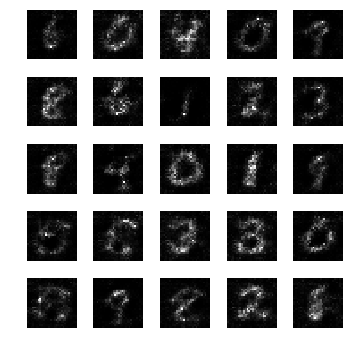

epoch: 261, time: 5.007092 | train_G_Loss: 0.345803, train_D_loss: 2.675763, train_acc: 0.830078
cv_G_Loss: 0.203051, cv_D_loss: 2.861818, cv_acc: 0.844600

epoch: 262, time: 4.970421 | train_G_Loss: 0.419382, train_D_loss: 2.739892, train_acc: 0.847656
cv_G_Loss: 1.027104, cv_D_loss: 3.440221, cv_acc: 0.806600

epoch: 263, time: 4.963276 | train_G_Loss: 0.533835, train_D_loss: 2.727505, train_acc: 0.873047
cv_G_Loss: 0.429131, cv_D_loss: 2.751801, cv_acc: 0.826100

epoch: 264, time: 4.968772 | train_G_Loss: 0.499069, train_D_loss: 2.411327, train_acc: 0.869141
cv_G_Loss: 0.631249, cv_D_loss: 2.947658, cv_acc: 0.842100

epoch: 265, time: 4.968172 | train_G_Loss: 0.393286, train_D_loss: 2.451788, train_acc: 0.851562
cv_G_Loss: 0.324664, cv_D_loss: 2.694352, cv_acc: 0.843200

epoch: 266, time: 4.967993 | train_G_Loss: 0.306487, train_D_loss: 2.862662, train_acc: 0.843750
cv_G_Loss: 0.179740, cv_D_loss: 2.913644, cv_acc: 0.840400

epoch: 267, time: 4.963686 | train_G_Loss: 0.449504, train

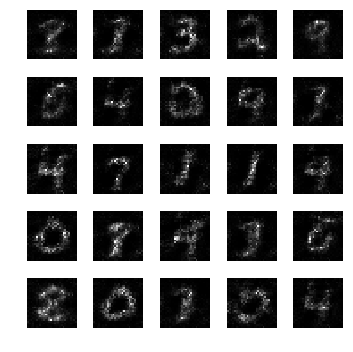

epoch: 271, time: 5.002383 | train_G_Loss: 0.355118, train_D_loss: 2.644685, train_acc: 0.779297
cv_G_Loss: 0.220877, cv_D_loss: 2.917621, cv_acc: 0.796800

epoch: 272, time: 4.966683 | train_G_Loss: 0.348532, train_D_loss: 2.652907, train_acc: 0.769531
cv_G_Loss: 0.303806, cv_D_loss: 3.020031, cv_acc: 0.728100

epoch: 273, time: 4.961102 | train_G_Loss: 0.340356, train_D_loss: 2.902087, train_acc: 0.828125
cv_G_Loss: 0.506975, cv_D_loss: 2.873291, cv_acc: 0.795600

epoch: 274, time: 4.967134 | train_G_Loss: 0.455283, train_D_loss: 2.725232, train_acc: 0.832031
cv_G_Loss: 0.395787, cv_D_loss: 2.695632, cv_acc: 0.848100

epoch: 275, time: 4.967903 | train_G_Loss: 0.267395, train_D_loss: 3.002417, train_acc: 0.791016
cv_G_Loss: 0.256524, cv_D_loss: 2.790817, cv_acc: 0.837600

epoch: 276, time: 4.961197 | train_G_Loss: 0.465122, train_D_loss: 2.489385, train_acc: 0.820312
cv_G_Loss: 0.703503, cv_D_loss: 3.058706, cv_acc: 0.820800

epoch: 277, time: 4.973021 | train_G_Loss: 0.438553, train

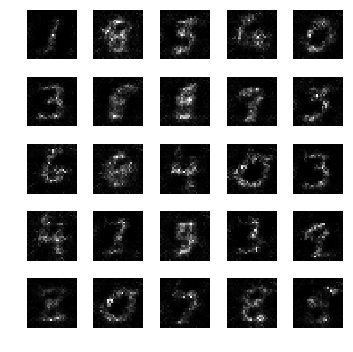

epoch: 281, time: 4.999148 | train_G_Loss: 0.419023, train_D_loss: 2.680042, train_acc: 0.814453
cv_G_Loss: 0.573608, cv_D_loss: 2.890896, cv_acc: 0.827400

epoch: 282, time: 4.970759 | train_G_Loss: 0.510354, train_D_loss: 2.337440, train_acc: 0.847656
cv_G_Loss: 2.958209, cv_D_loss: 6.980827, cv_acc: 0.593700

epoch: 283, time: 4.962449 | train_G_Loss: 0.393599, train_D_loss: 2.580401, train_acc: 0.892578
cv_G_Loss: 0.504444, cv_D_loss: 2.736575, cv_acc: 0.822800

epoch: 284, time: 4.967934 | train_G_Loss: 0.478068, train_D_loss: 2.307248, train_acc: 0.884766
cv_G_Loss: 0.500328, cv_D_loss: 2.721130, cv_acc: 0.840400

epoch: 285, time: 4.970354 | train_G_Loss: 0.430646, train_D_loss: 2.515715, train_acc: 0.867188
cv_G_Loss: 0.335029, cv_D_loss: 2.688691, cv_acc: 0.852300

epoch: 286, time: 4.980362 | train_G_Loss: 0.370070, train_D_loss: 2.781736, train_acc: 0.812500
cv_G_Loss: 0.613229, cv_D_loss: 3.001399, cv_acc: 0.799800

epoch: 287, time: 4.980871 | train_G_Loss: 0.306414, train

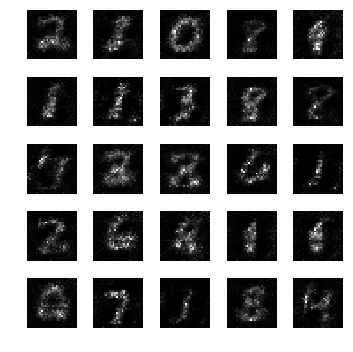

epoch: 291, time: 5.005823 | train_G_Loss: 0.359129, train_D_loss: 2.624598, train_acc: 0.845703
cv_G_Loss: 0.447645, cv_D_loss: 2.745900, cv_acc: 0.783200

epoch: 292, time: 4.985347 | train_G_Loss: 0.470785, train_D_loss: 2.522099, train_acc: 0.871094
cv_G_Loss: 0.603376, cv_D_loss: 2.746756, cv_acc: 0.854100

epoch: 293, time: 4.984982 | train_G_Loss: 0.391928, train_D_loss: 2.628680, train_acc: 0.896484
cv_G_Loss: 0.338282, cv_D_loss: 2.691684, cv_acc: 0.835300

epoch: 294, time: 4.979837 | train_G_Loss: 0.409874, train_D_loss: 2.686718, train_acc: 0.843750
cv_G_Loss: 0.312468, cv_D_loss: 3.005363, cv_acc: 0.729600

epoch: 295, time: 4.976377 | train_G_Loss: 0.401311, train_D_loss: 2.681494, train_acc: 0.792969
cv_G_Loss: 0.320018, cv_D_loss: 2.612232, cv_acc: 0.860700
Model saved

epoch: 296, time: 4.971048 | train_G_Loss: 0.392914, train_D_loss: 3.100946, train_acc: 0.794922
cv_G_Loss: 1.369492, cv_D_loss: 4.098942, cv_acc: 0.819200

epoch: 297, time: 4.950522 | train_G_Loss: 0.4

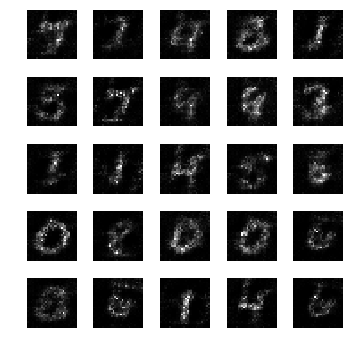

epoch: 301, time: 4.983479 | train_G_Loss: 0.337163, train_D_loss: 2.413790, train_acc: 0.875000
cv_G_Loss: 0.183336, cv_D_loss: 2.937330, cv_acc: 0.841300

epoch: 302, time: 4.949244 | train_G_Loss: 0.383892, train_D_loss: 2.618469, train_acc: 0.822266
cv_G_Loss: 1.107558, cv_D_loss: 3.443038, cv_acc: 0.847100

epoch: 303, time: 4.934670 | train_G_Loss: 0.374276, train_D_loss: 2.730919, train_acc: 0.835938
cv_G_Loss: 0.183237, cv_D_loss: 3.017288, cv_acc: 0.804100

epoch: 304, time: 4.963538 | train_G_Loss: 0.342334, train_D_loss: 2.925707, train_acc: 0.810547
cv_G_Loss: 0.331976, cv_D_loss: 2.680061, cv_acc: 0.843100

epoch: 305, time: 4.949560 | train_G_Loss: 0.340467, train_D_loss: 2.934354, train_acc: 0.843750
cv_G_Loss: 0.199470, cv_D_loss: 2.863060, cv_acc: 0.843300

epoch: 306, time: 4.942678 | train_G_Loss: 0.442867, train_D_loss: 2.513202, train_acc: 0.847656
cv_G_Loss: 0.508906, cv_D_loss: 2.838393, cv_acc: 0.842000

epoch: 307, time: 4.951599 | train_G_Loss: 0.426137, train

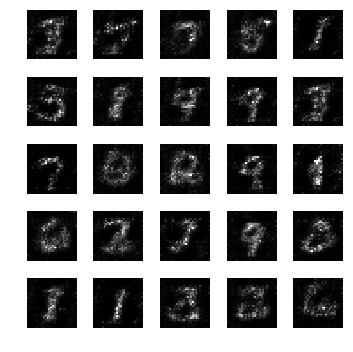

epoch: 311, time: 4.975545 | train_G_Loss: 0.419578, train_D_loss: 2.436756, train_acc: 0.812500
cv_G_Loss: 1.120432, cv_D_loss: 3.621699, cv_acc: 0.756800

epoch: 312, time: 4.948699 | train_G_Loss: 0.381297, train_D_loss: 2.906798, train_acc: 0.822266
cv_G_Loss: 0.199927, cv_D_loss: 2.848321, cv_acc: 0.855800

epoch: 313, time: 4.954938 | train_G_Loss: 0.400538, train_D_loss: 2.809742, train_acc: 0.865234
cv_G_Loss: 0.424989, cv_D_loss: 2.686462, cv_acc: 0.845600

epoch: 314, time: 4.950525 | train_G_Loss: 0.457881, train_D_loss: 2.371404, train_acc: 0.826172
cv_G_Loss: 1.963937, cv_D_loss: 4.920023, cv_acc: 0.834500

epoch: 315, time: 4.953041 | train_G_Loss: 0.379558, train_D_loss: 2.833133, train_acc: 0.857422
cv_G_Loss: 0.740918, cv_D_loss: 3.184044, cv_acc: 0.819700

epoch: 316, time: 4.963916 | train_G_Loss: 0.325125, train_D_loss: 2.435187, train_acc: 0.880859
cv_G_Loss: 0.223773, cv_D_loss: 2.804712, cv_acc: 0.842400

epoch: 317, time: 4.943681 | train_G_Loss: 0.380600, train

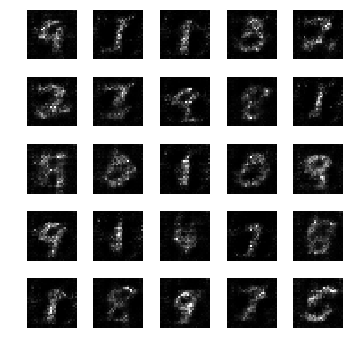

epoch: 321, time: 5.000021 | train_G_Loss: 0.384850, train_D_loss: 2.606573, train_acc: 0.833984
cv_G_Loss: 0.561175, cv_D_loss: 2.810816, cv_acc: 0.835000

epoch: 322, time: 4.975939 | train_G_Loss: 0.442930, train_D_loss: 2.723138, train_acc: 0.861328
cv_G_Loss: 0.505386, cv_D_loss: 2.658869, cv_acc: 0.851000

epoch: 323, time: 4.975516 | train_G_Loss: 0.449728, train_D_loss: 2.522071, train_acc: 0.824219
cv_G_Loss: 0.996007, cv_D_loss: 3.511911, cv_acc: 0.771000

epoch: 324, time: 4.967561 | train_G_Loss: 0.387519, train_D_loss: 2.555399, train_acc: 0.839844
cv_G_Loss: 0.288176, cv_D_loss: 2.673482, cv_acc: 0.854800

epoch: 325, time: 4.969900 | train_G_Loss: 0.315290, train_D_loss: 2.706011, train_acc: 0.820312
cv_G_Loss: 0.703762, cv_D_loss: 2.892916, cv_acc: 0.846100

epoch: 326, time: 4.969742 | train_G_Loss: 0.392955, train_D_loss: 2.792529, train_acc: 0.867188
cv_G_Loss: 0.756466, cv_D_loss: 3.119423, cv_acc: 0.812800

epoch: 327, time: 4.978221 | train_G_Loss: 0.433680, train

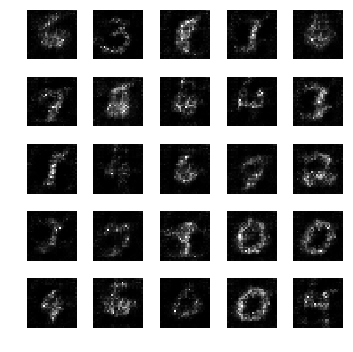

epoch: 331, time: 4.998850 | train_G_Loss: 0.328148, train_D_loss: 2.656132, train_acc: 0.871094
cv_G_Loss: 0.583304, cv_D_loss: 2.709440, cv_acc: 0.845100

epoch: 332, time: 4.984048 | train_G_Loss: 0.367001, train_D_loss: 2.605424, train_acc: 0.880859
cv_G_Loss: 0.690660, cv_D_loss: 2.889519, cv_acc: 0.862900
Model saved

epoch: 333, time: 4.968085 | train_G_Loss: 0.495625, train_D_loss: 2.684592, train_acc: 0.869141
cv_G_Loss: 0.638210, cv_D_loss: 2.938154, cv_acc: 0.845100

epoch: 334, time: 4.953530 | train_G_Loss: 0.427929, train_D_loss: 2.636369, train_acc: 0.828125
cv_G_Loss: 0.677930, cv_D_loss: 2.843059, cv_acc: 0.822900

epoch: 335, time: 4.939017 | train_G_Loss: 0.358954, train_D_loss: 2.903791, train_acc: 0.835938
cv_G_Loss: 0.249403, cv_D_loss: 2.718848, cv_acc: 0.845800

epoch: 336, time: 4.939052 | train_G_Loss: 0.493788, train_D_loss: 2.572582, train_acc: 0.818359
cv_G_Loss: 0.655751, cv_D_loss: 2.759130, cv_acc: 0.858600

epoch: 337, time: 4.945007 | train_G_Loss: 0.3

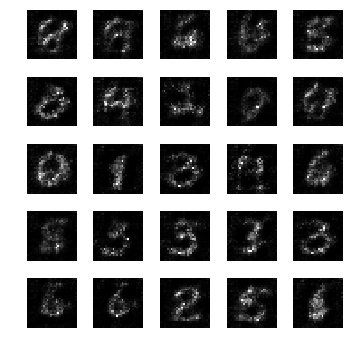

epoch: 341, time: 4.973197 | train_G_Loss: 0.380731, train_D_loss: 2.588724, train_acc: 0.855469
cv_G_Loss: 0.576197, cv_D_loss: 2.863435, cv_acc: 0.837200

epoch: 342, time: 4.951595 | train_G_Loss: 0.465782, train_D_loss: 2.440932, train_acc: 0.833984
cv_G_Loss: 1.537888, cv_D_loss: 4.186358, cv_acc: 0.838200

epoch: 343, time: 4.931996 | train_G_Loss: 0.343737, train_D_loss: 2.614911, train_acc: 0.876953
cv_G_Loss: 1.162435, cv_D_loss: 3.481613, cv_acc: 0.837800

epoch: 344, time: 4.948464 | train_G_Loss: 0.285645, train_D_loss: 2.510951, train_acc: 0.867188
cv_G_Loss: 0.568840, cv_D_loss: 2.789319, cv_acc: 0.845500

epoch: 345, time: 4.940217 | train_G_Loss: 0.430530, train_D_loss: 2.354290, train_acc: 0.822266
cv_G_Loss: 0.713406, cv_D_loss: 2.958076, cv_acc: 0.844400

epoch: 346, time: 4.933072 | train_G_Loss: 0.507555, train_D_loss: 2.647712, train_acc: 0.873047
cv_G_Loss: 0.808410, cv_D_loss: 3.092151, cv_acc: 0.839900

epoch: 347, time: 4.935278 | train_G_Loss: 0.392915, train

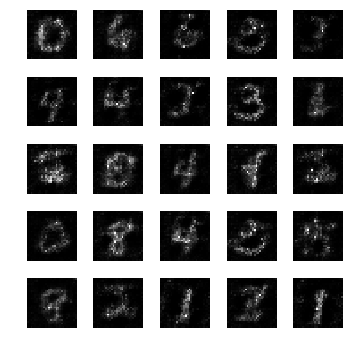

epoch: 351, time: 4.959176 | train_G_Loss: 0.479827, train_D_loss: 2.575207, train_acc: 0.851562
cv_G_Loss: 0.338562, cv_D_loss: 2.678842, cv_acc: 0.866800
Model saved

epoch: 352, time: 5.005391 | train_G_Loss: 0.309619, train_D_loss: 2.923307, train_acc: 0.873047
cv_G_Loss: 0.381342, cv_D_loss: 2.776161, cv_acc: 0.803900

epoch: 353, time: 4.976753 | train_G_Loss: 0.377325, train_D_loss: 2.450777, train_acc: 0.892578
cv_G_Loss: 0.359090, cv_D_loss: 2.690023, cv_acc: 0.837900

epoch: 354, time: 4.966453 | train_G_Loss: 0.428795, train_D_loss: 2.609505, train_acc: 0.857422
cv_G_Loss: 0.494835, cv_D_loss: 2.708780, cv_acc: 0.848600

epoch: 355, time: 4.971152 | train_G_Loss: 0.359530, train_D_loss: 2.955702, train_acc: 0.853516
cv_G_Loss: 0.430739, cv_D_loss: 2.679945, cv_acc: 0.842400

epoch: 356, time: 4.976534 | train_G_Loss: 0.386188, train_D_loss: 2.526396, train_acc: 0.880859
cv_G_Loss: 0.497890, cv_D_loss: 2.653109, cv_acc: 0.866300

epoch: 357, time: 4.969828 | train_G_Loss: 0.4

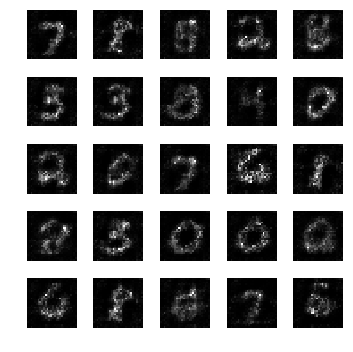

epoch: 361, time: 5.002915 | train_G_Loss: 0.427470, train_D_loss: 2.842400, train_acc: 0.878906
cv_G_Loss: 0.860861, cv_D_loss: 3.079966, cv_acc: 0.864600

epoch: 362, time: 4.971662 | train_G_Loss: 0.382877, train_D_loss: 2.459253, train_acc: 0.867188
cv_G_Loss: 0.382986, cv_D_loss: 2.561895, cv_acc: 0.864600

epoch: 363, time: 4.978550 | train_G_Loss: 0.361592, train_D_loss: 2.833463, train_acc: 0.843750
cv_G_Loss: 0.447888, cv_D_loss: 2.685213, cv_acc: 0.839500

epoch: 364, time: 4.960438 | train_G_Loss: 0.436913, train_D_loss: 2.454969, train_acc: 0.869141
cv_G_Loss: 0.363226, cv_D_loss: 2.596859, cv_acc: 0.861800

epoch: 365, time: 4.980104 | train_G_Loss: 0.439015, train_D_loss: 2.391245, train_acc: 0.902344
cv_G_Loss: 0.429247, cv_D_loss: 2.686348, cv_acc: 0.841200

epoch: 366, time: 4.976458 | train_G_Loss: 0.442612, train_D_loss: 2.336663, train_acc: 0.933594
cv_G_Loss: 0.661943, cv_D_loss: 2.745376, cv_acc: 0.859400

epoch: 367, time: 4.978241 | train_G_Loss: 0.378131, train

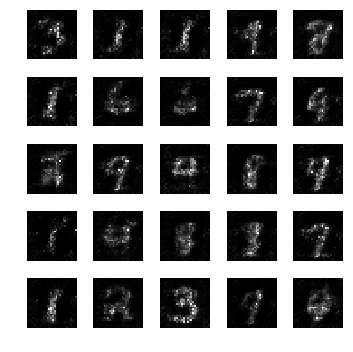

epoch: 371, time: 5.002851 | train_G_Loss: 0.511994, train_D_loss: 2.247494, train_acc: 0.884766
cv_G_Loss: 1.086188, cv_D_loss: 3.215866, cv_acc: 0.851000

epoch: 372, time: 4.967383 | train_G_Loss: 0.379943, train_D_loss: 2.638926, train_acc: 0.853516
cv_G_Loss: 0.146699, cv_D_loss: 3.092196, cv_acc: 0.814100

epoch: 373, time: 4.970610 | train_G_Loss: 0.430712, train_D_loss: 2.364942, train_acc: 0.875000
cv_G_Loss: 0.441632, cv_D_loss: 2.620961, cv_acc: 0.857600

epoch: 374, time: 4.975197 | train_G_Loss: 0.463950, train_D_loss: 2.356114, train_acc: 0.865234
cv_G_Loss: 1.921255, cv_D_loss: 4.847489, cv_acc: 0.842900

epoch: 375, time: 4.972419 | train_G_Loss: 0.580238, train_D_loss: 2.626553, train_acc: 0.880859
cv_G_Loss: 0.841163, cv_D_loss: 2.940131, cv_acc: 0.861100

epoch: 376, time: 4.985558 | train_G_Loss: 0.430627, train_D_loss: 2.481669, train_acc: 0.894531
cv_G_Loss: 0.279608, cv_D_loss: 2.630276, cv_acc: 0.860600

epoch: 377, time: 4.967066 | train_G_Loss: 0.402906, train

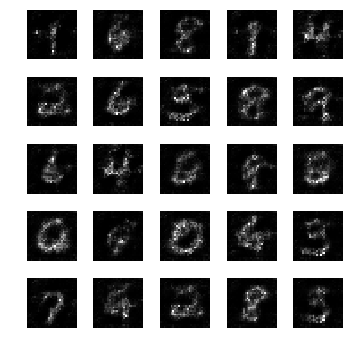

epoch: 381, time: 4.970792 | train_G_Loss: 0.447530, train_D_loss: 2.278823, train_acc: 0.841797
cv_G_Loss: 0.529737, cv_D_loss: 2.743812, cv_acc: 0.822900

epoch: 382, time: 4.990447 | train_G_Loss: 0.392620, train_D_loss: 2.662462, train_acc: 0.833984
cv_G_Loss: 1.056423, cv_D_loss: 3.248365, cv_acc: 0.866200

epoch: 383, time: 4.966873 | train_G_Loss: 0.416077, train_D_loss: 2.340980, train_acc: 0.869141
cv_G_Loss: 1.253663, cv_D_loss: 3.527427, cv_acc: 0.861700

epoch: 384, time: 4.990122 | train_G_Loss: 0.390884, train_D_loss: 2.804085, train_acc: 0.830078
cv_G_Loss: 0.712697, cv_D_loss: 2.831806, cv_acc: 0.831600

epoch: 385, time: 4.977978 | train_G_Loss: 0.376992, train_D_loss: 2.629086, train_acc: 0.847656
cv_G_Loss: 0.343462, cv_D_loss: 2.556505, cv_acc: 0.867900
Model saved

epoch: 386, time: 4.986520 | train_G_Loss: 0.565449, train_D_loss: 2.293887, train_acc: 0.871094
cv_G_Loss: 2.037965, cv_D_loss: 5.257520, cv_acc: 0.788000

epoch: 387, time: 4.972361 | train_G_Loss: 0.4

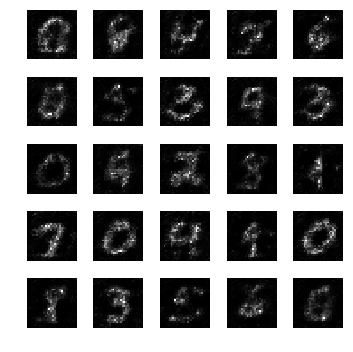

epoch: 391, time: 4.998020 | train_G_Loss: 0.400829, train_D_loss: 2.305845, train_acc: 0.894531
cv_G_Loss: 2.036073, cv_D_loss: 4.995701, cv_acc: 0.857100

epoch: 392, time: 4.960778 | train_G_Loss: 0.401156, train_D_loss: 2.253796, train_acc: 0.904297
cv_G_Loss: 1.280890, cv_D_loss: 3.685807, cv_acc: 0.826100

epoch: 393, time: 4.979822 | train_G_Loss: 0.437792, train_D_loss: 2.442642, train_acc: 0.865234
cv_G_Loss: 0.809907, cv_D_loss: 2.895945, cv_acc: 0.848800

epoch: 394, time: 4.961928 | train_G_Loss: 0.495877, train_D_loss: 2.316830, train_acc: 0.855469
cv_G_Loss: 0.856026, cv_D_loss: 2.955250, cv_acc: 0.867800

epoch: 395, time: 4.962986 | train_G_Loss: 0.360066, train_D_loss: 2.797857, train_acc: 0.869141
cv_G_Loss: 1.446622, cv_D_loss: 4.022646, cv_acc: 0.847600

epoch: 396, time: 4.970638 | train_G_Loss: 0.362782, train_D_loss: 2.476501, train_acc: 0.849609
cv_G_Loss: 1.361631, cv_D_loss: 3.754842, cv_acc: 0.843900

epoch: 397, time: 4.966453 | train_G_Loss: 0.387113, train

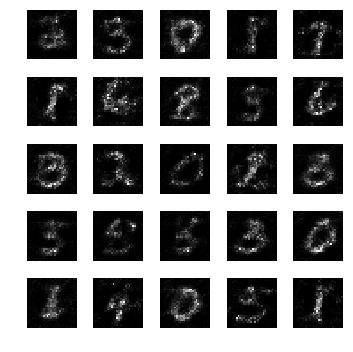

epoch: 401, time: 4.973571 | train_G_Loss: 0.450479, train_D_loss: 2.315489, train_acc: 0.853516
cv_G_Loss: 0.389843, cv_D_loss: 2.620987, cv_acc: 0.858700

epoch: 402, time: 4.957370 | train_G_Loss: 0.467661, train_D_loss: 2.339018, train_acc: 0.851562
cv_G_Loss: 1.019801, cv_D_loss: 3.116122, cv_acc: 0.868400

epoch: 403, time: 4.947320 | train_G_Loss: 0.379945, train_D_loss: 2.510057, train_acc: 0.835938
cv_G_Loss: 0.927796, cv_D_loss: 3.072577, cv_acc: 0.848200

epoch: 404, time: 4.955155 | train_G_Loss: 0.359769, train_D_loss: 2.926375, train_acc: 0.820312
cv_G_Loss: 0.368423, cv_D_loss: 2.558200, cv_acc: 0.866900

epoch: 405, time: 4.943538 | train_G_Loss: 0.424772, train_D_loss: 2.743161, train_acc: 0.847656
cv_G_Loss: 0.496920, cv_D_loss: 2.602528, cv_acc: 0.874200
Model saved

epoch: 406, time: 4.986392 | train_G_Loss: 0.422659, train_D_loss: 2.424237, train_acc: 0.876953
cv_G_Loss: 0.702320, cv_D_loss: 3.090386, cv_acc: 0.787000

epoch: 407, time: 4.954139 | train_G_Loss: 0.4

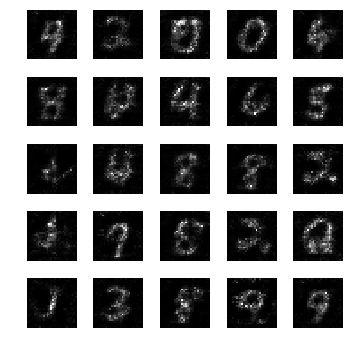

epoch: 411, time: 4.982804 | train_G_Loss: 0.391054, train_D_loss: 2.503064, train_acc: 0.861328
cv_G_Loss: 0.608792, cv_D_loss: 2.658322, cv_acc: 0.871500

epoch: 412, time: 4.936230 | train_G_Loss: 0.432469, train_D_loss: 2.689058, train_acc: 0.822266
cv_G_Loss: 1.203620, cv_D_loss: 3.477924, cv_acc: 0.865800

epoch: 413, time: 4.955741 | train_G_Loss: 0.449120, train_D_loss: 2.727126, train_acc: 0.859375
cv_G_Loss: 0.505146, cv_D_loss: 2.627621, cv_acc: 0.858100

epoch: 414, time: 4.936919 | train_G_Loss: 0.420882, train_D_loss: 2.347266, train_acc: 0.857422
cv_G_Loss: 0.510367, cv_D_loss: 2.696424, cv_acc: 0.850200

epoch: 415, time: 4.949820 | train_G_Loss: 0.409657, train_D_loss: 2.524890, train_acc: 0.875000
cv_G_Loss: 0.162395, cv_D_loss: 2.910252, cv_acc: 0.853200

epoch: 416, time: 4.941517 | train_G_Loss: 0.415108, train_D_loss: 2.270119, train_acc: 0.894531
cv_G_Loss: 0.438969, cv_D_loss: 2.624497, cv_acc: 0.853200

epoch: 417, time: 4.940680 | train_G_Loss: 0.330691, train

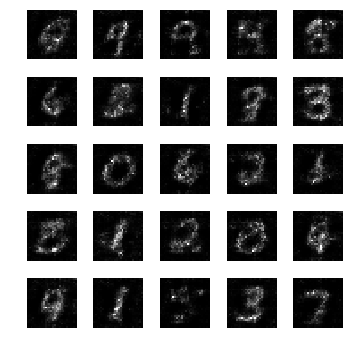

epoch: 421, time: 4.964185 | train_G_Loss: 0.510989, train_D_loss: 2.282969, train_acc: 0.884766
cv_G_Loss: 0.534295, cv_D_loss: 2.833902, cv_acc: 0.838400

epoch: 422, time: 4.941795 | train_G_Loss: 0.381308, train_D_loss: 2.360344, train_acc: 0.869141
cv_G_Loss: 0.480339, cv_D_loss: 2.706567, cv_acc: 0.847600

epoch: 423, time: 4.952326 | train_G_Loss: 0.475374, train_D_loss: 2.549036, train_acc: 0.865234
cv_G_Loss: 1.129987, cv_D_loss: 3.590636, cv_acc: 0.830700

epoch: 424, time: 4.950005 | train_G_Loss: 0.384222, train_D_loss: 2.374207, train_acc: 0.892578
cv_G_Loss: 0.355702, cv_D_loss: 2.556360, cv_acc: 0.861500

epoch: 425, time: 4.951116 | train_G_Loss: 0.411506, train_D_loss: 2.341696, train_acc: 0.867188
cv_G_Loss: 0.226168, cv_D_loss: 2.657818, cv_acc: 0.870500

epoch: 426, time: 4.964521 | train_G_Loss: 0.414974, train_D_loss: 2.459302, train_acc: 0.875000
cv_G_Loss: 0.361284, cv_D_loss: 2.600288, cv_acc: 0.857600

epoch: 427, time: 4.948184 | train_G_Loss: 0.437630, train

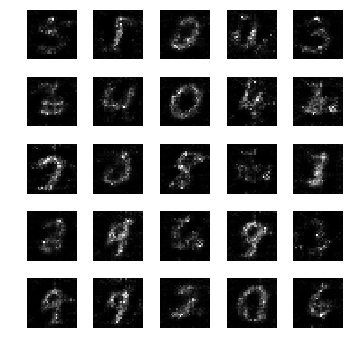

epoch: 431, time: 4.977620 | train_G_Loss: 0.423402, train_D_loss: 2.342686, train_acc: 0.857422
cv_G_Loss: 0.458733, cv_D_loss: 2.579851, cv_acc: 0.850600

epoch: 432, time: 4.941502 | train_G_Loss: 0.314447, train_D_loss: 2.548550, train_acc: 0.865234
cv_G_Loss: 0.153083, cv_D_loss: 2.968687, cv_acc: 0.851900

epoch: 433, time: 4.939245 | train_G_Loss: 0.398532, train_D_loss: 2.327463, train_acc: 0.888672
cv_G_Loss: 0.706189, cv_D_loss: 2.841292, cv_acc: 0.878600

epoch: 434, time: 4.936975 | train_G_Loss: 0.434972, train_D_loss: 2.321039, train_acc: 0.900391
cv_G_Loss: 1.264203, cv_D_loss: 3.817356, cv_acc: 0.809600

epoch: 435, time: 4.947187 | train_G_Loss: 0.509977, train_D_loss: 2.586502, train_acc: 0.875000
cv_G_Loss: 2.424899, cv_D_loss: 5.521539, cv_acc: 0.866200

epoch: 436, time: 4.941874 | train_G_Loss: 0.387424, train_D_loss: 2.475041, train_acc: 0.876953
cv_G_Loss: 0.423173, cv_D_loss: 2.667998, cv_acc: 0.855900

epoch: 437, time: 4.947288 | train_G_Loss: 0.358622, train

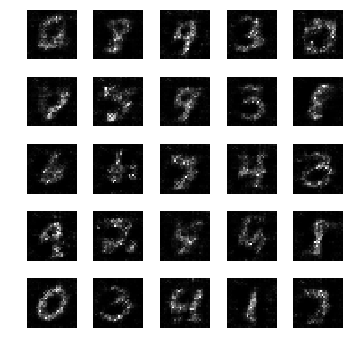

epoch: 441, time: 4.982382 | train_G_Loss: 0.369017, train_D_loss: 2.524598, train_acc: 0.898438
cv_G_Loss: 0.247992, cv_D_loss: 2.821843, cv_acc: 0.829200

epoch: 442, time: 4.950424 | train_G_Loss: 0.412372, train_D_loss: 2.443820, train_acc: 0.902344
cv_G_Loss: 0.349852, cv_D_loss: 2.696416, cv_acc: 0.838100

epoch: 443, time: 4.955151 | train_G_Loss: 0.329429, train_D_loss: 2.430708, train_acc: 0.908203
cv_G_Loss: 0.512986, cv_D_loss: 2.593618, cv_acc: 0.860400

epoch: 444, time: 4.942036 | train_G_Loss: 0.307830, train_D_loss: 2.491169, train_acc: 0.861328
cv_G_Loss: 0.129077, cv_D_loss: 3.066735, cv_acc: 0.845700

epoch: 445, time: 4.935223 | train_G_Loss: 0.348283, train_D_loss: 2.737328, train_acc: 0.861328
cv_G_Loss: 0.438264, cv_D_loss: 2.861650, cv_acc: 0.824600

epoch: 446, time: 4.950394 | train_G_Loss: 0.466756, train_D_loss: 2.475969, train_acc: 0.871094
cv_G_Loss: 0.738333, cv_D_loss: 2.956784, cv_acc: 0.875400

epoch: 447, time: 4.938373 | train_G_Loss: 0.470324, train

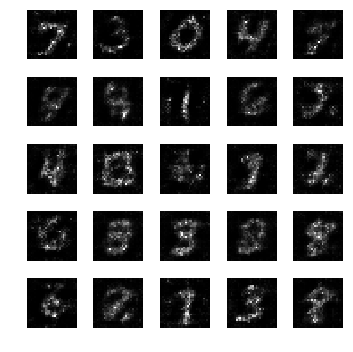

epoch: 451, time: 4.981855 | train_G_Loss: 0.447957, train_D_loss: 2.344002, train_acc: 0.859375
cv_G_Loss: 0.087060, cv_D_loss: 3.359009, cv_acc: 0.843600

epoch: 452, time: 4.948042 | train_G_Loss: 0.326102, train_D_loss: 2.427008, train_acc: 0.880859
cv_G_Loss: 0.298363, cv_D_loss: 2.555322, cv_acc: 0.869500

epoch: 453, time: 4.936115 | train_G_Loss: 0.375996, train_D_loss: 2.426250, train_acc: 0.859375
cv_G_Loss: 0.190467, cv_D_loss: 2.866160, cv_acc: 0.853700

epoch: 454, time: 4.941880 | train_G_Loss: 0.401847, train_D_loss: 2.675025, train_acc: 0.871094
cv_G_Loss: 1.516967, cv_D_loss: 3.991118, cv_acc: 0.863100

epoch: 455, time: 4.943941 | train_G_Loss: 0.379080, train_D_loss: 2.505485, train_acc: 0.839844
cv_G_Loss: 0.408042, cv_D_loss: 2.545535, cv_acc: 0.869900

epoch: 456, time: 5.009520 | train_G_Loss: 0.361696, train_D_loss: 2.264076, train_acc: 0.845703
cv_G_Loss: 0.268296, cv_D_loss: 2.867662, cv_acc: 0.786200

epoch: 457, time: 4.945154 | train_G_Loss: 0.307083, train

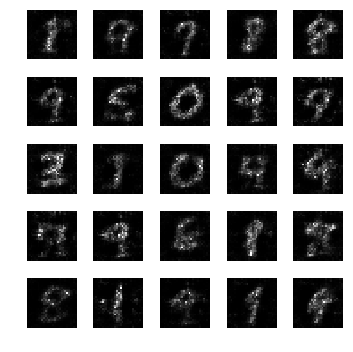

epoch: 461, time: 4.969750 | train_G_Loss: 0.410205, train_D_loss: 2.658539, train_acc: 0.841797
cv_G_Loss: 0.486966, cv_D_loss: 2.700425, cv_acc: 0.868200

epoch: 462, time: 4.945136 | train_G_Loss: 0.378038, train_D_loss: 2.506658, train_acc: 0.857422
cv_G_Loss: 0.355415, cv_D_loss: 2.528384, cv_acc: 0.880800

epoch: 463, time: 4.932615 | train_G_Loss: 0.348288, train_D_loss: 2.738927, train_acc: 0.837891
cv_G_Loss: 0.835480, cv_D_loss: 2.835856, cv_acc: 0.854200

epoch: 464, time: 4.947030 | train_G_Loss: 0.475734, train_D_loss: 2.782928, train_acc: 0.820312
cv_G_Loss: 1.039342, cv_D_loss: 3.313805, cv_acc: 0.845600

epoch: 465, time: 4.944513 | train_G_Loss: 0.370249, train_D_loss: 2.706813, train_acc: 0.861328
cv_G_Loss: 0.306093, cv_D_loss: 2.538114, cv_acc: 0.867800

epoch: 466, time: 4.945671 | train_G_Loss: 0.433213, train_D_loss: 2.637318, train_acc: 0.884766
cv_G_Loss: 0.155387, cv_D_loss: 2.894770, cv_acc: 0.867800

epoch: 467, time: 4.949490 | train_G_Loss: 0.496708, train

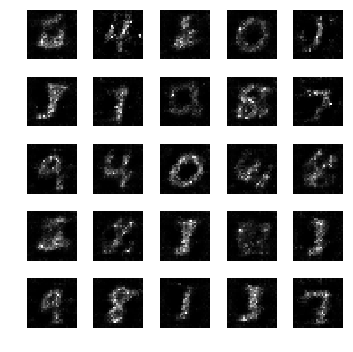

epoch: 471, time: 4.962469 | train_G_Loss: 0.364222, train_D_loss: 2.305127, train_acc: 0.888672
cv_G_Loss: 0.424418, cv_D_loss: 2.483782, cv_acc: 0.880400

epoch: 472, time: 4.957566 | train_G_Loss: 0.429797, train_D_loss: 2.437263, train_acc: 0.857422
cv_G_Loss: 0.715821, cv_D_loss: 2.875815, cv_acc: 0.841700

epoch: 473, time: 4.944365 | train_G_Loss: 0.448014, train_D_loss: 2.612217, train_acc: 0.884766
cv_G_Loss: 0.352376, cv_D_loss: 2.541826, cv_acc: 0.866500

epoch: 474, time: 4.965451 | train_G_Loss: 0.413772, train_D_loss: 2.655607, train_acc: 0.892578
cv_G_Loss: 0.407231, cv_D_loss: 2.654342, cv_acc: 0.845900

epoch: 475, time: 4.944384 | train_G_Loss: 0.517447, train_D_loss: 2.628239, train_acc: 0.900391
cv_G_Loss: 0.576990, cv_D_loss: 2.738221, cv_acc: 0.870600

epoch: 476, time: 4.944941 | train_G_Loss: 0.645061, train_D_loss: 2.554119, train_acc: 0.884766
cv_G_Loss: 0.288900, cv_D_loss: 2.601992, cv_acc: 0.880400

epoch: 477, time: 4.938984 | train_G_Loss: 0.369619, train

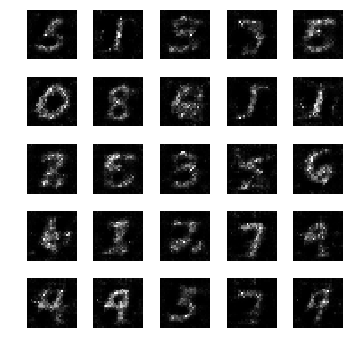

epoch: 481, time: 4.970183 | train_G_Loss: 0.359173, train_D_loss: 2.612010, train_acc: 0.835938
cv_G_Loss: 0.533314, cv_D_loss: 2.552972, cv_acc: 0.866500

epoch: 482, time: 4.955053 | train_G_Loss: 0.453493, train_D_loss: 2.712607, train_acc: 0.859375
cv_G_Loss: 0.396189, cv_D_loss: 2.657385, cv_acc: 0.837900

epoch: 483, time: 4.943368 | train_G_Loss: 0.351187, train_D_loss: 2.495523, train_acc: 0.896484
cv_G_Loss: 0.295716, cv_D_loss: 2.567142, cv_acc: 0.884000
Model saved

epoch: 484, time: 4.968392 | train_G_Loss: 0.394614, train_D_loss: 2.607593, train_acc: 0.875000
cv_G_Loss: 0.645084, cv_D_loss: 2.719256, cv_acc: 0.861600

epoch: 485, time: 4.943419 | train_G_Loss: 0.311979, train_D_loss: 2.461053, train_acc: 0.878906
cv_G_Loss: 0.473144, cv_D_loss: 2.976440, cv_acc: 0.802700

epoch: 486, time: 4.938990 | train_G_Loss: 0.451087, train_D_loss: 2.411293, train_acc: 0.917969
cv_G_Loss: 1.594929, cv_D_loss: 4.350794, cv_acc: 0.734400

epoch: 487, time: 4.946645 | train_G_Loss: 0.4

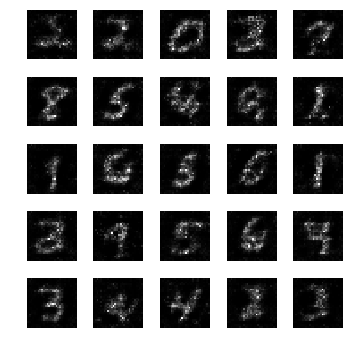

epoch: 491, time: 4.963720 | train_G_Loss: 0.414892, train_D_loss: 2.470065, train_acc: 0.878906
cv_G_Loss: 1.098735, cv_D_loss: 3.459243, cv_acc: 0.815400

epoch: 492, time: 4.941805 | train_G_Loss: 0.415790, train_D_loss: 2.416967, train_acc: 0.888672
cv_G_Loss: 0.281497, cv_D_loss: 2.615409, cv_acc: 0.878500

epoch: 493, time: 4.950121 | train_G_Loss: 0.491638, train_D_loss: 2.396396, train_acc: 0.892578
cv_G_Loss: 0.518092, cv_D_loss: 2.693249, cv_acc: 0.867200

epoch: 494, time: 4.957614 | train_G_Loss: 0.416323, train_D_loss: 2.491827, train_acc: 0.859375
cv_G_Loss: 0.604812, cv_D_loss: 2.711825, cv_acc: 0.886000
Model saved

epoch: 495, time: 5.013428 | train_G_Loss: 0.351372, train_D_loss: 2.599541, train_acc: 0.855469
cv_G_Loss: 0.445471, cv_D_loss: 2.750651, cv_acc: 0.839400

epoch: 496, time: 4.992088 | train_G_Loss: 0.377053, train_D_loss: 2.548513, train_acc: 0.865234
cv_G_Loss: 0.262274, cv_D_loss: 2.680402, cv_acc: 0.845400

epoch: 497, time: 4.977127 | train_G_Loss: 0.3

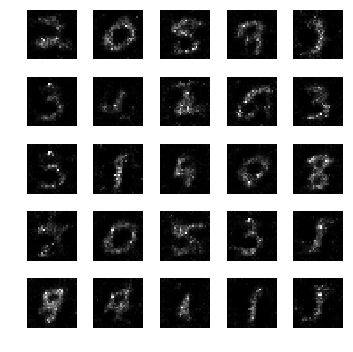

epoch: 501, time: 4.995712 | train_G_Loss: 0.288885, train_D_loss: 2.684773, train_acc: 0.898438
cv_G_Loss: 1.049469, cv_D_loss: 3.282141, cv_acc: 0.859800

epoch: 502, time: 4.983820 | train_G_Loss: 0.360214, train_D_loss: 2.282257, train_acc: 0.904297
cv_G_Loss: 0.905752, cv_D_loss: 2.951291, cv_acc: 0.867900

epoch: 503, time: 4.971043 | train_G_Loss: 0.341871, train_D_loss: 2.464847, train_acc: 0.884766
cv_G_Loss: 0.305975, cv_D_loss: 2.455117, cv_acc: 0.888900
Model saved

epoch: 504, time: 4.968387 | train_G_Loss: 0.389646, train_D_loss: 2.456024, train_acc: 0.871094
cv_G_Loss: 0.197815, cv_D_loss: 2.767344, cv_acc: 0.861900

epoch: 505, time: 4.949083 | train_G_Loss: 0.456477, train_D_loss: 2.364278, train_acc: 0.914062
cv_G_Loss: 1.480349, cv_D_loss: 4.068551, cv_acc: 0.813200

epoch: 506, time: 4.949427 | train_G_Loss: 0.490196, train_D_loss: 2.356928, train_acc: 0.898438
cv_G_Loss: 3.744397, cv_D_loss: 8.271758, cv_acc: 0.806700

epoch: 507, time: 4.962077 | train_G_Loss: 0.3

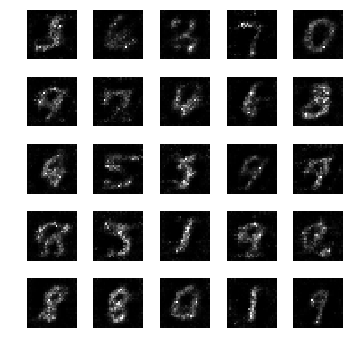

epoch: 511, time: 4.984261 | train_G_Loss: 0.290261, train_D_loss: 2.511097, train_acc: 0.888672
cv_G_Loss: 0.223174, cv_D_loss: 2.662853, cv_acc: 0.875200

epoch: 512, time: 4.954650 | train_G_Loss: 0.326832, train_D_loss: 2.529449, train_acc: 0.900391
cv_G_Loss: 1.264386, cv_D_loss: 3.387319, cv_acc: 0.871400

epoch: 513, time: 4.957381 | train_G_Loss: 0.433542, train_D_loss: 2.385640, train_acc: 0.880859
cv_G_Loss: 1.311234, cv_D_loss: 3.533534, cv_acc: 0.887900

epoch: 514, time: 4.954422 | train_G_Loss: 0.427272, train_D_loss: 2.280692, train_acc: 0.859375
cv_G_Loss: 0.639219, cv_D_loss: 2.618385, cv_acc: 0.876600

epoch: 515, time: 4.965535 | train_G_Loss: 0.537121, train_D_loss: 2.627819, train_acc: 0.863281
cv_G_Loss: 1.443034, cv_D_loss: 3.758426, cv_acc: 0.878500

epoch: 516, time: 4.953544 | train_G_Loss: 0.303261, train_D_loss: 2.414831, train_acc: 0.878906
cv_G_Loss: 1.022414, cv_D_loss: 3.159728, cv_acc: 0.882800

epoch: 517, time: 4.969740 | train_G_Loss: 0.489334, train

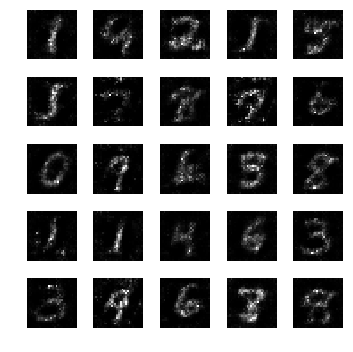

epoch: 521, time: 4.992172 | train_G_Loss: 0.272385, train_D_loss: 2.967450, train_acc: 0.859375
cv_G_Loss: 0.167666, cv_D_loss: 2.765860, cv_acc: 0.891200
Model saved

epoch: 522, time: 4.984578 | train_G_Loss: 0.338018, train_D_loss: 2.355823, train_acc: 0.847656
cv_G_Loss: 0.409688, cv_D_loss: 2.545134, cv_acc: 0.882200

epoch: 523, time: 4.959627 | train_G_Loss: 0.378301, train_D_loss: 2.542787, train_acc: 0.894531
cv_G_Loss: 0.418675, cv_D_loss: 2.631296, cv_acc: 0.859900

epoch: 524, time: 4.951625 | train_G_Loss: 0.366853, train_D_loss: 2.901098, train_acc: 0.871094
cv_G_Loss: 1.126518, cv_D_loss: 3.314637, cv_acc: 0.861400

epoch: 525, time: 4.968668 | train_G_Loss: 0.376430, train_D_loss: 2.356440, train_acc: 0.861328
cv_G_Loss: 0.565421, cv_D_loss: 2.743361, cv_acc: 0.860900

epoch: 526, time: 4.957696 | train_G_Loss: 0.402230, train_D_loss: 2.237558, train_acc: 0.863281
cv_G_Loss: 0.692384, cv_D_loss: 2.534976, cv_acc: 0.893900
Model saved

epoch: 527, time: 4.994541 | train

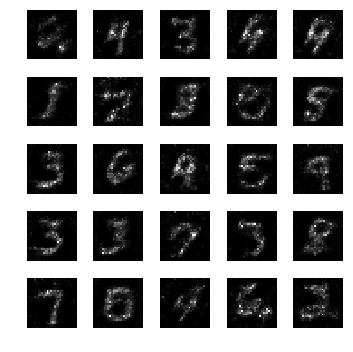

epoch: 531, time: 4.990763 | train_G_Loss: 0.416628, train_D_loss: 2.347238, train_acc: 0.865234
cv_G_Loss: 0.670538, cv_D_loss: 2.777462, cv_acc: 0.882700

epoch: 532, time: 4.977688 | train_G_Loss: 0.341731, train_D_loss: 2.510360, train_acc: 0.900391
cv_G_Loss: 2.483444, cv_D_loss: 5.701530, cv_acc: 0.859000

epoch: 533, time: 4.961013 | train_G_Loss: 0.416643, train_D_loss: 2.118962, train_acc: 0.849609
cv_G_Loss: 0.370334, cv_D_loss: 2.604788, cv_acc: 0.867900

epoch: 534, time: 4.967132 | train_G_Loss: 0.385273, train_D_loss: 2.613617, train_acc: 0.871094
cv_G_Loss: 0.281020, cv_D_loss: 2.838860, cv_acc: 0.797500

epoch: 535, time: 4.973428 | train_G_Loss: 0.362724, train_D_loss: 2.626705, train_acc: 0.892578
cv_G_Loss: 1.353506, cv_D_loss: 3.646996, cv_acc: 0.879100

epoch: 536, time: 4.977007 | train_G_Loss: 0.549763, train_D_loss: 2.241069, train_acc: 0.886719
cv_G_Loss: 0.534950, cv_D_loss: 2.562656, cv_acc: 0.880700

epoch: 537, time: 4.978072 | train_G_Loss: 0.430094, train

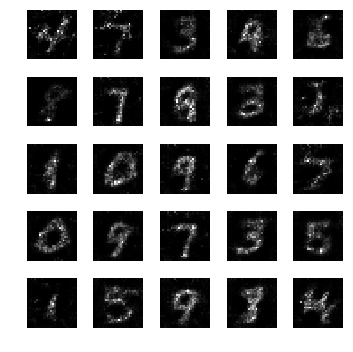

epoch: 541, time: 5.039904 | train_G_Loss: 0.315269, train_D_loss: 2.559614, train_acc: 0.908203
cv_G_Loss: 0.129044, cv_D_loss: 2.956487, cv_acc: 0.884100

epoch: 542, time: 4.970817 | train_G_Loss: 0.514054, train_D_loss: 2.167353, train_acc: 0.919922
cv_G_Loss: 0.728840, cv_D_loss: 2.815936, cv_acc: 0.878900

epoch: 543, time: 4.992006 | train_G_Loss: 0.307234, train_D_loss: 2.511109, train_acc: 0.908203
cv_G_Loss: 0.626856, cv_D_loss: 2.653225, cv_acc: 0.860100

epoch: 544, time: 4.969044 | train_G_Loss: 0.480229, train_D_loss: 2.265835, train_acc: 0.912109
cv_G_Loss: 0.397872, cv_D_loss: 2.581874, cv_acc: 0.882600

epoch: 545, time: 4.975244 | train_G_Loss: 0.454513, train_D_loss: 2.263915, train_acc: 0.912109
cv_G_Loss: 0.714104, cv_D_loss: 2.606740, cv_acc: 0.881300

epoch: 546, time: 4.978963 | train_G_Loss: 0.386366, train_D_loss: 2.261023, train_acc: 0.896484
cv_G_Loss: 0.333833, cv_D_loss: 2.515712, cv_acc: 0.883700

epoch: 547, time: 4.971913 | train_G_Loss: 0.431995, train

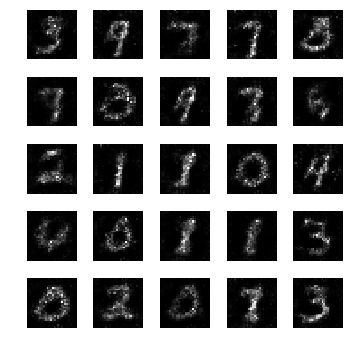

epoch: 551, time: 4.986969 | train_G_Loss: 0.443519, train_D_loss: 2.428662, train_acc: 0.927734
cv_G_Loss: 1.013347, cv_D_loss: 3.179615, cv_acc: 0.854600

epoch: 552, time: 4.978787 | train_G_Loss: 0.507191, train_D_loss: 2.075063, train_acc: 0.937500
cv_G_Loss: 1.726103, cv_D_loss: 4.240187, cv_acc: 0.877600

epoch: 553, time: 5.024487 | train_G_Loss: 0.422675, train_D_loss: 2.038557, train_acc: 0.945312
cv_G_Loss: 0.797924, cv_D_loss: 2.796675, cv_acc: 0.852200

epoch: 554, time: 4.975476 | train_G_Loss: 0.394045, train_D_loss: 2.563042, train_acc: 0.958984
cv_G_Loss: 1.474030, cv_D_loss: 3.757097, cv_acc: 0.884000

epoch: 555, time: 4.967627 | train_G_Loss: 0.328465, train_D_loss: 2.341976, train_acc: 0.939453
cv_G_Loss: 0.190534, cv_D_loss: 2.657578, cv_acc: 0.894900
Model saved

epoch: 556, time: 5.005047 | train_G_Loss: 0.337168, train_D_loss: 2.457919, train_acc: 0.927734
cv_G_Loss: 0.979028, cv_D_loss: 3.152821, cv_acc: 0.891900

epoch: 557, time: 4.972886 | train_G_Loss: 0.4

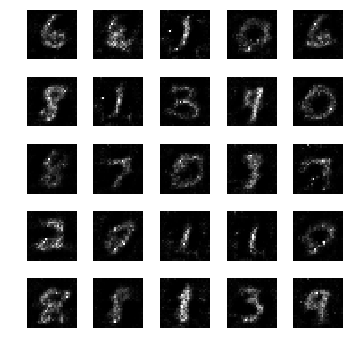

epoch: 561, time: 4.989251 | train_G_Loss: 0.304401, train_D_loss: 2.756477, train_acc: 0.923828
cv_G_Loss: 1.651172, cv_D_loss: 4.019800, cv_acc: 0.874000

epoch: 562, time: 4.959695 | train_G_Loss: 0.416455, train_D_loss: 2.177141, train_acc: 0.912109
cv_G_Loss: 0.307053, cv_D_loss: 2.727897, cv_acc: 0.866200

epoch: 563, time: 4.977232 | train_G_Loss: 0.461561, train_D_loss: 2.319793, train_acc: 0.871094
cv_G_Loss: 1.605942, cv_D_loss: 4.542264, cv_acc: 0.764900

epoch: 564, time: 4.962310 | train_G_Loss: 0.274012, train_D_loss: 2.395568, train_acc: 0.888672
cv_G_Loss: 0.309154, cv_D_loss: 2.578829, cv_acc: 0.875200

epoch: 565, time: 4.964968 | train_G_Loss: 0.380672, train_D_loss: 2.529231, train_acc: 0.896484
cv_G_Loss: 0.358749, cv_D_loss: 2.686387, cv_acc: 0.802100

epoch: 566, time: 4.958652 | train_G_Loss: 0.470001, train_D_loss: 2.540321, train_acc: 0.894531
cv_G_Loss: 0.748442, cv_D_loss: 2.669994, cv_acc: 0.881300

epoch: 567, time: 4.964036 | train_G_Loss: 0.328316, train

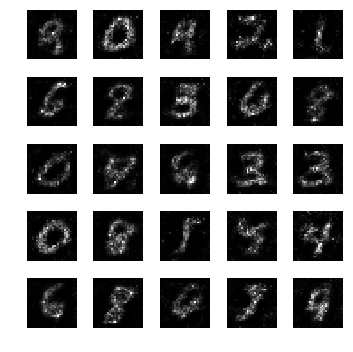

epoch: 571, time: 4.992584 | train_G_Loss: 0.478785, train_D_loss: 2.416267, train_acc: 0.878906
cv_G_Loss: 0.639307, cv_D_loss: 2.543625, cv_acc: 0.890700

epoch: 572, time: 4.960983 | train_G_Loss: 0.366765, train_D_loss: 2.426072, train_acc: 0.880859
cv_G_Loss: 0.386130, cv_D_loss: 3.098127, cv_acc: 0.737800

epoch: 573, time: 4.968703 | train_G_Loss: 0.373896, train_D_loss: 2.252650, train_acc: 0.906250
cv_G_Loss: 0.613894, cv_D_loss: 2.748201, cv_acc: 0.832300

epoch: 574, time: 4.962134 | train_G_Loss: 0.447558, train_D_loss: 2.001159, train_acc: 0.929688
cv_G_Loss: 0.815517, cv_D_loss: 2.924109, cv_acc: 0.885600

epoch: 575, time: 4.967537 | train_G_Loss: 0.329520, train_D_loss: 2.287777, train_acc: 0.916016
cv_G_Loss: 0.580753, cv_D_loss: 2.583491, cv_acc: 0.875000

epoch: 576, time: 4.974094 | train_G_Loss: 0.408793, train_D_loss: 2.464238, train_acc: 0.929688
cv_G_Loss: 0.630981, cv_D_loss: 2.555799, cv_acc: 0.892800

epoch: 577, time: 4.966948 | train_G_Loss: 0.447673, train

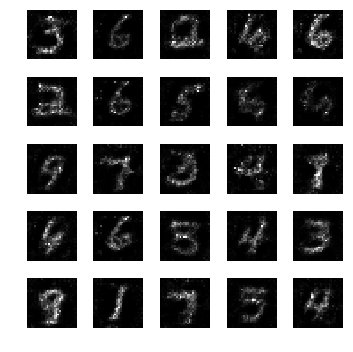

epoch: 581, time: 4.976523 | train_G_Loss: 0.364414, train_D_loss: 2.664043, train_acc: 0.910156
cv_G_Loss: 0.735556, cv_D_loss: 2.653853, cv_acc: 0.897500
Model saved

epoch: 582, time: 4.981854 | train_G_Loss: 0.352487, train_D_loss: 2.583362, train_acc: 0.888672
cv_G_Loss: 0.315467, cv_D_loss: 2.498277, cv_acc: 0.892900

epoch: 583, time: 4.975084 | train_G_Loss: 0.494774, train_D_loss: 2.424185, train_acc: 0.884766
cv_G_Loss: 1.448601, cv_D_loss: 3.751788, cv_acc: 0.886500

epoch: 584, time: 4.966903 | train_G_Loss: 0.481061, train_D_loss: 2.676218, train_acc: 0.832031
cv_G_Loss: 1.981843, cv_D_loss: 5.036694, cv_acc: 0.788100

epoch: 585, time: 4.962579 | train_G_Loss: 0.411625, train_D_loss: 2.552562, train_acc: 0.863281
cv_G_Loss: 0.332502, cv_D_loss: 2.487420, cv_acc: 0.890300

epoch: 586, time: 4.985981 | train_G_Loss: 0.327802, train_D_loss: 2.452004, train_acc: 0.900391
cv_G_Loss: 1.012022, cv_D_loss: 3.045988, cv_acc: 0.880600

epoch: 587, time: 4.965476 | train_G_Loss: 0.3

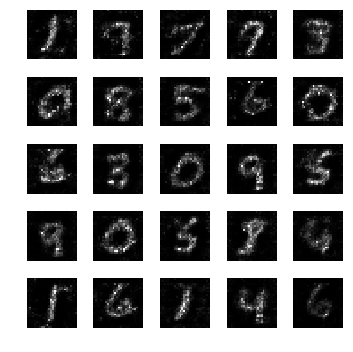

epoch: 591, time: 4.991580 | train_G_Loss: 0.438185, train_D_loss: 2.519146, train_acc: 0.886719
cv_G_Loss: 0.847122, cv_D_loss: 3.295643, cv_acc: 0.796500

epoch: 592, time: 4.973724 | train_G_Loss: 0.438600, train_D_loss: 2.322049, train_acc: 0.884766
cv_G_Loss: 0.597409, cv_D_loss: 3.195526, cv_acc: 0.853500

epoch: 593, time: 4.971455 | train_G_Loss: 0.537652, train_D_loss: 2.240841, train_acc: 0.876953
cv_G_Loss: 0.838491, cv_D_loss: 3.100307, cv_acc: 0.835000

epoch: 594, time: 4.986212 | train_G_Loss: 0.474427, train_D_loss: 2.668902, train_acc: 0.851562
cv_G_Loss: 0.533872, cv_D_loss: 2.636074, cv_acc: 0.855400

epoch: 595, time: 4.966400 | train_G_Loss: 0.404105, train_D_loss: 2.248930, train_acc: 0.882812
cv_G_Loss: 1.419512, cv_D_loss: 3.760366, cv_acc: 0.851500

epoch: 596, time: 4.973471 | train_G_Loss: 0.391740, train_D_loss: 2.739810, train_acc: 0.916016
cv_G_Loss: 0.623208, cv_D_loss: 2.667426, cv_acc: 0.881400

epoch: 597, time: 4.951584 | train_G_Loss: 0.536927, train

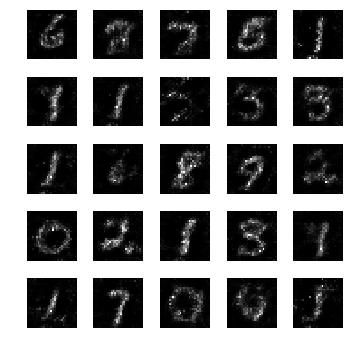

epoch: 601, time: 5.001446 | train_G_Loss: 0.481205, train_D_loss: 2.444343, train_acc: 0.894531
cv_G_Loss: 0.552824, cv_D_loss: 2.574733, cv_acc: 0.889100

epoch: 602, time: 4.976740 | train_G_Loss: 0.451800, train_D_loss: 2.231425, train_acc: 0.921875
cv_G_Loss: 1.734736, cv_D_loss: 4.161685, cv_acc: 0.880800

epoch: 603, time: 4.971984 | train_G_Loss: 0.460827, train_D_loss: 2.236133, train_acc: 0.925781
cv_G_Loss: 1.950271, cv_D_loss: 4.739946, cv_acc: 0.868700

epoch: 604, time: 4.975735 | train_G_Loss: 0.408345, train_D_loss: 2.341160, train_acc: 0.925781
cv_G_Loss: 0.501813, cv_D_loss: 2.575756, cv_acc: 0.887200

epoch: 605, time: 4.965559 | train_G_Loss: 0.437216, train_D_loss: 2.225567, train_acc: 0.917969
cv_G_Loss: 0.811011, cv_D_loss: 2.770062, cv_acc: 0.887400

epoch: 606, time: 4.974578 | train_G_Loss: 0.388066, train_D_loss: 2.374282, train_acc: 0.898438
cv_G_Loss: 0.339749, cv_D_loss: 2.492969, cv_acc: 0.886600

epoch: 607, time: 4.974453 | train_G_Loss: 0.329080, train

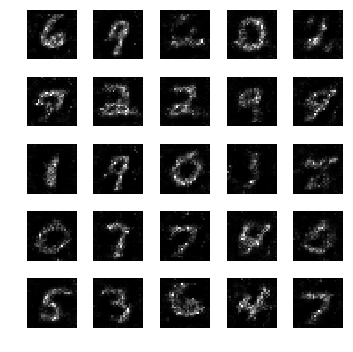

epoch: 611, time: 4.992590 | train_G_Loss: 0.365039, train_D_loss: 2.395639, train_acc: 0.884766
cv_G_Loss: 1.814112, cv_D_loss: 4.576743, cv_acc: 0.840200

epoch: 612, time: 4.961322 | train_G_Loss: 0.379534, train_D_loss: 2.719132, train_acc: 0.882812
cv_G_Loss: 0.598304, cv_D_loss: 2.603570, cv_acc: 0.870200

epoch: 613, time: 4.957836 | train_G_Loss: 0.402575, train_D_loss: 2.244450, train_acc: 0.908203
cv_G_Loss: 0.605993, cv_D_loss: 2.617489, cv_acc: 0.884500

epoch: 614, time: 4.957865 | train_G_Loss: 0.379138, train_D_loss: 2.449441, train_acc: 0.923828
cv_G_Loss: 0.360448, cv_D_loss: 2.473358, cv_acc: 0.889400

epoch: 615, time: 4.973583 | train_G_Loss: 0.432750, train_D_loss: 2.290858, train_acc: 0.900391
cv_G_Loss: 1.397270, cv_D_loss: 3.696327, cv_acc: 0.893100

epoch: 616, time: 4.977524 | train_G_Loss: 0.385950, train_D_loss: 2.659443, train_acc: 0.884766
cv_G_Loss: 0.365228, cv_D_loss: 2.513885, cv_acc: 0.897900
Model saved

epoch: 617, time: 5.007842 | train_G_Loss: 0.4

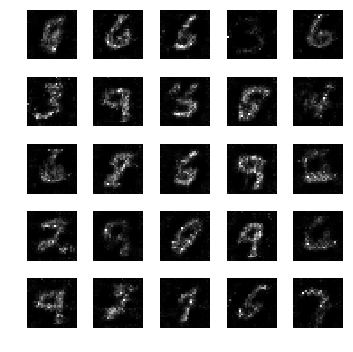

epoch: 621, time: 4.997738 | train_G_Loss: 0.465864, train_D_loss: 2.276525, train_acc: 0.890625
cv_G_Loss: 0.196899, cv_D_loss: 2.716628, cv_acc: 0.885200

epoch: 622, time: 4.970911 | train_G_Loss: 0.518834, train_D_loss: 2.217509, train_acc: 0.890625
cv_G_Loss: 0.545101, cv_D_loss: 2.537730, cv_acc: 0.874400

epoch: 623, time: 4.968442 | train_G_Loss: 0.405420, train_D_loss: 2.401282, train_acc: 0.867188
cv_G_Loss: 0.218630, cv_D_loss: 2.786902, cv_acc: 0.864300

epoch: 624, time: 4.976015 | train_G_Loss: 0.394239, train_D_loss: 2.516957, train_acc: 0.861328
cv_G_Loss: 0.352584, cv_D_loss: 2.472090, cv_acc: 0.895400

epoch: 625, time: 4.965464 | train_G_Loss: 0.379931, train_D_loss: 2.690505, train_acc: 0.900391
cv_G_Loss: 0.288882, cv_D_loss: 2.509753, cv_acc: 0.888800

epoch: 626, time: 4.963581 | train_G_Loss: 0.325839, train_D_loss: 2.415179, train_acc: 0.898438
cv_G_Loss: 0.812454, cv_D_loss: 2.803736, cv_acc: 0.883400

epoch: 627, time: 4.964725 | train_G_Loss: 0.408209, train

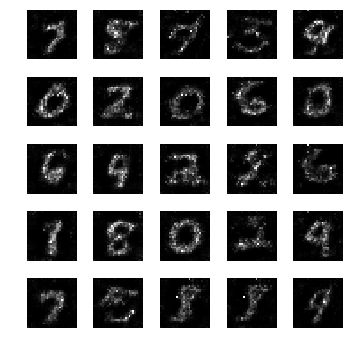

epoch: 631, time: 4.992244 | train_G_Loss: 0.345357, train_D_loss: 2.536844, train_acc: 0.882812
cv_G_Loss: 0.525402, cv_D_loss: 2.550552, cv_acc: 0.874600

epoch: 632, time: 4.971997 | train_G_Loss: 0.390053, train_D_loss: 2.645194, train_acc: 0.894531
cv_G_Loss: 1.319272, cv_D_loss: 3.480986, cv_acc: 0.885100

epoch: 633, time: 4.962879 | train_G_Loss: 0.325342, train_D_loss: 2.739488, train_acc: 0.886719
cv_G_Loss: 0.067299, cv_D_loss: 3.720750, cv_acc: 0.796800

epoch: 634, time: 4.967057 | train_G_Loss: 0.411822, train_D_loss: 2.448656, train_acc: 0.912109
cv_G_Loss: 0.214677, cv_D_loss: 2.991253, cv_acc: 0.813600

epoch: 635, time: 4.957852 | train_G_Loss: 0.463523, train_D_loss: 2.167378, train_acc: 0.910156
cv_G_Loss: 0.119256, cv_D_loss: 3.152262, cv_acc: 0.851600

epoch: 636, time: 4.955650 | train_G_Loss: 0.383378, train_D_loss: 2.214529, train_acc: 0.906250
cv_G_Loss: 1.189311, cv_D_loss: 3.646433, cv_acc: 0.833200

epoch: 637, time: 4.959548 | train_G_Loss: 0.422022, train

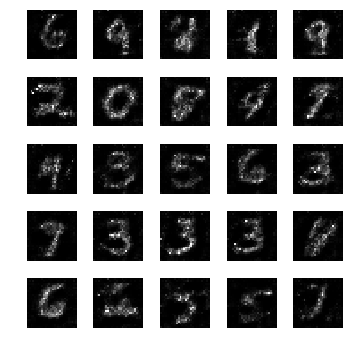

epoch: 641, time: 4.995384 | train_G_Loss: 0.426164, train_D_loss: 2.272334, train_acc: 0.867188
cv_G_Loss: 0.515118, cv_D_loss: 2.575612, cv_acc: 0.881900

epoch: 642, time: 4.963585 | train_G_Loss: 0.330355, train_D_loss: 2.871735, train_acc: 0.859375
cv_G_Loss: 0.090880, cv_D_loss: 3.336463, cv_acc: 0.839100

epoch: 643, time: 4.976877 | train_G_Loss: 0.445596, train_D_loss: 2.645433, train_acc: 0.875000
cv_G_Loss: 0.384495, cv_D_loss: 3.176071, cv_acc: 0.630200

epoch: 644, time: 4.976523 | train_G_Loss: 0.454151, train_D_loss: 2.392971, train_acc: 0.863281
cv_G_Loss: 0.215248, cv_D_loss: 2.829284, cv_acc: 0.832400

epoch: 645, time: 4.979163 | train_G_Loss: 0.407658, train_D_loss: 2.425559, train_acc: 0.888672
cv_G_Loss: 0.473286, cv_D_loss: 2.635461, cv_acc: 0.884100

epoch: 646, time: 4.969414 | train_G_Loss: 0.375158, train_D_loss: 2.541284, train_acc: 0.884766
cv_G_Loss: 0.267945, cv_D_loss: 2.522113, cv_acc: 0.892100

epoch: 647, time: 4.977535 | train_G_Loss: 0.334901, train

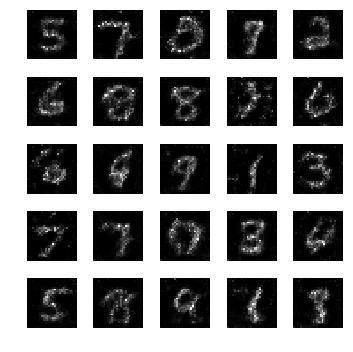

epoch: 651, time: 4.998409 | train_G_Loss: 0.256291, train_D_loss: 2.784592, train_acc: 0.904297
cv_G_Loss: 0.298245, cv_D_loss: 2.495881, cv_acc: 0.890300

epoch: 652, time: 4.976507 | train_G_Loss: 0.356127, train_D_loss: 2.730896, train_acc: 0.914062
cv_G_Loss: 0.236442, cv_D_loss: 2.721402, cv_acc: 0.869400

epoch: 653, time: 4.988489 | train_G_Loss: 0.442013, train_D_loss: 2.342658, train_acc: 0.902344
cv_G_Loss: 0.771941, cv_D_loss: 2.828969, cv_acc: 0.874500

epoch: 654, time: 4.965047 | train_G_Loss: 0.399325, train_D_loss: 2.520512, train_acc: 0.933594
cv_G_Loss: 0.657178, cv_D_loss: 2.830658, cv_acc: 0.805200

epoch: 655, time: 4.973415 | train_G_Loss: 0.380159, train_D_loss: 2.314264, train_acc: 0.929688
cv_G_Loss: 0.305009, cv_D_loss: 2.543342, cv_acc: 0.891900

epoch: 656, time: 4.957733 | train_G_Loss: 0.420830, train_D_loss: 2.276830, train_acc: 0.927734
cv_G_Loss: 1.210543, cv_D_loss: 3.407853, cv_acc: 0.885300

epoch: 657, time: 4.967005 | train_G_Loss: 0.415788, train

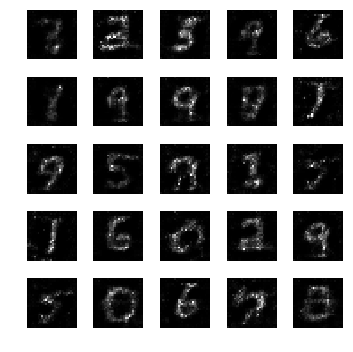

epoch: 661, time: 4.983490 | train_G_Loss: 0.360320, train_D_loss: 2.508354, train_acc: 0.908203
cv_G_Loss: 1.074021, cv_D_loss: 3.005862, cv_acc: 0.892800

epoch: 662, time: 4.959672 | train_G_Loss: 0.573096, train_D_loss: 2.403487, train_acc: 0.896484
cv_G_Loss: 0.358879, cv_D_loss: 2.497039, cv_acc: 0.894000

epoch: 663, time: 4.958892 | train_G_Loss: 0.388178, train_D_loss: 2.497154, train_acc: 0.892578
cv_G_Loss: 0.931886, cv_D_loss: 3.126876, cv_acc: 0.883100

epoch: 664, time: 4.961400 | train_G_Loss: 0.310780, train_D_loss: 2.346238, train_acc: 0.908203
cv_G_Loss: 0.613486, cv_D_loss: 2.586499, cv_acc: 0.870500

epoch: 665, time: 4.950359 | train_G_Loss: 0.398549, train_D_loss: 2.431540, train_acc: 0.912109
cv_G_Loss: 0.742825, cv_D_loss: 2.769771, cv_acc: 0.893300

epoch: 666, time: 4.960843 | train_G_Loss: 0.391530, train_D_loss: 2.314177, train_acc: 0.882812
cv_G_Loss: 0.929270, cv_D_loss: 3.139025, cv_acc: 0.833100

epoch: 667, time: 4.949046 | train_G_Loss: 0.436108, train

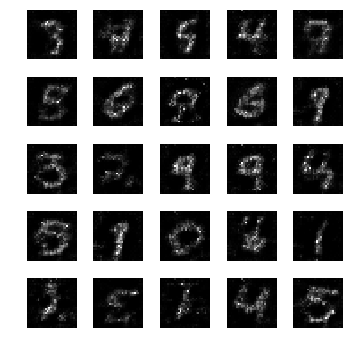

epoch: 671, time: 4.978549 | train_G_Loss: 0.365325, train_D_loss: 2.475287, train_acc: 0.910156
cv_G_Loss: 1.078928, cv_D_loss: 3.081685, cv_acc: 0.890400

epoch: 672, time: 4.957897 | train_G_Loss: 0.450002, train_D_loss: 2.301776, train_acc: 0.925781
cv_G_Loss: 0.375007, cv_D_loss: 2.517521, cv_acc: 0.881200

epoch: 673, time: 4.968551 | train_G_Loss: 0.454470, train_D_loss: 2.323720, train_acc: 0.880859
cv_G_Loss: 0.685934, cv_D_loss: 2.589649, cv_acc: 0.889100

epoch: 674, time: 4.954594 | train_G_Loss: 0.298010, train_D_loss: 2.685326, train_acc: 0.888672
cv_G_Loss: 0.224465, cv_D_loss: 2.660872, cv_acc: 0.877900

epoch: 675, time: 4.947865 | train_G_Loss: 0.414916, train_D_loss: 2.471301, train_acc: 0.896484
cv_G_Loss: 0.502001, cv_D_loss: 2.582509, cv_acc: 0.884800

epoch: 676, time: 4.987687 | train_G_Loss: 0.416139, train_D_loss: 2.345633, train_acc: 0.894531
cv_G_Loss: 0.411573, cv_D_loss: 2.382327, cv_acc: 0.903000

epoch: 677, time: 4.952781 | train_G_Loss: 0.324878, train

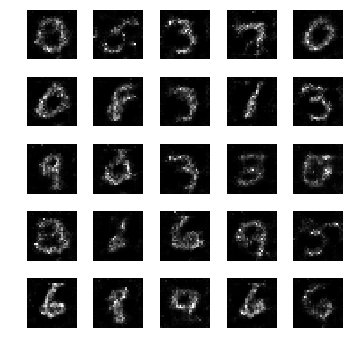

epoch: 681, time: 4.981694 | train_G_Loss: 0.262767, train_D_loss: 2.750101, train_acc: 0.894531
cv_G_Loss: 0.223998, cv_D_loss: 2.662638, cv_acc: 0.870200

epoch: 682, time: 4.971880 | train_G_Loss: 0.432896, train_D_loss: 2.103988, train_acc: 0.900391
cv_G_Loss: 1.837774, cv_D_loss: 4.729181, cv_acc: 0.822500

epoch: 683, time: 4.957750 | train_G_Loss: 0.396043, train_D_loss: 2.249775, train_acc: 0.871094
cv_G_Loss: 1.553910, cv_D_loss: 3.943623, cv_acc: 0.879800

epoch: 684, time: 4.955560 | train_G_Loss: 0.512231, train_D_loss: 2.560323, train_acc: 0.886719
cv_G_Loss: 1.447985, cv_D_loss: 3.576950, cv_acc: 0.888000

epoch: 685, time: 4.959256 | train_G_Loss: 0.498459, train_D_loss: 2.345372, train_acc: 0.892578
cv_G_Loss: 0.673509, cv_D_loss: 2.578951, cv_acc: 0.896900

epoch: 686, time: 4.954836 | train_G_Loss: 0.380668, train_D_loss: 2.382841, train_acc: 0.878906
cv_G_Loss: 0.389664, cv_D_loss: 2.409813, cv_acc: 0.890800

epoch: 687, time: 4.967887 | train_G_Loss: 0.406280, train

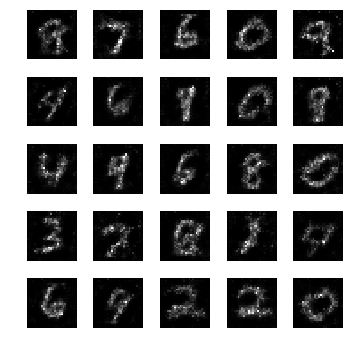

epoch: 691, time: 4.991526 | train_G_Loss: 0.450139, train_D_loss: 2.301422, train_acc: 0.931641
cv_G_Loss: 1.800187, cv_D_loss: 4.380681, cv_acc: 0.878400

epoch: 692, time: 4.963289 | train_G_Loss: 0.382261, train_D_loss: 2.203230, train_acc: 0.900391
cv_G_Loss: 4.597323, cv_D_loss: 9.820963, cv_acc: 0.823600

epoch: 693, time: 4.960143 | train_G_Loss: 0.423760, train_D_loss: 2.198027, train_acc: 0.908203
cv_G_Loss: 0.552228, cv_D_loss: 2.673953, cv_acc: 0.842700

epoch: 694, time: 4.958908 | train_G_Loss: 0.394174, train_D_loss: 2.260118, train_acc: 0.900391
cv_G_Loss: 0.493625, cv_D_loss: 2.532465, cv_acc: 0.886100

epoch: 695, time: 4.961690 | train_G_Loss: 0.408830, train_D_loss: 2.581754, train_acc: 0.875000
cv_G_Loss: 0.564466, cv_D_loss: 2.619018, cv_acc: 0.888100

epoch: 696, time: 4.969669 | train_G_Loss: 0.465203, train_D_loss: 2.611616, train_acc: 0.865234
cv_G_Loss: 0.187891, cv_D_loss: 2.672032, cv_acc: 0.895800

epoch: 697, time: 4.953611 | train_G_Loss: 0.383108, train

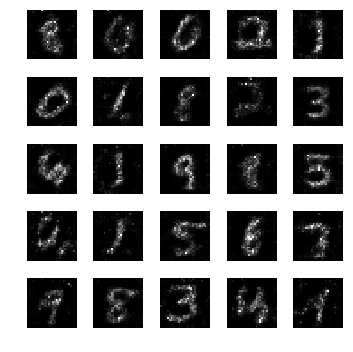

epoch: 701, time: 4.998415 | train_G_Loss: 0.340061, train_D_loss: 2.557495, train_acc: 0.896484
cv_G_Loss: 0.415086, cv_D_loss: 2.460369, cv_acc: 0.880600

epoch: 702, time: 4.961538 | train_G_Loss: 0.344381, train_D_loss: 2.598608, train_acc: 0.912109
cv_G_Loss: 0.337773, cv_D_loss: 2.511121, cv_acc: 0.880200

epoch: 703, time: 4.955510 | train_G_Loss: 0.380709, train_D_loss: 2.362829, train_acc: 0.917969
cv_G_Loss: 0.937622, cv_D_loss: 3.025086, cv_acc: 0.877100

epoch: 704, time: 4.979142 | train_G_Loss: 0.426894, train_D_loss: 2.148332, train_acc: 0.912109
cv_G_Loss: 1.011283, cv_D_loss: 2.995959, cv_acc: 0.890700

epoch: 705, time: 4.967023 | train_G_Loss: 0.294136, train_D_loss: 2.544226, train_acc: 0.892578
cv_G_Loss: 0.626224, cv_D_loss: 2.952857, cv_acc: 0.756900

epoch: 706, time: 4.969138 | train_G_Loss: 0.442913, train_D_loss: 2.408901, train_acc: 0.896484
cv_G_Loss: 1.791172, cv_D_loss: 4.498039, cv_acc: 0.858300

epoch: 707, time: 4.962594 | train_G_Loss: 0.341734, train

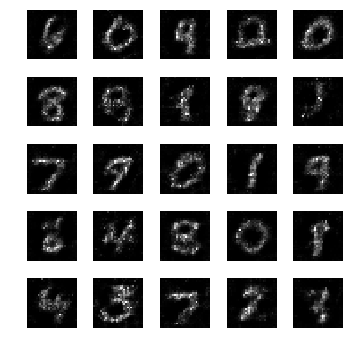

epoch: 711, time: 4.980582 | train_G_Loss: 0.503786, train_D_loss: 2.359526, train_acc: 0.880859
cv_G_Loss: 2.054591, cv_D_loss: 4.978028, cv_acc: 0.872400

epoch: 712, time: 4.953749 | train_G_Loss: 0.440896, train_D_loss: 2.373201, train_acc: 0.869141
cv_G_Loss: 0.556218, cv_D_loss: 2.730171, cv_acc: 0.867000

epoch: 713, time: 4.955499 | train_G_Loss: 0.389816, train_D_loss: 2.426851, train_acc: 0.886719
cv_G_Loss: 1.524058, cv_D_loss: 3.792153, cv_acc: 0.891400

epoch: 714, time: 4.972837 | train_G_Loss: 0.365671, train_D_loss: 2.216558, train_acc: 0.900391
cv_G_Loss: 0.284261, cv_D_loss: 2.450516, cv_acc: 0.908100
Model saved

epoch: 715, time: 5.002265 | train_G_Loss: 0.357214, train_D_loss: 2.355282, train_acc: 0.935547
cv_G_Loss: 0.320611, cv_D_loss: 2.445645, cv_acc: 0.898500

epoch: 716, time: 4.981029 | train_G_Loss: 0.441817, train_D_loss: 2.501048, train_acc: 0.882812
cv_G_Loss: 0.210409, cv_D_loss: 2.819467, cv_acc: 0.836500

epoch: 717, time: 4.979832 | train_G_Loss: 0.3

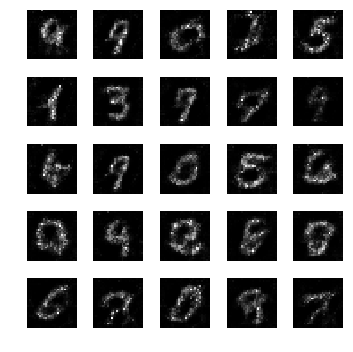

epoch: 721, time: 5.027038 | train_G_Loss: 0.368455, train_D_loss: 2.535596, train_acc: 0.921875
cv_G_Loss: 0.500920, cv_D_loss: 2.524352, cv_acc: 0.897400

epoch: 722, time: 4.975693 | train_G_Loss: 0.313966, train_D_loss: 2.375604, train_acc: 0.904297
cv_G_Loss: 0.386254, cv_D_loss: 2.338762, cv_acc: 0.902700

epoch: 723, time: 4.972755 | train_G_Loss: 0.427965, train_D_loss: 2.237709, train_acc: 0.894531
cv_G_Loss: 2.479054, cv_D_loss: 5.509800, cv_acc: 0.894600

epoch: 724, time: 4.959014 | train_G_Loss: 0.437109, train_D_loss: 2.566344, train_acc: 0.914062
cv_G_Loss: 0.457207, cv_D_loss: 2.457911, cv_acc: 0.904100

epoch: 725, time: 4.970725 | train_G_Loss: 0.378831, train_D_loss: 2.461429, train_acc: 0.906250
cv_G_Loss: 1.217010, cv_D_loss: 3.191643, cv_acc: 0.891900

epoch: 726, time: 4.981474 | train_G_Loss: 0.341993, train_D_loss: 2.254122, train_acc: 0.900391
cv_G_Loss: 0.395016, cv_D_loss: 2.485787, cv_acc: 0.887900

epoch: 727, time: 4.978698 | train_G_Loss: 0.465130, train

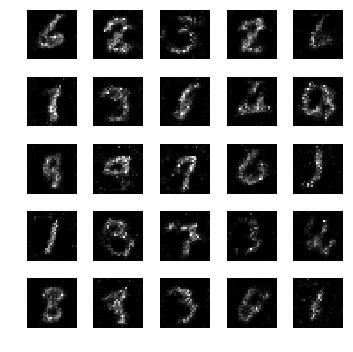

epoch: 731, time: 4.983154 | train_G_Loss: 0.367009, train_D_loss: 2.244312, train_acc: 0.908203
cv_G_Loss: 0.222179, cv_D_loss: 2.570718, cv_acc: 0.892400

epoch: 732, time: 4.980627 | train_G_Loss: 0.367386, train_D_loss: 2.626789, train_acc: 0.906250
cv_G_Loss: 0.430509, cv_D_loss: 2.350401, cv_acc: 0.906000

epoch: 733, time: 4.980581 | train_G_Loss: 0.473808, train_D_loss: 2.150127, train_acc: 0.919922
cv_G_Loss: 0.681352, cv_D_loss: 2.533367, cv_acc: 0.909400
Model saved

epoch: 734, time: 4.999495 | train_G_Loss: 0.355798, train_D_loss: 2.264171, train_acc: 0.912109
cv_G_Loss: 0.547512, cv_D_loss: 2.481951, cv_acc: 0.901900

epoch: 735, time: 4.967696 | train_G_Loss: 0.452483, train_D_loss: 2.243821, train_acc: 0.912109
cv_G_Loss: 0.247432, cv_D_loss: 2.482229, cv_acc: 0.904800

epoch: 736, time: 4.971779 | train_G_Loss: 0.502886, train_D_loss: 2.491511, train_acc: 0.929688
cv_G_Loss: 0.809844, cv_D_loss: 2.699473, cv_acc: 0.904700

epoch: 737, time: 4.966547 | train_G_Loss: 0.4

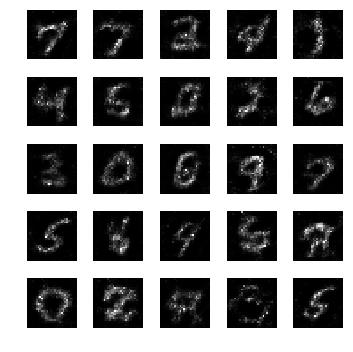

epoch: 741, time: 4.989090 | train_G_Loss: 0.406222, train_D_loss: 2.168546, train_acc: 0.947266
cv_G_Loss: 2.090888, cv_D_loss: 4.882836, cv_acc: 0.881000

epoch: 742, time: 4.954386 | train_G_Loss: 0.383404, train_D_loss: 2.364309, train_acc: 0.945312
cv_G_Loss: 0.491164, cv_D_loss: 2.373183, cv_acc: 0.907700

epoch: 743, time: 4.989562 | train_G_Loss: 0.346394, train_D_loss: 3.016763, train_acc: 0.921875
cv_G_Loss: 0.556243, cv_D_loss: 2.701583, cv_acc: 0.813700

epoch: 744, time: 4.964925 | train_G_Loss: 0.407353, train_D_loss: 2.420717, train_acc: 0.904297
cv_G_Loss: 4.585372, cv_D_loss: 9.915430, cv_acc: 0.828400

epoch: 745, time: 4.962399 | train_G_Loss: 0.502165, train_D_loss: 2.606474, train_acc: 0.900391
cv_G_Loss: 0.659228, cv_D_loss: 2.576475, cv_acc: 0.816600

epoch: 746, time: 4.964942 | train_G_Loss: 0.426180, train_D_loss: 2.357153, train_acc: 0.919922
cv_G_Loss: 0.431775, cv_D_loss: 2.878778, cv_acc: 0.763900

epoch: 747, time: 4.962294 | train_G_Loss: 0.357251, train

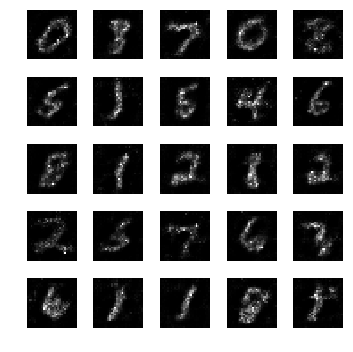

epoch: 751, time: 4.986407 | train_G_Loss: 0.367572, train_D_loss: 2.167727, train_acc: 0.900391
cv_G_Loss: 1.745777, cv_D_loss: 4.300803, cv_acc: 0.836400

epoch: 752, time: 4.964464 | train_G_Loss: 0.440005, train_D_loss: 2.310585, train_acc: 0.914062
cv_G_Loss: 1.115651, cv_D_loss: 3.119046, cv_acc: 0.897200

epoch: 753, time: 4.965237 | train_G_Loss: 0.427671, train_D_loss: 2.276413, train_acc: 0.906250
cv_G_Loss: 0.313616, cv_D_loss: 2.930970, cv_acc: 0.711000

epoch: 754, time: 4.960055 | train_G_Loss: 0.388711, train_D_loss: 2.293816, train_acc: 0.898438
cv_G_Loss: 0.530211, cv_D_loss: 2.922447, cv_acc: 0.818000

epoch: 755, time: 4.963456 | train_G_Loss: 0.397229, train_D_loss: 2.384706, train_acc: 0.876953
cv_G_Loss: 0.429975, cv_D_loss: 2.864263, cv_acc: 0.727100

epoch: 756, time: 4.974312 | train_G_Loss: 0.377273, train_D_loss: 2.201362, train_acc: 0.876953
cv_G_Loss: 0.250104, cv_D_loss: 2.880237, cv_acc: 0.811500

epoch: 757, time: 4.967865 | train_G_Loss: 0.403848, train

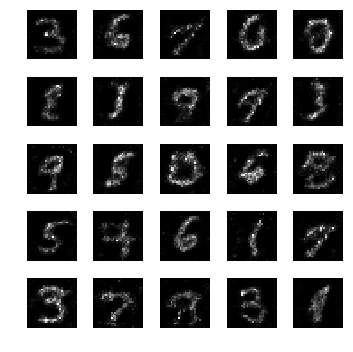

epoch: 761, time: 4.995781 | train_G_Loss: 0.311088, train_D_loss: 2.834654, train_acc: 0.919922
cv_G_Loss: 0.198734, cv_D_loss: 2.958168, cv_acc: 0.823500

epoch: 762, time: 4.983244 | train_G_Loss: 0.471103, train_D_loss: 2.143131, train_acc: 0.945312
cv_G_Loss: 0.757001, cv_D_loss: 2.783609, cv_acc: 0.885300

epoch: 763, time: 4.993379 | train_G_Loss: 0.357192, train_D_loss: 2.362577, train_acc: 0.927734
cv_G_Loss: 1.245245, cv_D_loss: 3.320679, cv_acc: 0.880900

epoch: 764, time: 4.967449 | train_G_Loss: 0.300695, train_D_loss: 2.337825, train_acc: 0.919922
cv_G_Loss: 0.466202, cv_D_loss: 2.467296, cv_acc: 0.887100

epoch: 765, time: 4.962900 | train_G_Loss: 0.480864, train_D_loss: 2.438141, train_acc: 0.894531
cv_G_Loss: 2.035981, cv_D_loss: 4.657886, cv_acc: 0.900600

epoch: 766, time: 4.999862 | train_G_Loss: 0.407243, train_D_loss: 2.270029, train_acc: 0.875000
cv_G_Loss: 0.531480, cv_D_loss: 2.338757, cv_acc: 0.903100

epoch: 767, time: 4.976441 | train_G_Loss: 0.391727, train

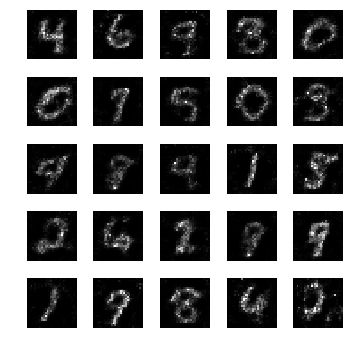

epoch: 771, time: 4.986578 | train_G_Loss: 0.411160, train_D_loss: 2.556245, train_acc: 0.902344
cv_G_Loss: 1.175009, cv_D_loss: 3.244784, cv_acc: 0.880200

epoch: 772, time: 4.958793 | train_G_Loss: 0.468417, train_D_loss: 2.221418, train_acc: 0.904297
cv_G_Loss: 1.036217, cv_D_loss: 3.097668, cv_acc: 0.879200

epoch: 773, time: 4.973147 | train_G_Loss: 0.338072, train_D_loss: 2.160453, train_acc: 0.882812
cv_G_Loss: 0.455524, cv_D_loss: 2.407434, cv_acc: 0.892600

epoch: 774, time: 4.964875 | train_G_Loss: 0.512354, train_D_loss: 2.429786, train_acc: 0.869141
cv_G_Loss: 1.047393, cv_D_loss: 3.114021, cv_acc: 0.888500

epoch: 775, time: 4.957580 | train_G_Loss: 0.405608, train_D_loss: 2.409663, train_acc: 0.861328
cv_G_Loss: 1.180539, cv_D_loss: 3.200506, cv_acc: 0.909200

epoch: 776, time: 4.965643 | train_G_Loss: 0.382175, train_D_loss: 2.443027, train_acc: 0.861328
cv_G_Loss: 0.563506, cv_D_loss: 2.610288, cv_acc: 0.891100

epoch: 777, time: 4.957753 | train_G_Loss: 0.333617, train

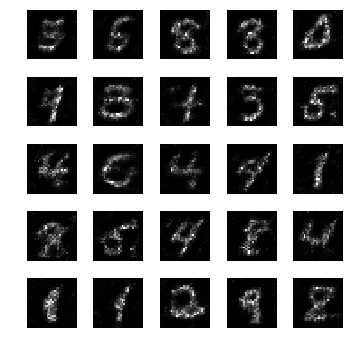

epoch: 781, time: 4.994600 | train_G_Loss: 0.258129, train_D_loss: 2.407024, train_acc: 0.914062
cv_G_Loss: 0.811110, cv_D_loss: 2.631532, cv_acc: 0.896600

epoch: 782, time: 4.966020 | train_G_Loss: 0.471302, train_D_loss: 2.208804, train_acc: 0.925781
cv_G_Loss: 2.074878, cv_D_loss: 5.119446, cv_acc: 0.688300

epoch: 783, time: 4.966856 | train_G_Loss: 0.357261, train_D_loss: 2.472554, train_acc: 0.912109
cv_G_Loss: 0.268810, cv_D_loss: 2.468933, cv_acc: 0.902300

epoch: 784, time: 4.957291 | train_G_Loss: 0.457753, train_D_loss: 2.182946, train_acc: 0.902344
cv_G_Loss: 1.225827, cv_D_loss: 3.212490, cv_acc: 0.908800

epoch: 785, time: 4.955756 | train_G_Loss: 0.413910, train_D_loss: 2.244473, train_acc: 0.906250
cv_G_Loss: 0.188850, cv_D_loss: 2.647166, cv_acc: 0.896400

epoch: 786, time: 4.964755 | train_G_Loss: 0.467608, train_D_loss: 2.266889, train_acc: 0.886719
cv_G_Loss: 1.712302, cv_D_loss: 4.047211, cv_acc: 0.904500

epoch: 787, time: 4.966256 | train_G_Loss: 0.250664, train

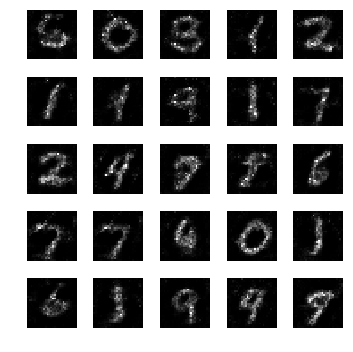

epoch: 791, time: 4.998209 | train_G_Loss: 0.450284, train_D_loss: 2.247161, train_acc: 0.929688
cv_G_Loss: 0.370340, cv_D_loss: 2.312964, cv_acc: 0.907200

epoch: 792, time: 4.963603 | train_G_Loss: 0.439746, train_D_loss: 2.182258, train_acc: 0.910156
cv_G_Loss: 0.504041, cv_D_loss: 2.453912, cv_acc: 0.904200

epoch: 793, time: 4.964929 | train_G_Loss: 0.407826, train_D_loss: 2.261940, train_acc: 0.916016
cv_G_Loss: 0.793387, cv_D_loss: 2.825366, cv_acc: 0.881800

epoch: 794, time: 4.972016 | train_G_Loss: 0.439924, train_D_loss: 2.587397, train_acc: 0.894531
cv_G_Loss: 3.437550, cv_D_loss: 7.678535, cv_acc: 0.852400

epoch: 795, time: 4.963134 | train_G_Loss: 0.410252, train_D_loss: 2.300704, train_acc: 0.923828
cv_G_Loss: 1.268180, cv_D_loss: 3.362107, cv_acc: 0.911100
Model saved

epoch: 796, time: 4.997205 | train_G_Loss: 0.444293, train_D_loss: 2.152284, train_acc: 0.912109
cv_G_Loss: 2.155752, cv_D_loss: 4.933303, cv_acc: 0.888300

epoch: 797, time: 4.970304 | train_G_Loss: 0.4

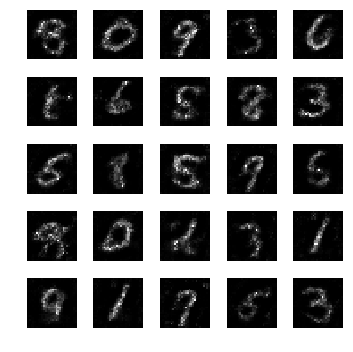

epoch: 801, time: 4.982562 | train_G_Loss: 0.410524, train_D_loss: 2.423067, train_acc: 0.906250
cv_G_Loss: 0.311255, cv_D_loss: 2.424319, cv_acc: 0.910300

epoch: 802, time: 4.962669 | train_G_Loss: 0.413270, train_D_loss: 2.602687, train_acc: 0.890625
cv_G_Loss: 0.363791, cv_D_loss: 2.378098, cv_acc: 0.898200

epoch: 803, time: 4.965857 | train_G_Loss: 0.325620, train_D_loss: 2.589626, train_acc: 0.884766
cv_G_Loss: 0.361414, cv_D_loss: 2.424776, cv_acc: 0.901400

epoch: 804, time: 4.964923 | train_G_Loss: 0.454779, train_D_loss: 2.333341, train_acc: 0.916016
cv_G_Loss: 0.435126, cv_D_loss: 2.344462, cv_acc: 0.894700

epoch: 805, time: 4.967507 | train_G_Loss: 0.410205, train_D_loss: 2.298735, train_acc: 0.923828
cv_G_Loss: 1.083388, cv_D_loss: 3.253636, cv_acc: 0.895500

epoch: 806, time: 4.968122 | train_G_Loss: 0.445661, train_D_loss: 2.220610, train_acc: 0.910156
cv_G_Loss: 0.386930, cv_D_loss: 2.495211, cv_acc: 0.894300

epoch: 807, time: 4.973360 | train_G_Loss: 0.338100, train

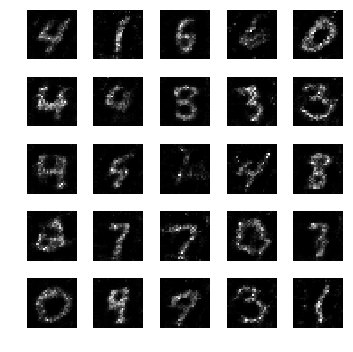

epoch: 811, time: 5.009613 | train_G_Loss: 0.371245, train_D_loss: 2.376054, train_acc: 0.888672
cv_G_Loss: 0.397388, cv_D_loss: 2.491478, cv_acc: 0.894800

epoch: 812, time: 4.977961 | train_G_Loss: 0.405363, train_D_loss: 2.336829, train_acc: 0.916016
cv_G_Loss: 0.023179, cv_D_loss: 4.452176, cv_acc: 0.898700

epoch: 813, time: 4.968696 | train_G_Loss: 0.513366, train_D_loss: 2.152326, train_acc: 0.933594
cv_G_Loss: 0.782458, cv_D_loss: 2.712607, cv_acc: 0.904500

epoch: 814, time: 4.967453 | train_G_Loss: 0.325237, train_D_loss: 2.322019, train_acc: 0.931641
cv_G_Loss: 0.364342, cv_D_loss: 2.436036, cv_acc: 0.893100

epoch: 815, time: 4.964402 | train_G_Loss: 0.406402, train_D_loss: 2.240325, train_acc: 0.921875
cv_G_Loss: 0.956663, cv_D_loss: 2.963228, cv_acc: 0.904500

epoch: 816, time: 4.969450 | train_G_Loss: 0.442794, train_D_loss: 2.212601, train_acc: 0.876953
cv_G_Loss: 0.702374, cv_D_loss: 2.759119, cv_acc: 0.869500

epoch: 817, time: 4.971332 | train_G_Loss: 0.582718, train

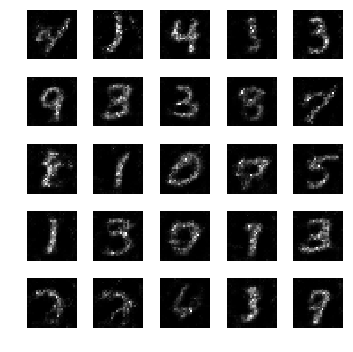

epoch: 821, time: 4.994401 | train_G_Loss: 0.426527, train_D_loss: 2.316449, train_acc: 0.929688
cv_G_Loss: 1.323350, cv_D_loss: 3.578808, cv_acc: 0.886800

epoch: 822, time: 4.971202 | train_G_Loss: 0.331165, train_D_loss: 2.142781, train_acc: 0.919922
cv_G_Loss: 0.228250, cv_D_loss: 2.644166, cv_acc: 0.884400

epoch: 823, time: 4.973420 | train_G_Loss: 0.389158, train_D_loss: 2.365702, train_acc: 0.916016
cv_G_Loss: 0.164335, cv_D_loss: 2.847347, cv_acc: 0.862400

epoch: 824, time: 4.959907 | train_G_Loss: 0.395462, train_D_loss: 2.514509, train_acc: 0.919922
cv_G_Loss: 0.185157, cv_D_loss: 2.812973, cv_acc: 0.862300

epoch: 825, time: 4.968004 | train_G_Loss: 0.412355, train_D_loss: 2.399643, train_acc: 0.896484
cv_G_Loss: 0.306379, cv_D_loss: 2.493505, cv_acc: 0.911600
Model saved

epoch: 826, time: 5.001453 | train_G_Loss: 0.465436, train_D_loss: 2.463017, train_acc: 0.910156
cv_G_Loss: 1.300557, cv_D_loss: 3.401367, cv_acc: 0.905300

epoch: 827, time: 4.978549 | train_G_Loss: 0.3

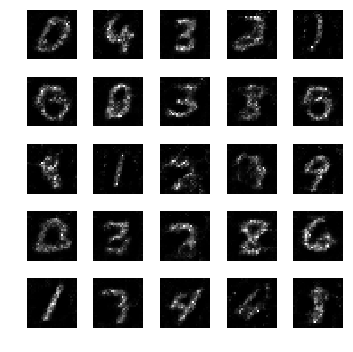

epoch: 831, time: 4.987810 | train_G_Loss: 0.291781, train_D_loss: 2.449422, train_acc: 0.902344
cv_G_Loss: 0.075107, cv_D_loss: 3.291358, cv_acc: 0.899700

epoch: 832, time: 4.952963 | train_G_Loss: 0.422175, train_D_loss: 2.286528, train_acc: 0.894531
cv_G_Loss: 1.346105, cv_D_loss: 3.533683, cv_acc: 0.890600

epoch: 833, time: 4.971799 | train_G_Loss: 0.343924, train_D_loss: 2.229644, train_acc: 0.884766
cv_G_Loss: 0.134573, cv_D_loss: 2.838535, cv_acc: 0.900200

epoch: 834, time: 4.952898 | train_G_Loss: 0.445248, train_D_loss: 2.732245, train_acc: 0.875000
cv_G_Loss: 1.795142, cv_D_loss: 4.343505, cv_acc: 0.887600

epoch: 835, time: 4.951040 | train_G_Loss: 0.386052, train_D_loss: 2.431538, train_acc: 0.847656
cv_G_Loss: 1.101578, cv_D_loss: 3.406949, cv_acc: 0.881200

epoch: 836, time: 4.961248 | train_G_Loss: 0.380635, train_D_loss: 2.518029, train_acc: 0.861328
cv_G_Loss: 1.117524, cv_D_loss: 3.047299, cv_acc: 0.900200

epoch: 837, time: 4.957423 | train_G_Loss: 0.435324, train

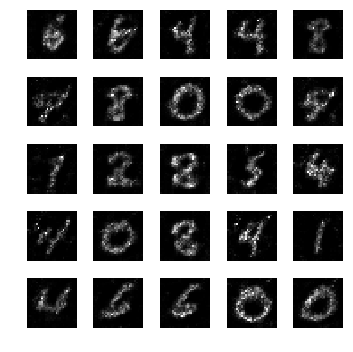

epoch: 841, time: 4.998891 | train_G_Loss: 0.406854, train_D_loss: 2.237203, train_acc: 0.935547
cv_G_Loss: 0.547724, cv_D_loss: 2.498563, cv_acc: 0.895200

epoch: 842, time: 4.959129 | train_G_Loss: 0.356274, train_D_loss: 2.242849, train_acc: 0.927734
cv_G_Loss: 3.732737, cv_D_loss: 7.896827, cv_acc: 0.858600

epoch: 843, time: 4.968076 | train_G_Loss: 0.309197, train_D_loss: 2.231094, train_acc: 0.886719
cv_G_Loss: 0.668408, cv_D_loss: 2.589799, cv_acc: 0.897800

epoch: 844, time: 4.971345 | train_G_Loss: 0.445669, train_D_loss: 2.449661, train_acc: 0.908203
cv_G_Loss: 1.294500, cv_D_loss: 3.592588, cv_acc: 0.883800

epoch: 845, time: 4.950222 | train_G_Loss: 0.375293, train_D_loss: 2.332304, train_acc: 0.919922
cv_G_Loss: 0.332623, cv_D_loss: 2.424654, cv_acc: 0.892600

epoch: 846, time: 4.968951 | train_G_Loss: 0.433026, train_D_loss: 2.309713, train_acc: 0.919922
cv_G_Loss: 0.349351, cv_D_loss: 2.541697, cv_acc: 0.900800

epoch: 847, time: 4.962069 | train_G_Loss: 0.503038, train

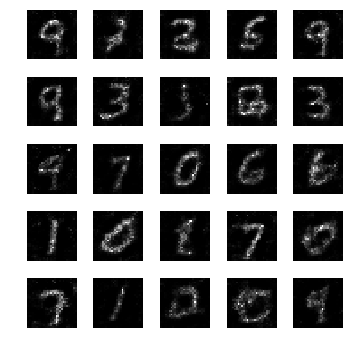

epoch: 851, time: 4.977365 | train_G_Loss: 0.395437, train_D_loss: 2.190223, train_acc: 0.910156
cv_G_Loss: 0.501581, cv_D_loss: 3.003057, cv_acc: 0.804900

epoch: 852, time: 4.962110 | train_G_Loss: 0.439694, train_D_loss: 2.386932, train_acc: 0.873047
cv_G_Loss: 0.088949, cv_D_loss: 3.275966, cv_acc: 0.876400

epoch: 853, time: 4.961217 | train_G_Loss: 0.364106, train_D_loss: 2.544341, train_acc: 0.886719
cv_G_Loss: 1.085616, cv_D_loss: 3.105036, cv_acc: 0.911300

epoch: 854, time: 4.975810 | train_G_Loss: 0.354632, train_D_loss: 2.565750, train_acc: 0.910156
cv_G_Loss: 0.086973, cv_D_loss: 3.256535, cv_acc: 0.864800

epoch: 855, time: 4.971792 | train_G_Loss: 0.368673, train_D_loss: 2.316884, train_acc: 0.927734
cv_G_Loss: 0.579322, cv_D_loss: 2.571644, cv_acc: 0.892200

epoch: 856, time: 4.990414 | train_G_Loss: 0.424358, train_D_loss: 2.369811, train_acc: 0.910156
cv_G_Loss: 0.378888, cv_D_loss: 2.461167, cv_acc: 0.905400

epoch: 857, time: 4.967043 | train_G_Loss: 0.390958, train

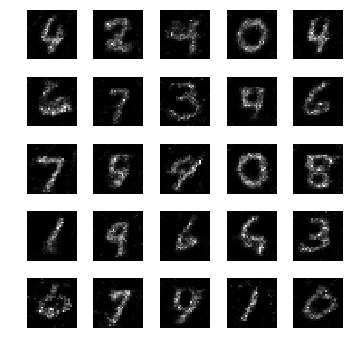

epoch: 861, time: 5.011267 | train_G_Loss: 0.339774, train_D_loss: 2.445267, train_acc: 0.906250
cv_G_Loss: 1.810597, cv_D_loss: 4.382998, cv_acc: 0.884400

epoch: 862, time: 4.976424 | train_G_Loss: 0.364241, train_D_loss: 2.473369, train_acc: 0.917969
cv_G_Loss: 0.503271, cv_D_loss: 2.362652, cv_acc: 0.914900
Model saved

epoch: 863, time: 4.990429 | train_G_Loss: 0.462206, train_D_loss: 2.420056, train_acc: 0.921875
cv_G_Loss: 0.913854, cv_D_loss: 2.889164, cv_acc: 0.886300

epoch: 864, time: 4.950851 | train_G_Loss: 0.506002, train_D_loss: 2.334711, train_acc: 0.916016
cv_G_Loss: 1.291278, cv_D_loss: 3.359253, cv_acc: 0.904800

epoch: 865, time: 4.966845 | train_G_Loss: 0.368385, train_D_loss: 2.360882, train_acc: 0.908203
cv_G_Loss: 0.164670, cv_D_loss: 3.244594, cv_acc: 0.785800

epoch: 866, time: 4.968009 | train_G_Loss: 0.387913, train_D_loss: 2.335401, train_acc: 0.894531
cv_G_Loss: 0.470294, cv_D_loss: 2.403979, cv_acc: 0.885500

epoch: 867, time: 4.953463 | train_G_Loss: 0.3

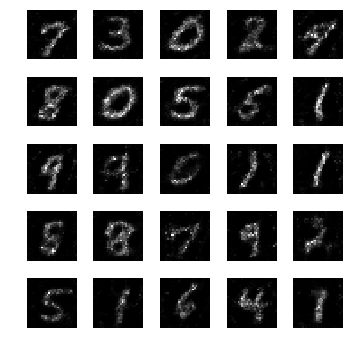

epoch: 871, time: 4.999102 | train_G_Loss: 0.443125, train_D_loss: 2.269948, train_acc: 0.902344
cv_G_Loss: 0.199812, cv_D_loss: 2.592200, cv_acc: 0.912400

epoch: 872, time: 4.973113 | train_G_Loss: 0.323016, train_D_loss: 2.234224, train_acc: 0.908203
cv_G_Loss: 0.940494, cv_D_loss: 2.838740, cv_acc: 0.916900
Model saved

epoch: 873, time: 4.984310 | train_G_Loss: 0.397896, train_D_loss: 2.546671, train_acc: 0.933594
cv_G_Loss: 0.477680, cv_D_loss: 2.507015, cv_acc: 0.896500

epoch: 874, time: 4.956150 | train_G_Loss: 0.410850, train_D_loss: 2.163745, train_acc: 0.937500
cv_G_Loss: 0.417618, cv_D_loss: 2.366811, cv_acc: 0.914100

epoch: 875, time: 4.941744 | train_G_Loss: 0.432362, train_D_loss: 2.314851, train_acc: 0.921875
cv_G_Loss: 0.823469, cv_D_loss: 2.677615, cv_acc: 0.915000

epoch: 876, time: 4.950881 | train_G_Loss: 0.439554, train_D_loss: 2.452445, train_acc: 0.929688
cv_G_Loss: 1.686108, cv_D_loss: 4.211974, cv_acc: 0.908700

epoch: 877, time: 4.956675 | train_G_Loss: 0.4

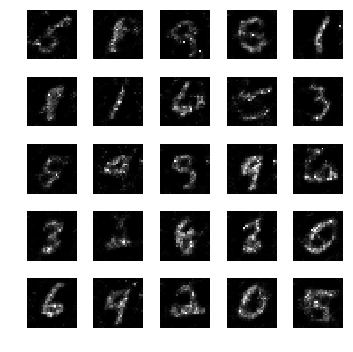

epoch: 881, time: 4.966703 | train_G_Loss: 0.448867, train_D_loss: 2.280375, train_acc: 0.886719
cv_G_Loss: 4.381048, cv_D_loss: 9.299170, cv_acc: 0.838500

epoch: 882, time: 4.945147 | train_G_Loss: 0.400947, train_D_loss: 2.518206, train_acc: 0.878906
cv_G_Loss: 1.648308, cv_D_loss: 4.044203, cv_acc: 0.910400

epoch: 883, time: 4.940807 | train_G_Loss: 0.426081, train_D_loss: 2.306698, train_acc: 0.904297
cv_G_Loss: 0.686138, cv_D_loss: 2.528612, cv_acc: 0.912900

epoch: 884, time: 4.954939 | train_G_Loss: 0.515649, train_D_loss: 2.277006, train_acc: 0.921875
cv_G_Loss: 0.519644, cv_D_loss: 2.568663, cv_acc: 0.893100

epoch: 885, time: 4.962292 | train_G_Loss: 0.487310, train_D_loss: 2.186543, train_acc: 0.902344
cv_G_Loss: 0.748504, cv_D_loss: 2.734238, cv_acc: 0.902500

epoch: 886, time: 4.970325 | train_G_Loss: 0.393433, train_D_loss: 2.142520, train_acc: 0.900391
cv_G_Loss: 0.302542, cv_D_loss: 2.419360, cv_acc: 0.912100

epoch: 887, time: 4.945616 | train_G_Loss: 0.405246, train

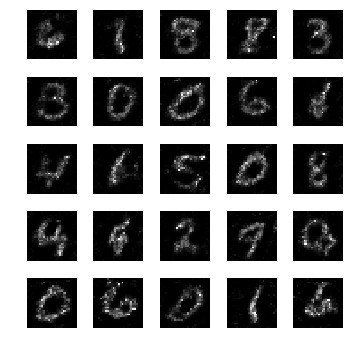

epoch: 891, time: 5.009634 | train_G_Loss: 0.399580, train_D_loss: 2.422524, train_acc: 0.914062
cv_G_Loss: 0.425272, cv_D_loss: 2.376009, cv_acc: 0.898700

epoch: 892, time: 4.982661 | train_G_Loss: 0.321282, train_D_loss: 2.251403, train_acc: 0.894531
cv_G_Loss: 1.715035, cv_D_loss: 4.166400, cv_acc: 0.895500

epoch: 893, time: 4.986609 | train_G_Loss: 0.391859, train_D_loss: 2.330842, train_acc: 0.890625
cv_G_Loss: 0.362597, cv_D_loss: 2.938498, cv_acc: 0.780200

epoch: 894, time: 4.977887 | train_G_Loss: 0.460771, train_D_loss: 2.385884, train_acc: 0.892578
cv_G_Loss: 0.944532, cv_D_loss: 3.153273, cv_acc: 0.761800

epoch: 895, time: 4.985231 | train_G_Loss: 0.558740, train_D_loss: 2.420877, train_acc: 0.935547
cv_G_Loss: 0.274039, cv_D_loss: 2.544791, cv_acc: 0.894800

epoch: 896, time: 4.985044 | train_G_Loss: 0.360652, train_D_loss: 2.462691, train_acc: 0.910156
cv_G_Loss: 1.955085, cv_D_loss: 4.856234, cv_acc: 0.895500

epoch: 897, time: 4.987811 | train_G_Loss: 0.373641, train

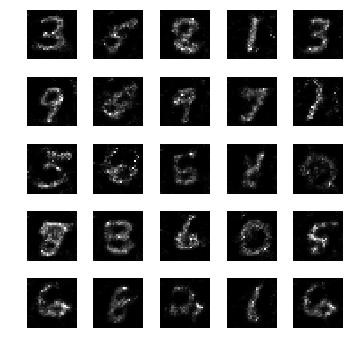

epoch: 901, time: 5.013086 | train_G_Loss: 0.537443, train_D_loss: 2.205465, train_acc: 0.939453
cv_G_Loss: 2.950192, cv_D_loss: 7.230097, cv_acc: 0.741900

epoch: 902, time: 4.958262 | train_G_Loss: 0.575516, train_D_loss: 2.225828, train_acc: 0.902344
cv_G_Loss: 0.127951, cv_D_loss: 2.810800, cv_acc: 0.918700
Model saved

epoch: 903, time: 4.983261 | train_G_Loss: 0.364187, train_D_loss: 2.603814, train_acc: 0.908203
cv_G_Loss: 3.001810, cv_D_loss: 6.468778, cv_acc: 0.891000

epoch: 904, time: 4.965250 | train_G_Loss: 0.468333, train_D_loss: 2.382226, train_acc: 0.912109
cv_G_Loss: 0.497271, cv_D_loss: 2.376695, cv_acc: 0.905600

epoch: 905, time: 4.965646 | train_G_Loss: 0.265002, train_D_loss: 2.624656, train_acc: 0.875000
cv_G_Loss: 0.180160, cv_D_loss: 2.659131, cv_acc: 0.904900

epoch: 906, time: 4.972008 | train_G_Loss: 0.611637, train_D_loss: 2.816180, train_acc: 0.917969
cv_G_Loss: 2.154891, cv_D_loss: 4.909338, cv_acc: 0.894800

epoch: 907, time: 4.974397 | train_G_Loss: 0.4

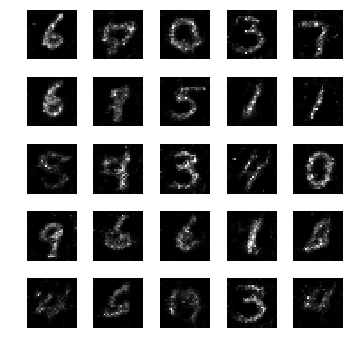

epoch: 911, time: 5.071816 | train_G_Loss: 0.478323, train_D_loss: 2.189069, train_acc: 0.910156
cv_G_Loss: 1.929245, cv_D_loss: 4.417831, cv_acc: 0.884100

epoch: 912, time: 4.972597 | train_G_Loss: 0.355930, train_D_loss: 2.167170, train_acc: 0.906250
cv_G_Loss: 1.804906, cv_D_loss: 4.177807, cv_acc: 0.917000

epoch: 913, time: 4.973001 | train_G_Loss: 0.450720, train_D_loss: 2.188722, train_acc: 0.931641
cv_G_Loss: 0.225573, cv_D_loss: 2.511360, cv_acc: 0.915300

epoch: 914, time: 4.968373 | train_G_Loss: 0.409457, train_D_loss: 2.559001, train_acc: 0.931641
cv_G_Loss: 0.488979, cv_D_loss: 2.323347, cv_acc: 0.916200

epoch: 915, time: 4.972788 | train_G_Loss: 0.448775, train_D_loss: 2.366423, train_acc: 0.933594
cv_G_Loss: 0.292781, cv_D_loss: 2.368934, cv_acc: 0.917600

epoch: 916, time: 4.960072 | train_G_Loss: 0.395358, train_D_loss: 2.074521, train_acc: 0.947266
cv_G_Loss: 1.589752, cv_D_loss: 3.845042, cv_acc: 0.910100

epoch: 917, time: 4.968114 | train_G_Loss: 0.405109, train

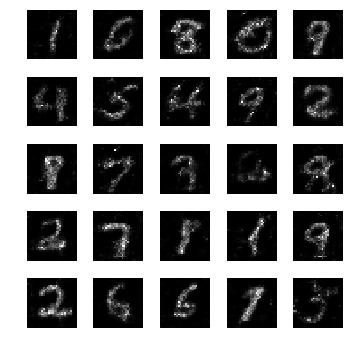

epoch: 921, time: 4.998351 | train_G_Loss: 0.371200, train_D_loss: 2.267981, train_acc: 0.914062
cv_G_Loss: 0.138570, cv_D_loss: 2.960997, cv_acc: 0.880700

epoch: 922, time: 4.965301 | train_G_Loss: 0.301592, train_D_loss: 2.615274, train_acc: 0.941406
cv_G_Loss: 0.498093, cv_D_loss: 2.475067, cv_acc: 0.903500

epoch: 923, time: 5.001555 | train_G_Loss: 0.416069, train_D_loss: 2.117569, train_acc: 0.955078
cv_G_Loss: 1.134715, cv_D_loss: 3.387502, cv_acc: 0.875700

epoch: 924, time: 4.966643 | train_G_Loss: 0.463621, train_D_loss: 2.095997, train_acc: 0.947266
cv_G_Loss: 0.930102, cv_D_loss: 2.862080, cv_acc: 0.904700

epoch: 925, time: 4.965821 | train_G_Loss: 0.416770, train_D_loss: 2.315907, train_acc: 0.960938
cv_G_Loss: 0.321452, cv_D_loss: 2.472983, cv_acc: 0.899100

epoch: 926, time: 4.976446 | train_G_Loss: 0.395525, train_D_loss: 2.029867, train_acc: 0.968750
cv_G_Loss: 0.128564, cv_D_loss: 2.973756, cv_acc: 0.879900

epoch: 927, time: 4.965690 | train_G_Loss: 0.345423, train

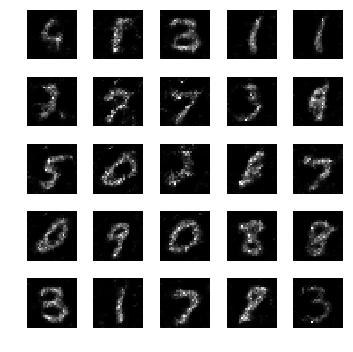

epoch: 931, time: 5.034530 | train_G_Loss: 0.450251, train_D_loss: 2.363467, train_acc: 0.917969
cv_G_Loss: 0.550865, cv_D_loss: 2.501012, cv_acc: 0.885600

epoch: 932, time: 4.982028 | train_G_Loss: 0.378110, train_D_loss: 2.332784, train_acc: 0.943359
cv_G_Loss: 1.953414, cv_D_loss: 4.615580, cv_acc: 0.911000

epoch: 933, time: 4.990562 | train_G_Loss: 0.349005, train_D_loss: 2.336249, train_acc: 0.957031
cv_G_Loss: 0.794093, cv_D_loss: 2.763033, cv_acc: 0.894600

epoch: 934, time: 4.993412 | train_G_Loss: 0.295779, train_D_loss: 2.561524, train_acc: 0.933594
cv_G_Loss: 1.174871, cv_D_loss: 2.939293, cv_acc: 0.915200

epoch: 935, time: 4.977602 | train_G_Loss: 0.424599, train_D_loss: 2.256144, train_acc: 0.906250
cv_G_Loss: 0.707153, cv_D_loss: 2.515014, cv_acc: 0.916400

epoch: 936, time: 4.980237 | train_G_Loss: 0.474642, train_D_loss: 2.417114, train_acc: 0.904297
cv_G_Loss: 0.342406, cv_D_loss: 3.103137, cv_acc: 0.720600

epoch: 937, time: 4.983734 | train_G_Loss: 0.363160, train

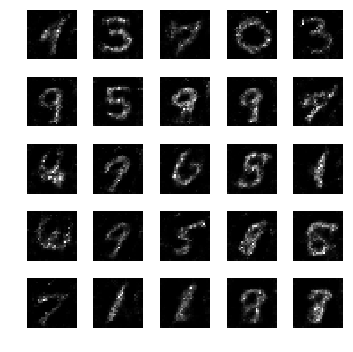

epoch: 941, time: 5.011301 | train_G_Loss: 0.409840, train_D_loss: 2.210870, train_acc: 0.900391
cv_G_Loss: 0.245371, cv_D_loss: 2.486160, cv_acc: 0.902600

epoch: 942, time: 4.989681 | train_G_Loss: 0.387416, train_D_loss: 2.434079, train_acc: 0.896484
cv_G_Loss: 1.543984, cv_D_loss: 3.679410, cv_acc: 0.915500

epoch: 943, time: 4.976251 | train_G_Loss: 0.383497, train_D_loss: 2.544782, train_acc: 0.929688
cv_G_Loss: 0.452564, cv_D_loss: 2.546710, cv_acc: 0.853600

epoch: 944, time: 4.994827 | train_G_Loss: 0.410992, train_D_loss: 2.470380, train_acc: 0.925781
cv_G_Loss: 0.577512, cv_D_loss: 2.810334, cv_acc: 0.765100

epoch: 945, time: 4.986992 | train_G_Loss: 0.484217, train_D_loss: 2.177455, train_acc: 0.939453
cv_G_Loss: 0.148111, cv_D_loss: 3.222110, cv_acc: 0.778600

epoch: 946, time: 5.006083 | train_G_Loss: 0.413730, train_D_loss: 2.215786, train_acc: 0.917969
cv_G_Loss: 0.099868, cv_D_loss: 3.081169, cv_acc: 0.897700

epoch: 947, time: 4.998045 | train_G_Loss: 0.431731, train

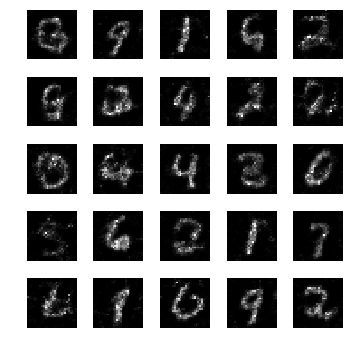

epoch: 951, time: 5.010743 | train_G_Loss: 0.352086, train_D_loss: 2.337058, train_acc: 0.906250
cv_G_Loss: 0.355382, cv_D_loss: 2.829897, cv_acc: 0.801100

epoch: 952, time: 4.980614 | train_G_Loss: 0.283738, train_D_loss: 2.677550, train_acc: 0.894531
cv_G_Loss: 0.407196, cv_D_loss: 3.019058, cv_acc: 0.728800

epoch: 953, time: 4.980487 | train_G_Loss: 0.529298, train_D_loss: 2.487107, train_acc: 0.921875
cv_G_Loss: 1.037206, cv_D_loss: 2.925766, cv_acc: 0.915500

epoch: 954, time: 4.992851 | train_G_Loss: 0.356187, train_D_loss: 2.596833, train_acc: 0.882812
cv_G_Loss: 0.643433, cv_D_loss: 2.425628, cv_acc: 0.901700

epoch: 955, time: 4.990622 | train_G_Loss: 0.431685, train_D_loss: 2.397644, train_acc: 0.886719
cv_G_Loss: 1.692175, cv_D_loss: 4.143535, cv_acc: 0.875400

epoch: 956, time: 4.982499 | train_G_Loss: 0.467790, train_D_loss: 2.371374, train_acc: 0.886719
cv_G_Loss: 1.238473, cv_D_loss: 3.527606, cv_acc: 0.832700

epoch: 957, time: 4.984857 | train_G_Loss: 0.381737, train

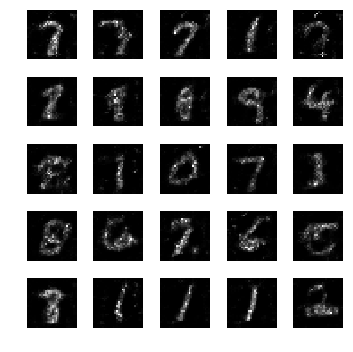

epoch: 961, time: 4.999501 | train_G_Loss: 0.339661, train_D_loss: 2.256833, train_acc: 0.882812
cv_G_Loss: 0.381443, cv_D_loss: 2.320870, cv_acc: 0.918000

epoch: 962, time: 4.967581 | train_G_Loss: 0.371985, train_D_loss: 2.516369, train_acc: 0.882812
cv_G_Loss: 0.608261, cv_D_loss: 2.504654, cv_acc: 0.902000

epoch: 963, time: 4.962537 | train_G_Loss: 0.471302, train_D_loss: 2.281610, train_acc: 0.933594
cv_G_Loss: 0.734286, cv_D_loss: 2.923259, cv_acc: 0.807600

epoch: 964, time: 4.964938 | train_G_Loss: 0.374318, train_D_loss: 2.297554, train_acc: 0.927734
cv_G_Loss: 0.283498, cv_D_loss: 2.476521, cv_acc: 0.901400

epoch: 965, time: 4.977648 | train_G_Loss: 0.440613, train_D_loss: 2.356647, train_acc: 0.912109
cv_G_Loss: 2.545976, cv_D_loss: 5.879017, cv_acc: 0.864700

epoch: 966, time: 4.970224 | train_G_Loss: 0.323532, train_D_loss: 2.723112, train_acc: 0.896484
cv_G_Loss: 1.293437, cv_D_loss: 3.464646, cv_acc: 0.898700

epoch: 967, time: 4.962799 | train_G_Loss: 0.392161, train

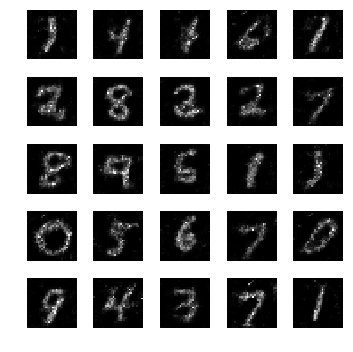

epoch: 971, time: 5.005494 | train_G_Loss: 0.381624, train_D_loss: 2.579725, train_acc: 0.914062
cv_G_Loss: 0.989596, cv_D_loss: 2.868867, cv_acc: 0.910900

epoch: 972, time: 4.974917 | train_G_Loss: 0.273761, train_D_loss: 2.419664, train_acc: 0.896484
cv_G_Loss: 0.152624, cv_D_loss: 2.706733, cv_acc: 0.912500

epoch: 973, time: 4.993150 | train_G_Loss: 0.384020, train_D_loss: 2.491191, train_acc: 0.927734
cv_G_Loss: 1.047692, cv_D_loss: 3.252545, cv_acc: 0.807800

epoch: 974, time: 4.989254 | train_G_Loss: 0.407538, train_D_loss: 2.276519, train_acc: 0.937500
cv_G_Loss: 0.848776, cv_D_loss: 2.724802, cv_acc: 0.904100

epoch: 975, time: 4.977362 | train_G_Loss: 0.491197, train_D_loss: 2.391739, train_acc: 0.929688
cv_G_Loss: 2.943923, cv_D_loss: 6.586320, cv_acc: 0.876900

epoch: 976, time: 4.975549 | train_G_Loss: 0.403173, train_D_loss: 2.491086, train_acc: 0.945312
cv_G_Loss: 0.876930, cv_D_loss: 2.807262, cv_acc: 0.901300

epoch: 977, time: 4.991091 | train_G_Loss: 0.367800, train

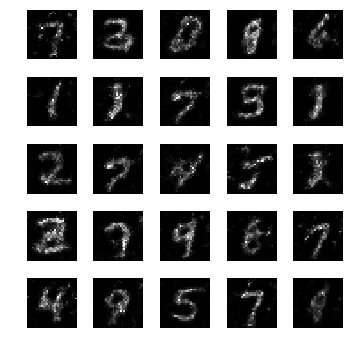

epoch: 981, time: 4.991333 | train_G_Loss: 0.457502, train_D_loss: 2.704411, train_acc: 0.927734
cv_G_Loss: 0.660603, cv_D_loss: 3.222703, cv_acc: 0.740700

epoch: 982, time: 4.955762 | train_G_Loss: 0.478035, train_D_loss: 2.148851, train_acc: 0.910156
cv_G_Loss: 0.251193, cv_D_loss: 2.668981, cv_acc: 0.860500

epoch: 983, time: 4.952372 | train_G_Loss: 0.408675, train_D_loss: 2.326590, train_acc: 0.908203
cv_G_Loss: 0.161616, cv_D_loss: 2.677612, cv_acc: 0.914700

epoch: 984, time: 4.944978 | train_G_Loss: 0.400063, train_D_loss: 2.319770, train_acc: 0.931641
cv_G_Loss: 0.368809, cv_D_loss: 2.770214, cv_acc: 0.818200

epoch: 985, time: 4.971633 | train_G_Loss: 0.349148, train_D_loss: 2.499191, train_acc: 0.939453
cv_G_Loss: 0.207643, cv_D_loss: 2.794246, cv_acc: 0.865200

epoch: 986, time: 4.965693 | train_G_Loss: 0.371795, train_D_loss: 2.310814, train_acc: 0.933594
cv_G_Loss: 0.084071, cv_D_loss: 3.134136, cv_acc: 0.917600

epoch: 987, time: 4.958009 | train_G_Loss: 0.473524, train

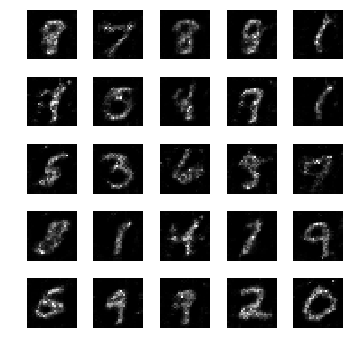

epoch: 991, time: 4.981274 | train_G_Loss: 0.364542, train_D_loss: 2.225272, train_acc: 0.929688
cv_G_Loss: 0.187745, cv_D_loss: 2.571538, cv_acc: 0.908500

epoch: 992, time: 4.949777 | train_G_Loss: 0.378494, train_D_loss: 2.272808, train_acc: 0.910156
cv_G_Loss: 1.235433, cv_D_loss: 3.366581, cv_acc: 0.891400

epoch: 993, time: 4.945043 | train_G_Loss: 0.398773, train_D_loss: 2.622333, train_acc: 0.914062
cv_G_Loss: 0.429139, cv_D_loss: 2.389626, cv_acc: 0.907800

epoch: 994, time: 4.962091 | train_G_Loss: 0.316025, train_D_loss: 2.226531, train_acc: 0.914062
cv_G_Loss: 0.787607, cv_D_loss: 2.719990, cv_acc: 0.895700

epoch: 995, time: 4.952640 | train_G_Loss: 0.415832, train_D_loss: 2.171436, train_acc: 0.902344
cv_G_Loss: 0.229026, cv_D_loss: 2.539917, cv_acc: 0.910200

epoch: 996, time: 4.951895 | train_G_Loss: 0.397834, train_D_loss: 2.632855, train_acc: 0.890625
cv_G_Loss: 0.314280, cv_D_loss: 2.714753, cv_acc: 0.851400

epoch: 997, time: 4.947305 | train_G_Loss: 0.433428, train

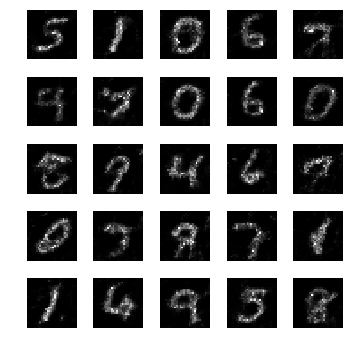

epoch: 1001, time: 4.976250 | train_G_Loss: 0.433864, train_D_loss: 2.152212, train_acc: 0.919922
cv_G_Loss: 3.180795, cv_D_loss: 7.040516, cv_acc: 0.893200

epoch: 1002, time: 4.944152 | train_G_Loss: 0.290136, train_D_loss: 2.783540, train_acc: 0.888672
cv_G_Loss: 2.126382, cv_D_loss: 5.027318, cv_acc: 0.904300

epoch: 1003, time: 4.940266 | train_G_Loss: 0.437053, train_D_loss: 2.265949, train_acc: 0.917969
cv_G_Loss: 1.824088, cv_D_loss: 4.392241, cv_acc: 0.873300

epoch: 1004, time: 4.955425 | train_G_Loss: 0.448796, train_D_loss: 2.120522, train_acc: 0.917969
cv_G_Loss: 0.671585, cv_D_loss: 2.605030, cv_acc: 0.903000

epoch: 1005, time: 4.960145 | train_G_Loss: 0.470861, train_D_loss: 2.256608, train_acc: 0.931641
cv_G_Loss: 0.515168, cv_D_loss: 2.460500, cv_acc: 0.898400

epoch: 1006, time: 4.954419 | train_G_Loss: 0.560165, train_D_loss: 2.119018, train_acc: 0.929688
cv_G_Loss: 1.653831, cv_D_loss: 4.435470, cv_acc: 0.678400

epoch: 1007, time: 4.955763 | train_G_Loss: 0.367814

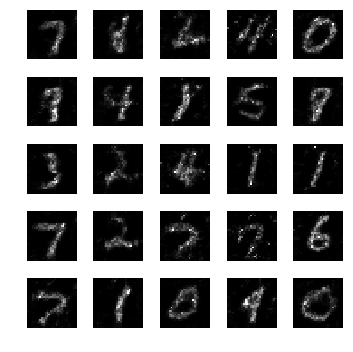

epoch: 1011, time: 4.980708 | train_G_Loss: 0.505830, train_D_loss: 2.459156, train_acc: 0.904297
cv_G_Loss: 0.678048, cv_D_loss: 2.815246, cv_acc: 0.816600

epoch: 1012, time: 4.950318 | train_G_Loss: 0.367754, train_D_loss: 2.319961, train_acc: 0.923828
cv_G_Loss: 0.208331, cv_D_loss: 2.545849, cv_acc: 0.912800

epoch: 1013, time: 4.944887 | train_G_Loss: 0.405558, train_D_loss: 2.306696, train_acc: 0.896484
cv_G_Loss: 0.460051, cv_D_loss: 2.398878, cv_acc: 0.912700

epoch: 1014, time: 4.997896 | train_G_Loss: 0.442299, train_D_loss: 2.339438, train_acc: 0.912109
cv_G_Loss: 1.472331, cv_D_loss: 3.630645, cv_acc: 0.899900

epoch: 1015, time: 4.954102 | train_G_Loss: 0.390244, train_D_loss: 2.270770, train_acc: 0.910156
cv_G_Loss: 2.042281, cv_D_loss: 4.872046, cv_acc: 0.900300

epoch: 1016, time: 4.964411 | train_G_Loss: 0.319997, train_D_loss: 2.488572, train_acc: 0.898438
cv_G_Loss: 0.611747, cv_D_loss: 2.428723, cv_acc: 0.919000

epoch: 1017, time: 4.954407 | train_G_Loss: 0.420709

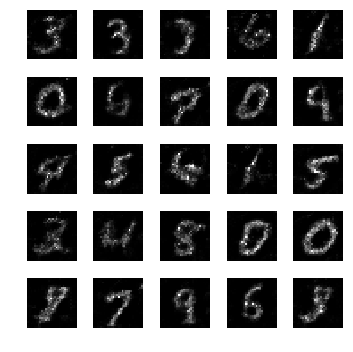

epoch: 1021, time: 4.980434 | train_G_Loss: 0.361871, train_D_loss: 2.535041, train_acc: 0.865234
cv_G_Loss: 0.238023, cv_D_loss: 2.445728, cv_acc: 0.923100

epoch: 1022, time: 4.951779 | train_G_Loss: 0.423753, train_D_loss: 2.318947, train_acc: 0.890625
cv_G_Loss: 0.492822, cv_D_loss: 2.495873, cv_acc: 0.886400

epoch: 1023, time: 4.936739 | train_G_Loss: 0.490772, train_D_loss: 2.200532, train_acc: 0.937500
cv_G_Loss: 1.983287, cv_D_loss: 4.665426, cv_acc: 0.863400

epoch: 1024, time: 4.966466 | train_G_Loss: 0.338681, train_D_loss: 2.282432, train_acc: 0.941406
cv_G_Loss: 0.549820, cv_D_loss: 2.397676, cv_acc: 0.907800

epoch: 1025, time: 4.962413 | train_G_Loss: 0.409569, train_D_loss: 2.348741, train_acc: 0.919922
cv_G_Loss: 0.894615, cv_D_loss: 2.695765, cv_acc: 0.918700

epoch: 1026, time: 4.959630 | train_G_Loss: 0.301175, train_D_loss: 2.331683, train_acc: 0.943359
cv_G_Loss: 0.424969, cv_D_loss: 2.381902, cv_acc: 0.913600

epoch: 1027, time: 4.954162 | train_G_Loss: 0.337917

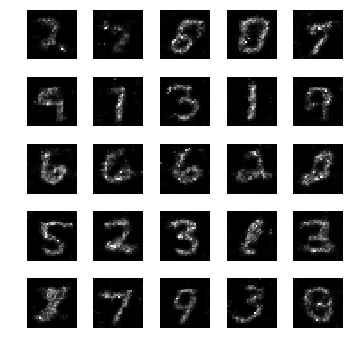

epoch: 1031, time: 4.983549 | train_G_Loss: 0.413793, train_D_loss: 2.198015, train_acc: 0.937500
cv_G_Loss: 0.203123, cv_D_loss: 2.566134, cv_acc: 0.913300

epoch: 1032, time: 4.961389 | train_G_Loss: 0.421082, train_D_loss: 2.200780, train_acc: 0.933594
cv_G_Loss: 0.569012, cv_D_loss: 2.480860, cv_acc: 0.897200

epoch: 1033, time: 4.965043 | train_G_Loss: 0.479348, train_D_loss: 2.107410, train_acc: 0.927734
cv_G_Loss: 3.169168, cv_D_loss: 7.112449, cv_acc: 0.849900

epoch: 1034, time: 4.946869 | train_G_Loss: 0.419596, train_D_loss: 2.298616, train_acc: 0.912109
cv_G_Loss: 1.103748, cv_D_loss: 3.284444, cv_acc: 0.851400

epoch: 1035, time: 4.950290 | train_G_Loss: 0.324359, train_D_loss: 2.351271, train_acc: 0.925781
cv_G_Loss: 0.423269, cv_D_loss: 2.363886, cv_acc: 0.914400

epoch: 1036, time: 4.954046 | train_G_Loss: 0.392936, train_D_loss: 2.370236, train_acc: 0.923828
cv_G_Loss: 0.708504, cv_D_loss: 2.966962, cv_acc: 0.818500

epoch: 1037, time: 4.974172 | train_G_Loss: 0.414387

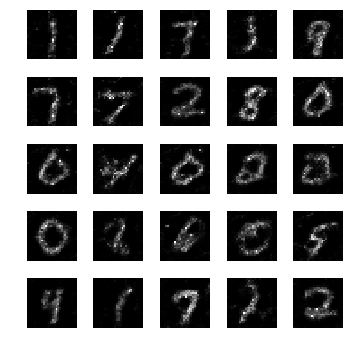

epoch: 1041, time: 4.962858 | train_G_Loss: 0.343759, train_D_loss: 2.377529, train_acc: 0.927734
cv_G_Loss: 0.055492, cv_D_loss: 3.547483, cv_acc: 0.892900

epoch: 1042, time: 4.963202 | train_G_Loss: 0.485621, train_D_loss: 2.366979, train_acc: 0.910156
cv_G_Loss: 2.193330, cv_D_loss: 5.114795, cv_acc: 0.849100

epoch: 1043, time: 4.954281 | train_G_Loss: 0.362369, train_D_loss: 2.511052, train_acc: 0.923828
cv_G_Loss: 0.380470, cv_D_loss: 2.516800, cv_acc: 0.904800

epoch: 1044, time: 4.958064 | train_G_Loss: 0.449330, train_D_loss: 2.086809, train_acc: 0.951172
cv_G_Loss: 2.648660, cv_D_loss: 5.691514, cv_acc: 0.897900

epoch: 1045, time: 4.949804 | train_G_Loss: 0.349390, train_D_loss: 2.285155, train_acc: 0.914062
cv_G_Loss: 1.440385, cv_D_loss: 3.765770, cv_acc: 0.905600

epoch: 1046, time: 4.946572 | train_G_Loss: 0.349048, train_D_loss: 2.722064, train_acc: 0.919922
cv_G_Loss: 0.700190, cv_D_loss: 2.585689, cv_acc: 0.906600

epoch: 1047, time: 4.958485 | train_G_Loss: 0.404518

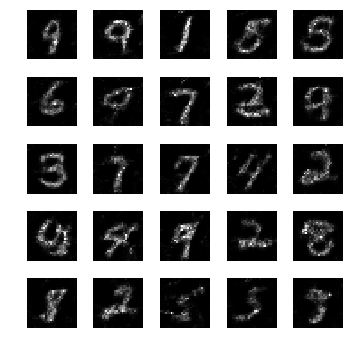

epoch: 1051, time: 4.994908 | train_G_Loss: 0.371955, train_D_loss: 2.237693, train_acc: 0.902344
cv_G_Loss: 1.169773, cv_D_loss: 3.436620, cv_acc: 0.822900

epoch: 1052, time: 4.951968 | train_G_Loss: 0.345616, train_D_loss: 2.298559, train_acc: 0.906250
cv_G_Loss: 2.015491, cv_D_loss: 4.750074, cv_acc: 0.839900

epoch: 1053, time: 4.963166 | train_G_Loss: 0.320119, train_D_loss: 2.334284, train_acc: 0.935547
cv_G_Loss: 0.625669, cv_D_loss: 2.480901, cv_acc: 0.919200

epoch: 1054, time: 4.958109 | train_G_Loss: 0.331824, train_D_loss: 2.576585, train_acc: 0.917969
cv_G_Loss: 0.580770, cv_D_loss: 2.773976, cv_acc: 0.835400

epoch: 1055, time: 4.948372 | train_G_Loss: 0.440671, train_D_loss: 2.230305, train_acc: 0.906250
cv_G_Loss: 0.340130, cv_D_loss: 2.450406, cv_acc: 0.900100

epoch: 1056, time: 4.945888 | train_G_Loss: 0.449285, train_D_loss: 2.470821, train_acc: 0.917969
cv_G_Loss: 0.374481, cv_D_loss: 2.549226, cv_acc: 0.889400

epoch: 1057, time: 4.958651 | train_G_Loss: 0.407161

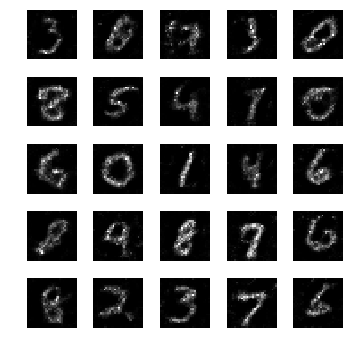

epoch: 1061, time: 5.018103 | train_G_Loss: 0.353489, train_D_loss: 2.285688, train_acc: 0.919922
cv_G_Loss: 1.137080, cv_D_loss: 3.150082, cv_acc: 0.916900

epoch: 1062, time: 4.991728 | train_G_Loss: 0.450094, train_D_loss: 2.343765, train_acc: 0.941406
cv_G_Loss: 0.968408, cv_D_loss: 2.907718, cv_acc: 0.912000

epoch: 1063, time: 4.985993 | train_G_Loss: 0.402543, train_D_loss: 2.459954, train_acc: 0.941406
cv_G_Loss: 1.171158, cv_D_loss: 3.251833, cv_acc: 0.906400

epoch: 1064, time: 4.978152 | train_G_Loss: 0.365913, train_D_loss: 2.308277, train_acc: 0.906250
cv_G_Loss: 0.405723, cv_D_loss: 2.546652, cv_acc: 0.865200

epoch: 1065, time: 4.987156 | train_G_Loss: 0.391707, train_D_loss: 2.804592, train_acc: 0.916016
cv_G_Loss: 1.141049, cv_D_loss: 3.332189, cv_acc: 0.862900

epoch: 1066, time: 4.984441 | train_G_Loss: 0.439389, train_D_loss: 2.113284, train_acc: 0.906250
cv_G_Loss: 1.150165, cv_D_loss: 3.347034, cv_acc: 0.855500

epoch: 1067, time: 4.985603 | train_G_Loss: 0.444054

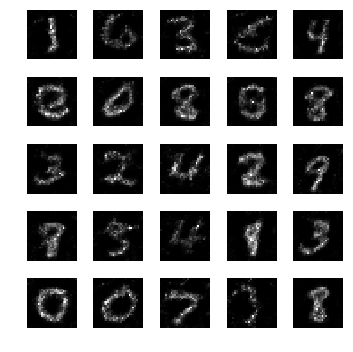

epoch: 1071, time: 5.016422 | train_G_Loss: 0.363008, train_D_loss: 2.339162, train_acc: 0.902344
cv_G_Loss: 0.696450, cv_D_loss: 2.935386, cv_acc: 0.848800

epoch: 1072, time: 4.972205 | train_G_Loss: 0.399663, train_D_loss: 2.127501, train_acc: 0.910156
cv_G_Loss: 0.661109, cv_D_loss: 3.088774, cv_acc: 0.763900

epoch: 1073, time: 4.984037 | train_G_Loss: 0.365001, train_D_loss: 2.321169, train_acc: 0.912109
cv_G_Loss: 0.347629, cv_D_loss: 2.521130, cv_acc: 0.898800

epoch: 1074, time: 4.981838 | train_G_Loss: 0.529568, train_D_loss: 2.246104, train_acc: 0.931641
cv_G_Loss: 1.673108, cv_D_loss: 4.241773, cv_acc: 0.856000

epoch: 1075, time: 4.978180 | train_G_Loss: 0.395093, train_D_loss: 2.244575, train_acc: 0.937500
cv_G_Loss: 2.316771, cv_D_loss: 5.557039, cv_acc: 0.796500

epoch: 1076, time: 4.987773 | train_G_Loss: 0.429444, train_D_loss: 2.313679, train_acc: 0.927734
cv_G_Loss: 1.844209, cv_D_loss: 4.506804, cv_acc: 0.892300

epoch: 1077, time: 4.985910 | train_G_Loss: 0.428566

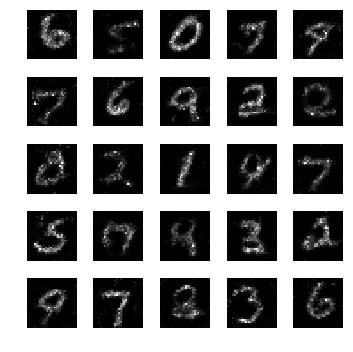

epoch: 1081, time: 5.025177 | train_G_Loss: 0.434949, train_D_loss: 2.320418, train_acc: 0.933594
cv_G_Loss: 1.042618, cv_D_loss: 3.338369, cv_acc: 0.855600

epoch: 1082, time: 4.983006 | train_G_Loss: 0.370234, train_D_loss: 2.282256, train_acc: 0.919922
cv_G_Loss: 0.972507, cv_D_loss: 2.941666, cv_acc: 0.917600

epoch: 1083, time: 4.979282 | train_G_Loss: 0.318364, train_D_loss: 2.682281, train_acc: 0.904297
cv_G_Loss: 0.372580, cv_D_loss: 2.367588, cv_acc: 0.917000

epoch: 1084, time: 4.995305 | train_G_Loss: 0.486748, train_D_loss: 2.143462, train_acc: 0.931641
cv_G_Loss: 0.689599, cv_D_loss: 2.617682, cv_acc: 0.908300

epoch: 1085, time: 4.993363 | train_G_Loss: 0.385904, train_D_loss: 2.116057, train_acc: 0.931641
cv_G_Loss: 1.087222, cv_D_loss: 2.998250, cv_acc: 0.922200

epoch: 1086, time: 4.988977 | train_G_Loss: 0.454090, train_D_loss: 2.398679, train_acc: 0.933594
cv_G_Loss: 0.765768, cv_D_loss: 2.915992, cv_acc: 0.856200

epoch: 1087, time: 4.992689 | train_G_Loss: 0.288250

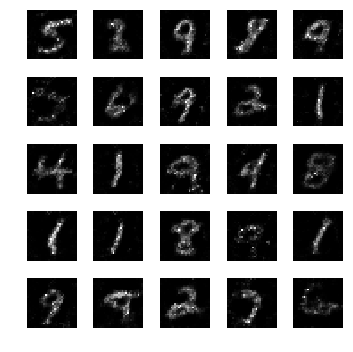

epoch: 1091, time: 4.996421 | train_G_Loss: 0.352488, train_D_loss: 2.687068, train_acc: 0.892578
cv_G_Loss: 1.081747, cv_D_loss: 3.184212, cv_acc: 0.906300

epoch: 1092, time: 4.959688 | train_G_Loss: 0.360745, train_D_loss: 2.630943, train_acc: 0.937500
cv_G_Loss: 1.584660, cv_D_loss: 4.006130, cv_acc: 0.908800

epoch: 1093, time: 4.965372 | train_G_Loss: 0.435234, train_D_loss: 2.159539, train_acc: 0.935547
cv_G_Loss: 1.360778, cv_D_loss: 3.514953, cv_acc: 0.917100

epoch: 1094, time: 4.951193 | train_G_Loss: 0.442237, train_D_loss: 2.214910, train_acc: 0.914062
cv_G_Loss: 0.754507, cv_D_loss: 2.623384, cv_acc: 0.907300

epoch: 1095, time: 4.966463 | train_G_Loss: 0.549249, train_D_loss: 2.349262, train_acc: 0.927734
cv_G_Loss: 1.535253, cv_D_loss: 3.926920, cv_acc: 0.912100

epoch: 1096, time: 4.948927 | train_G_Loss: 0.372508, train_D_loss: 2.029611, train_acc: 0.945312
cv_G_Loss: 2.913942, cv_D_loss: 6.441654, cv_acc: 0.901800

epoch: 1097, time: 4.976261 | train_G_Loss: 0.524531

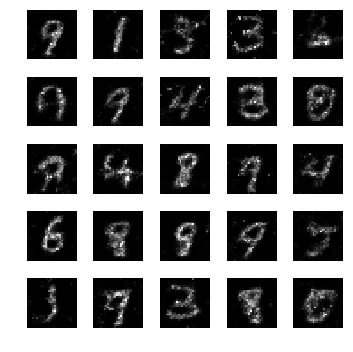

epoch: 1101, time: 4.979617 | train_G_Loss: 0.411410, train_D_loss: 2.172951, train_acc: 0.945312
cv_G_Loss: 0.605450, cv_D_loss: 2.631041, cv_acc: 0.898300

epoch: 1102, time: 4.953838 | train_G_Loss: 0.377534, train_D_loss: 2.120963, train_acc: 0.935547
cv_G_Loss: 0.870646, cv_D_loss: 2.864608, cv_acc: 0.909100

epoch: 1103, time: 4.956383 | train_G_Loss: 0.343526, train_D_loss: 2.204233, train_acc: 0.927734
cv_G_Loss: 0.440658, cv_D_loss: 2.482392, cv_acc: 0.909300

epoch: 1104, time: 4.982278 | train_G_Loss: 0.461510, train_D_loss: 2.219946, train_acc: 0.923828
cv_G_Loss: 0.406003, cv_D_loss: 2.480449, cv_acc: 0.889700

epoch: 1105, time: 4.954010 | train_G_Loss: 0.418183, train_D_loss: 2.322219, train_acc: 0.929688
cv_G_Loss: 0.640353, cv_D_loss: 2.584649, cv_acc: 0.908200

epoch: 1106, time: 4.957759 | train_G_Loss: 0.396703, train_D_loss: 2.201887, train_acc: 0.916016
cv_G_Loss: 0.243383, cv_D_loss: 2.505820, cv_acc: 0.914700

epoch: 1107, time: 4.971044 | train_G_Loss: 0.415149

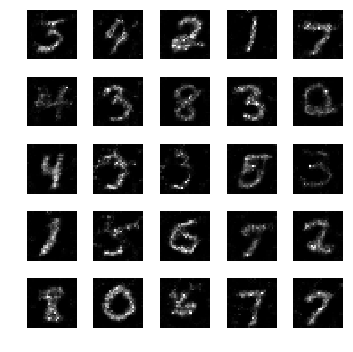

epoch: 1111, time: 4.971868 | train_G_Loss: 0.399894, train_D_loss: 2.517374, train_acc: 0.974609
cv_G_Loss: 0.733842, cv_D_loss: 2.541049, cv_acc: 0.927900
Model saved

epoch: 1112, time: 5.030535 | train_G_Loss: 0.422834, train_D_loss: 2.043563, train_acc: 0.962891
cv_G_Loss: 0.512674, cv_D_loss: 2.453926, cv_acc: 0.905200

epoch: 1113, time: 4.986089 | train_G_Loss: 0.377792, train_D_loss: 2.121197, train_acc: 0.935547
cv_G_Loss: 0.224924, cv_D_loss: 2.517697, cv_acc: 0.911200

epoch: 1114, time: 4.980484 | train_G_Loss: 0.477566, train_D_loss: 2.023128, train_acc: 0.945312
cv_G_Loss: 0.920243, cv_D_loss: 3.408185, cv_acc: 0.734100

epoch: 1115, time: 4.982036 | train_G_Loss: 0.482499, train_D_loss: 2.265108, train_acc: 0.937500
cv_G_Loss: 1.257213, cv_D_loss: 3.402021, cv_acc: 0.900300

epoch: 1116, time: 4.978496 | train_G_Loss: 0.433194, train_D_loss: 2.421355, train_acc: 0.919922
cv_G_Loss: 2.420284, cv_D_loss: 5.476589, cv_acc: 0.837000

epoch: 1117, time: 4.974415 | train_G_Lo

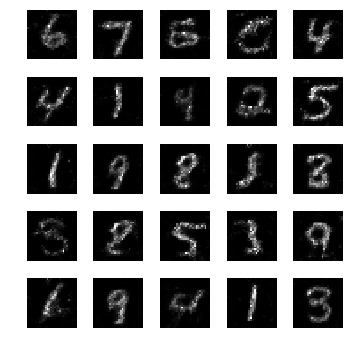

epoch: 1121, time: 5.004719 | train_G_Loss: 0.405864, train_D_loss: 2.279879, train_acc: 0.906250
cv_G_Loss: 3.912995, cv_D_loss: 8.517301, cv_acc: 0.885300

epoch: 1122, time: 4.995075 | train_G_Loss: 0.373103, train_D_loss: 2.653274, train_acc: 0.896484
cv_G_Loss: 1.676740, cv_D_loss: 4.249951, cv_acc: 0.877700

epoch: 1123, time: 4.982224 | train_G_Loss: 0.386036, train_D_loss: 2.554423, train_acc: 0.914062
cv_G_Loss: 0.386874, cv_D_loss: 2.357745, cv_acc: 0.922500

epoch: 1124, time: 4.978925 | train_G_Loss: 0.425353, train_D_loss: 2.261381, train_acc: 0.917969
cv_G_Loss: 0.671828, cv_D_loss: 2.606797, cv_acc: 0.901700

epoch: 1125, time: 4.993972 | train_G_Loss: 0.302300, train_D_loss: 2.488076, train_acc: 0.925781
cv_G_Loss: 0.427353, cv_D_loss: 2.530755, cv_acc: 0.895500

epoch: 1126, time: 5.011191 | train_G_Loss: 0.467632, train_D_loss: 2.280372, train_acc: 0.919922
cv_G_Loss: 1.935261, cv_D_loss: 4.842730, cv_acc: 0.828500

epoch: 1127, time: 5.005766 | train_G_Loss: 0.331683

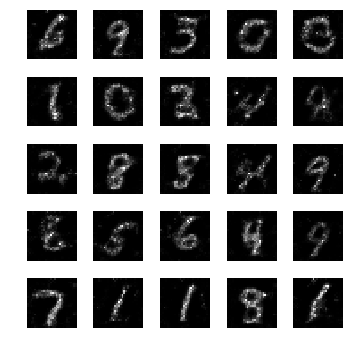

epoch: 1131, time: 5.011404 | train_G_Loss: 0.377841, train_D_loss: 2.284253, train_acc: 0.937500
cv_G_Loss: 0.656532, cv_D_loss: 3.250165, cv_acc: 0.751000

epoch: 1132, time: 4.989947 | train_G_Loss: 0.454447, train_D_loss: 2.316807, train_acc: 0.923828
cv_G_Loss: 0.832196, cv_D_loss: 2.745214, cv_acc: 0.912300

epoch: 1133, time: 4.986953 | train_G_Loss: 0.461594, train_D_loss: 2.132099, train_acc: 0.943359
cv_G_Loss: 0.635047, cv_D_loss: 2.482893, cv_acc: 0.921700

epoch: 1134, time: 4.998492 | train_G_Loss: 0.400564, train_D_loss: 2.148015, train_acc: 0.964844
cv_G_Loss: 1.074862, cv_D_loss: 3.127893, cv_acc: 0.891000

epoch: 1135, time: 4.994861 | train_G_Loss: 0.359658, train_D_loss: 2.563573, train_acc: 0.955078
cv_G_Loss: 0.754535, cv_D_loss: 2.911313, cv_acc: 0.749800

epoch: 1136, time: 5.000026 | train_G_Loss: 0.505061, train_D_loss: 2.114434, train_acc: 0.949219
cv_G_Loss: 0.742098, cv_D_loss: 2.882598, cv_acc: 0.867100

epoch: 1137, time: 4.979667 | train_G_Loss: 0.366059

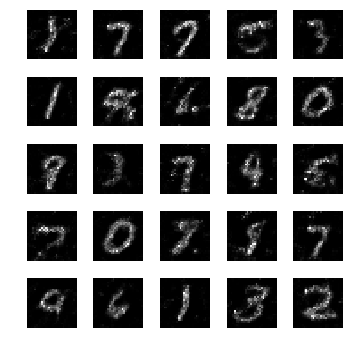

epoch: 1141, time: 4.998053 | train_G_Loss: 0.456981, train_D_loss: 2.149890, train_acc: 0.916016
cv_G_Loss: 2.078544, cv_D_loss: 4.861385, cv_acc: 0.919300

epoch: 1142, time: 5.007245 | train_G_Loss: 0.424787, train_D_loss: 2.403913, train_acc: 0.906250
cv_G_Loss: 0.472053, cv_D_loss: 2.486786, cv_acc: 0.906600

epoch: 1143, time: 4.991474 | train_G_Loss: 0.273435, train_D_loss: 2.487674, train_acc: 0.927734
cv_G_Loss: 0.629245, cv_D_loss: 2.522584, cv_acc: 0.908800

epoch: 1144, time: 4.997206 | train_G_Loss: 0.379160, train_D_loss: 2.215306, train_acc: 0.921875
cv_G_Loss: 0.571717, cv_D_loss: 2.386343, cv_acc: 0.929200
Model saved

epoch: 1145, time: 5.011782 | train_G_Loss: 0.457001, train_D_loss: 2.432806, train_acc: 0.902344
cv_G_Loss: 4.044891, cv_D_loss: 8.959100, cv_acc: 0.750600

epoch: 1146, time: 4.984111 | train_G_Loss: 0.431984, train_D_loss: 2.358012, train_acc: 0.904297
cv_G_Loss: 1.762600, cv_D_loss: 4.315131, cv_acc: 0.906800

epoch: 1147, time: 4.983297 | train_G_Lo

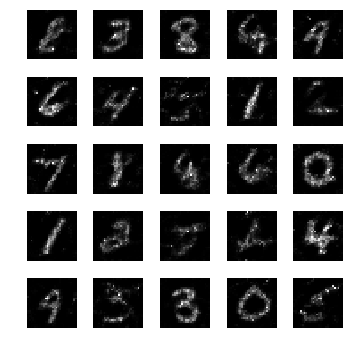

epoch: 1151, time: 5.005786 | train_G_Loss: 0.549901, train_D_loss: 2.467641, train_acc: 0.910156
cv_G_Loss: 0.866397, cv_D_loss: 2.968997, cv_acc: 0.902200

epoch: 1152, time: 4.990222 | train_G_Loss: 0.386737, train_D_loss: 2.434861, train_acc: 0.917969
cv_G_Loss: 2.906371, cv_D_loss: 6.381486, cv_acc: 0.908100

epoch: 1153, time: 4.983827 | train_G_Loss: 0.392421, train_D_loss: 2.239565, train_acc: 0.945312
cv_G_Loss: 2.763039, cv_D_loss: 6.259484, cv_acc: 0.729200

epoch: 1154, time: 4.990016 | train_G_Loss: 0.326224, train_D_loss: 2.428432, train_acc: 0.937500
cv_G_Loss: 1.350014, cv_D_loss: 3.620702, cv_acc: 0.905700

epoch: 1155, time: 5.000750 | train_G_Loss: 0.334537, train_D_loss: 2.443147, train_acc: 0.916016
cv_G_Loss: 0.366363, cv_D_loss: 2.307769, cv_acc: 0.927000

epoch: 1156, time: 4.990120 | train_G_Loss: 0.436664, train_D_loss: 2.394331, train_acc: 0.923828
cv_G_Loss: 0.652747, cv_D_loss: 2.480016, cv_acc: 0.928700

epoch: 1157, time: 4.988021 | train_G_Loss: 0.418414

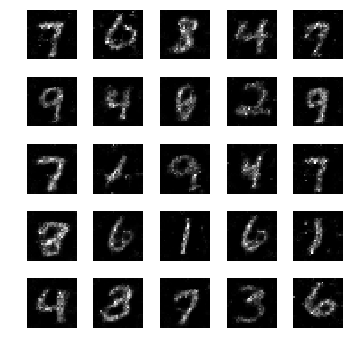

epoch: 1161, time: 5.027984 | train_G_Loss: 0.369884, train_D_loss: 2.254614, train_acc: 0.939453
cv_G_Loss: 2.201211, cv_D_loss: 5.277173, cv_acc: 0.861400

epoch: 1162, time: 4.995138 | train_G_Loss: 0.325854, train_D_loss: 2.195655, train_acc: 0.947266
cv_G_Loss: 2.209567, cv_D_loss: 5.248503, cv_acc: 0.845100

epoch: 1163, time: 4.989365 | train_G_Loss: 0.428435, train_D_loss: 2.295854, train_acc: 0.929688
cv_G_Loss: 0.282062, cv_D_loss: 2.397795, cv_acc: 0.921500

epoch: 1164, time: 4.968229 | train_G_Loss: 0.361757, train_D_loss: 2.367343, train_acc: 0.919922
cv_G_Loss: 0.408235, cv_D_loss: 2.417487, cv_acc: 0.906200

epoch: 1165, time: 4.996974 | train_G_Loss: 0.421490, train_D_loss: 2.171624, train_acc: 0.943359
cv_G_Loss: 0.233526, cv_D_loss: 2.764791, cv_acc: 0.822900

epoch: 1166, time: 4.977664 | train_G_Loss: 0.381092, train_D_loss: 2.315772, train_acc: 0.923828
cv_G_Loss: 0.938595, cv_D_loss: 2.945148, cv_acc: 0.898600

epoch: 1167, time: 4.993848 | train_G_Loss: 0.369927

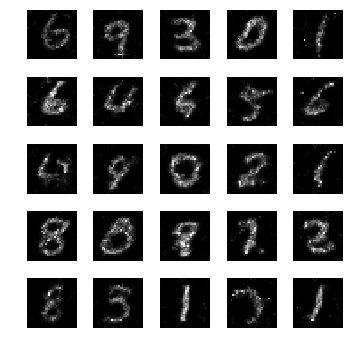

epoch: 1171, time: 5.041230 | train_G_Loss: 0.394105, train_D_loss: 2.252934, train_acc: 0.949219
cv_G_Loss: 1.596085, cv_D_loss: 3.875927, cv_acc: 0.921900

epoch: 1172, time: 4.983590 | train_G_Loss: 0.323898, train_D_loss: 2.307292, train_acc: 0.935547
cv_G_Loss: 0.198588, cv_D_loss: 2.694577, cv_acc: 0.897000

epoch: 1173, time: 4.995107 | train_G_Loss: 0.433075, train_D_loss: 2.169298, train_acc: 0.933594
cv_G_Loss: 0.353041, cv_D_loss: 2.353668, cv_acc: 0.918500

epoch: 1174, time: 4.988785 | train_G_Loss: 0.373910, train_D_loss: 2.255211, train_acc: 0.912109
cv_G_Loss: 0.730908, cv_D_loss: 2.626696, cv_acc: 0.904100

epoch: 1175, time: 4.980563 | train_G_Loss: 0.393518, train_D_loss: 2.478473, train_acc: 0.914062
cv_G_Loss: 0.662275, cv_D_loss: 2.534241, cv_acc: 0.923200

epoch: 1176, time: 4.985499 | train_G_Loss: 0.362764, train_D_loss: 2.304241, train_acc: 0.941406
cv_G_Loss: 1.143994, cv_D_loss: 3.095265, cv_acc: 0.922500

epoch: 1177, time: 4.996876 | train_G_Loss: 0.379239

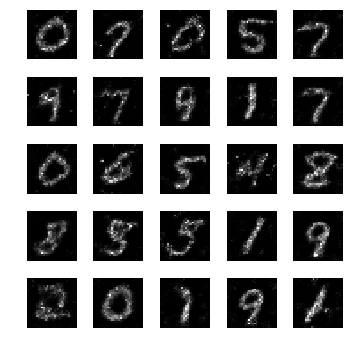

epoch: 1181, time: 5.017609 | train_G_Loss: 0.259457, train_D_loss: 2.510481, train_acc: 0.898438
cv_G_Loss: 0.444124, cv_D_loss: 2.376835, cv_acc: 0.915400

epoch: 1182, time: 4.989902 | train_G_Loss: 0.410815, train_D_loss: 2.259571, train_acc: 0.916016
cv_G_Loss: 0.712937, cv_D_loss: 2.747932, cv_acc: 0.885100

epoch: 1183, time: 5.005302 | train_G_Loss: 0.343606, train_D_loss: 2.283235, train_acc: 0.923828
cv_G_Loss: 0.364941, cv_D_loss: 2.480204, cv_acc: 0.878600

epoch: 1184, time: 4.982822 | train_G_Loss: 0.422916, train_D_loss: 2.164497, train_acc: 0.949219
cv_G_Loss: 0.753300, cv_D_loss: 2.735063, cv_acc: 0.892400

epoch: 1185, time: 4.997876 | train_G_Loss: 0.377387, train_D_loss: 2.541803, train_acc: 0.935547
cv_G_Loss: 1.174583, cv_D_loss: 3.278538, cv_acc: 0.896800

epoch: 1186, time: 4.992136 | train_G_Loss: 0.305797, train_D_loss: 2.199877, train_acc: 0.951172
cv_G_Loss: 0.367093, cv_D_loss: 2.343783, cv_acc: 0.917400

epoch: 1187, time: 4.998104 | train_G_Loss: 0.421117

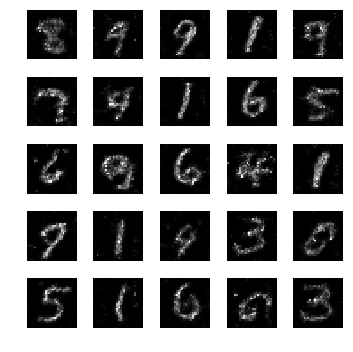

epoch: 1191, time: 5.007140 | train_G_Loss: 0.423742, train_D_loss: 2.275513, train_acc: 0.921875
cv_G_Loss: 0.971461, cv_D_loss: 3.032330, cv_acc: 0.917000

epoch: 1192, time: 4.984860 | train_G_Loss: 0.412425, train_D_loss: 2.191639, train_acc: 0.943359
cv_G_Loss: 0.269733, cv_D_loss: 2.892072, cv_acc: 0.786100

epoch: 1193, time: 4.979753 | train_G_Loss: 0.326622, train_D_loss: 2.099896, train_acc: 0.941406
cv_G_Loss: 0.533283, cv_D_loss: 2.458122, cv_acc: 0.905200

epoch: 1194, time: 5.003448 | train_G_Loss: 0.408989, train_D_loss: 2.148680, train_acc: 0.923828
cv_G_Loss: 1.634985, cv_D_loss: 4.304165, cv_acc: 0.756600

epoch: 1195, time: 4.985472 | train_G_Loss: 0.384957, train_D_loss: 2.233063, train_acc: 0.939453
cv_G_Loss: 1.527764, cv_D_loss: 3.943447, cv_acc: 0.892900

epoch: 1196, time: 4.985462 | train_G_Loss: 0.404414, train_D_loss: 2.113695, train_acc: 0.929688
cv_G_Loss: 0.383938, cv_D_loss: 2.326882, cv_acc: 0.922900

epoch: 1197, time: 4.988024 | train_G_Loss: 0.363610

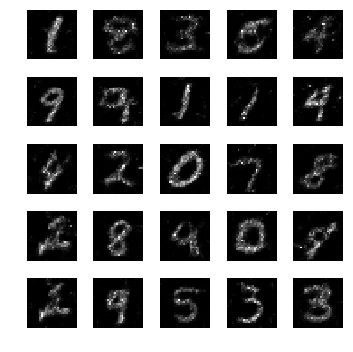

epoch: 1201, time: 5.005741 | train_G_Loss: 0.371704, train_D_loss: 2.188777, train_acc: 0.919922
cv_G_Loss: 0.317187, cv_D_loss: 2.781213, cv_acc: 0.763700

epoch: 1202, time: 4.987470 | train_G_Loss: 0.316613, train_D_loss: 2.368800, train_acc: 0.919922
cv_G_Loss: 0.267041, cv_D_loss: 2.421043, cv_acc: 0.913100

epoch: 1203, time: 4.989873 | train_G_Loss: 0.363973, train_D_loss: 2.551839, train_acc: 0.906250
cv_G_Loss: 0.646018, cv_D_loss: 2.585819, cv_acc: 0.901400

epoch: 1204, time: 4.981477 | train_G_Loss: 0.446128, train_D_loss: 2.363795, train_acc: 0.898438
cv_G_Loss: 0.889158, cv_D_loss: 2.844671, cv_acc: 0.914800

epoch: 1205, time: 4.996291 | train_G_Loss: 0.473122, train_D_loss: 2.233648, train_acc: 0.919922
cv_G_Loss: 0.723174, cv_D_loss: 2.728148, cv_acc: 0.892000

epoch: 1206, time: 4.994083 | train_G_Loss: 0.455617, train_D_loss: 2.257463, train_acc: 0.910156
cv_G_Loss: 0.932034, cv_D_loss: 2.725302, cv_acc: 0.930800
Model saved

epoch: 1207, time: 4.991323 | train_G_Lo

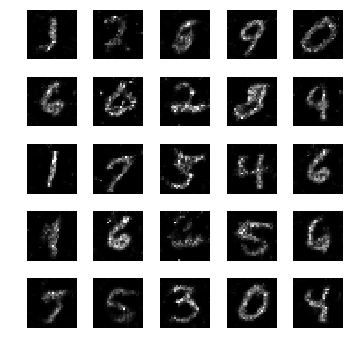

epoch: 1211, time: 4.983736 | train_G_Loss: 0.394099, train_D_loss: 2.327944, train_acc: 0.933594
cv_G_Loss: 0.651858, cv_D_loss: 2.488114, cv_acc: 0.911700

epoch: 1212, time: 4.961839 | train_G_Loss: 0.356029, train_D_loss: 2.162180, train_acc: 0.951172
cv_G_Loss: 1.058581, cv_D_loss: 3.130862, cv_acc: 0.917300

epoch: 1213, time: 4.962714 | train_G_Loss: 0.416181, train_D_loss: 2.152849, train_acc: 0.962891
cv_G_Loss: 0.225184, cv_D_loss: 2.513934, cv_acc: 0.920200

epoch: 1214, time: 4.949682 | train_G_Loss: 0.336026, train_D_loss: 2.176807, train_acc: 0.927734
cv_G_Loss: 1.168031, cv_D_loss: 3.383963, cv_acc: 0.883700

epoch: 1215, time: 4.951176 | train_G_Loss: 0.293365, train_D_loss: 2.520434, train_acc: 0.898438
cv_G_Loss: 0.566719, cv_D_loss: 2.414732, cv_acc: 0.909100

epoch: 1216, time: 4.977108 | train_G_Loss: 0.366976, train_D_loss: 2.354795, train_acc: 0.921875
cv_G_Loss: 0.445241, cv_D_loss: 2.337049, cv_acc: 0.921800

epoch: 1217, time: 4.965282 | train_G_Loss: 0.384340

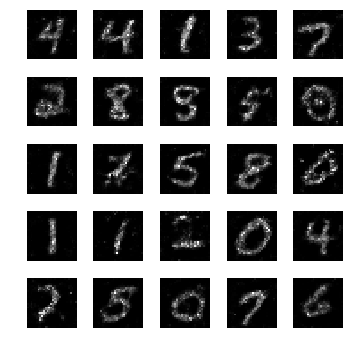

epoch: 1221, time: 4.984479 | train_G_Loss: 0.393202, train_D_loss: 2.396686, train_acc: 0.933594
cv_G_Loss: 0.482599, cv_D_loss: 2.476528, cv_acc: 0.878000

epoch: 1222, time: 4.956887 | train_G_Loss: 0.386654, train_D_loss: 2.226431, train_acc: 0.939453
cv_G_Loss: 1.492056, cv_D_loss: 4.300694, cv_acc: 0.784000

epoch: 1223, time: 4.960325 | train_G_Loss: 0.478474, train_D_loss: 2.176072, train_acc: 0.921875
cv_G_Loss: 2.506053, cv_D_loss: 5.655324, cv_acc: 0.912800

epoch: 1224, time: 4.947250 | train_G_Loss: 0.335523, train_D_loss: 2.406551, train_acc: 0.896484
cv_G_Loss: 0.913830, cv_D_loss: 2.897303, cv_acc: 0.922300

epoch: 1225, time: 4.953891 | train_G_Loss: 0.448909, train_D_loss: 2.616348, train_acc: 0.904297
cv_G_Loss: 0.544442, cv_D_loss: 2.543113, cv_acc: 0.910900

epoch: 1226, time: 4.962523 | train_G_Loss: 0.336578, train_D_loss: 2.422351, train_acc: 0.933594
cv_G_Loss: 0.372840, cv_D_loss: 2.848563, cv_acc: 0.801400

epoch: 1227, time: 4.950507 | train_G_Loss: 0.386608

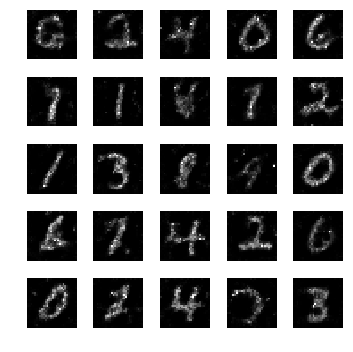

epoch: 1231, time: 4.979588 | train_G_Loss: 0.294867, train_D_loss: 2.400950, train_acc: 0.919922
cv_G_Loss: 0.404366, cv_D_loss: 2.313299, cv_acc: 0.929200

epoch: 1232, time: 4.940603 | train_G_Loss: 0.320172, train_D_loss: 2.448344, train_acc: 0.927734
cv_G_Loss: 0.370842, cv_D_loss: 2.575046, cv_acc: 0.879000

epoch: 1233, time: 4.961623 | train_G_Loss: 0.389896, train_D_loss: 2.341116, train_acc: 0.935547
cv_G_Loss: 0.406458, cv_D_loss: 2.319682, cv_acc: 0.917700

epoch: 1234, time: 4.953944 | train_G_Loss: 0.405531, train_D_loss: 2.320498, train_acc: 0.927734
cv_G_Loss: 0.412723, cv_D_loss: 2.347743, cv_acc: 0.925700

epoch: 1235, time: 4.957623 | train_G_Loss: 0.490871, train_D_loss: 2.072347, train_acc: 0.943359
cv_G_Loss: 0.860769, cv_D_loss: 3.328527, cv_acc: 0.770100

epoch: 1236, time: 4.958415 | train_G_Loss: 0.436838, train_D_loss: 2.574957, train_acc: 0.933594
cv_G_Loss: 0.615372, cv_D_loss: 2.536900, cv_acc: 0.905300

epoch: 1237, time: 4.961782 | train_G_Loss: 0.370781

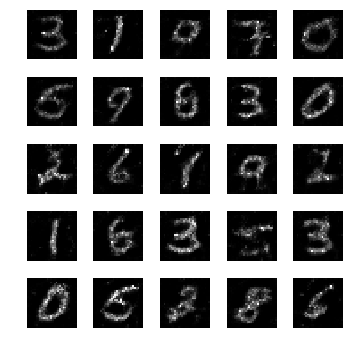

epoch: 1241, time: 4.995711 | train_G_Loss: 0.446106, train_D_loss: 2.331952, train_acc: 0.908203
cv_G_Loss: 0.516166, cv_D_loss: 2.670608, cv_acc: 0.866300

epoch: 1242, time: 4.967657 | train_G_Loss: 0.294840, train_D_loss: 2.862316, train_acc: 0.923828
cv_G_Loss: 0.164380, cv_D_loss: 2.720119, cv_acc: 0.906900

epoch: 1243, time: 4.965404 | train_G_Loss: 0.452305, train_D_loss: 2.151524, train_acc: 0.921875
cv_G_Loss: 1.951887, cv_D_loss: 4.640361, cv_acc: 0.893400

epoch: 1244, time: 4.966270 | train_G_Loss: 0.350487, train_D_loss: 2.227323, train_acc: 0.927734
cv_G_Loss: 2.929741, cv_D_loss: 6.480620, cv_acc: 0.881200

epoch: 1245, time: 4.956096 | train_G_Loss: 0.393638, train_D_loss: 2.152201, train_acc: 0.951172
cv_G_Loss: 1.653099, cv_D_loss: 4.162974, cv_acc: 0.896200

epoch: 1246, time: 4.956855 | train_G_Loss: 0.427215, train_D_loss: 2.089541, train_acc: 0.939453
cv_G_Loss: 0.472794, cv_D_loss: 2.592141, cv_acc: 0.883200

epoch: 1247, time: 4.956884 | train_G_Loss: 0.439596

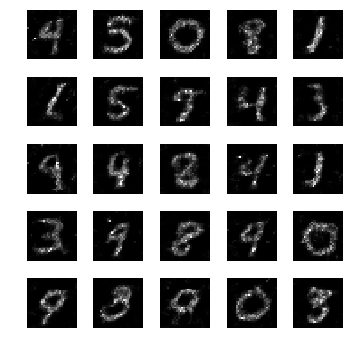

epoch: 1251, time: 4.990640 | train_G_Loss: 0.365778, train_D_loss: 2.386864, train_acc: 0.935547
cv_G_Loss: 0.562759, cv_D_loss: 3.258298, cv_acc: 0.644200

epoch: 1252, time: 4.963202 | train_G_Loss: 0.439738, train_D_loss: 2.212609, train_acc: 0.900391
cv_G_Loss: 0.590052, cv_D_loss: 2.487036, cv_acc: 0.908500

epoch: 1253, time: 4.967714 | train_G_Loss: 0.367454, train_D_loss: 2.161991, train_acc: 0.912109
cv_G_Loss: 0.506488, cv_D_loss: 2.472951, cv_acc: 0.908900

epoch: 1254, time: 4.977284 | train_G_Loss: 0.480291, train_D_loss: 2.468093, train_acc: 0.906250
cv_G_Loss: 1.307845, cv_D_loss: 3.487151, cv_acc: 0.917500

epoch: 1255, time: 4.956484 | train_G_Loss: 0.368158, train_D_loss: 2.749361, train_acc: 0.925781
cv_G_Loss: 0.336826, cv_D_loss: 2.567318, cv_acc: 0.876100

epoch: 1256, time: 4.956162 | train_G_Loss: 0.364600, train_D_loss: 2.332744, train_acc: 0.929688
cv_G_Loss: 0.559593, cv_D_loss: 2.981233, cv_acc: 0.766100

epoch: 1257, time: 4.965040 | train_G_Loss: 0.402361

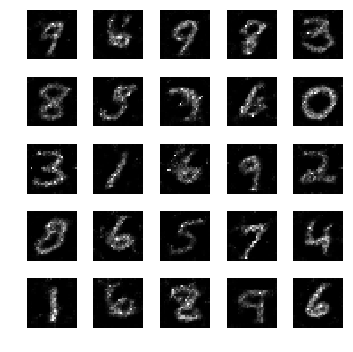

epoch: 1261, time: 4.965737 | train_G_Loss: 0.455670, train_D_loss: 2.292432, train_acc: 0.933594
cv_G_Loss: 2.685949, cv_D_loss: 6.554593, cv_acc: 0.634700

epoch: 1262, time: 4.974794 | train_G_Loss: 0.331785, train_D_loss: 2.696830, train_acc: 0.929688
cv_G_Loss: 0.762672, cv_D_loss: 2.999857, cv_acc: 0.848300

epoch: 1263, time: 4.954102 | train_G_Loss: 0.403163, train_D_loss: 2.301872, train_acc: 0.927734
cv_G_Loss: 1.066244, cv_D_loss: 3.020696, cv_acc: 0.915900

epoch: 1264, time: 4.964808 | train_G_Loss: 0.268792, train_D_loss: 2.637213, train_acc: 0.921875
cv_G_Loss: 1.358305, cv_D_loss: 3.469076, cv_acc: 0.912700

epoch: 1265, time: 4.959856 | train_G_Loss: 0.432502, train_D_loss: 2.442184, train_acc: 0.908203
cv_G_Loss: 1.361019, cv_D_loss: 3.703938, cv_acc: 0.885900

epoch: 1266, time: 4.960819 | train_G_Loss: 0.286363, train_D_loss: 2.740017, train_acc: 0.916016
cv_G_Loss: 1.157473, cv_D_loss: 3.273109, cv_acc: 0.919800

epoch: 1267, time: 4.952246 | train_G_Loss: 0.456052

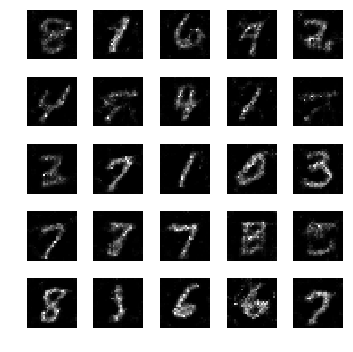

epoch: 1271, time: 5.002897 | train_G_Loss: 0.380814, train_D_loss: 2.289501, train_acc: 0.925781
cv_G_Loss: 1.470622, cv_D_loss: 3.861058, cv_acc: 0.855000

epoch: 1272, time: 4.956038 | train_G_Loss: 0.372833, train_D_loss: 2.430209, train_acc: 0.937500
cv_G_Loss: 1.076995, cv_D_loss: 3.051501, cv_acc: 0.914400

epoch: 1273, time: 4.952118 | train_G_Loss: 0.413852, train_D_loss: 2.300879, train_acc: 0.939453
cv_G_Loss: 1.838669, cv_D_loss: 4.371048, cv_acc: 0.922400

epoch: 1274, time: 4.964753 | train_G_Loss: 0.331145, train_D_loss: 2.138787, train_acc: 0.917969
cv_G_Loss: 0.359947, cv_D_loss: 2.561617, cv_acc: 0.873400

epoch: 1275, time: 4.958258 | train_G_Loss: 0.466955, train_D_loss: 2.301312, train_acc: 0.949219
cv_G_Loss: 0.669382, cv_D_loss: 2.847159, cv_acc: 0.840200

epoch: 1276, time: 4.972834 | train_G_Loss: 0.414219, train_D_loss: 2.121983, train_acc: 0.916016
cv_G_Loss: 0.667497, cv_D_loss: 2.607427, cv_acc: 0.915300

epoch: 1277, time: 4.963328 | train_G_Loss: 0.288506

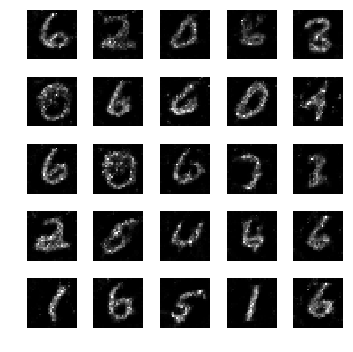

epoch: 1281, time: 5.023224 | train_G_Loss: 0.326617, train_D_loss: 2.451495, train_acc: 0.947266
cv_G_Loss: 0.944337, cv_D_loss: 3.016618, cv_acc: 0.880000

epoch: 1282, time: 4.989303 | train_G_Loss: 0.349121, train_D_loss: 2.168845, train_acc: 0.949219
cv_G_Loss: 1.617480, cv_D_loss: 3.869914, cv_acc: 0.925700

epoch: 1283, time: 5.002900 | train_G_Loss: 0.297855, train_D_loss: 2.558565, train_acc: 0.925781
cv_G_Loss: 0.840951, cv_D_loss: 2.745101, cv_acc: 0.918500

epoch: 1284, time: 5.035552 | train_G_Loss: 0.348365, train_D_loss: 2.369907, train_acc: 0.919922
cv_G_Loss: 0.233627, cv_D_loss: 2.512388, cv_acc: 0.920400

epoch: 1285, time: 4.996863 | train_G_Loss: 0.417989, train_D_loss: 2.319875, train_acc: 0.927734
cv_G_Loss: 0.598379, cv_D_loss: 2.535596, cv_acc: 0.911400

epoch: 1286, time: 4.998370 | train_G_Loss: 0.490184, train_D_loss: 2.305170, train_acc: 0.941406
cv_G_Loss: 0.553953, cv_D_loss: 2.511422, cv_acc: 0.919900

epoch: 1287, time: 5.001273 | train_G_Loss: 0.422378

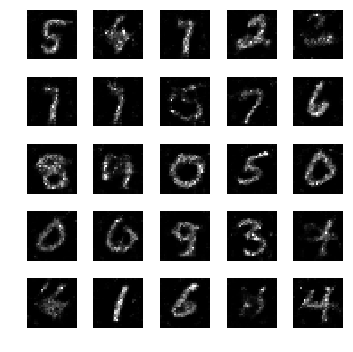

epoch: 1291, time: 5.020003 | train_G_Loss: 0.545399, train_D_loss: 2.117979, train_acc: 0.933594
cv_G_Loss: 1.142918, cv_D_loss: 4.097205, cv_acc: 0.584300

epoch: 1292, time: 5.013471 | train_G_Loss: 0.370704, train_D_loss: 2.378803, train_acc: 0.925781
cv_G_Loss: 0.286014, cv_D_loss: 3.158397, cv_acc: 0.655300

epoch: 1293, time: 4.986994 | train_G_Loss: 0.411892, train_D_loss: 2.268067, train_acc: 0.935547
cv_G_Loss: 1.057176, cv_D_loss: 3.369531, cv_acc: 0.780300

epoch: 1294, time: 4.996715 | train_G_Loss: 0.428216, train_D_loss: 2.082685, train_acc: 0.958984
cv_G_Loss: 1.417987, cv_D_loss: 3.509916, cv_acc: 0.915900

epoch: 1295, time: 4.993249 | train_G_Loss: 0.364338, train_D_loss: 2.100008, train_acc: 0.972656
cv_G_Loss: 0.220268, cv_D_loss: 2.499694, cv_acc: 0.919100

epoch: 1296, time: 4.980565 | train_G_Loss: 0.391152, train_D_loss: 2.310687, train_acc: 0.962891
cv_G_Loss: 1.877550, cv_D_loss: 4.482902, cv_acc: 0.894300

epoch: 1297, time: 5.044939 | train_G_Loss: 0.468787

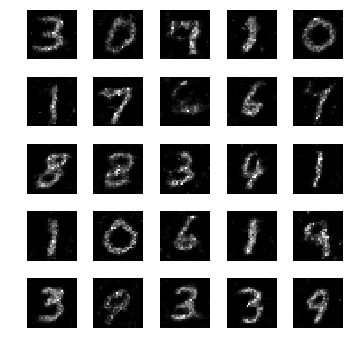

epoch: 1301, time: 5.013261 | train_G_Loss: 0.411180, train_D_loss: 2.058565, train_acc: 0.927734
cv_G_Loss: 0.720630, cv_D_loss: 3.171827, cv_acc: 0.804400

epoch: 1302, time: 4.992536 | train_G_Loss: 0.407284, train_D_loss: 2.284166, train_acc: 0.939453
cv_G_Loss: 1.478622, cv_D_loss: 3.698268, cv_acc: 0.914100

epoch: 1303, time: 4.988423 | train_G_Loss: 0.376239, train_D_loss: 2.236086, train_acc: 0.923828
cv_G_Loss: 0.632529, cv_D_loss: 2.525924, cv_acc: 0.908800

epoch: 1304, time: 4.999208 | train_G_Loss: 0.401933, train_D_loss: 2.410663, train_acc: 0.937500
cv_G_Loss: 1.343906, cv_D_loss: 3.408273, cv_acc: 0.913800

epoch: 1305, time: 5.011778 | train_G_Loss: 0.472137, train_D_loss: 2.236596, train_acc: 0.955078
cv_G_Loss: 1.734762, cv_D_loss: 5.192248, cv_acc: 0.634100

epoch: 1306, time: 4.998477 | train_G_Loss: 0.380738, train_D_loss: 2.163063, train_acc: 0.935547
cv_G_Loss: 0.608473, cv_D_loss: 3.081353, cv_acc: 0.748900

epoch: 1307, time: 5.027838 | train_G_Loss: 0.420346

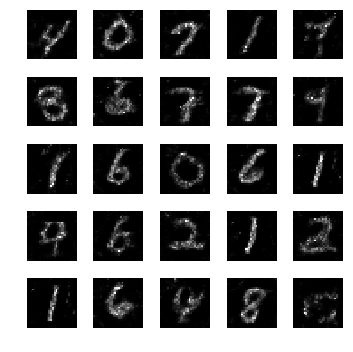

epoch: 1311, time: 5.017317 | train_G_Loss: 0.277872, train_D_loss: 2.457089, train_acc: 0.923828
cv_G_Loss: 0.572065, cv_D_loss: 2.861872, cv_acc: 0.803100

epoch: 1312, time: 5.008767 | train_G_Loss: 0.449847, train_D_loss: 2.132491, train_acc: 0.921875
cv_G_Loss: 3.099273, cv_D_loss: 7.211867, cv_acc: 0.653300

epoch: 1313, time: 5.003620 | train_G_Loss: 0.286691, train_D_loss: 2.508336, train_acc: 0.888672
cv_G_Loss: 0.624712, cv_D_loss: 2.479816, cv_acc: 0.913300

epoch: 1314, time: 5.005016 | train_G_Loss: 0.415923, train_D_loss: 2.708624, train_acc: 0.914062
cv_G_Loss: 1.571264, cv_D_loss: 3.873695, cv_acc: 0.928200

epoch: 1315, time: 4.999480 | train_G_Loss: 0.375800, train_D_loss: 2.215101, train_acc: 0.927734
cv_G_Loss: 0.294324, cv_D_loss: 2.425274, cv_acc: 0.916100

epoch: 1316, time: 4.988383 | train_G_Loss: 0.310540, train_D_loss: 2.465010, train_acc: 0.931641
cv_G_Loss: 0.271609, cv_D_loss: 2.517113, cv_acc: 0.909100

epoch: 1317, time: 4.995283 | train_G_Loss: 0.465342

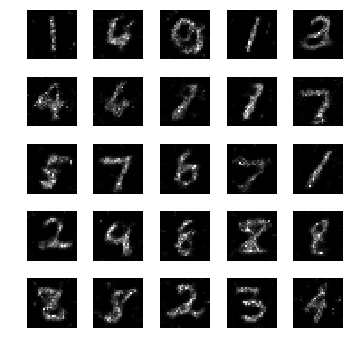

epoch: 1321, time: 5.049542 | train_G_Loss: 0.306398, train_D_loss: 2.210680, train_acc: 0.957031
cv_G_Loss: 0.303466, cv_D_loss: 2.487288, cv_acc: 0.897700

epoch: 1322, time: 4.996885 | train_G_Loss: 0.413939, train_D_loss: 2.209094, train_acc: 0.947266
cv_G_Loss: 1.766807, cv_D_loss: 4.061062, cv_acc: 0.910500

epoch: 1323, time: 4.997095 | train_G_Loss: 0.395777, train_D_loss: 2.204086, train_acc: 0.916016
cv_G_Loss: 0.957382, cv_D_loss: 2.885738, cv_acc: 0.916700

epoch: 1324, time: 4.999297 | train_G_Loss: 0.422363, train_D_loss: 2.599533, train_acc: 0.914062
cv_G_Loss: 1.146292, cv_D_loss: 3.125223, cv_acc: 0.933000
Model saved

epoch: 1325, time: 4.998743 | train_G_Loss: 0.368250, train_D_loss: 2.241618, train_acc: 0.919922
cv_G_Loss: 0.641758, cv_D_loss: 3.143967, cv_acc: 0.801100

epoch: 1326, time: 4.975581 | train_G_Loss: 0.373771, train_D_loss: 2.203187, train_acc: 0.908203
cv_G_Loss: 0.505605, cv_D_loss: 2.964996, cv_acc: 0.746000

epoch: 1327, time: 5.010232 | train_G_Lo

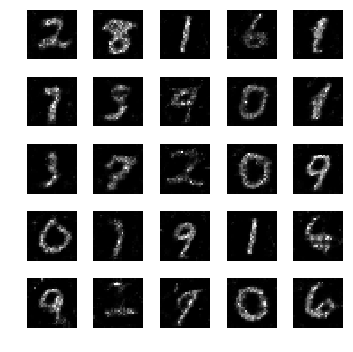

epoch: 1331, time: 5.028743 | train_G_Loss: 0.360967, train_D_loss: 2.310634, train_acc: 0.914062
cv_G_Loss: 1.242186, cv_D_loss: 3.459949, cv_acc: 0.878700

epoch: 1332, time: 5.001178 | train_G_Loss: 0.370514, train_D_loss: 2.585410, train_acc: 0.900391
cv_G_Loss: 0.646959, cv_D_loss: 2.517099, cv_acc: 0.917200

epoch: 1333, time: 4.989551 | train_G_Loss: 0.307581, train_D_loss: 2.819027, train_acc: 0.882812
cv_G_Loss: 0.749825, cv_D_loss: 2.618969, cv_acc: 0.924000

epoch: 1334, time: 5.000919 | train_G_Loss: 0.370485, train_D_loss: 2.501002, train_acc: 0.917969
cv_G_Loss: 0.295851, cv_D_loss: 2.401744, cv_acc: 0.922500

epoch: 1335, time: 4.996642 | train_G_Loss: 0.484430, train_D_loss: 2.194493, train_acc: 0.943359
cv_G_Loss: 0.895554, cv_D_loss: 2.801384, cv_acc: 0.919400

epoch: 1336, time: 4.995890 | train_G_Loss: 0.481460, train_D_loss: 2.318936, train_acc: 0.935547
cv_G_Loss: 0.681859, cv_D_loss: 2.700668, cv_acc: 0.875100

epoch: 1337, time: 5.008105 | train_G_Loss: 0.343561

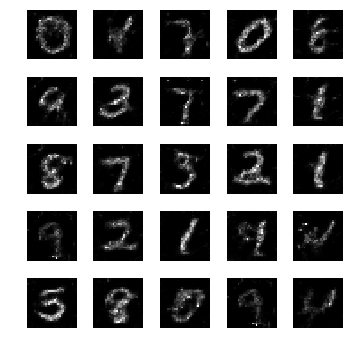

epoch: 1341, time: 5.002208 | train_G_Loss: 0.418199, train_D_loss: 2.076478, train_acc: 0.921875
cv_G_Loss: 0.294350, cv_D_loss: 2.427341, cv_acc: 0.923800

epoch: 1342, time: 5.003753 | train_G_Loss: 0.415864, train_D_loss: 2.285879, train_acc: 0.933594
cv_G_Loss: 1.066362, cv_D_loss: 3.083856, cv_acc: 0.919900

epoch: 1343, time: 5.002614 | train_G_Loss: 0.393161, train_D_loss: 2.090765, train_acc: 0.912109
cv_G_Loss: 1.681220, cv_D_loss: 5.221030, cv_acc: 0.546600

epoch: 1344, time: 4.994898 | train_G_Loss: 0.346598, train_D_loss: 2.275606, train_acc: 0.910156
cv_G_Loss: 0.368436, cv_D_loss: 2.455612, cv_acc: 0.913500

epoch: 1345, time: 4.990855 | train_G_Loss: 0.368151, train_D_loss: 2.291325, train_acc: 0.943359
cv_G_Loss: 2.779361, cv_D_loss: 6.471640, cv_acc: 0.745500

epoch: 1346, time: 4.997130 | train_G_Loss: 0.462734, train_D_loss: 2.187450, train_acc: 0.941406
cv_G_Loss: 1.296681, cv_D_loss: 3.533133, cv_acc: 0.892100

epoch: 1347, time: 5.000777 | train_G_Loss: 0.476154

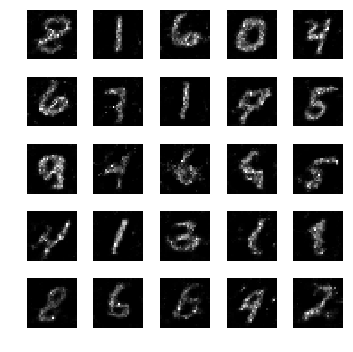

epoch: 1351, time: 5.031134 | train_G_Loss: 0.353942, train_D_loss: 2.255526, train_acc: 0.921875
cv_G_Loss: 0.489017, cv_D_loss: 2.426928, cv_acc: 0.913200

epoch: 1352, time: 4.999008 | train_G_Loss: 0.415442, train_D_loss: 2.271935, train_acc: 0.933594
cv_G_Loss: 0.931930, cv_D_loss: 2.997428, cv_acc: 0.913600

epoch: 1353, time: 5.004193 | train_G_Loss: 0.274091, train_D_loss: 2.327420, train_acc: 0.945312
cv_G_Loss: 0.901155, cv_D_loss: 2.857800, cv_acc: 0.913800

epoch: 1354, time: 5.001356 | train_G_Loss: 0.423233, train_D_loss: 2.396517, train_acc: 0.925781
cv_G_Loss: 0.995512, cv_D_loss: 3.081180, cv_acc: 0.879800

epoch: 1355, time: 5.004305 | train_G_Loss: 0.372108, train_D_loss: 2.304448, train_acc: 0.937500
cv_G_Loss: 0.800409, cv_D_loss: 2.737753, cv_acc: 0.910800

epoch: 1356, time: 4.999290 | train_G_Loss: 0.371288, train_D_loss: 2.229419, train_acc: 0.941406
cv_G_Loss: 0.374154, cv_D_loss: 2.370886, cv_acc: 0.912200

epoch: 1357, time: 4.981669 | train_G_Loss: 0.288940

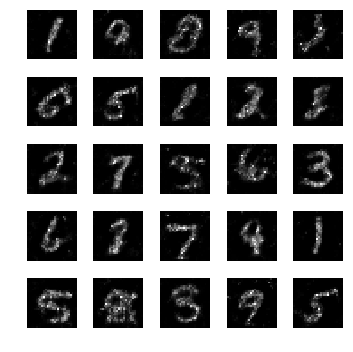

epoch: 1361, time: 5.035687 | train_G_Loss: 0.449810, train_D_loss: 2.355544, train_acc: 0.927734
cv_G_Loss: 1.064238, cv_D_loss: 3.198622, cv_acc: 0.856800

epoch: 1362, time: 5.005152 | train_G_Loss: 0.448749, train_D_loss: 2.188405, train_acc: 0.941406
cv_G_Loss: 3.575651, cv_D_loss: 7.787862, cv_acc: 0.863500

epoch: 1363, time: 5.000571 | train_G_Loss: 0.394085, train_D_loss: 2.303637, train_acc: 0.945312
cv_G_Loss: 1.672950, cv_D_loss: 4.129580, cv_acc: 0.905500

epoch: 1364, time: 5.012265 | train_G_Loss: 0.440416, train_D_loss: 2.192792, train_acc: 0.929688
cv_G_Loss: 0.270100, cv_D_loss: 2.387972, cv_acc: 0.927000

epoch: 1365, time: 5.012775 | train_G_Loss: 0.380997, train_D_loss: 2.379605, train_acc: 0.919922
cv_G_Loss: 0.516798, cv_D_loss: 2.495992, cv_acc: 0.908900

epoch: 1366, time: 4.998403 | train_G_Loss: 0.504350, train_D_loss: 2.206947, train_acc: 0.906250
cv_G_Loss: 0.344621, cv_D_loss: 2.515045, cv_acc: 0.897400

epoch: 1367, time: 5.002390 | train_G_Loss: 0.384821

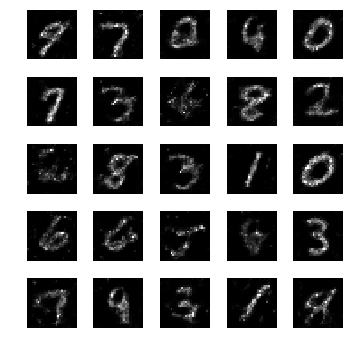

epoch: 1371, time: 5.032631 | train_G_Loss: 0.378906, train_D_loss: 2.253067, train_acc: 0.949219
cv_G_Loss: 0.490581, cv_D_loss: 2.325119, cv_acc: 0.932900

epoch: 1372, time: 5.027362 | train_G_Loss: 0.347978, train_D_loss: 2.328042, train_acc: 0.943359
cv_G_Loss: 0.208648, cv_D_loss: 2.514645, cv_acc: 0.926600

epoch: 1373, time: 5.011197 | train_G_Loss: 0.446803, train_D_loss: 2.282390, train_acc: 0.923828
cv_G_Loss: 0.307500, cv_D_loss: 2.384545, cv_acc: 0.919900

epoch: 1374, time: 5.030601 | train_G_Loss: 0.381720, train_D_loss: 2.374568, train_acc: 0.919922
cv_G_Loss: 1.692652, cv_D_loss: 4.023761, cv_acc: 0.882900

epoch: 1375, time: 5.006076 | train_G_Loss: 0.446689, train_D_loss: 2.274755, train_acc: 0.919922
cv_G_Loss: 0.611681, cv_D_loss: 2.575785, cv_acc: 0.907900

epoch: 1376, time: 5.002850 | train_G_Loss: 0.464724, train_D_loss: 2.311414, train_acc: 0.916016
cv_G_Loss: 1.425096, cv_D_loss: 3.609228, cv_acc: 0.927800

epoch: 1377, time: 5.001600 | train_G_Loss: 0.446030

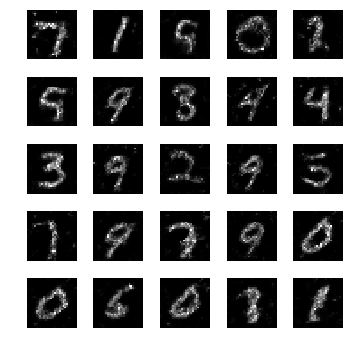

epoch: 1381, time: 5.044010 | train_G_Loss: 0.345710, train_D_loss: 2.187853, train_acc: 0.941406
cv_G_Loss: 1.153899, cv_D_loss: 3.221569, cv_acc: 0.921100

epoch: 1382, time: 4.996052 | train_G_Loss: 0.402988, train_D_loss: 2.301293, train_acc: 0.933594
cv_G_Loss: 0.606615, cv_D_loss: 2.760505, cv_acc: 0.830200

epoch: 1383, time: 4.985866 | train_G_Loss: 0.378389, train_D_loss: 2.395801, train_acc: 0.921875
cv_G_Loss: 0.581835, cv_D_loss: 2.734869, cv_acc: 0.842500

epoch: 1384, time: 4.998353 | train_G_Loss: 0.317958, train_D_loss: 2.217815, train_acc: 0.931641
cv_G_Loss: 0.604616, cv_D_loss: 2.598827, cv_acc: 0.878400

epoch: 1385, time: 5.017110 | train_G_Loss: 0.352891, train_D_loss: 2.332374, train_acc: 0.908203
cv_G_Loss: 0.628256, cv_D_loss: 2.529876, cv_acc: 0.904600

epoch: 1386, time: 4.999886 | train_G_Loss: 0.339779, train_D_loss: 2.485386, train_acc: 0.919922
cv_G_Loss: 0.476919, cv_D_loss: 2.384575, cv_acc: 0.919800

epoch: 1387, time: 5.005966 | train_G_Loss: 0.431268

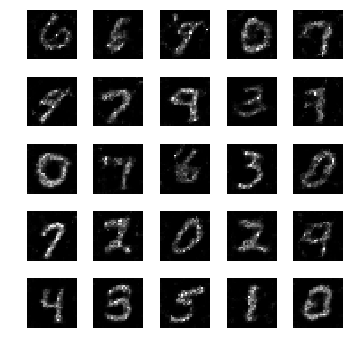

epoch: 1391, time: 5.022943 | train_G_Loss: 0.335676, train_D_loss: 2.214176, train_acc: 0.921875
cv_G_Loss: 0.997152, cv_D_loss: 3.408715, cv_acc: 0.798200

epoch: 1392, time: 5.001794 | train_G_Loss: 0.359229, train_D_loss: 2.292886, train_acc: 0.914062
cv_G_Loss: 0.402634, cv_D_loss: 2.952662, cv_acc: 0.773800

epoch: 1393, time: 4.984220 | train_G_Loss: 0.313078, train_D_loss: 2.478161, train_acc: 0.892578
cv_G_Loss: 1.163001, cv_D_loss: 3.912545, cv_acc: 0.590900

epoch: 1394, time: 4.996560 | train_G_Loss: 0.301292, train_D_loss: 2.658980, train_acc: 0.923828
cv_G_Loss: 0.437768, cv_D_loss: 2.677624, cv_acc: 0.791300

epoch: 1395, time: 4.977861 | train_G_Loss: 0.399934, train_D_loss: 2.227995, train_acc: 0.957031
cv_G_Loss: 1.958406, cv_D_loss: 4.798269, cv_acc: 0.881600

epoch: 1396, time: 4.991526 | train_G_Loss: 0.512197, train_D_loss: 2.244528, train_acc: 0.933594
cv_G_Loss: 1.400099, cv_D_loss: 3.561246, cv_acc: 0.926200

epoch: 1397, time: 5.037745 | train_G_Loss: 0.399190

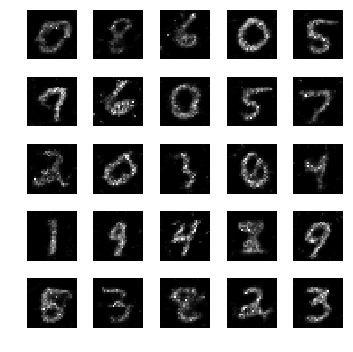

epoch: 1401, time: 5.019321 | train_G_Loss: 0.446772, train_D_loss: 2.221483, train_acc: 0.914062
cv_G_Loss: 2.276241, cv_D_loss: 5.489739, cv_acc: 0.704800

epoch: 1402, time: 4.995673 | train_G_Loss: 0.445841, train_D_loss: 2.127570, train_acc: 0.923828
cv_G_Loss: 0.890332, cv_D_loss: 2.819227, cv_acc: 0.917400

epoch: 1403, time: 4.998991 | train_G_Loss: 0.445898, train_D_loss: 2.209851, train_acc: 0.941406
cv_G_Loss: 1.420199, cv_D_loss: 3.562510, cv_acc: 0.930300

epoch: 1404, time: 4.992914 | train_G_Loss: 0.453581, train_D_loss: 2.158985, train_acc: 0.953125
cv_G_Loss: 0.175342, cv_D_loss: 2.578522, cv_acc: 0.927300

epoch: 1405, time: 4.993409 | train_G_Loss: 0.441576, train_D_loss: 2.211947, train_acc: 0.931641
cv_G_Loss: 0.886762, cv_D_loss: 3.351719, cv_acc: 0.807500

epoch: 1406, time: 4.996260 | train_G_Loss: 0.257706, train_D_loss: 2.355956, train_acc: 0.916016
cv_G_Loss: 0.284628, cv_D_loss: 2.376944, cv_acc: 0.927700

epoch: 1407, time: 4.983549 | train_G_Loss: 0.384471

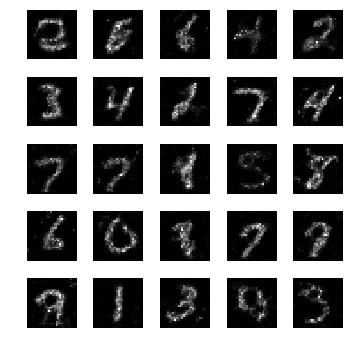

epoch: 1411, time: 5.006944 | train_G_Loss: 0.303488, train_D_loss: 2.375382, train_acc: 0.906250
cv_G_Loss: 0.224206, cv_D_loss: 2.617392, cv_acc: 0.898900

epoch: 1412, time: 4.986567 | train_G_Loss: 0.395832, train_D_loss: 2.325681, train_acc: 0.943359
cv_G_Loss: 0.507144, cv_D_loss: 2.952630, cv_acc: 0.762400

epoch: 1413, time: 4.989058 | train_G_Loss: 0.440253, train_D_loss: 2.288912, train_acc: 0.947266
cv_G_Loss: 0.341131, cv_D_loss: 2.453158, cv_acc: 0.913600

epoch: 1414, time: 4.978796 | train_G_Loss: 0.460782, train_D_loss: 2.242985, train_acc: 0.931641
cv_G_Loss: 0.560605, cv_D_loss: 2.434355, cv_acc: 0.929000

epoch: 1415, time: 4.970785 | train_G_Loss: 0.404567, train_D_loss: 2.245187, train_acc: 0.951172
cv_G_Loss: 0.403482, cv_D_loss: 2.433136, cv_acc: 0.908500

epoch: 1416, time: 4.992649 | train_G_Loss: 0.486271, train_D_loss: 2.357084, train_acc: 0.929688
cv_G_Loss: 0.914239, cv_D_loss: 2.722518, cv_acc: 0.921200

epoch: 1417, time: 5.003232 | train_G_Loss: 0.354666

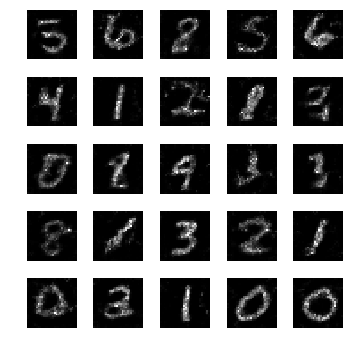

epoch: 1421, time: 5.013392 | train_G_Loss: 0.490424, train_D_loss: 2.164882, train_acc: 0.947266
cv_G_Loss: 2.227491, cv_D_loss: 5.049150, cv_acc: 0.914800

epoch: 1422, time: 4.986538 | train_G_Loss: 0.323382, train_D_loss: 2.431591, train_acc: 0.933594
cv_G_Loss: 1.647645, cv_D_loss: 4.141127, cv_acc: 0.869000

epoch: 1423, time: 4.986457 | train_G_Loss: 0.391771, train_D_loss: 2.329621, train_acc: 0.921875
cv_G_Loss: 0.548223, cv_D_loss: 2.822965, cv_acc: 0.832400

epoch: 1424, time: 4.988761 | train_G_Loss: 0.329192, train_D_loss: 2.354266, train_acc: 0.931641
cv_G_Loss: 0.449571, cv_D_loss: 3.113824, cv_acc: 0.753100

epoch: 1425, time: 4.989769 | train_G_Loss: 0.405410, train_D_loss: 2.364602, train_acc: 0.943359
cv_G_Loss: 1.320243, cv_D_loss: 3.313651, cv_acc: 0.930200

epoch: 1426, time: 4.983424 | train_G_Loss: 0.427098, train_D_loss: 2.337916, train_acc: 0.917969
cv_G_Loss: 0.869393, cv_D_loss: 2.853165, cv_acc: 0.924000

epoch: 1427, time: 4.976722 | train_G_Loss: 0.474225

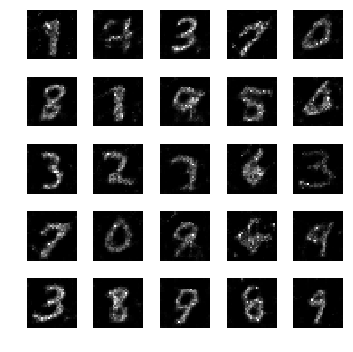

epoch: 1431, time: 5.033636 | train_G_Loss: 0.380393, train_D_loss: 2.321465, train_acc: 0.949219
cv_G_Loss: 1.735289, cv_D_loss: 4.762484, cv_acc: 0.707000

epoch: 1432, time: 5.000820 | train_G_Loss: 0.473731, train_D_loss: 2.583114, train_acc: 0.945312
cv_G_Loss: 1.361997, cv_D_loss: 3.494363, cv_acc: 0.932400

epoch: 1433, time: 5.004454 | train_G_Loss: 0.311044, train_D_loss: 2.254089, train_acc: 0.929688
cv_G_Loss: 0.641253, cv_D_loss: 2.649424, cv_acc: 0.855200

epoch: 1434, time: 5.005270 | train_G_Loss: 0.442642, train_D_loss: 2.214303, train_acc: 0.951172
cv_G_Loss: 1.007322, cv_D_loss: 3.078435, cv_acc: 0.915600

epoch: 1435, time: 5.004031 | train_G_Loss: 0.433794, train_D_loss: 2.052474, train_acc: 0.941406
cv_G_Loss: 0.811848, cv_D_loss: 2.651505, cv_acc: 0.930500

epoch: 1436, time: 5.006122 | train_G_Loss: 0.413064, train_D_loss: 2.564944, train_acc: 0.931641
cv_G_Loss: 0.257636, cv_D_loss: 2.577236, cv_acc: 0.889900

epoch: 1437, time: 5.021434 | train_G_Loss: 0.298444

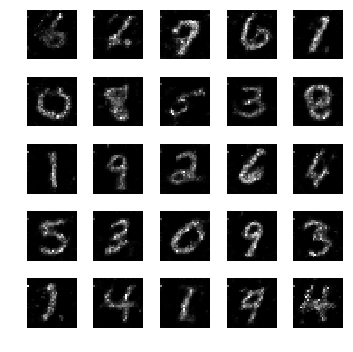

epoch: 1441, time: 5.032649 | train_G_Loss: 0.450316, train_D_loss: 2.224403, train_acc: 0.937500
cv_G_Loss: 0.355268, cv_D_loss: 2.558163, cv_acc: 0.891000

epoch: 1442, time: 5.033751 | train_G_Loss: 0.360969, train_D_loss: 2.235699, train_acc: 0.931641
cv_G_Loss: 1.412050, cv_D_loss: 3.531507, cv_acc: 0.926700

epoch: 1443, time: 5.053855 | train_G_Loss: 0.477885, train_D_loss: 2.102699, train_acc: 0.931641
cv_G_Loss: 1.713398, cv_D_loss: 4.147618, cv_acc: 0.926500

epoch: 1444, time: 5.138890 | train_G_Loss: 0.395474, train_D_loss: 2.691214, train_acc: 0.914062
cv_G_Loss: 3.384328, cv_D_loss: 7.360592, cv_acc: 0.863900

epoch: 1445, time: 4.981662 | train_G_Loss: 0.330622, train_D_loss: 2.352795, train_acc: 0.921875
cv_G_Loss: 1.401480, cv_D_loss: 3.755796, cv_acc: 0.891100

epoch: 1446, time: 5.061279 | train_G_Loss: 0.422776, train_D_loss: 2.017535, train_acc: 0.943359
cv_G_Loss: 0.957237, cv_D_loss: 2.966622, cv_acc: 0.905300

epoch: 1447, time: 5.106702 | train_G_Loss: 0.344937

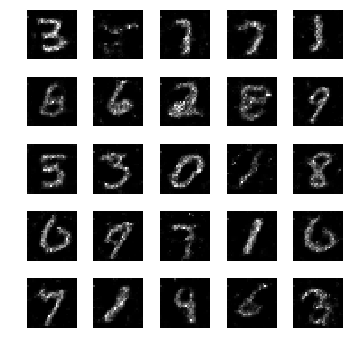

epoch: 1451, time: 5.004485 | train_G_Loss: 0.371683, train_D_loss: 2.367284, train_acc: 0.931641
cv_G_Loss: 1.974532, cv_D_loss: 4.630402, cv_acc: 0.927100

epoch: 1452, time: 4.978532 | train_G_Loss: 0.429686, train_D_loss: 2.405865, train_acc: 0.935547
cv_G_Loss: 1.084415, cv_D_loss: 3.515614, cv_acc: 0.710600

epoch: 1453, time: 4.983160 | train_G_Loss: 0.397299, train_D_loss: 2.665373, train_acc: 0.921875
cv_G_Loss: 0.797614, cv_D_loss: 2.895375, cv_acc: 0.884500

epoch: 1454, time: 4.981577 | train_G_Loss: 0.431799, train_D_loss: 2.262208, train_acc: 0.904297
cv_G_Loss: 0.442570, cv_D_loss: 2.997644, cv_acc: 0.767400

epoch: 1455, time: 5.000560 | train_G_Loss: 0.374608, train_D_loss: 2.210233, train_acc: 0.927734
cv_G_Loss: 1.650198, cv_D_loss: 4.187846, cv_acc: 0.874200

epoch: 1456, time: 4.982201 | train_G_Loss: 0.330014, train_D_loss: 2.201211, train_acc: 0.925781
cv_G_Loss: 1.223365, cv_D_loss: 3.258711, cv_acc: 0.901300

epoch: 1457, time: 4.986962 | train_G_Loss: 0.332990

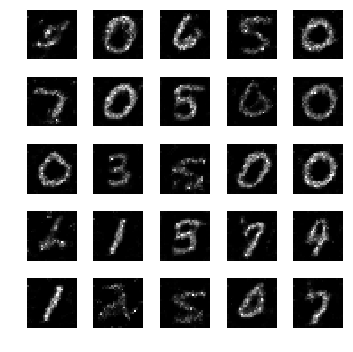

epoch: 1461, time: 5.008368 | train_G_Loss: 0.454101, train_D_loss: 2.280706, train_acc: 0.941406
cv_G_Loss: 0.956773, cv_D_loss: 3.362221, cv_acc: 0.811000

epoch: 1462, time: 5.008428 | train_G_Loss: 0.407182, train_D_loss: 2.154706, train_acc: 0.906250
cv_G_Loss: 0.732045, cv_D_loss: 2.711775, cv_acc: 0.906600

epoch: 1463, time: 4.991021 | train_G_Loss: 0.295085, train_D_loss: 2.395814, train_acc: 0.906250
cv_G_Loss: 0.373085, cv_D_loss: 2.374198, cv_acc: 0.920600

epoch: 1464, time: 5.025433 | train_G_Loss: 0.404817, train_D_loss: 2.187210, train_acc: 0.945312
cv_G_Loss: 2.224216, cv_D_loss: 5.270952, cv_acc: 0.781100

epoch: 1465, time: 5.003551 | train_G_Loss: 0.545297, train_D_loss: 2.125628, train_acc: 0.929688
cv_G_Loss: 2.212165, cv_D_loss: 5.230641, cv_acc: 0.904900

epoch: 1466, time: 4.986207 | train_G_Loss: 0.437498, train_D_loss: 2.432894, train_acc: 0.943359
cv_G_Loss: 1.913410, cv_D_loss: 4.507946, cv_acc: 0.916700

epoch: 1467, time: 4.984599 | train_G_Loss: 0.369248

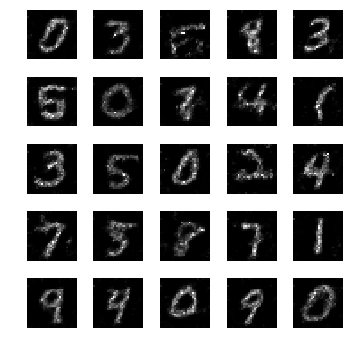

epoch: 1471, time: 5.025175 | train_G_Loss: 0.476648, train_D_loss: 2.145426, train_acc: 0.945312
cv_G_Loss: 0.765754, cv_D_loss: 2.589385, cv_acc: 0.928400

epoch: 1472, time: 4.986671 | train_G_Loss: 0.488896, train_D_loss: 2.359242, train_acc: 0.939453
cv_G_Loss: 1.234764, cv_D_loss: 3.273600, cv_acc: 0.929700

epoch: 1473, time: 4.995649 | train_G_Loss: 0.411418, train_D_loss: 2.276410, train_acc: 0.947266
cv_G_Loss: 0.362414, cv_D_loss: 2.319932, cv_acc: 0.935000
Model saved

epoch: 1474, time: 4.983123 | train_G_Loss: 0.344839, train_D_loss: 2.173095, train_acc: 0.945312
cv_G_Loss: 1.357937, cv_D_loss: 3.405504, cv_acc: 0.923600

epoch: 1475, time: 4.966555 | train_G_Loss: 0.352221, train_D_loss: 2.207547, train_acc: 0.941406
cv_G_Loss: 1.145917, cv_D_loss: 3.161990, cv_acc: 0.910500

epoch: 1476, time: 4.954453 | train_G_Loss: 0.446172, train_D_loss: 2.051535, train_acc: 0.949219
cv_G_Loss: 1.484470, cv_D_loss: 3.919462, cv_acc: 0.844600

epoch: 1477, time: 4.958448 | train_G_Lo

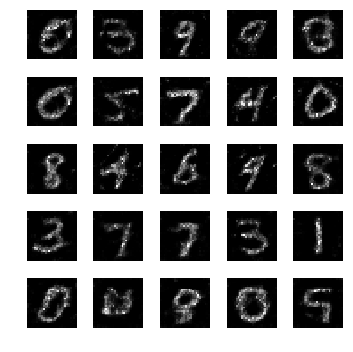

epoch: 1481, time: 4.984076 | train_G_Loss: 0.452405, train_D_loss: 1.969955, train_acc: 0.960938
cv_G_Loss: 2.844216, cv_D_loss: 6.818882, cv_acc: 0.653100

epoch: 1482, time: 4.961600 | train_G_Loss: 0.471928, train_D_loss: 2.265704, train_acc: 0.968750
cv_G_Loss: 1.275198, cv_D_loss: 3.435892, cv_acc: 0.917700

epoch: 1483, time: 4.969163 | train_G_Loss: 0.419376, train_D_loss: 2.119284, train_acc: 0.984375
cv_G_Loss: 2.346690, cv_D_loss: 5.487554, cv_acc: 0.795900

epoch: 1484, time: 4.967589 | train_G_Loss: 0.323431, train_D_loss: 2.128503, train_acc: 0.962891
cv_G_Loss: 0.250959, cv_D_loss: 2.443439, cv_acc: 0.928100

epoch: 1485, time: 4.960587 | train_G_Loss: 0.295897, train_D_loss: 2.448764, train_acc: 0.955078
cv_G_Loss: 0.554686, cv_D_loss: 2.907894, cv_acc: 0.825600

epoch: 1486, time: 4.967286 | train_G_Loss: 0.412605, train_D_loss: 2.325086, train_acc: 0.949219
cv_G_Loss: 0.396264, cv_D_loss: 2.373119, cv_acc: 0.923300

epoch: 1487, time: 4.995016 | train_G_Loss: 0.381196

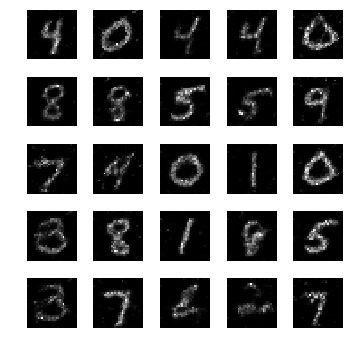

epoch: 1491, time: 4.988064 | train_G_Loss: 0.351418, train_D_loss: 2.238892, train_acc: 0.960938
cv_G_Loss: 0.417175, cv_D_loss: 2.587306, cv_acc: 0.867700

epoch: 1492, time: 4.977464 | train_G_Loss: 0.336776, train_D_loss: 2.385859, train_acc: 0.933594
cv_G_Loss: 1.989482, cv_D_loss: 5.939103, cv_acc: 0.529100

epoch: 1493, time: 5.000921 | train_G_Loss: 0.429471, train_D_loss: 2.160851, train_acc: 0.919922
cv_G_Loss: 0.424688, cv_D_loss: 2.572333, cv_acc: 0.848200

epoch: 1494, time: 5.001761 | train_G_Loss: 0.275282, train_D_loss: 2.762273, train_acc: 0.923828
cv_G_Loss: 0.177166, cv_D_loss: 2.882725, cv_acc: 0.862500

epoch: 1495, time: 5.020085 | train_G_Loss: 0.334623, train_D_loss: 2.452224, train_acc: 0.939453
cv_G_Loss: 0.854186, cv_D_loss: 2.746301, cv_acc: 0.913100

epoch: 1496, time: 4.997046 | train_G_Loss: 0.399806, train_D_loss: 2.229927, train_acc: 0.935547
cv_G_Loss: 0.533488, cv_D_loss: 2.437856, cv_acc: 0.922900

epoch: 1497, time: 5.002831 | train_G_Loss: 0.327315

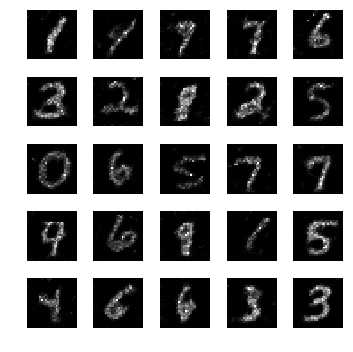

Discriminator summary:
 x: (?, 28, 28, 1)
 D1: (?, 14, 14, 32)
 D2: (?, 7, 7, 64)
 D3: (?, 4, 4, 128)
 D4: (?, 2, 2, 128)

Generator summary:
 z: (?, 100)
 G0: (?, 1, 1, 100)
 G1: (?, 2, 2, 100)
 G2: (?, 5, 5, 64)
 G3: (?, 12, 12, 32)
 G4: (?, 28, 28, 1)

Discriminator summary:
 x: (?, 28, 28, 1)
 D1: (?, 14, 14, 32)
 D2: (?, 7, 7, 64)
 D3: (?, 4, 4, 128)
 D4: (?, 2, 2, 128)

training....
Extracting mnist_data\train-images-idx3-ubyte.gz
Extracting mnist_data\train-labels-idx1-ubyte.gz
Extracting mnist_data\t10k-images-idx3-ubyte.gz
Extracting mnist_data\t10k-labels-idx1-ubyte.gz
epoch: 0, time: 6.264341 | train_G_Loss: 0.593647, train_D_loss: 3.652458, train_acc: 0.107422
cv_G_Loss: 0.508742, cv_D_loss: 4.469574, cv_acc: 0.098000
Model saved



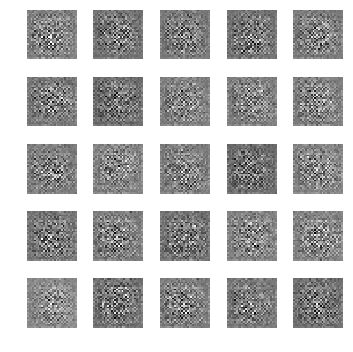

epoch: 1, time: 5.046046 | train_G_Loss: 0.913395, train_D_loss: 3.125665, train_acc: 0.078125
cv_G_Loss: 2.910453, cv_D_loss: 4.809673, cv_acc: 0.101000
Model saved

epoch: 2, time: 5.047066 | train_G_Loss: 1.424559, train_D_loss: 2.758695, train_acc: 0.066406
cv_G_Loss: 4.693376, cv_D_loss: 7.183460, cv_acc: 0.101000

epoch: 3, time: 5.029298 | train_G_Loss: 1.871415, train_D_loss: 2.585605, train_acc: 0.115234
cv_G_Loss: 5.511105, cv_D_loss: 8.044559, cv_acc: 0.101000

epoch: 4, time: 5.028831 | train_G_Loss: 2.057252, train_D_loss: 2.539411, train_acc: 0.115234
cv_G_Loss: 5.667018, cv_D_loss: 8.288269, cv_acc: 0.101000

epoch: 5, time: 5.038866 | train_G_Loss: 2.223143, train_D_loss: 2.518553, train_acc: 0.109375
cv_G_Loss: 6.101517, cv_D_loss: 10.919458, cv_acc: 0.101000

epoch: 6, time: 5.022814 | train_G_Loss: 2.480827, train_D_loss: 2.465876, train_acc: 0.109375
cv_G_Loss: 6.818426, cv_D_loss: 15.114491, cv_acc: 0.101000

epoch: 7, time: 5.075043 | train_G_Loss: 2.568419, train

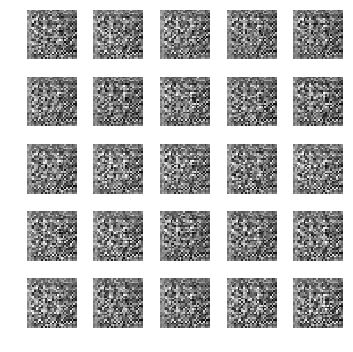

epoch: 11, time: 5.067004 | train_G_Loss: 3.519361, train_D_loss: 2.344702, train_acc: 0.132812
cv_G_Loss: 12.844836, cv_D_loss: 28.426434, cv_acc: 0.101000

epoch: 12, time: 5.032965 | train_G_Loss: 3.603551, train_D_loss: 2.348800, train_acc: 0.121094
cv_G_Loss: 13.813309, cv_D_loss: 28.593224, cv_acc: 0.089200

epoch: 13, time: 5.035360 | train_G_Loss: 3.939944, train_D_loss: 2.342986, train_acc: 0.126953
cv_G_Loss: 15.282638, cv_D_loss: 28.249239, cv_acc: 0.089200

epoch: 14, time: 5.028367 | train_G_Loss: 4.164834, train_D_loss: 2.327368, train_acc: 0.175781
cv_G_Loss: 16.644833, cv_D_loss: 28.346281, cv_acc: 0.089200

epoch: 15, time: 5.031855 | train_G_Loss: 4.284000, train_D_loss: 2.311570, train_acc: 0.125000
cv_G_Loss: 17.700403, cv_D_loss: 28.443594, cv_acc: 0.089200

epoch: 16, time: 5.032250 | train_G_Loss: 4.490127, train_D_loss: 2.320635, train_acc: 0.244141
cv_G_Loss: 19.479200, cv_D_loss: 28.712654, cv_acc: 0.089200

epoch: 17, time: 5.042791 | train_G_Loss: 4.614080, 

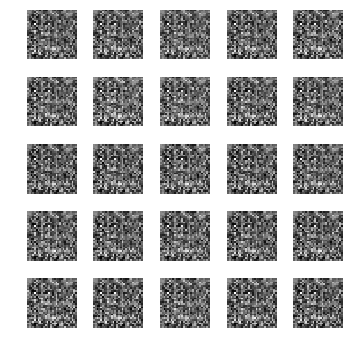

epoch: 21, time: 5.058933 | train_G_Loss: 4.741532, train_D_loss: 2.297310, train_acc: 0.179688
cv_G_Loss: 19.780981, cv_D_loss: 32.704178, cv_acc: 0.089200

epoch: 22, time: 5.030846 | train_G_Loss: 4.776432, train_D_loss: 2.311351, train_acc: 0.228516
cv_G_Loss: 19.951265, cv_D_loss: 33.749199, cv_acc: 0.089200

epoch: 23, time: 5.031669 | train_G_Loss: 4.875235, train_D_loss: 2.309215, train_acc: 0.099609
cv_G_Loss: 20.032692, cv_D_loss: 34.824699, cv_acc: 0.098200

epoch: 24, time: 5.027270 | train_G_Loss: 4.817393, train_D_loss: 2.309776, train_acc: 0.228516
cv_G_Loss: 20.222441, cv_D_loss: 33.956619, cv_acc: 0.098200

epoch: 25, time: 5.026578 | train_G_Loss: 4.781291, train_D_loss: 2.303596, train_acc: 0.144531
cv_G_Loss: 20.279650, cv_D_loss: 33.919830, cv_acc: 0.098200

epoch: 26, time: 5.027486 | train_G_Loss: 4.855985, train_D_loss: 2.308929, train_acc: 0.130859
cv_G_Loss: 20.138212, cv_D_loss: 33.920918, cv_acc: 0.089300

epoch: 27, time: 5.032293 | train_G_Loss: 4.801585, 

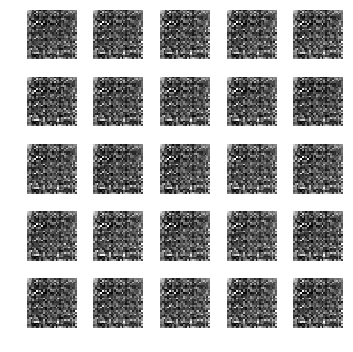

epoch: 31, time: 5.057210 | train_G_Loss: 4.745530, train_D_loss: 2.301498, train_acc: 0.207031
cv_G_Loss: 14.033567, cv_D_loss: 31.037405, cv_acc: 0.101000

epoch: 32, time: 5.032128 | train_G_Loss: 4.635974, train_D_loss: 2.290997, train_acc: 0.220703
cv_G_Loss: 13.325629, cv_D_loss: 29.171690, cv_acc: 0.101000

epoch: 33, time: 5.022314 | train_G_Loss: 4.485768, train_D_loss: 2.305055, train_acc: 0.259766
cv_G_Loss: 12.480387, cv_D_loss: 29.338430, cv_acc: 0.101000

epoch: 34, time: 5.018635 | train_G_Loss: 4.320779, train_D_loss: 2.295606, train_acc: 0.248047
cv_G_Loss: 11.113702, cv_D_loss: 30.046457, cv_acc: 0.101000

epoch: 35, time: 5.022073 | train_G_Loss: 4.045312, train_D_loss: 2.308702, train_acc: 0.115234
cv_G_Loss: 9.299647, cv_D_loss: 31.251108, cv_acc: 0.098200

epoch: 36, time: 5.019329 | train_G_Loss: 4.030571, train_D_loss: 2.300348, train_acc: 0.203125
cv_G_Loss: 7.592738, cv_D_loss: 31.336927, cv_acc: 0.098200

epoch: 37, time: 5.024847 | train_G_Loss: 3.951174, tr

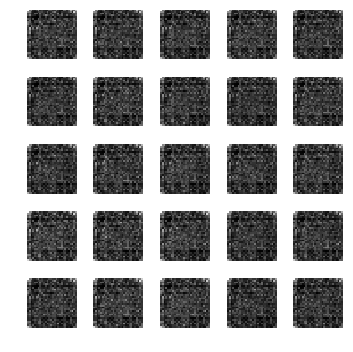

epoch: 41, time: 5.039357 | train_G_Loss: 3.346112, train_D_loss: 2.289104, train_acc: 0.359375
cv_G_Loss: 4.521072, cv_D_loss: 26.386513, cv_acc: 0.098200

epoch: 42, time: 5.016035 | train_G_Loss: 3.215175, train_D_loss: 2.290752, train_acc: 0.300781
cv_G_Loss: 4.346050, cv_D_loss: 26.532906, cv_acc: 0.098200

epoch: 43, time: 5.015302 | train_G_Loss: 3.115639, train_D_loss: 2.321837, train_acc: 0.341797
cv_G_Loss: 4.659387, cv_D_loss: 26.350630, cv_acc: 0.098200

epoch: 44, time: 5.014903 | train_G_Loss: 2.915928, train_D_loss: 2.279817, train_acc: 0.425781
cv_G_Loss: 3.706880, cv_D_loss: 26.283657, cv_acc: 0.098200

epoch: 45, time: 5.028389 | train_G_Loss: 2.482273, train_D_loss: 2.265109, train_acc: 0.548828
cv_G_Loss: 2.844761, cv_D_loss: 22.900127, cv_acc: 0.098200

epoch: 46, time: 5.020822 | train_G_Loss: 2.417382, train_D_loss: 2.309347, train_acc: 0.371094
cv_G_Loss: 2.329532, cv_D_loss: 21.921350, cv_acc: 0.098200

epoch: 47, time: 5.014926 | train_G_Loss: 1.997836, train_

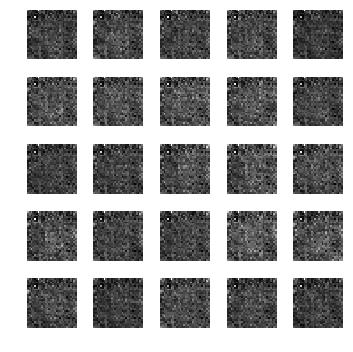

epoch: 51, time: 5.082851 | train_G_Loss: 1.482742, train_D_loss: 2.509991, train_acc: 0.527344
cv_G_Loss: 0.924073, cv_D_loss: 13.713094, cv_acc: 0.180200
Model saved

epoch: 52, time: 5.041482 | train_G_Loss: 1.490163, train_D_loss: 2.504138, train_acc: 0.593750
cv_G_Loss: 1.034930, cv_D_loss: 13.941994, cv_acc: 0.202400
Model saved

epoch: 53, time: 5.043914 | train_G_Loss: 1.138071, train_D_loss: 2.559425, train_acc: 0.568359
cv_G_Loss: 0.800893, cv_D_loss: 12.207139, cv_acc: 0.204500
Model saved

epoch: 54, time: 5.052126 | train_G_Loss: 1.251728, train_D_loss: 2.576262, train_acc: 0.576172
cv_G_Loss: 0.914700, cv_D_loss: 13.038103, cv_acc: 0.207100
Model saved

epoch: 55, time: 5.055338 | train_G_Loss: 0.805276, train_D_loss: 2.645896, train_acc: 0.580078
cv_G_Loss: 0.500025, cv_D_loss: 10.041662, cv_acc: 0.210200
Model saved

epoch: 56, time: 5.040941 | train_G_Loss: 1.021580, train_D_loss: 2.617087, train_acc: 0.625000
cv_G_Loss: 0.898685, cv_D_loss: 10.606475, cv_acc: 0.225900

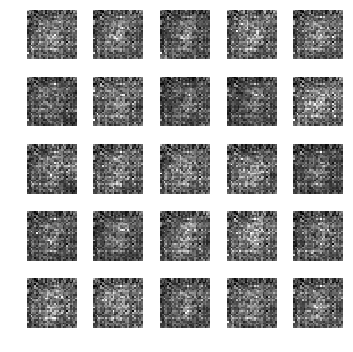

epoch: 61, time: 5.051641 | train_G_Loss: 0.882129, train_D_loss: 2.518716, train_acc: 0.646484
cv_G_Loss: 0.979053, cv_D_loss: 9.092915, cv_acc: 0.271700

epoch: 62, time: 5.018005 | train_G_Loss: 0.820534, train_D_loss: 2.626423, train_acc: 0.681641
cv_G_Loss: 0.620020, cv_D_loss: 6.161955, cv_acc: 0.394700
Model saved

epoch: 63, time: 5.049015 | train_G_Loss: 0.948007, train_D_loss: 2.642334, train_acc: 0.628906
cv_G_Loss: 1.064890, cv_D_loss: 6.470208, cv_acc: 0.343500

epoch: 64, time: 5.018744 | train_G_Loss: 0.835005, train_D_loss: 2.582882, train_acc: 0.660156
cv_G_Loss: 0.780193, cv_D_loss: 6.363509, cv_acc: 0.280400

epoch: 65, time: 5.017487 | train_G_Loss: 0.743954, train_D_loss: 2.499539, train_acc: 0.640625
cv_G_Loss: 0.612581, cv_D_loss: 5.704912, cv_acc: 0.377400

epoch: 66, time: 5.021846 | train_G_Loss: 0.750101, train_D_loss: 2.592553, train_acc: 0.607422
cv_G_Loss: 0.235293, cv_D_loss: 4.955767, cv_acc: 0.276900

epoch: 67, time: 5.033827 | train_G_Loss: 0.925033, 

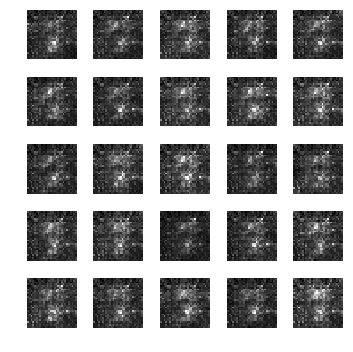

epoch: 71, time: 5.055205 | train_G_Loss: 0.714852, train_D_loss: 2.590765, train_acc: 0.650391
cv_G_Loss: 1.002149, cv_D_loss: 3.629001, cv_acc: 0.356900

epoch: 72, time: 5.024922 | train_G_Loss: 0.846917, train_D_loss: 2.473242, train_acc: 0.595703
cv_G_Loss: 1.218068, cv_D_loss: 4.123916, cv_acc: 0.554800
Model saved

epoch: 73, time: 5.056441 | train_G_Loss: 0.640614, train_D_loss: 2.544047, train_acc: 0.650391
cv_G_Loss: 0.852512, cv_D_loss: 3.169499, cv_acc: 0.435600

epoch: 74, time: 5.026291 | train_G_Loss: 0.815991, train_D_loss: 2.397684, train_acc: 0.666016
cv_G_Loss: 1.379640, cv_D_loss: 4.553122, cv_acc: 0.381100

epoch: 75, time: 5.018047 | train_G_Loss: 0.909748, train_D_loss: 2.410693, train_acc: 0.636719
cv_G_Loss: 1.043157, cv_D_loss: 4.136870, cv_acc: 0.452600

epoch: 76, time: 5.008465 | train_G_Loss: 0.722955, train_D_loss: 2.519186, train_acc: 0.687500
cv_G_Loss: 0.608074, cv_D_loss: 3.453659, cv_acc: 0.510400

epoch: 77, time: 5.012527 | train_G_Loss: 0.908305, 

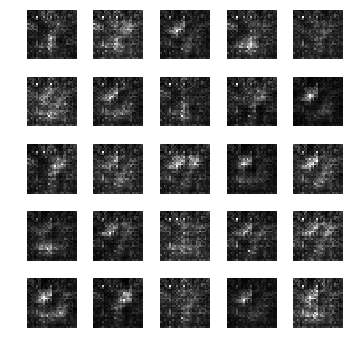

epoch: 81, time: 5.042244 | train_G_Loss: 0.616067, train_D_loss: 2.387403, train_acc: 0.726562
cv_G_Loss: 0.104464, cv_D_loss: 4.121002, cv_acc: 0.558300

epoch: 82, time: 5.011214 | train_G_Loss: 0.652641, train_D_loss: 2.682573, train_acc: 0.699219
cv_G_Loss: 0.816559, cv_D_loss: 4.514206, cv_acc: 0.473700

epoch: 83, time: 5.002379 | train_G_Loss: 0.647069, train_D_loss: 2.258297, train_acc: 0.728516
cv_G_Loss: 0.411569, cv_D_loss: 3.371305, cv_acc: 0.546700

epoch: 84, time: 5.012774 | train_G_Loss: 0.616861, train_D_loss: 2.616507, train_acc: 0.701172
cv_G_Loss: 1.097118, cv_D_loss: 3.500950, cv_acc: 0.626300
Model saved

epoch: 85, time: 5.010111 | train_G_Loss: 0.666087, train_D_loss: 2.635546, train_acc: 0.728516
cv_G_Loss: 0.525187, cv_D_loss: 2.901669, cv_acc: 0.699600
Model saved

epoch: 86, time: 5.014817 | train_G_Loss: 0.653437, train_D_loss: 2.497797, train_acc: 0.697266
cv_G_Loss: 0.638299, cv_D_loss: 3.268332, cv_acc: 0.575400

epoch: 87, time: 4.990023 | train_G_Loss

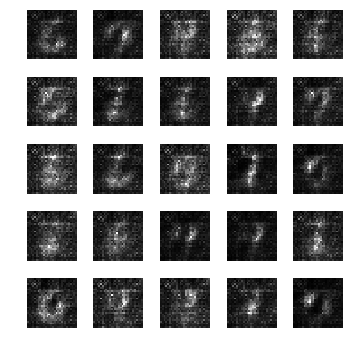

epoch: 91, time: 5.009781 | train_G_Loss: 0.517601, train_D_loss: 2.740556, train_acc: 0.728516
cv_G_Loss: 0.464279, cv_D_loss: 2.961663, cv_acc: 0.710900
Model saved

epoch: 92, time: 5.001557 | train_G_Loss: 0.518067, train_D_loss: 2.705166, train_acc: 0.660156
cv_G_Loss: 0.342132, cv_D_loss: 2.941316, cv_acc: 0.646700

epoch: 93, time: 5.006339 | train_G_Loss: 0.538799, train_D_loss: 2.642203, train_acc: 0.722656
cv_G_Loss: 0.470913, cv_D_loss: 2.758802, cv_acc: 0.649300

epoch: 94, time: 4.986491 | train_G_Loss: 0.843129, train_D_loss: 2.442272, train_acc: 0.759766
cv_G_Loss: 0.998343, cv_D_loss: 3.348838, cv_acc: 0.660300

epoch: 95, time: 5.030054 | train_G_Loss: 0.529275, train_D_loss: 2.446053, train_acc: 0.748047
cv_G_Loss: 0.472140, cv_D_loss: 2.774003, cv_acc: 0.701500

epoch: 96, time: 4.983970 | train_G_Loss: 0.461822, train_D_loss: 2.548434, train_acc: 0.806641
cv_G_Loss: 0.941545, cv_D_loss: 3.229375, cv_acc: 0.683200

epoch: 97, time: 4.989134 | train_G_Loss: 0.488504, 

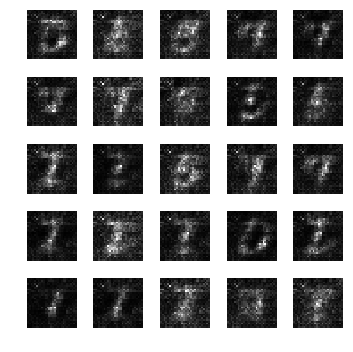

epoch: 101, time: 5.018685 | train_G_Loss: 0.454348, train_D_loss: 2.640416, train_acc: 0.761719
cv_G_Loss: 0.249062, cv_D_loss: 2.840161, cv_acc: 0.755200

epoch: 102, time: 4.980933 | train_G_Loss: 0.555665, train_D_loss: 2.370223, train_acc: 0.808594
cv_G_Loss: 0.627215, cv_D_loss: 2.734897, cv_acc: 0.711000

epoch: 103, time: 4.988275 | train_G_Loss: 0.497930, train_D_loss: 2.392042, train_acc: 0.785156
cv_G_Loss: 0.471581, cv_D_loss: 2.608316, cv_acc: 0.734100

epoch: 104, time: 4.993868 | train_G_Loss: 0.526543, train_D_loss: 2.576662, train_acc: 0.777344
cv_G_Loss: 0.282002, cv_D_loss: 2.756096, cv_acc: 0.753100

epoch: 105, time: 4.987952 | train_G_Loss: 0.699408, train_D_loss: 2.580906, train_acc: 0.771484
cv_G_Loss: 1.449818, cv_D_loss: 3.517333, cv_acc: 0.679700

epoch: 106, time: 4.991697 | train_G_Loss: 0.604472, train_D_loss: 2.398713, train_acc: 0.802734
cv_G_Loss: 0.682212, cv_D_loss: 2.777858, cv_acc: 0.726600

epoch: 107, time: 4.989318 | train_G_Loss: 0.518778, train

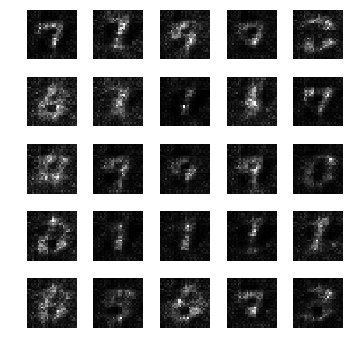

epoch: 111, time: 5.022222 | train_G_Loss: 0.475125, train_D_loss: 2.523664, train_acc: 0.798828
cv_G_Loss: 0.722779, cv_D_loss: 2.707673, cv_acc: 0.759800

epoch: 112, time: 4.991121 | train_G_Loss: 0.470033, train_D_loss: 2.460907, train_acc: 0.800781
cv_G_Loss: 0.502620, cv_D_loss: 2.606245, cv_acc: 0.773700

epoch: 113, time: 4.979158 | train_G_Loss: 0.444975, train_D_loss: 2.689936, train_acc: 0.820312
cv_G_Loss: 0.516543, cv_D_loss: 2.589091, cv_acc: 0.779000

epoch: 114, time: 4.986712 | train_G_Loss: 0.593062, train_D_loss: 2.662531, train_acc: 0.837891
cv_G_Loss: 1.882741, cv_D_loss: 4.081618, cv_acc: 0.776600

epoch: 115, time: 4.994201 | train_G_Loss: 0.564584, train_D_loss: 2.368749, train_acc: 0.835938
cv_G_Loss: 0.322452, cv_D_loss: 2.644193, cv_acc: 0.800900
Model saved

epoch: 116, time: 5.006641 | train_G_Loss: 0.497104, train_D_loss: 2.386264, train_acc: 0.783203
cv_G_Loss: 1.081933, cv_D_loss: 3.253025, cv_acc: 0.769400

epoch: 117, time: 5.027400 | train_G_Loss: 0.3

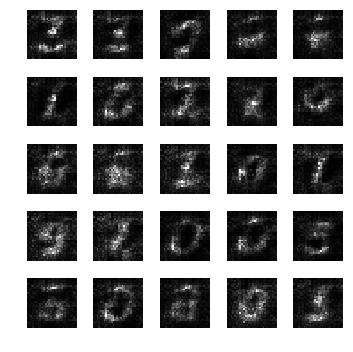

epoch: 121, time: 4.986208 | train_G_Loss: 0.493704, train_D_loss: 2.528609, train_acc: 0.822266
cv_G_Loss: 1.252811, cv_D_loss: 3.258284, cv_acc: 0.800300

epoch: 122, time: 4.985102 | train_G_Loss: 0.386272, train_D_loss: 2.479743, train_acc: 0.753906
cv_G_Loss: 0.302353, cv_D_loss: 2.702246, cv_acc: 0.795000

epoch: 123, time: 4.988959 | train_G_Loss: 0.382524, train_D_loss: 2.749074, train_acc: 0.730469
cv_G_Loss: 0.127686, cv_D_loss: 3.204133, cv_acc: 0.796000

epoch: 124, time: 4.977296 | train_G_Loss: 0.456493, train_D_loss: 2.870087, train_acc: 0.779297
cv_G_Loss: 0.206258, cv_D_loss: 2.890741, cv_acc: 0.790700

epoch: 125, time: 4.995263 | train_G_Loss: 0.806864, train_D_loss: 2.839450, train_acc: 0.763672
cv_G_Loss: 1.080110, cv_D_loss: 3.226081, cv_acc: 0.763900

epoch: 126, time: 4.981492 | train_G_Loss: 0.583636, train_D_loss: 2.750470, train_acc: 0.744141
cv_G_Loss: 0.592029, cv_D_loss: 2.583399, cv_acc: 0.807100
Model saved

epoch: 127, time: 5.001857 | train_G_Loss: 0.5

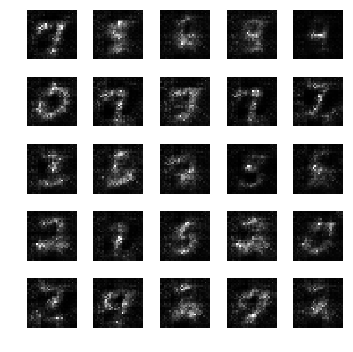

epoch: 131, time: 4.999153 | train_G_Loss: 0.484801, train_D_loss: 2.437006, train_acc: 0.843750
cv_G_Loss: 0.796312, cv_D_loss: 3.025175, cv_acc: 0.781000

epoch: 132, time: 4.971355 | train_G_Loss: 0.611920, train_D_loss: 2.594689, train_acc: 0.757812
cv_G_Loss: 0.131476, cv_D_loss: 3.194418, cv_acc: 0.797600

epoch: 133, time: 4.981462 | train_G_Loss: 0.407785, train_D_loss: 2.863403, train_acc: 0.792969
cv_G_Loss: 1.175532, cv_D_loss: 3.363409, cv_acc: 0.777700

epoch: 134, time: 4.972680 | train_G_Loss: 0.505915, train_D_loss: 2.406731, train_acc: 0.865234
cv_G_Loss: 4.340589, cv_D_loss: 9.211144, cv_acc: 0.774500

epoch: 135, time: 4.951170 | train_G_Loss: 0.428700, train_D_loss: 2.576259, train_acc: 0.822266
cv_G_Loss: 0.741390, cv_D_loss: 2.835514, cv_acc: 0.801200

epoch: 136, time: 4.974719 | train_G_Loss: 0.450145, train_D_loss: 2.713526, train_acc: 0.820312
cv_G_Loss: 0.476115, cv_D_loss: 2.575870, cv_acc: 0.805800

epoch: 137, time: 4.966828 | train_G_Loss: 0.553520, train

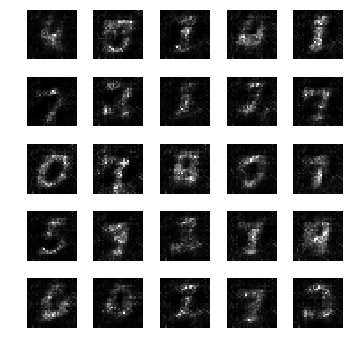

epoch: 141, time: 5.004217 | train_G_Loss: 0.723780, train_D_loss: 2.597031, train_acc: 0.828125
cv_G_Loss: 1.215522, cv_D_loss: 3.405150, cv_acc: 0.794500

epoch: 142, time: 4.978200 | train_G_Loss: 0.425692, train_D_loss: 2.529610, train_acc: 0.830078
cv_G_Loss: 0.274783, cv_D_loss: 2.754594, cv_acc: 0.805700

epoch: 143, time: 4.987276 | train_G_Loss: 0.360148, train_D_loss: 2.531617, train_acc: 0.800781
cv_G_Loss: 0.264412, cv_D_loss: 2.747520, cv_acc: 0.817400

epoch: 144, time: 4.967145 | train_G_Loss: 0.383091, train_D_loss: 2.801828, train_acc: 0.818359
cv_G_Loss: 0.137654, cv_D_loss: 3.088551, cv_acc: 0.806100

epoch: 145, time: 4.974706 | train_G_Loss: 0.471480, train_D_loss: 2.500126, train_acc: 0.857422
cv_G_Loss: 1.417931, cv_D_loss: 3.680133, cv_acc: 0.819800
Model saved

epoch: 146, time: 4.993004 | train_G_Loss: 0.612380, train_D_loss: 2.521432, train_acc: 0.845703
cv_G_Loss: 0.834310, cv_D_loss: 3.006494, cv_acc: 0.817800

epoch: 147, time: 4.968188 | train_G_Loss: 0.6

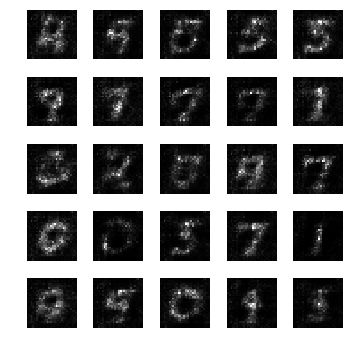

epoch: 151, time: 5.003568 | train_G_Loss: 0.396562, train_D_loss: 3.231780, train_acc: 0.740234
cv_G_Loss: 0.171010, cv_D_loss: 2.979187, cv_acc: 0.799900

epoch: 152, time: 4.975062 | train_G_Loss: 0.565439, train_D_loss: 2.713732, train_acc: 0.816406
cv_G_Loss: 1.933673, cv_D_loss: 4.637010, cv_acc: 0.818400

epoch: 153, time: 4.972846 | train_G_Loss: 0.680727, train_D_loss: 2.584197, train_acc: 0.802734
cv_G_Loss: 1.786796, cv_D_loss: 4.631896, cv_acc: 0.803000

epoch: 154, time: 4.979667 | train_G_Loss: 0.403224, train_D_loss: 2.835796, train_acc: 0.792969
cv_G_Loss: 0.826715, cv_D_loss: 2.882507, cv_acc: 0.815100

epoch: 155, time: 4.966191 | train_G_Loss: 0.382630, train_D_loss: 2.684529, train_acc: 0.798828
cv_G_Loss: 0.838853, cv_D_loss: 3.064289, cv_acc: 0.810600

epoch: 156, time: 4.962849 | train_G_Loss: 0.384665, train_D_loss: 2.464153, train_acc: 0.796875
cv_G_Loss: 0.781424, cv_D_loss: 2.883179, cv_acc: 0.810300

epoch: 157, time: 4.961858 | train_G_Loss: 0.473000, train

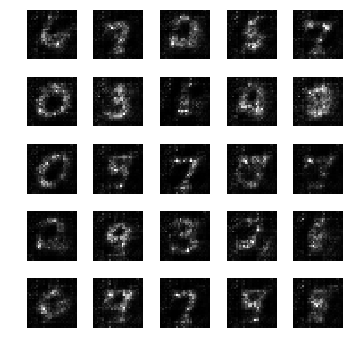

epoch: 161, time: 5.012957 | train_G_Loss: 0.463579, train_D_loss: 2.385718, train_acc: 0.826172
cv_G_Loss: 0.486595, cv_D_loss: 2.540120, cv_acc: 0.821500

epoch: 162, time: 4.944980 | train_G_Loss: 0.396817, train_D_loss: 2.748798, train_acc: 0.785156
cv_G_Loss: 0.522496, cv_D_loss: 2.648576, cv_acc: 0.825900

epoch: 163, time: 4.949181 | train_G_Loss: 0.362574, train_D_loss: 2.596024, train_acc: 0.849609
cv_G_Loss: 0.449356, cv_D_loss: 2.589524, cv_acc: 0.826100

epoch: 164, time: 4.951902 | train_G_Loss: 0.507284, train_D_loss: 2.370846, train_acc: 0.845703
cv_G_Loss: 1.596040, cv_D_loss: 4.237422, cv_acc: 0.812200

epoch: 165, time: 4.949922 | train_G_Loss: 0.374709, train_D_loss: 2.538011, train_acc: 0.818359
cv_G_Loss: 0.346709, cv_D_loss: 2.673231, cv_acc: 0.831400
Model saved

epoch: 166, time: 4.975709 | train_G_Loss: 0.395335, train_D_loss: 2.626384, train_acc: 0.835938
cv_G_Loss: 0.555820, cv_D_loss: 2.757370, cv_acc: 0.815400

epoch: 167, time: 4.950782 | train_G_Loss: 0.4

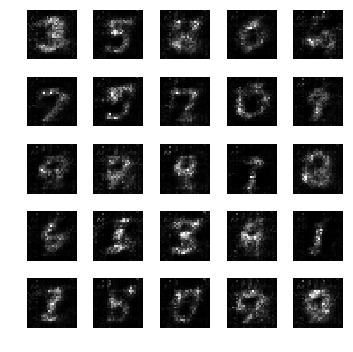

epoch: 171, time: 4.965233 | train_G_Loss: 0.510329, train_D_loss: 2.518847, train_acc: 0.867188
cv_G_Loss: 0.835232, cv_D_loss: 3.002264, cv_acc: 0.827200

epoch: 172, time: 4.941086 | train_G_Loss: 0.408139, train_D_loss: 2.491348, train_acc: 0.869141
cv_G_Loss: 0.138677, cv_D_loss: 3.046996, cv_acc: 0.831400

epoch: 173, time: 4.950177 | train_G_Loss: 0.461360, train_D_loss: 2.451900, train_acc: 0.853516
cv_G_Loss: 1.224017, cv_D_loss: 3.471128, cv_acc: 0.817400

epoch: 174, time: 4.951484 | train_G_Loss: 0.345500, train_D_loss: 2.602239, train_acc: 0.855469
cv_G_Loss: 0.386367, cv_D_loss: 2.664073, cv_acc: 0.823300

epoch: 175, time: 4.944309 | train_G_Loss: 0.471632, train_D_loss: 2.632163, train_acc: 0.859375
cv_G_Loss: 0.624595, cv_D_loss: 2.765428, cv_acc: 0.831600

epoch: 176, time: 4.949838 | train_G_Loss: 0.472905, train_D_loss: 2.324007, train_acc: 0.843750
cv_G_Loss: 0.259453, cv_D_loss: 2.703695, cv_acc: 0.830900

epoch: 177, time: 4.945623 | train_G_Loss: 0.416765, train

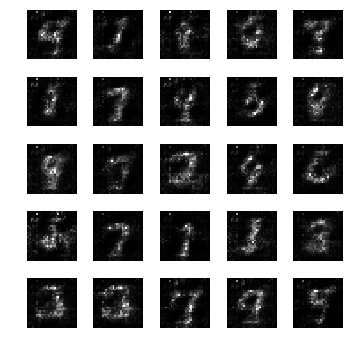

epoch: 181, time: 4.964536 | train_G_Loss: 0.452629, train_D_loss: 2.397759, train_acc: 0.910156
cv_G_Loss: 0.177652, cv_D_loss: 2.951421, cv_acc: 0.824000

epoch: 182, time: 4.937916 | train_G_Loss: 0.437770, train_D_loss: 2.375410, train_acc: 0.935547
cv_G_Loss: 0.771425, cv_D_loss: 2.863452, cv_acc: 0.833400

epoch: 183, time: 4.948986 | train_G_Loss: 0.451538, train_D_loss: 2.233580, train_acc: 0.908203
cv_G_Loss: 0.426143, cv_D_loss: 2.656005, cv_acc: 0.831900

epoch: 184, time: 4.959683 | train_G_Loss: 0.362762, train_D_loss: 2.577507, train_acc: 0.863281
cv_G_Loss: 0.315367, cv_D_loss: 2.680707, cv_acc: 0.828300

epoch: 185, time: 4.955994 | train_G_Loss: 0.596768, train_D_loss: 2.418143, train_acc: 0.878906
cv_G_Loss: 1.023469, cv_D_loss: 3.091108, cv_acc: 0.839300
Model saved

epoch: 186, time: 4.981792 | train_G_Loss: 0.415330, train_D_loss: 2.375083, train_acc: 0.849609
cv_G_Loss: 1.080710, cv_D_loss: 3.319874, cv_acc: 0.816900

epoch: 187, time: 4.960287 | train_G_Loss: 0.4

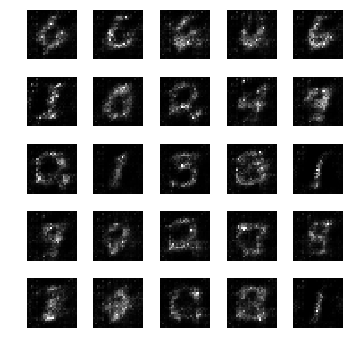

epoch: 191, time: 4.999933 | train_G_Loss: 0.410227, train_D_loss: 2.475348, train_acc: 0.859375
cv_G_Loss: 0.596317, cv_D_loss: 2.724400, cv_acc: 0.813500

epoch: 192, time: 4.965479 | train_G_Loss: 0.363772, train_D_loss: 2.517622, train_acc: 0.843750
cv_G_Loss: 1.028483, cv_D_loss: 3.172709, cv_acc: 0.841900

epoch: 193, time: 4.977932 | train_G_Loss: 0.417836, train_D_loss: 2.737139, train_acc: 0.822266
cv_G_Loss: 1.492358, cv_D_loss: 3.866675, cv_acc: 0.819400

epoch: 194, time: 4.959901 | train_G_Loss: 0.332102, train_D_loss: 2.908991, train_acc: 0.828125
cv_G_Loss: 0.633061, cv_D_loss: 2.730935, cv_acc: 0.814200

epoch: 195, time: 4.971580 | train_G_Loss: 0.462303, train_D_loss: 2.643825, train_acc: 0.824219
cv_G_Loss: 0.241443, cv_D_loss: 2.801976, cv_acc: 0.826400

epoch: 196, time: 4.980009 | train_G_Loss: 0.460788, train_D_loss: 2.655407, train_acc: 0.820312
cv_G_Loss: 0.496173, cv_D_loss: 2.767945, cv_acc: 0.823700

epoch: 197, time: 4.972924 | train_G_Loss: 0.402961, train

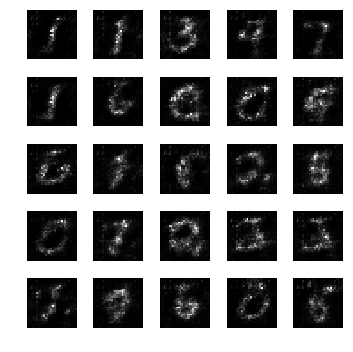

epoch: 201, time: 4.999381 | train_G_Loss: 0.441734, train_D_loss: 2.609570, train_acc: 0.835938
cv_G_Loss: 0.893312, cv_D_loss: 2.999137, cv_acc: 0.824400

epoch: 202, time: 4.976102 | train_G_Loss: 0.467410, train_D_loss: 2.547259, train_acc: 0.875000
cv_G_Loss: 0.286194, cv_D_loss: 2.672297, cv_acc: 0.836500

epoch: 203, time: 4.972544 | train_G_Loss: 0.433113, train_D_loss: 2.434082, train_acc: 0.847656
cv_G_Loss: 0.688599, cv_D_loss: 2.831403, cv_acc: 0.803700

epoch: 204, time: 4.970859 | train_G_Loss: 0.233862, train_D_loss: 2.852809, train_acc: 0.857422
cv_G_Loss: 0.080615, cv_D_loss: 3.425223, cv_acc: 0.841800

epoch: 205, time: 4.971144 | train_G_Loss: 0.510864, train_D_loss: 2.381105, train_acc: 0.873047
cv_G_Loss: 1.096502, cv_D_loss: 3.323314, cv_acc: 0.831700

epoch: 206, time: 5.018413 | train_G_Loss: 0.449051, train_D_loss: 2.463238, train_acc: 0.863281
cv_G_Loss: 0.376531, cv_D_loss: 2.624569, cv_acc: 0.834900

epoch: 207, time: 4.972813 | train_G_Loss: 0.408688, train

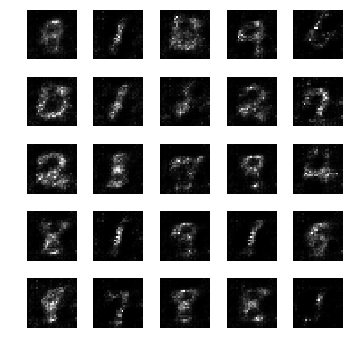

epoch: 211, time: 4.974353 | train_G_Loss: 0.338451, train_D_loss: 2.634405, train_acc: 0.820312
cv_G_Loss: 0.495083, cv_D_loss: 2.563634, cv_acc: 0.851100
Model saved

epoch: 212, time: 4.996958 | train_G_Loss: 0.507625, train_D_loss: 2.750909, train_acc: 0.802734
cv_G_Loss: 1.385284, cv_D_loss: 3.824592, cv_acc: 0.822000

epoch: 213, time: 4.959247 | train_G_Loss: 0.317574, train_D_loss: 2.649780, train_acc: 0.794922
cv_G_Loss: 0.102250, cv_D_loss: 3.334900, cv_acc: 0.800200

epoch: 214, time: 4.958334 | train_G_Loss: 0.377956, train_D_loss: 2.617808, train_acc: 0.865234
cv_G_Loss: 0.865355, cv_D_loss: 3.039249, cv_acc: 0.838900

epoch: 215, time: 4.987158 | train_G_Loss: 0.430494, train_D_loss: 2.434524, train_acc: 0.869141
cv_G_Loss: 1.387801, cv_D_loss: 3.699977, cv_acc: 0.840600

epoch: 216, time: 4.969013 | train_G_Loss: 0.355231, train_D_loss: 2.550426, train_acc: 0.824219
cv_G_Loss: 1.264186, cv_D_loss: 3.476063, cv_acc: 0.836200

epoch: 217, time: 4.974708 | train_G_Loss: 0.5

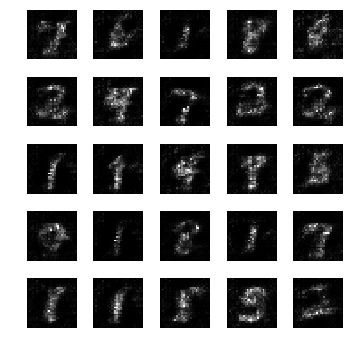

epoch: 221, time: 4.970175 | train_G_Loss: 0.455495, train_D_loss: 2.578655, train_acc: 0.876953
cv_G_Loss: 2.176398, cv_D_loss: 5.178825, cv_acc: 0.844600

epoch: 222, time: 4.943255 | train_G_Loss: 0.394262, train_D_loss: 2.477216, train_acc: 0.820312
cv_G_Loss: 1.114622, cv_D_loss: 3.321175, cv_acc: 0.829900

epoch: 223, time: 4.954395 | train_G_Loss: 0.358070, train_D_loss: 2.776227, train_acc: 0.820312
cv_G_Loss: 0.717380, cv_D_loss: 2.771404, cv_acc: 0.850100

epoch: 224, time: 4.947248 | train_G_Loss: 0.372048, train_D_loss: 2.480512, train_acc: 0.855469
cv_G_Loss: 0.575333, cv_D_loss: 2.835843, cv_acc: 0.816100

epoch: 225, time: 4.951281 | train_G_Loss: 0.490587, train_D_loss: 2.513562, train_acc: 0.869141
cv_G_Loss: 0.583887, cv_D_loss: 2.627678, cv_acc: 0.851300

epoch: 226, time: 4.955835 | train_G_Loss: 0.436644, train_D_loss: 2.692908, train_acc: 0.843750
cv_G_Loss: 1.119204, cv_D_loss: 3.270060, cv_acc: 0.855500
Model saved

epoch: 227, time: 4.973656 | train_G_Loss: 0.3

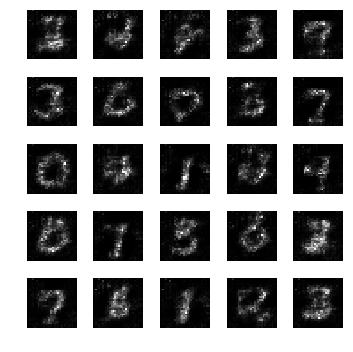

epoch: 231, time: 5.005061 | train_G_Loss: 0.312896, train_D_loss: 2.473255, train_acc: 0.869141
cv_G_Loss: 1.145064, cv_D_loss: 3.347772, cv_acc: 0.840700

epoch: 232, time: 4.986801 | train_G_Loss: 0.522741, train_D_loss: 2.517921, train_acc: 0.896484
cv_G_Loss: 0.587270, cv_D_loss: 2.620485, cv_acc: 0.857700
Model saved

epoch: 233, time: 5.016350 | train_G_Loss: 0.473692, train_D_loss: 2.445992, train_acc: 0.878906
cv_G_Loss: 0.676790, cv_D_loss: 2.731786, cv_acc: 0.849100

epoch: 234, time: 4.979060 | train_G_Loss: 0.275216, train_D_loss: 2.705832, train_acc: 0.855469
cv_G_Loss: 0.599808, cv_D_loss: 2.696339, cv_acc: 0.843500

epoch: 235, time: 4.995481 | train_G_Loss: 0.406917, train_D_loss: 2.459056, train_acc: 0.873047
cv_G_Loss: 0.686592, cv_D_loss: 2.701837, cv_acc: 0.859100
Model saved

epoch: 236, time: 4.968549 | train_G_Loss: 0.415268, train_D_loss: 2.381584, train_acc: 0.865234
cv_G_Loss: 0.709762, cv_D_loss: 2.808230, cv_acc: 0.855700

epoch: 237, time: 4.938247 | train

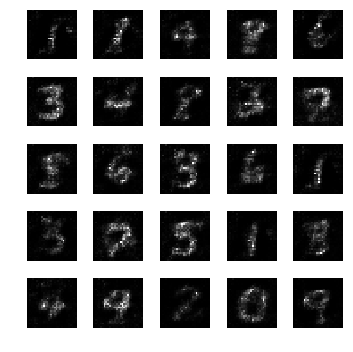

epoch: 241, time: 4.979586 | train_G_Loss: 0.444635, train_D_loss: 2.485655, train_acc: 0.890625
cv_G_Loss: 0.789147, cv_D_loss: 2.863968, cv_acc: 0.849500

epoch: 242, time: 4.946529 | train_G_Loss: 0.381927, train_D_loss: 2.568239, train_acc: 0.902344
cv_G_Loss: 0.835432, cv_D_loss: 2.870916, cv_acc: 0.843600

epoch: 243, time: 4.954633 | train_G_Loss: 0.431716, train_D_loss: 2.356091, train_acc: 0.869141
cv_G_Loss: 0.467236, cv_D_loss: 2.550505, cv_acc: 0.860900
Model saved

epoch: 244, time: 5.017426 | train_G_Loss: 0.460604, train_D_loss: 2.537004, train_acc: 0.847656
cv_G_Loss: 0.512940, cv_D_loss: 2.592546, cv_acc: 0.854800

epoch: 245, time: 4.988390 | train_G_Loss: 0.384129, train_D_loss: 2.428250, train_acc: 0.833984
cv_G_Loss: 0.678889, cv_D_loss: 2.727453, cv_acc: 0.851100

epoch: 246, time: 4.975316 | train_G_Loss: 0.361655, train_D_loss: 2.641227, train_acc: 0.851562
cv_G_Loss: 0.838135, cv_D_loss: 2.833877, cv_acc: 0.861700
Model saved

epoch: 247, time: 5.014195 | train

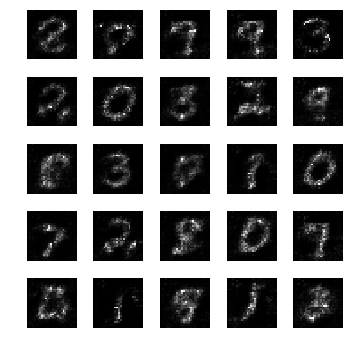

epoch: 251, time: 4.967397 | train_G_Loss: 0.361615, train_D_loss: 2.496339, train_acc: 0.855469
cv_G_Loss: 0.312525, cv_D_loss: 2.589050, cv_acc: 0.866300

epoch: 252, time: 4.943381 | train_G_Loss: 0.379273, train_D_loss: 2.573019, train_acc: 0.832031
cv_G_Loss: 0.180706, cv_D_loss: 2.860619, cv_acc: 0.858000

epoch: 253, time: 4.954465 | train_G_Loss: 0.578094, train_D_loss: 2.693521, train_acc: 0.839844
cv_G_Loss: 0.925229, cv_D_loss: 3.091075, cv_acc: 0.858300

epoch: 254, time: 4.940674 | train_G_Loss: 0.584496, train_D_loss: 2.574370, train_acc: 0.867188
cv_G_Loss: 0.716080, cv_D_loss: 2.780564, cv_acc: 0.859500

epoch: 255, time: 4.943651 | train_G_Loss: 0.415919, train_D_loss: 2.585261, train_acc: 0.898438
cv_G_Loss: 0.258933, cv_D_loss: 2.661159, cv_acc: 0.862900

epoch: 256, time: 4.955447 | train_G_Loss: 0.370325, train_D_loss: 2.475149, train_acc: 0.882812
cv_G_Loss: 0.641257, cv_D_loss: 2.687201, cv_acc: 0.860100

epoch: 257, time: 4.952306 | train_G_Loss: 0.380281, train

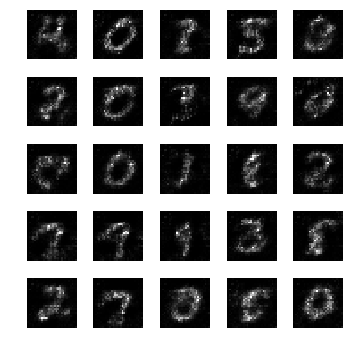

epoch: 261, time: 4.979189 | train_G_Loss: 0.407610, train_D_loss: 2.624197, train_acc: 0.847656
cv_G_Loss: 0.439960, cv_D_loss: 2.573200, cv_acc: 0.856800

epoch: 262, time: 4.989733 | train_G_Loss: 0.366770, train_D_loss: 2.534605, train_acc: 0.855469
cv_G_Loss: 0.350343, cv_D_loss: 2.558385, cv_acc: 0.863200

epoch: 263, time: 4.951436 | train_G_Loss: 0.392638, train_D_loss: 2.624989, train_acc: 0.873047
cv_G_Loss: 1.282148, cv_D_loss: 3.514014, cv_acc: 0.855000

epoch: 264, time: 4.961852 | train_G_Loss: 0.379569, train_D_loss: 2.387576, train_acc: 0.869141
cv_G_Loss: 0.356929, cv_D_loss: 2.597412, cv_acc: 0.851300

epoch: 265, time: 4.947350 | train_G_Loss: 0.456485, train_D_loss: 2.511294, train_acc: 0.863281
cv_G_Loss: 0.859593, cv_D_loss: 2.879703, cv_acc: 0.866000

epoch: 266, time: 4.977870 | train_G_Loss: 0.343219, train_D_loss: 2.532349, train_acc: 0.853516
cv_G_Loss: 0.144463, cv_D_loss: 2.968030, cv_acc: 0.855200

epoch: 267, time: 4.954925 | train_G_Loss: 0.396762, train

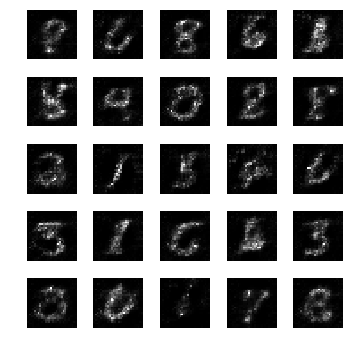

epoch: 271, time: 4.995072 | train_G_Loss: 0.387487, train_D_loss: 2.696035, train_acc: 0.835938
cv_G_Loss: 0.740289, cv_D_loss: 2.780699, cv_acc: 0.869700

epoch: 272, time: 5.034159 | train_G_Loss: 0.421832, train_D_loss: 2.475538, train_acc: 0.822266
cv_G_Loss: 0.204613, cv_D_loss: 2.735052, cv_acc: 0.861400

epoch: 273, time: 4.973980 | train_G_Loss: 0.436272, train_D_loss: 2.758595, train_acc: 0.818359
cv_G_Loss: 0.202081, cv_D_loss: 2.759058, cv_acc: 0.869300

epoch: 274, time: 4.982364 | train_G_Loss: 0.418850, train_D_loss: 2.645060, train_acc: 0.841797
cv_G_Loss: 0.801080, cv_D_loss: 2.832179, cv_acc: 0.866100

epoch: 275, time: 4.987188 | train_G_Loss: 0.348409, train_D_loss: 2.623791, train_acc: 0.835938
cv_G_Loss: 0.069491, cv_D_loss: 3.517173, cv_acc: 0.860400

epoch: 276, time: 4.974434 | train_G_Loss: 0.413545, train_D_loss: 2.495145, train_acc: 0.828125
cv_G_Loss: 0.922084, cv_D_loss: 2.981355, cv_acc: 0.861300

epoch: 277, time: 4.985447 | train_G_Loss: 0.475540, train

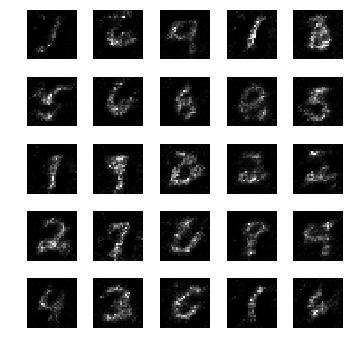

epoch: 281, time: 5.011148 | train_G_Loss: 0.466528, train_D_loss: 2.624474, train_acc: 0.865234
cv_G_Loss: 0.745762, cv_D_loss: 2.783311, cv_acc: 0.840400

epoch: 282, time: 4.977663 | train_G_Loss: 0.379837, train_D_loss: 2.478419, train_acc: 0.873047
cv_G_Loss: 0.352413, cv_D_loss: 2.565792, cv_acc: 0.867900

epoch: 283, time: 4.983638 | train_G_Loss: 0.363891, train_D_loss: 2.468962, train_acc: 0.910156
cv_G_Loss: 0.462747, cv_D_loss: 2.766834, cv_acc: 0.835700

epoch: 284, time: 4.977625 | train_G_Loss: 0.435029, train_D_loss: 2.221123, train_acc: 0.916016
cv_G_Loss: 1.575050, cv_D_loss: 4.071058, cv_acc: 0.855900

epoch: 285, time: 4.985276 | train_G_Loss: 0.530579, train_D_loss: 2.379619, train_acc: 0.892578
cv_G_Loss: 0.093644, cv_D_loss: 3.301231, cv_acc: 0.852400

epoch: 286, time: 4.967947 | train_G_Loss: 0.370831, train_D_loss: 2.550925, train_acc: 0.853516
cv_G_Loss: 0.592118, cv_D_loss: 2.707179, cv_acc: 0.857500

epoch: 287, time: 4.976357 | train_G_Loss: 0.372320, train

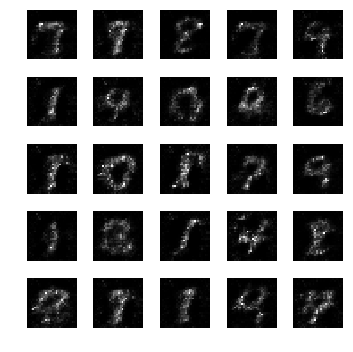

epoch: 291, time: 5.001144 | train_G_Loss: 0.266335, train_D_loss: 2.740087, train_acc: 0.863281
cv_G_Loss: 0.166725, cv_D_loss: 2.878269, cv_acc: 0.859000

epoch: 292, time: 4.975679 | train_G_Loss: 0.375105, train_D_loss: 2.389031, train_acc: 0.894531
cv_G_Loss: 0.301376, cv_D_loss: 2.588130, cv_acc: 0.868600

epoch: 293, time: 4.978139 | train_G_Loss: 0.368858, train_D_loss: 2.497397, train_acc: 0.900391
cv_G_Loss: 0.394842, cv_D_loss: 2.566098, cv_acc: 0.861800

epoch: 294, time: 5.077282 | train_G_Loss: 0.448182, train_D_loss: 2.591409, train_acc: 0.857422
cv_G_Loss: 0.685097, cv_D_loss: 2.721878, cv_acc: 0.874800
Model saved

epoch: 295, time: 5.013542 | train_G_Loss: 0.407304, train_D_loss: 2.562582, train_acc: 0.794922
cv_G_Loss: 0.327154, cv_D_loss: 2.568511, cv_acc: 0.872600

epoch: 296, time: 4.979112 | train_G_Loss: 0.383355, train_D_loss: 2.843662, train_acc: 0.816406
cv_G_Loss: 0.152292, cv_D_loss: 2.940146, cv_acc: 0.846600

epoch: 297, time: 4.986539 | train_G_Loss: 0.4

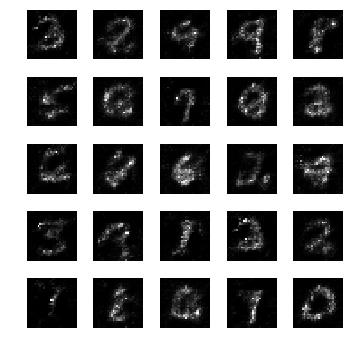

epoch: 301, time: 5.015983 | train_G_Loss: 0.438620, train_D_loss: 2.346534, train_acc: 0.878906
cv_G_Loss: 0.550323, cv_D_loss: 2.587801, cv_acc: 0.859500

epoch: 302, time: 4.977759 | train_G_Loss: 0.431208, train_D_loss: 2.462572, train_acc: 0.849609
cv_G_Loss: 0.791525, cv_D_loss: 2.913246, cv_acc: 0.865700

epoch: 303, time: 4.979705 | train_G_Loss: 0.348373, train_D_loss: 2.595219, train_acc: 0.871094
cv_G_Loss: 0.800171, cv_D_loss: 2.904197, cv_acc: 0.865600

epoch: 304, time: 4.987324 | train_G_Loss: 0.315404, train_D_loss: 2.695466, train_acc: 0.867188
cv_G_Loss: 0.146328, cv_D_loss: 2.920223, cv_acc: 0.866500

epoch: 305, time: 4.988302 | train_G_Loss: 0.486623, train_D_loss: 2.531554, train_acc: 0.888672
cv_G_Loss: 0.812802, cv_D_loss: 2.897148, cv_acc: 0.867900

epoch: 306, time: 4.975213 | train_G_Loss: 0.448751, train_D_loss: 2.538898, train_acc: 0.882812
cv_G_Loss: 0.827469, cv_D_loss: 2.970105, cv_acc: 0.877200
Model saved

epoch: 307, time: 5.005868 | train_G_Loss: 0.4

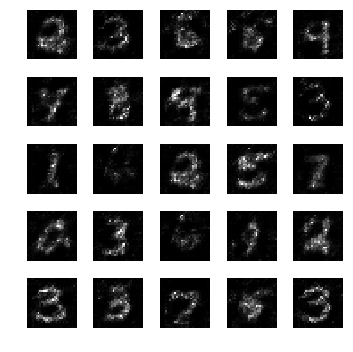

epoch: 311, time: 4.991554 | train_G_Loss: 0.445293, train_D_loss: 2.471605, train_acc: 0.833984
cv_G_Loss: 0.625155, cv_D_loss: 2.701636, cv_acc: 0.873500

epoch: 312, time: 4.980977 | train_G_Loss: 0.448595, train_D_loss: 2.767389, train_acc: 0.830078
cv_G_Loss: 0.652212, cv_D_loss: 2.708402, cv_acc: 0.875900

epoch: 313, time: 4.962376 | train_G_Loss: 0.429097, train_D_loss: 2.699412, train_acc: 0.859375
cv_G_Loss: 0.871696, cv_D_loss: 3.001588, cv_acc: 0.872000

epoch: 314, time: 4.975284 | train_G_Loss: 0.400553, train_D_loss: 2.472727, train_acc: 0.849609
cv_G_Loss: 1.061910, cv_D_loss: 3.224929, cv_acc: 0.876200

epoch: 315, time: 4.988142 | train_G_Loss: 0.378070, train_D_loss: 2.723208, train_acc: 0.888672
cv_G_Loss: 0.742099, cv_D_loss: 2.778648, cv_acc: 0.875900

epoch: 316, time: 4.984010 | train_G_Loss: 0.346593, train_D_loss: 2.392636, train_acc: 0.896484
cv_G_Loss: 0.506355, cv_D_loss: 2.656224, cv_acc: 0.862500

epoch: 317, time: 5.024582 | train_G_Loss: 0.386303, train

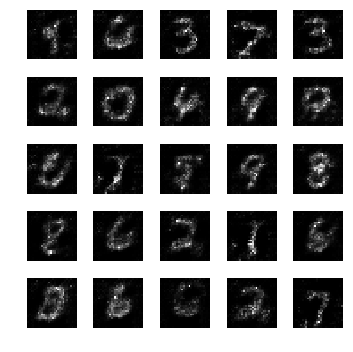

epoch: 321, time: 4.978686 | train_G_Loss: 0.332419, train_D_loss: 2.650270, train_acc: 0.857422
cv_G_Loss: 0.421971, cv_D_loss: 2.581478, cv_acc: 0.857300

epoch: 322, time: 4.950178 | train_G_Loss: 0.436671, train_D_loss: 2.629240, train_acc: 0.876953
cv_G_Loss: 0.286160, cv_D_loss: 2.566609, cv_acc: 0.883200
Model saved

epoch: 323, time: 5.020290 | train_G_Loss: 0.434057, train_D_loss: 2.755749, train_acc: 0.837891
cv_G_Loss: 0.221596, cv_D_loss: 2.693531, cv_acc: 0.872000

epoch: 324, time: 4.976635 | train_G_Loss: 0.275223, train_D_loss: 2.600722, train_acc: 0.871094
cv_G_Loss: 0.183238, cv_D_loss: 2.815011, cv_acc: 0.860900

epoch: 325, time: 4.984404 | train_G_Loss: 0.294733, train_D_loss: 2.664684, train_acc: 0.867188
cv_G_Loss: 0.934212, cv_D_loss: 3.034825, cv_acc: 0.874200

epoch: 326, time: 4.990582 | train_G_Loss: 0.360043, train_D_loss: 2.704830, train_acc: 0.876953
cv_G_Loss: 0.642957, cv_D_loss: 2.661243, cv_acc: 0.877000

epoch: 327, time: 4.987643 | train_G_Loss: 0.3

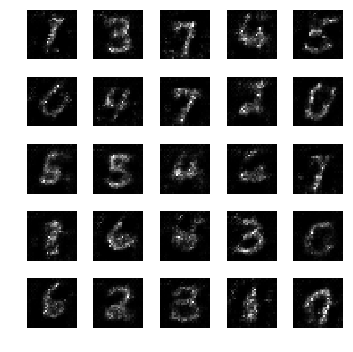

epoch: 331, time: 5.013339 | train_G_Loss: 0.357564, train_D_loss: 2.373893, train_acc: 0.890625
cv_G_Loss: 0.712556, cv_D_loss: 2.751908, cv_acc: 0.881300

epoch: 332, time: 4.971258 | train_G_Loss: 0.415694, train_D_loss: 2.461603, train_acc: 0.896484
cv_G_Loss: 1.003849, cv_D_loss: 3.089992, cv_acc: 0.879900

epoch: 333, time: 4.977494 | train_G_Loss: 0.450054, train_D_loss: 2.470674, train_acc: 0.888672
cv_G_Loss: 0.967340, cv_D_loss: 3.086927, cv_acc: 0.872500

epoch: 334, time: 4.986184 | train_G_Loss: 0.293202, train_D_loss: 2.492469, train_acc: 0.878906
cv_G_Loss: 0.716402, cv_D_loss: 2.729963, cv_acc: 0.884600
Model saved

epoch: 335, time: 5.000468 | train_G_Loss: 0.286347, train_D_loss: 2.816810, train_acc: 0.875000
cv_G_Loss: 0.122816, cv_D_loss: 3.035058, cv_acc: 0.884100

epoch: 336, time: 4.986289 | train_G_Loss: 0.311860, train_D_loss: 2.447490, train_acc: 0.835938
cv_G_Loss: 0.262444, cv_D_loss: 2.607882, cv_acc: 0.881200

epoch: 337, time: 4.985786 | train_G_Loss: 0.4

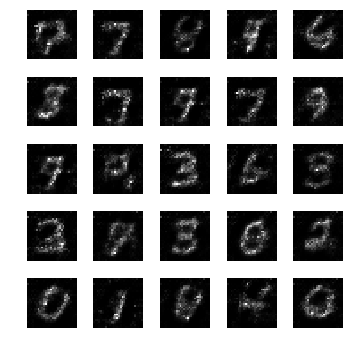

epoch: 341, time: 5.007659 | train_G_Loss: 0.293037, train_D_loss: 2.621121, train_acc: 0.863281
cv_G_Loss: 0.317527, cv_D_loss: 2.536005, cv_acc: 0.887300
Model saved

epoch: 342, time: 5.005898 | train_G_Loss: 0.325600, train_D_loss: 2.511372, train_acc: 0.855469
cv_G_Loss: 0.206783, cv_D_loss: 2.699614, cv_acc: 0.888700
Model saved

epoch: 343, time: 4.998699 | train_G_Loss: 0.689071, train_D_loss: 2.658061, train_acc: 0.914062
cv_G_Loss: 0.852833, cv_D_loss: 2.932112, cv_acc: 0.888900
Model saved

epoch: 344, time: 5.014354 | train_G_Loss: 0.446894, train_D_loss: 2.380663, train_acc: 0.892578
cv_G_Loss: 0.822801, cv_D_loss: 2.930374, cv_acc: 0.886200

epoch: 345, time: 5.001491 | train_G_Loss: 0.235787, train_D_loss: 2.659384, train_acc: 0.857422
cv_G_Loss: 0.490036, cv_D_loss: 2.663891, cv_acc: 0.860800

epoch: 346, time: 4.999964 | train_G_Loss: 0.385242, train_D_loss: 2.610388, train_acc: 0.904297
cv_G_Loss: 0.634284, cv_D_loss: 2.645964, cv_acc: 0.883400

epoch: 347, time: 4.99

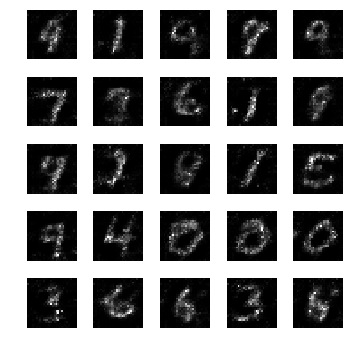

epoch: 351, time: 4.995342 | train_G_Loss: 0.310925, train_D_loss: 2.447393, train_acc: 0.875000
cv_G_Loss: 0.177778, cv_D_loss: 2.787468, cv_acc: 0.878000

epoch: 352, time: 4.962959 | train_G_Loss: 0.349332, train_D_loss: 2.723741, train_acc: 0.896484
cv_G_Loss: 0.188981, cv_D_loss: 2.741343, cv_acc: 0.883800

epoch: 353, time: 4.956633 | train_G_Loss: 0.496641, train_D_loss: 2.416334, train_acc: 0.914062
cv_G_Loss: 0.572544, cv_D_loss: 2.585538, cv_acc: 0.889300
Model saved

epoch: 354, time: 5.003218 | train_G_Loss: 0.471142, train_D_loss: 2.434576, train_acc: 0.878906
cv_G_Loss: 0.159901, cv_D_loss: 2.859926, cv_acc: 0.888600

epoch: 355, time: 4.997055 | train_G_Loss: 0.317573, train_D_loss: 2.826531, train_acc: 0.869141
cv_G_Loss: 0.290984, cv_D_loss: 2.598004, cv_acc: 0.885000

epoch: 356, time: 5.001685 | train_G_Loss: 0.384025, train_D_loss: 2.398010, train_acc: 0.896484
cv_G_Loss: 0.294456, cv_D_loss: 2.565590, cv_acc: 0.889200

epoch: 357, time: 4.991728 | train_G_Loss: 0.2

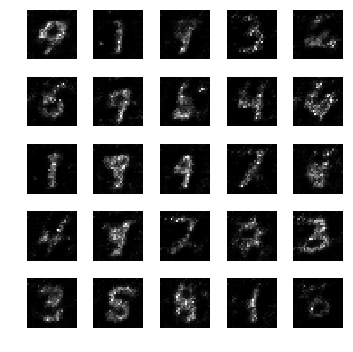

epoch: 361, time: 5.023604 | train_G_Loss: 0.438280, train_D_loss: 2.475015, train_acc: 0.904297
cv_G_Loss: 0.708012, cv_D_loss: 2.736745, cv_acc: 0.890600
Model saved

epoch: 362, time: 4.986614 | train_G_Loss: 0.450115, train_D_loss: 2.413272, train_acc: 0.884766
cv_G_Loss: 0.427967, cv_D_loss: 2.586475, cv_acc: 0.879200

epoch: 363, time: 4.962411 | train_G_Loss: 0.305633, train_D_loss: 2.640908, train_acc: 0.861328
cv_G_Loss: 0.409695, cv_D_loss: 2.498716, cv_acc: 0.885000

epoch: 364, time: 4.996623 | train_G_Loss: 0.261950, train_D_loss: 2.587765, train_acc: 0.906250
cv_G_Loss: 0.312836, cv_D_loss: 2.559551, cv_acc: 0.882000

epoch: 365, time: 4.988292 | train_G_Loss: 0.349775, train_D_loss: 2.442894, train_acc: 0.919922
cv_G_Loss: 0.600670, cv_D_loss: 2.612033, cv_acc: 0.881400

epoch: 366, time: 4.990760 | train_G_Loss: 0.506578, train_D_loss: 2.219032, train_acc: 0.943359
cv_G_Loss: 0.823309, cv_D_loss: 2.863830, cv_acc: 0.888500

epoch: 367, time: 4.998062 | train_G_Loss: 0.3

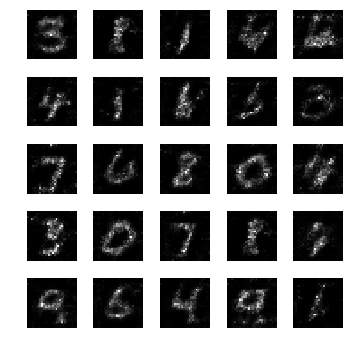

epoch: 371, time: 5.010698 | train_G_Loss: 0.497648, train_D_loss: 2.406750, train_acc: 0.914062
cv_G_Loss: 0.472371, cv_D_loss: 2.621753, cv_acc: 0.878200

epoch: 372, time: 4.987540 | train_G_Loss: 0.401983, train_D_loss: 2.489978, train_acc: 0.886719
cv_G_Loss: 0.761276, cv_D_loss: 2.787975, cv_acc: 0.881600

epoch: 373, time: 5.014614 | train_G_Loss: 0.312481, train_D_loss: 2.455734, train_acc: 0.902344
cv_G_Loss: 0.354527, cv_D_loss: 2.604354, cv_acc: 0.886300

epoch: 374, time: 4.998800 | train_G_Loss: 0.378071, train_D_loss: 2.431888, train_acc: 0.890625
cv_G_Loss: 0.920828, cv_D_loss: 3.214995, cv_acc: 0.853900

epoch: 375, time: 4.988426 | train_G_Loss: 0.366939, train_D_loss: 2.568222, train_acc: 0.894531
cv_G_Loss: 1.066914, cv_D_loss: 3.209298, cv_acc: 0.885100

epoch: 376, time: 4.992436 | train_G_Loss: 0.373456, train_D_loss: 2.433260, train_acc: 0.902344
cv_G_Loss: 0.651251, cv_D_loss: 2.744391, cv_acc: 0.871200

epoch: 377, time: 4.998344 | train_G_Loss: 0.575198, train

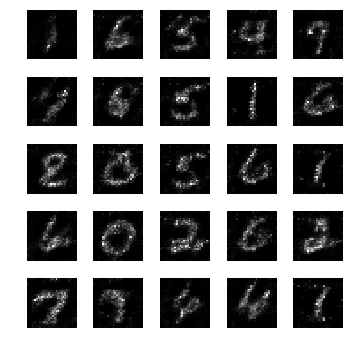

epoch: 381, time: 5.011421 | train_G_Loss: 0.485916, train_D_loss: 2.472825, train_acc: 0.878906
cv_G_Loss: 0.839573, cv_D_loss: 3.012052, cv_acc: 0.871000

epoch: 382, time: 5.011142 | train_G_Loss: 0.506683, train_D_loss: 2.601956, train_acc: 0.867188
cv_G_Loss: 0.806548, cv_D_loss: 2.898496, cv_acc: 0.870600

epoch: 383, time: 5.021470 | train_G_Loss: 0.477760, train_D_loss: 2.612342, train_acc: 0.867188
cv_G_Loss: 1.250043, cv_D_loss: 3.505503, cv_acc: 0.877800

epoch: 384, time: 5.000216 | train_G_Loss: 0.417025, train_D_loss: 2.588788, train_acc: 0.843750
cv_G_Loss: 1.255075, cv_D_loss: 3.528134, cv_acc: 0.875700

epoch: 385, time: 4.992770 | train_G_Loss: 0.349336, train_D_loss: 2.604685, train_acc: 0.878906
cv_G_Loss: 0.089468, cv_D_loss: 3.274354, cv_acc: 0.892100
Model saved

epoch: 386, time: 5.007676 | train_G_Loss: 0.352297, train_D_loss: 2.470785, train_acc: 0.894531
cv_G_Loss: 1.025166, cv_D_loss: 3.191032, cv_acc: 0.872100

epoch: 387, time: 4.993463 | train_G_Loss: 0.4

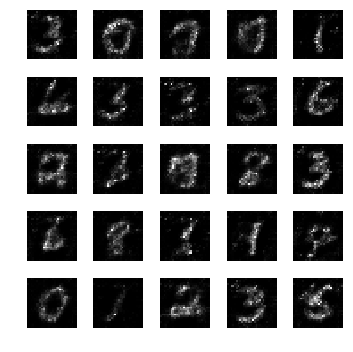

epoch: 391, time: 5.006354 | train_G_Loss: 0.440698, train_D_loss: 2.294044, train_acc: 0.917969
cv_G_Loss: 0.955507, cv_D_loss: 3.048064, cv_acc: 0.891300

epoch: 392, time: 4.981647 | train_G_Loss: 0.335821, train_D_loss: 2.386954, train_acc: 0.917969
cv_G_Loss: 0.402085, cv_D_loss: 2.552454, cv_acc: 0.883900

epoch: 393, time: 4.977928 | train_G_Loss: 0.384814, train_D_loss: 2.532454, train_acc: 0.882812
cv_G_Loss: 0.492441, cv_D_loss: 2.709452, cv_acc: 0.848000

epoch: 394, time: 4.990483 | train_G_Loss: 0.309917, train_D_loss: 2.499255, train_acc: 0.857422
cv_G_Loss: 3.000586, cv_D_loss: 6.517974, cv_acc: 0.864400

epoch: 395, time: 4.977221 | train_G_Loss: 0.419608, train_D_loss: 2.775075, train_acc: 0.880859
cv_G_Loss: 0.838684, cv_D_loss: 2.861856, cv_acc: 0.890500

epoch: 396, time: 4.984018 | train_G_Loss: 0.475151, train_D_loss: 2.482439, train_acc: 0.878906
cv_G_Loss: 1.011259, cv_D_loss: 3.142453, cv_acc: 0.889300

epoch: 397, time: 4.980578 | train_G_Loss: 0.470875, train

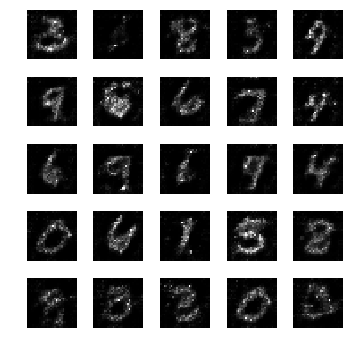

epoch: 401, time: 4.978587 | train_G_Loss: 0.388971, train_D_loss: 2.347087, train_acc: 0.888672
cv_G_Loss: 0.322443, cv_D_loss: 2.577492, cv_acc: 0.882600

epoch: 402, time: 4.956161 | train_G_Loss: 0.317086, train_D_loss: 2.492336, train_acc: 0.876953
cv_G_Loss: 0.147567, cv_D_loss: 2.865952, cv_acc: 0.887300

epoch: 403, time: 4.952427 | train_G_Loss: 0.574438, train_D_loss: 2.598048, train_acc: 0.857422
cv_G_Loss: 3.083891, cv_D_loss: 6.926594, cv_acc: 0.859000

epoch: 404, time: 4.960405 | train_G_Loss: 0.279554, train_D_loss: 2.592492, train_acc: 0.835938
cv_G_Loss: 0.455866, cv_D_loss: 2.546759, cv_acc: 0.893200
Model saved

epoch: 405, time: 5.025320 | train_G_Loss: 0.318953, train_D_loss: 2.864630, train_acc: 0.869141
cv_G_Loss: 0.426412, cv_D_loss: 2.544368, cv_acc: 0.888600

epoch: 406, time: 4.972633 | train_G_Loss: 0.467480, train_D_loss: 2.414392, train_acc: 0.896484
cv_G_Loss: 0.535346, cv_D_loss: 2.573842, cv_acc: 0.894700
Model saved

epoch: 407, time: 5.008740 | train

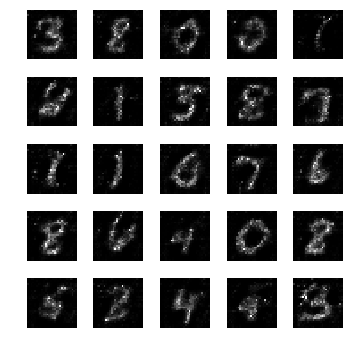

epoch: 411, time: 5.017029 | train_G_Loss: 0.419532, train_D_loss: 2.428044, train_acc: 0.896484
cv_G_Loss: 2.108900, cv_D_loss: 5.177472, cv_acc: 0.875300

epoch: 412, time: 4.987914 | train_G_Loss: 0.460509, train_D_loss: 2.669356, train_acc: 0.869141
cv_G_Loss: 0.951346, cv_D_loss: 2.977513, cv_acc: 0.889900

epoch: 413, time: 5.002025 | train_G_Loss: 0.372630, train_D_loss: 2.621118, train_acc: 0.880859
cv_G_Loss: 3.112386, cv_D_loss: 7.271059, cv_acc: 0.742300

epoch: 414, time: 5.010375 | train_G_Loss: 0.351766, train_D_loss: 2.483991, train_acc: 0.884766
cv_G_Loss: 0.374873, cv_D_loss: 2.436345, cv_acc: 0.883600

epoch: 415, time: 4.992200 | train_G_Loss: 0.333131, train_D_loss: 2.621340, train_acc: 0.886719
cv_G_Loss: 0.478324, cv_D_loss: 2.567260, cv_acc: 0.894200

epoch: 416, time: 5.000400 | train_G_Loss: 0.481786, train_D_loss: 2.421344, train_acc: 0.894531
cv_G_Loss: 2.419186, cv_D_loss: 5.590254, cv_acc: 0.885600

epoch: 417, time: 4.994069 | train_G_Loss: 0.520281, train

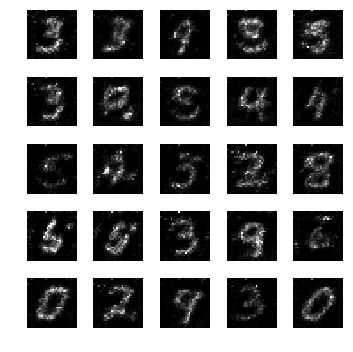

epoch: 421, time: 5.030725 | train_G_Loss: 0.415198, train_D_loss: 2.432745, train_acc: 0.896484
cv_G_Loss: 0.294325, cv_D_loss: 2.541473, cv_acc: 0.895400
Model saved

epoch: 422, time: 5.013439 | train_G_Loss: 0.390096, train_D_loss: 2.295681, train_acc: 0.912109
cv_G_Loss: 0.508794, cv_D_loss: 2.528645, cv_acc: 0.891800

epoch: 423, time: 4.987776 | train_G_Loss: 0.397264, train_D_loss: 2.582751, train_acc: 0.904297
cv_G_Loss: 0.784734, cv_D_loss: 2.762446, cv_acc: 0.898300
Model saved

epoch: 424, time: 4.970269 | train_G_Loss: 0.427699, train_D_loss: 2.484097, train_acc: 0.902344
cv_G_Loss: 1.576892, cv_D_loss: 4.066963, cv_acc: 0.859300

epoch: 425, time: 4.957097 | train_G_Loss: 0.420948, train_D_loss: 2.417470, train_acc: 0.875000
cv_G_Loss: 0.336399, cv_D_loss: 2.608600, cv_acc: 0.882800

epoch: 426, time: 4.946784 | train_G_Loss: 0.349216, train_D_loss: 2.677937, train_acc: 0.892578
cv_G_Loss: 0.666087, cv_D_loss: 2.674069, cv_acc: 0.892900

epoch: 427, time: 5.001645 | train

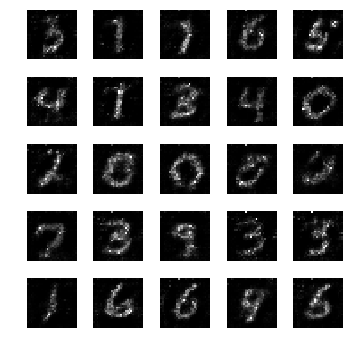

epoch: 431, time: 5.018837 | train_G_Loss: 0.777420, train_D_loss: 2.620197, train_acc: 0.855469
cv_G_Loss: 2.171391, cv_D_loss: 5.372572, cv_acc: 0.857600

epoch: 432, time: 4.948377 | train_G_Loss: 0.366491, train_D_loss: 2.492428, train_acc: 0.894531
cv_G_Loss: 0.948075, cv_D_loss: 3.027966, cv_acc: 0.891400

epoch: 433, time: 4.953058 | train_G_Loss: 0.343548, train_D_loss: 2.403227, train_acc: 0.914062
cv_G_Loss: 0.533862, cv_D_loss: 2.494752, cv_acc: 0.894600

epoch: 434, time: 4.948670 | train_G_Loss: 0.415823, train_D_loss: 2.338458, train_acc: 0.900391
cv_G_Loss: 0.877791, cv_D_loss: 3.053783, cv_acc: 0.876900

epoch: 435, time: 4.944386 | train_G_Loss: 0.448255, train_D_loss: 2.456081, train_acc: 0.871094
cv_G_Loss: 1.048579, cv_D_loss: 3.245201, cv_acc: 0.880500

epoch: 436, time: 4.950207 | train_G_Loss: 0.331054, train_D_loss: 2.471171, train_acc: 0.884766
cv_G_Loss: 0.213661, cv_D_loss: 2.626542, cv_acc: 0.897300

epoch: 437, time: 4.955588 | train_G_Loss: 0.478454, train

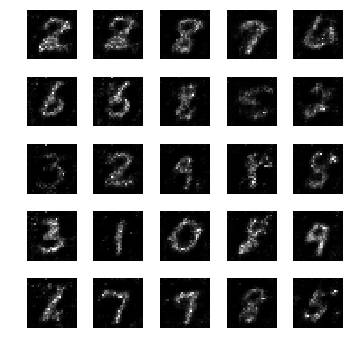

epoch: 441, time: 4.982936 | train_G_Loss: 0.393902, train_D_loss: 2.333934, train_acc: 0.923828
cv_G_Loss: 0.551947, cv_D_loss: 2.540193, cv_acc: 0.887100

epoch: 442, time: 4.956824 | train_G_Loss: 0.422965, train_D_loss: 2.374393, train_acc: 0.917969
cv_G_Loss: 1.063324, cv_D_loss: 3.348729, cv_acc: 0.870500

epoch: 443, time: 4.945337 | train_G_Loss: 0.322582, train_D_loss: 2.436584, train_acc: 0.908203
cv_G_Loss: 0.331564, cv_D_loss: 2.785583, cv_acc: 0.834700

epoch: 444, time: 4.951053 | train_G_Loss: 0.470104, train_D_loss: 2.420150, train_acc: 0.884766
cv_G_Loss: 0.535146, cv_D_loss: 2.569852, cv_acc: 0.890700

epoch: 445, time: 4.956811 | train_G_Loss: 0.370319, train_D_loss: 2.611224, train_acc: 0.878906
cv_G_Loss: 0.505523, cv_D_loss: 2.615724, cv_acc: 0.883200

epoch: 446, time: 4.956018 | train_G_Loss: 0.355711, train_D_loss: 2.539345, train_acc: 0.886719
cv_G_Loss: 0.389647, cv_D_loss: 2.531790, cv_acc: 0.891400

epoch: 447, time: 4.960108 | train_G_Loss: 0.429749, train

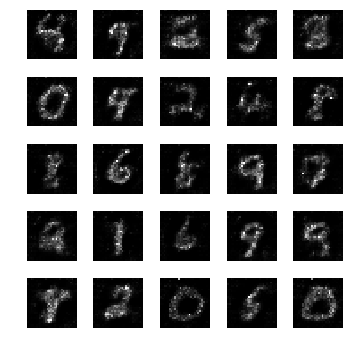

epoch: 451, time: 4.973310 | train_G_Loss: 0.402337, train_D_loss: 2.510205, train_acc: 0.888672
cv_G_Loss: 1.220590, cv_D_loss: 3.395056, cv_acc: 0.890300

epoch: 452, time: 4.950831 | train_G_Loss: 0.390390, train_D_loss: 2.599919, train_acc: 0.892578
cv_G_Loss: 0.554317, cv_D_loss: 2.487514, cv_acc: 0.898600
Model saved

epoch: 453, time: 5.014434 | train_G_Loss: 0.466209, train_D_loss: 2.478173, train_acc: 0.884766
cv_G_Loss: 0.245962, cv_D_loss: 2.779795, cv_acc: 0.877800

epoch: 454, time: 4.978240 | train_G_Loss: 0.366193, train_D_loss: 2.548131, train_acc: 0.882812
cv_G_Loss: 1.145155, cv_D_loss: 3.366020, cv_acc: 0.889700

epoch: 455, time: 4.975824 | train_G_Loss: 0.361899, train_D_loss: 2.475082, train_acc: 0.857422
cv_G_Loss: 0.157867, cv_D_loss: 2.799354, cv_acc: 0.887300

epoch: 456, time: 4.994568 | train_G_Loss: 0.386718, train_D_loss: 2.497133, train_acc: 0.851562
cv_G_Loss: 0.529670, cv_D_loss: 2.560460, cv_acc: 0.897400

epoch: 457, time: 4.976530 | train_G_Loss: 0.3

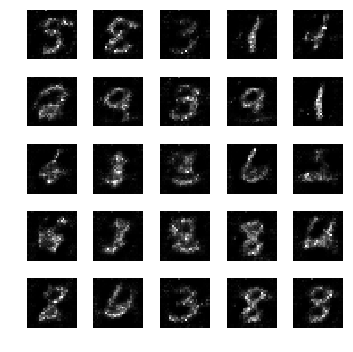

epoch: 461, time: 5.029079 | train_G_Loss: 0.342717, train_D_loss: 2.616988, train_acc: 0.861328
cv_G_Loss: 0.878192, cv_D_loss: 3.066537, cv_acc: 0.859400

epoch: 462, time: 4.989289 | train_G_Loss: 0.448497, train_D_loss: 2.452947, train_acc: 0.873047
cv_G_Loss: 0.420605, cv_D_loss: 2.419281, cv_acc: 0.901400
Model saved

epoch: 463, time: 5.011556 | train_G_Loss: 0.407274, train_D_loss: 2.440254, train_acc: 0.855469
cv_G_Loss: 0.290391, cv_D_loss: 2.558313, cv_acc: 0.896000

epoch: 464, time: 4.992216 | train_G_Loss: 0.426907, train_D_loss: 2.641376, train_acc: 0.849609
cv_G_Loss: 0.269832, cv_D_loss: 2.546876, cv_acc: 0.902100
Model saved

epoch: 465, time: 4.983773 | train_G_Loss: 0.548662, train_D_loss: 2.739376, train_acc: 0.894531
cv_G_Loss: 1.824155, cv_D_loss: 4.459247, cv_acc: 0.879300

epoch: 466, time: 4.951704 | train_G_Loss: 0.438317, train_D_loss: 2.562158, train_acc: 0.910156
cv_G_Loss: 0.341947, cv_D_loss: 2.481781, cv_acc: 0.895400

epoch: 467, time: 4.964581 | train

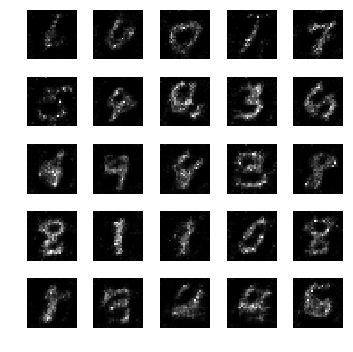

epoch: 471, time: 5.024553 | train_G_Loss: 0.652687, train_D_loss: 2.448718, train_acc: 0.900391
cv_G_Loss: 0.535952, cv_D_loss: 2.522292, cv_acc: 0.900000

epoch: 472, time: 4.970208 | train_G_Loss: 0.423936, train_D_loss: 2.452055, train_acc: 0.888672
cv_G_Loss: 0.099253, cv_D_loss: 3.078940, cv_acc: 0.897200

epoch: 473, time: 4.959436 | train_G_Loss: 0.468293, train_D_loss: 2.577171, train_acc: 0.900391
cv_G_Loss: 0.481091, cv_D_loss: 2.498270, cv_acc: 0.901600

epoch: 474, time: 4.957542 | train_G_Loss: 0.360995, train_D_loss: 2.483339, train_acc: 0.904297
cv_G_Loss: 0.408890, cv_D_loss: 2.500946, cv_acc: 0.894100

epoch: 475, time: 4.966133 | train_G_Loss: 0.410685, train_D_loss: 2.582635, train_acc: 0.898438
cv_G_Loss: 0.122077, cv_D_loss: 3.033823, cv_acc: 0.872600

epoch: 476, time: 4.955606 | train_G_Loss: 0.449445, train_D_loss: 2.348841, train_acc: 0.896484
cv_G_Loss: 0.508431, cv_D_loss: 2.647007, cv_acc: 0.875500

epoch: 477, time: 4.959258 | train_G_Loss: 0.366842, train

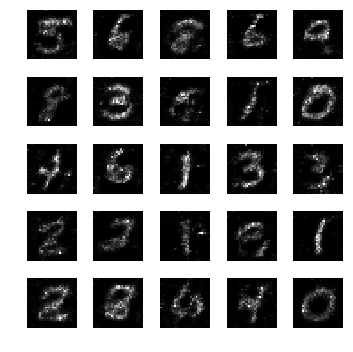

epoch: 481, time: 5.013955 | train_G_Loss: 0.396182, train_D_loss: 2.435031, train_acc: 0.830078
cv_G_Loss: 0.613360, cv_D_loss: 2.560021, cv_acc: 0.904700
Model saved

epoch: 482, time: 4.998921 | train_G_Loss: 0.346532, train_D_loss: 2.697244, train_acc: 0.867188
cv_G_Loss: 0.244230, cv_D_loss: 2.629530, cv_acc: 0.879700

epoch: 483, time: 4.996686 | train_G_Loss: 0.269143, train_D_loss: 2.498670, train_acc: 0.916016
cv_G_Loss: 0.107183, cv_D_loss: 3.027866, cv_acc: 0.893900

epoch: 484, time: 4.958598 | train_G_Loss: 0.350465, train_D_loss: 2.451595, train_acc: 0.916016
cv_G_Loss: 0.398612, cv_D_loss: 2.491749, cv_acc: 0.887400

epoch: 485, time: 4.967123 | train_G_Loss: 0.396892, train_D_loss: 2.441300, train_acc: 0.914062
cv_G_Loss: 0.256572, cv_D_loss: 2.519484, cv_acc: 0.900700

epoch: 486, time: 4.962155 | train_G_Loss: 0.374852, train_D_loss: 2.347721, train_acc: 0.919922
cv_G_Loss: 0.813841, cv_D_loss: 2.828841, cv_acc: 0.890000

epoch: 487, time: 4.963888 | train_G_Loss: 0.3

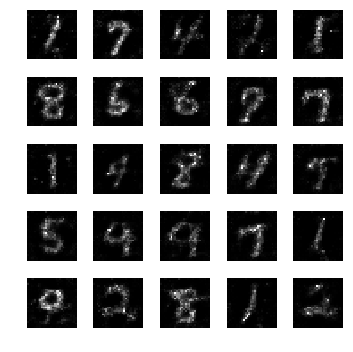

epoch: 491, time: 4.988505 | train_G_Loss: 0.365359, train_D_loss: 2.364396, train_acc: 0.912109
cv_G_Loss: 0.800132, cv_D_loss: 2.766118, cv_acc: 0.899800

epoch: 492, time: 4.966567 | train_G_Loss: 0.436672, train_D_loss: 2.363625, train_acc: 0.914062
cv_G_Loss: 0.871435, cv_D_loss: 2.807355, cv_acc: 0.894400

epoch: 493, time: 4.980541 | train_G_Loss: 0.507657, train_D_loss: 2.344921, train_acc: 0.902344
cv_G_Loss: 1.279366, cv_D_loss: 3.534384, cv_acc: 0.881400

epoch: 494, time: 4.974740 | train_G_Loss: 0.297804, train_D_loss: 2.497224, train_acc: 0.843750
cv_G_Loss: 0.194353, cv_D_loss: 2.737558, cv_acc: 0.868600

epoch: 495, time: 4.949546 | train_G_Loss: 0.325626, train_D_loss: 2.714117, train_acc: 0.853516
cv_G_Loss: 0.740726, cv_D_loss: 2.661347, cv_acc: 0.896100

epoch: 496, time: 4.953139 | train_G_Loss: 0.402490, train_D_loss: 2.336996, train_acc: 0.904297
cv_G_Loss: 0.275923, cv_D_loss: 2.618211, cv_acc: 0.865000

epoch: 497, time: 4.964211 | train_G_Loss: 0.455761, train

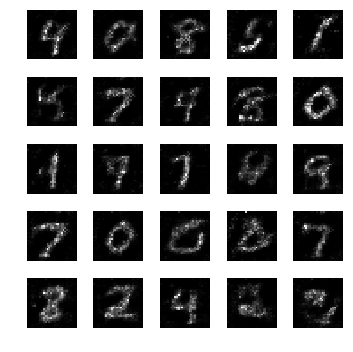

epoch: 501, time: 4.966039 | train_G_Loss: 0.350059, train_D_loss: 2.423634, train_acc: 0.917969
cv_G_Loss: 0.108476, cv_D_loss: 3.066432, cv_acc: 0.893200

epoch: 502, time: 4.969999 | train_G_Loss: 0.475673, train_D_loss: 2.323570, train_acc: 0.908203
cv_G_Loss: 0.377994, cv_D_loss: 2.472146, cv_acc: 0.898000

epoch: 503, time: 4.955814 | train_G_Loss: 0.408779, train_D_loss: 2.346827, train_acc: 0.882812
cv_G_Loss: 0.390079, cv_D_loss: 2.423065, cv_acc: 0.904600

epoch: 504, time: 4.949522 | train_G_Loss: 0.348566, train_D_loss: 2.408581, train_acc: 0.876953
cv_G_Loss: 0.194632, cv_D_loss: 2.733350, cv_acc: 0.877400

epoch: 505, time: 4.957260 | train_G_Loss: 0.448533, train_D_loss: 2.465449, train_acc: 0.927734
cv_G_Loss: 0.802212, cv_D_loss: 2.639417, cv_acc: 0.903600

epoch: 506, time: 4.950648 | train_G_Loss: 0.374938, train_D_loss: 2.259606, train_acc: 0.898438
cv_G_Loss: 0.244653, cv_D_loss: 2.537176, cv_acc: 0.905200
Model saved

epoch: 507, time: 5.020616 | train_G_Loss: 0.4

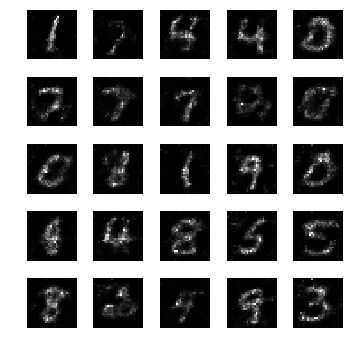

epoch: 511, time: 5.015856 | train_G_Loss: 0.366223, train_D_loss: 2.464546, train_acc: 0.912109
cv_G_Loss: 0.161326, cv_D_loss: 2.741167, cv_acc: 0.899400

epoch: 512, time: 4.996722 | train_G_Loss: 0.369776, train_D_loss: 2.532960, train_acc: 0.917969
cv_G_Loss: 0.320025, cv_D_loss: 2.465234, cv_acc: 0.899800

epoch: 513, time: 4.984137 | train_G_Loss: 0.454470, train_D_loss: 2.345798, train_acc: 0.908203
cv_G_Loss: 0.353559, cv_D_loss: 2.398812, cv_acc: 0.910700
Model saved

epoch: 514, time: 4.988132 | train_G_Loss: 0.213452, train_D_loss: 2.518482, train_acc: 0.888672
cv_G_Loss: 0.122761, cv_D_loss: 2.895224, cv_acc: 0.896200

epoch: 515, time: 4.950863 | train_G_Loss: 0.272266, train_D_loss: 2.643991, train_acc: 0.886719
cv_G_Loss: 0.237746, cv_D_loss: 2.532093, cv_acc: 0.898000

epoch: 516, time: 4.996605 | train_G_Loss: 0.337630, train_D_loss: 2.539720, train_acc: 0.882812
cv_G_Loss: 0.457865, cv_D_loss: 2.440336, cv_acc: 0.896800

epoch: 517, time: 4.960815 | train_G_Loss: 0.3

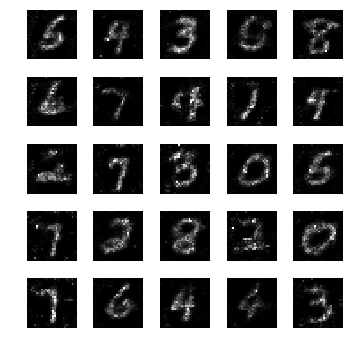

epoch: 521, time: 4.990485 | train_G_Loss: 0.320248, train_D_loss: 2.568245, train_acc: 0.888672
cv_G_Loss: 0.109575, cv_D_loss: 2.985091, cv_acc: 0.897600

epoch: 522, time: 4.968297 | train_G_Loss: 0.356986, train_D_loss: 2.249328, train_acc: 0.875000
cv_G_Loss: 0.438500, cv_D_loss: 2.477941, cv_acc: 0.889600

epoch: 523, time: 4.956383 | train_G_Loss: 0.331074, train_D_loss: 2.557853, train_acc: 0.898438
cv_G_Loss: 0.509891, cv_D_loss: 2.494796, cv_acc: 0.894400

epoch: 524, time: 4.948120 | train_G_Loss: 0.581852, train_D_loss: 2.670773, train_acc: 0.873047
cv_G_Loss: 2.093459, cv_D_loss: 4.928449, cv_acc: 0.868200

epoch: 525, time: 4.966328 | train_G_Loss: 0.321659, train_D_loss: 2.465501, train_acc: 0.880859
cv_G_Loss: 0.159385, cv_D_loss: 2.782609, cv_acc: 0.898000

epoch: 526, time: 4.951985 | train_G_Loss: 0.404412, train_D_loss: 2.467162, train_acc: 0.871094
cv_G_Loss: 0.308140, cv_D_loss: 2.476618, cv_acc: 0.902100

epoch: 527, time: 4.954086 | train_G_Loss: 0.304854, train

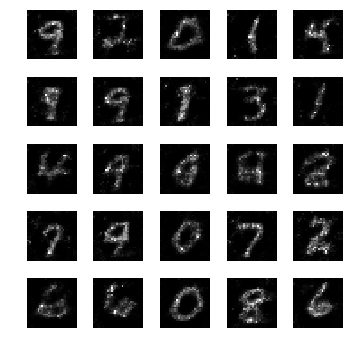

epoch: 531, time: 4.981371 | train_G_Loss: 0.393710, train_D_loss: 2.420429, train_acc: 0.873047
cv_G_Loss: 0.228223, cv_D_loss: 2.583947, cv_acc: 0.908000

epoch: 532, time: 4.953194 | train_G_Loss: 0.317439, train_D_loss: 2.399056, train_acc: 0.916016
cv_G_Loss: 0.592476, cv_D_loss: 2.579874, cv_acc: 0.894900

epoch: 533, time: 4.965542 | train_G_Loss: 0.457993, train_D_loss: 2.282217, train_acc: 0.865234
cv_G_Loss: 0.695793, cv_D_loss: 2.609652, cv_acc: 0.909400

epoch: 534, time: 4.962028 | train_G_Loss: 0.419602, train_D_loss: 2.597250, train_acc: 0.888672
cv_G_Loss: 1.094675, cv_D_loss: 3.172447, cv_acc: 0.899400

epoch: 535, time: 4.948673 | train_G_Loss: 0.503078, train_D_loss: 2.480576, train_acc: 0.910156
cv_G_Loss: 1.497979, cv_D_loss: 3.795140, cv_acc: 0.904300

epoch: 536, time: 4.974071 | train_G_Loss: 0.406999, train_D_loss: 2.333345, train_acc: 0.902344
cv_G_Loss: 0.332988, cv_D_loss: 2.446149, cv_acc: 0.901300

epoch: 537, time: 4.966057 | train_G_Loss: 0.351035, train

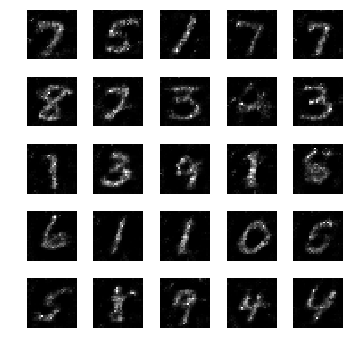

epoch: 541, time: 4.960483 | train_G_Loss: 0.436606, train_D_loss: 2.562212, train_acc: 0.908203
cv_G_Loss: 1.301482, cv_D_loss: 3.517705, cv_acc: 0.894500

epoch: 542, time: 4.967431 | train_G_Loss: 0.383178, train_D_loss: 2.259945, train_acc: 0.929688
cv_G_Loss: 0.744362, cv_D_loss: 2.664114, cv_acc: 0.906700

epoch: 543, time: 4.955875 | train_G_Loss: 0.302787, train_D_loss: 2.376646, train_acc: 0.933594
cv_G_Loss: 0.251239, cv_D_loss: 2.479998, cv_acc: 0.905900

epoch: 544, time: 4.959713 | train_G_Loss: 0.422172, train_D_loss: 2.375989, train_acc: 0.931641
cv_G_Loss: 0.928308, cv_D_loss: 2.823279, cv_acc: 0.908200

epoch: 545, time: 4.952758 | train_G_Loss: 0.653651, train_D_loss: 2.488117, train_acc: 0.929688
cv_G_Loss: 1.379008, cv_D_loss: 3.573233, cv_acc: 0.907600

epoch: 546, time: 4.974414 | train_G_Loss: 0.423162, train_D_loss: 2.455513, train_acc: 0.906250
cv_G_Loss: 0.649547, cv_D_loss: 2.647793, cv_acc: 0.888200

epoch: 547, time: 4.952195 | train_G_Loss: 0.421532, train

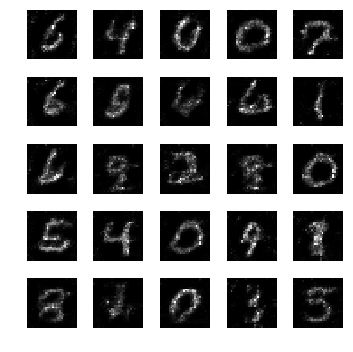

epoch: 551, time: 4.994242 | train_G_Loss: 0.221942, train_D_loss: 2.453919, train_acc: 0.935547
cv_G_Loss: 0.088379, cv_D_loss: 3.135364, cv_acc: 0.898300

epoch: 552, time: 4.966577 | train_G_Loss: 0.413856, train_D_loss: 2.149176, train_acc: 0.945312
cv_G_Loss: 0.362365, cv_D_loss: 2.392208, cv_acc: 0.908400

epoch: 553, time: 4.967219 | train_G_Loss: 0.420210, train_D_loss: 2.185808, train_acc: 0.951172
cv_G_Loss: 0.440156, cv_D_loss: 2.411857, cv_acc: 0.905300

epoch: 554, time: 4.975823 | train_G_Loss: 0.347201, train_D_loss: 2.302202, train_acc: 0.974609
cv_G_Loss: 0.142572, cv_D_loss: 2.770801, cv_acc: 0.906900

epoch: 555, time: 4.957996 | train_G_Loss: 0.381882, train_D_loss: 2.223511, train_acc: 0.935547
cv_G_Loss: 0.287863, cv_D_loss: 2.446702, cv_acc: 0.905600

epoch: 556, time: 4.950470 | train_G_Loss: 0.357893, train_D_loss: 2.400493, train_acc: 0.931641
cv_G_Loss: 0.841799, cv_D_loss: 2.860811, cv_acc: 0.896200

epoch: 557, time: 4.973504 | train_G_Loss: 0.471201, train

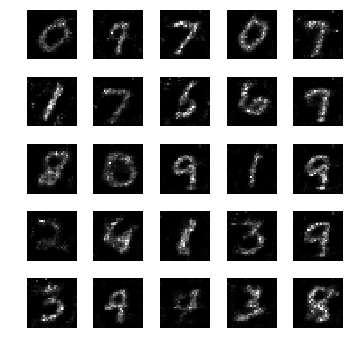

epoch: 561, time: 5.047903 | train_G_Loss: 0.320347, train_D_loss: 2.500425, train_acc: 0.931641
cv_G_Loss: 0.256636, cv_D_loss: 2.549244, cv_acc: 0.889100

epoch: 562, time: 4.963525 | train_G_Loss: 0.504459, train_D_loss: 2.314905, train_acc: 0.925781
cv_G_Loss: 0.195667, cv_D_loss: 2.619365, cv_acc: 0.893500

epoch: 563, time: 4.963795 | train_G_Loss: 0.379993, train_D_loss: 2.308559, train_acc: 0.896484
cv_G_Loss: 0.363822, cv_D_loss: 2.392909, cv_acc: 0.906600

epoch: 564, time: 4.961907 | train_G_Loss: 0.353079, train_D_loss: 2.470872, train_acc: 0.886719
cv_G_Loss: 0.787334, cv_D_loss: 2.718559, cv_acc: 0.902700

epoch: 565, time: 4.977064 | train_G_Loss: 0.347118, train_D_loss: 2.351957, train_acc: 0.908203
cv_G_Loss: 0.099992, cv_D_loss: 3.100513, cv_acc: 0.884000

epoch: 566, time: 4.967517 | train_G_Loss: 0.371775, train_D_loss: 2.439556, train_acc: 0.923828
cv_G_Loss: 0.365846, cv_D_loss: 2.484627, cv_acc: 0.894500

epoch: 567, time: 4.970782 | train_G_Loss: 0.338065, train

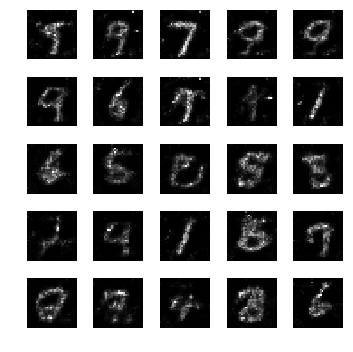

epoch: 571, time: 4.995786 | train_G_Loss: 0.334858, train_D_loss: 2.593966, train_acc: 0.904297
cv_G_Loss: 0.314163, cv_D_loss: 2.472828, cv_acc: 0.902200

epoch: 572, time: 4.957829 | train_G_Loss: 0.322187, train_D_loss: 2.436295, train_acc: 0.896484
cv_G_Loss: 0.242811, cv_D_loss: 2.513509, cv_acc: 0.910400

epoch: 573, time: 4.973930 | train_G_Loss: 0.559601, train_D_loss: 2.487903, train_acc: 0.931641
cv_G_Loss: 0.556160, cv_D_loss: 2.480394, cv_acc: 0.911500

epoch: 574, time: 4.965588 | train_G_Loss: 0.387311, train_D_loss: 2.248272, train_acc: 0.935547
cv_G_Loss: 1.331526, cv_D_loss: 3.512847, cv_acc: 0.905900

epoch: 575, time: 4.957467 | train_G_Loss: 0.374265, train_D_loss: 2.367113, train_acc: 0.914062
cv_G_Loss: 0.181235, cv_D_loss: 2.633973, cv_acc: 0.902500

epoch: 576, time: 4.967856 | train_G_Loss: 0.369377, train_D_loss: 2.217561, train_acc: 0.941406
cv_G_Loss: 0.273870, cv_D_loss: 2.473385, cv_acc: 0.911100

epoch: 577, time: 4.967949 | train_G_Loss: 0.397575, train

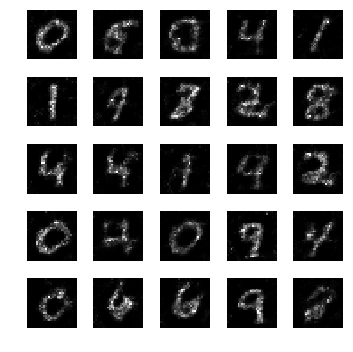

epoch: 581, time: 5.003144 | train_G_Loss: 0.290864, train_D_loss: 2.443897, train_acc: 0.908203
cv_G_Loss: 2.094956, cv_D_loss: 4.874387, cv_acc: 0.902200

epoch: 582, time: 4.962153 | train_G_Loss: 0.553092, train_D_loss: 2.390709, train_acc: 0.898438
cv_G_Loss: 0.777562, cv_D_loss: 2.688435, cv_acc: 0.901800

epoch: 583, time: 4.990271 | train_G_Loss: 0.439115, train_D_loss: 2.379615, train_acc: 0.878906
cv_G_Loss: 0.508772, cv_D_loss: 2.502320, cv_acc: 0.894000

epoch: 584, time: 4.988812 | train_G_Loss: 0.328027, train_D_loss: 2.477650, train_acc: 0.855469
cv_G_Loss: 1.052068, cv_D_loss: 2.992388, cv_acc: 0.910700

epoch: 585, time: 4.967185 | train_G_Loss: 0.411666, train_D_loss: 2.594471, train_acc: 0.876953
cv_G_Loss: 0.613319, cv_D_loss: 2.480805, cv_acc: 0.909100

epoch: 586, time: 4.956170 | train_G_Loss: 0.295030, train_D_loss: 2.406489, train_acc: 0.919922
cv_G_Loss: 0.841157, cv_D_loss: 2.845201, cv_acc: 0.897400

epoch: 587, time: 4.966552 | train_G_Loss: 0.350426, train

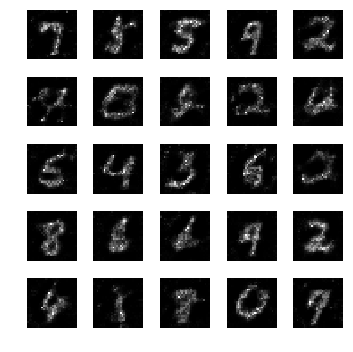

epoch: 591, time: 4.968500 | train_G_Loss: 0.310315, train_D_loss: 2.668870, train_acc: 0.888672
cv_G_Loss: 1.150953, cv_D_loss: 3.255086, cv_acc: 0.901700

epoch: 592, time: 5.125209 | train_G_Loss: 0.491325, train_D_loss: 2.409217, train_acc: 0.910156
cv_G_Loss: 0.418353, cv_D_loss: 2.434952, cv_acc: 0.900700

epoch: 593, time: 4.952029 | train_G_Loss: 0.487830, train_D_loss: 2.401245, train_acc: 0.908203
cv_G_Loss: 0.933282, cv_D_loss: 2.797061, cv_acc: 0.903400

epoch: 594, time: 4.955053 | train_G_Loss: 0.532429, train_D_loss: 2.388696, train_acc: 0.873047
cv_G_Loss: 1.071876, cv_D_loss: 3.042399, cv_acc: 0.912200
Model saved

epoch: 595, time: 5.036154 | train_G_Loss: 0.312882, train_D_loss: 2.445476, train_acc: 0.906250
cv_G_Loss: 0.486568, cv_D_loss: 2.437011, cv_acc: 0.913500
Model saved

epoch: 596, time: 5.032050 | train_G_Loss: 0.475990, train_D_loss: 2.325917, train_acc: 0.921875
cv_G_Loss: 2.625728, cv_D_loss: 5.787904, cv_acc: 0.906900

epoch: 597, time: 5.001545 | train

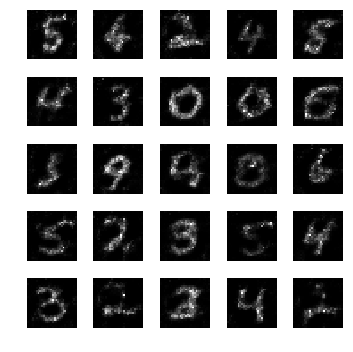

epoch: 601, time: 5.009968 | train_G_Loss: 0.393350, train_D_loss: 2.440041, train_acc: 0.910156
cv_G_Loss: 1.400694, cv_D_loss: 3.622707, cv_acc: 0.902400

epoch: 602, time: 4.999685 | train_G_Loss: 0.428462, train_D_loss: 2.345814, train_acc: 0.925781
cv_G_Loss: 0.800139, cv_D_loss: 2.691323, cv_acc: 0.910600

epoch: 603, time: 5.005809 | train_G_Loss: 0.421443, train_D_loss: 2.324324, train_acc: 0.925781
cv_G_Loss: 0.757636, cv_D_loss: 2.672131, cv_acc: 0.909300

epoch: 604, time: 5.009614 | train_G_Loss: 0.356989, train_D_loss: 2.429166, train_acc: 0.933594
cv_G_Loss: 0.489003, cv_D_loss: 2.424524, cv_acc: 0.913500

epoch: 605, time: 5.006212 | train_G_Loss: 0.427812, train_D_loss: 2.235438, train_acc: 0.916016
cv_G_Loss: 0.135473, cv_D_loss: 2.903060, cv_acc: 0.882800

epoch: 606, time: 5.045010 | train_G_Loss: 0.328501, train_D_loss: 2.438392, train_acc: 0.902344
cv_G_Loss: 0.219352, cv_D_loss: 2.533560, cv_acc: 0.907200

epoch: 607, time: 5.009063 | train_G_Loss: 0.282080, train

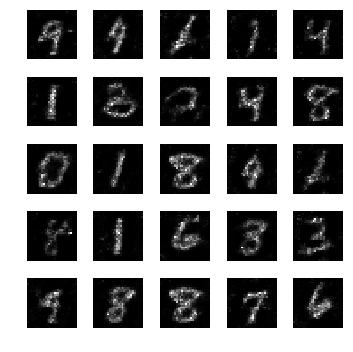

epoch: 611, time: 5.043541 | train_G_Loss: 0.364685, train_D_loss: 2.406799, train_acc: 0.898438
cv_G_Loss: 1.664011, cv_D_loss: 4.058043, cv_acc: 0.908900

epoch: 612, time: 5.002784 | train_G_Loss: 0.239019, train_D_loss: 2.653757, train_acc: 0.898438
cv_G_Loss: 0.493459, cv_D_loss: 2.465736, cv_acc: 0.905200

epoch: 613, time: 5.013019 | train_G_Loss: 0.333942, train_D_loss: 2.297049, train_acc: 0.933594
cv_G_Loss: 0.166802, cv_D_loss: 2.694475, cv_acc: 0.901200

epoch: 614, time: 5.011510 | train_G_Loss: 0.417161, train_D_loss: 2.373615, train_acc: 0.943359
cv_G_Loss: 0.154991, cv_D_loss: 2.700224, cv_acc: 0.908500

epoch: 615, time: 4.992038 | train_G_Loss: 0.416025, train_D_loss: 2.288702, train_acc: 0.906250
cv_G_Loss: 0.488901, cv_D_loss: 2.401634, cv_acc: 0.908000

epoch: 616, time: 5.003387 | train_G_Loss: 0.345460, train_D_loss: 2.562480, train_acc: 0.876953
cv_G_Loss: 1.794620, cv_D_loss: 4.462509, cv_acc: 0.883400

epoch: 617, time: 5.004773 | train_G_Loss: 0.295616, train

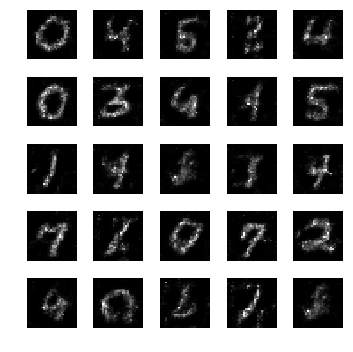

epoch: 621, time: 5.049795 | train_G_Loss: 0.357533, train_D_loss: 2.432431, train_acc: 0.910156
cv_G_Loss: 1.344786, cv_D_loss: 3.533729, cv_acc: 0.897700

epoch: 622, time: 5.008485 | train_G_Loss: 0.407997, train_D_loss: 2.331506, train_acc: 0.908203
cv_G_Loss: 1.453055, cv_D_loss: 3.585895, cv_acc: 0.906000

epoch: 623, time: 5.003672 | train_G_Loss: 0.357340, train_D_loss: 2.547054, train_acc: 0.886719
cv_G_Loss: 0.906731, cv_D_loss: 2.848586, cv_acc: 0.901800

epoch: 624, time: 5.013312 | train_G_Loss: 0.326040, train_D_loss: 2.512411, train_acc: 0.876953
cv_G_Loss: 0.851683, cv_D_loss: 2.843680, cv_acc: 0.897200

epoch: 625, time: 5.002870 | train_G_Loss: 0.505507, train_D_loss: 2.436759, train_acc: 0.916016
cv_G_Loss: 1.838806, cv_D_loss: 4.436108, cv_acc: 0.904300

epoch: 626, time: 5.012127 | train_G_Loss: 0.508089, train_D_loss: 2.422238, train_acc: 0.921875
cv_G_Loss: 0.530287, cv_D_loss: 2.609694, cv_acc: 0.892500

epoch: 627, time: 5.016715 | train_G_Loss: 0.282831, train

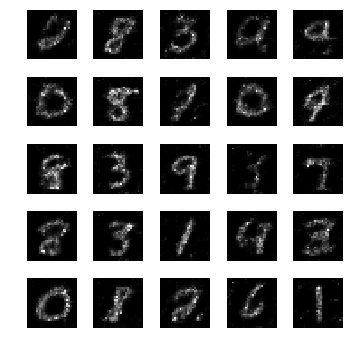

epoch: 631, time: 5.031768 | train_G_Loss: 0.421853, train_D_loss: 2.587898, train_acc: 0.892578
cv_G_Loss: 0.963481, cv_D_loss: 2.905228, cv_acc: 0.908200

epoch: 632, time: 5.002394 | train_G_Loss: 0.325696, train_D_loss: 2.477024, train_acc: 0.898438
cv_G_Loss: 0.187588, cv_D_loss: 2.649937, cv_acc: 0.901900

epoch: 633, time: 5.015918 | train_G_Loss: 0.400098, train_D_loss: 2.536991, train_acc: 0.896484
cv_G_Loss: 0.561685, cv_D_loss: 2.459936, cv_acc: 0.905400

epoch: 634, time: 5.005778 | train_G_Loss: 0.486239, train_D_loss: 2.358304, train_acc: 0.916016
cv_G_Loss: 0.533841, cv_D_loss: 2.371010, cv_acc: 0.911000

epoch: 635, time: 4.995091 | train_G_Loss: 0.521231, train_D_loss: 2.403018, train_acc: 0.927734
cv_G_Loss: 0.551380, cv_D_loss: 2.521652, cv_acc: 0.910700

epoch: 636, time: 5.011876 | train_G_Loss: 0.402892, train_D_loss: 2.267495, train_acc: 0.923828
cv_G_Loss: 0.567983, cv_D_loss: 2.436287, cv_acc: 0.915400

epoch: 637, time: 5.014817 | train_G_Loss: 0.361296, train

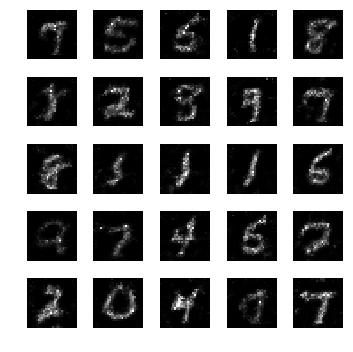

epoch: 641, time: 5.033864 | train_G_Loss: 0.338439, train_D_loss: 2.404507, train_acc: 0.875000
cv_G_Loss: 2.771372, cv_D_loss: 6.158611, cv_acc: 0.889500

epoch: 642, time: 5.009838 | train_G_Loss: 0.529282, train_D_loss: 2.593157, train_acc: 0.865234
cv_G_Loss: 0.391103, cv_D_loss: 2.414159, cv_acc: 0.907500

epoch: 643, time: 5.003474 | train_G_Loss: 0.336288, train_D_loss: 2.545440, train_acc: 0.914062
cv_G_Loss: 0.424264, cv_D_loss: 2.379836, cv_acc: 0.912300

epoch: 644, time: 5.016246 | train_G_Loss: 0.347261, train_D_loss: 2.458495, train_acc: 0.882812
cv_G_Loss: 0.736531, cv_D_loss: 2.658229, cv_acc: 0.907600

epoch: 645, time: 4.996014 | train_G_Loss: 0.343398, train_D_loss: 2.420456, train_acc: 0.886719
cv_G_Loss: 0.176995, cv_D_loss: 2.711598, cv_acc: 0.899500

epoch: 646, time: 5.011249 | train_G_Loss: 0.397230, train_D_loss: 2.303481, train_acc: 0.900391
cv_G_Loss: 1.411642, cv_D_loss: 3.839228, cv_acc: 0.874100

epoch: 647, time: 5.005102 | train_G_Loss: 0.141040, train

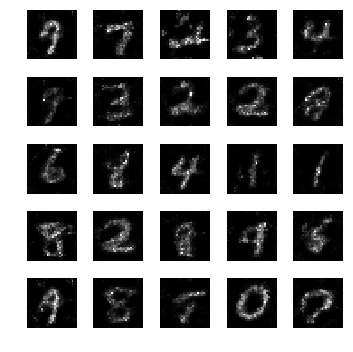

epoch: 651, time: 5.011403 | train_G_Loss: 0.420865, train_D_loss: 2.507238, train_acc: 0.916016
cv_G_Loss: 0.406298, cv_D_loss: 2.365444, cv_acc: 0.912900

epoch: 652, time: 4.994348 | train_G_Loss: 0.386540, train_D_loss: 2.401862, train_acc: 0.935547
cv_G_Loss: 0.224544, cv_D_loss: 2.494262, cv_acc: 0.915800
Model saved

epoch: 653, time: 5.025471 | train_G_Loss: 0.355541, train_D_loss: 2.312020, train_acc: 0.931641
cv_G_Loss: 0.304646, cv_D_loss: 2.387688, cv_acc: 0.915800

epoch: 654, time: 5.010140 | train_G_Loss: 0.364082, train_D_loss: 2.417541, train_acc: 0.927734
cv_G_Loss: 0.179907, cv_D_loss: 2.612755, cv_acc: 0.912800

epoch: 655, time: 5.005203 | train_G_Loss: 0.372829, train_D_loss: 2.291403, train_acc: 0.951172
cv_G_Loss: 0.235371, cv_D_loss: 2.489195, cv_acc: 0.914100

epoch: 656, time: 4.996100 | train_G_Loss: 0.438781, train_D_loss: 2.374092, train_acc: 0.927734
cv_G_Loss: 0.303226, cv_D_loss: 2.412453, cv_acc: 0.914900

epoch: 657, time: 5.006553 | train_G_Loss: 0.4

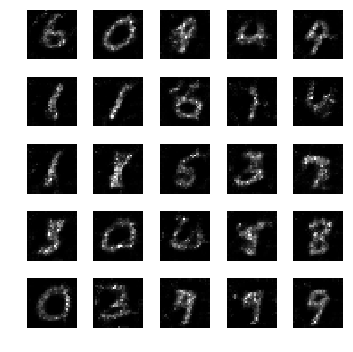

epoch: 661, time: 4.981264 | train_G_Loss: 0.421154, train_D_loss: 2.381447, train_acc: 0.931641
cv_G_Loss: 0.132695, cv_D_loss: 2.809209, cv_acc: 0.908300

epoch: 662, time: 4.948581 | train_G_Loss: 0.462580, train_D_loss: 2.281116, train_acc: 0.914062
cv_G_Loss: 0.326479, cv_D_loss: 2.429737, cv_acc: 0.906600

epoch: 663, time: 4.963264 | train_G_Loss: 0.387120, train_D_loss: 2.462972, train_acc: 0.904297
cv_G_Loss: 0.330622, cv_D_loss: 2.347702, cv_acc: 0.919800
Model saved

epoch: 664, time: 5.004282 | train_G_Loss: 0.446065, train_D_loss: 2.417594, train_acc: 0.908203
cv_G_Loss: 1.013361, cv_D_loss: 2.956133, cv_acc: 0.917000

epoch: 665, time: 4.973026 | train_G_Loss: 0.360076, train_D_loss: 2.336710, train_acc: 0.910156
cv_G_Loss: 0.138024, cv_D_loss: 2.807479, cv_acc: 0.909700

epoch: 666, time: 4.973283 | train_G_Loss: 0.455705, train_D_loss: 2.270424, train_acc: 0.888672
cv_G_Loss: 0.707911, cv_D_loss: 2.597892, cv_acc: 0.913700

epoch: 667, time: 4.972660 | train_G_Loss: 0.4

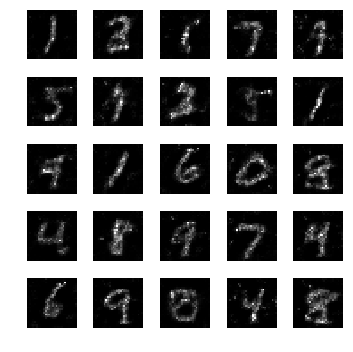

epoch: 671, time: 5.012276 | train_G_Loss: 0.439943, train_D_loss: 2.234029, train_acc: 0.927734
cv_G_Loss: 0.766010, cv_D_loss: 2.652247, cv_acc: 0.912000

epoch: 672, time: 5.020489 | train_G_Loss: 0.402295, train_D_loss: 2.279901, train_acc: 0.941406
cv_G_Loss: 0.329942, cv_D_loss: 2.500327, cv_acc: 0.897600

epoch: 673, time: 4.971912 | train_G_Loss: 0.387014, train_D_loss: 2.288903, train_acc: 0.912109
cv_G_Loss: 0.249776, cv_D_loss: 2.473551, cv_acc: 0.912300

epoch: 674, time: 4.982845 | train_G_Loss: 0.374443, train_D_loss: 2.625821, train_acc: 0.898438
cv_G_Loss: 0.529449, cv_D_loss: 2.597187, cv_acc: 0.867300

epoch: 675, time: 4.960998 | train_G_Loss: 0.373088, train_D_loss: 2.429429, train_acc: 0.906250
cv_G_Loss: 2.646010, cv_D_loss: 6.056574, cv_acc: 0.897700

epoch: 676, time: 4.986175 | train_G_Loss: 0.367131, train_D_loss: 2.450135, train_acc: 0.906250
cv_G_Loss: 0.060473, cv_D_loss: 3.494370, cv_acc: 0.900600

epoch: 677, time: 4.985315 | train_G_Loss: 0.387033, train

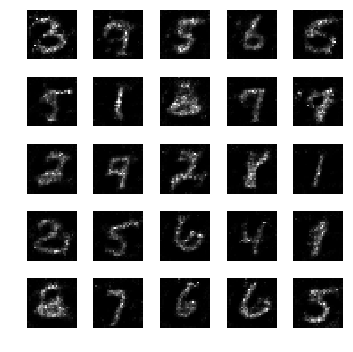

epoch: 681, time: 5.004557 | train_G_Loss: 0.282969, train_D_loss: 2.638689, train_acc: 0.882812
cv_G_Loss: 0.123468, cv_D_loss: 2.909158, cv_acc: 0.894900

epoch: 682, time: 4.985639 | train_G_Loss: 0.373257, train_D_loss: 2.389098, train_acc: 0.910156
cv_G_Loss: 0.547936, cv_D_loss: 2.438789, cv_acc: 0.911300

epoch: 683, time: 4.972560 | train_G_Loss: 0.423292, train_D_loss: 2.352876, train_acc: 0.900391
cv_G_Loss: 0.170415, cv_D_loss: 2.648046, cv_acc: 0.916200

epoch: 684, time: 4.972581 | train_G_Loss: 0.630472, train_D_loss: 2.599301, train_acc: 0.904297
cv_G_Loss: 0.797970, cv_D_loss: 2.612774, cv_acc: 0.918500

epoch: 685, time: 4.974398 | train_G_Loss: 0.336861, train_D_loss: 2.293478, train_acc: 0.900391
cv_G_Loss: 0.507677, cv_D_loss: 2.395400, cv_acc: 0.915200

epoch: 686, time: 4.979787 | train_G_Loss: 0.387449, train_D_loss: 2.421077, train_acc: 0.896484
cv_G_Loss: 0.295901, cv_D_loss: 2.416809, cv_acc: 0.916000

epoch: 687, time: 4.980393 | train_G_Loss: 0.444207, train

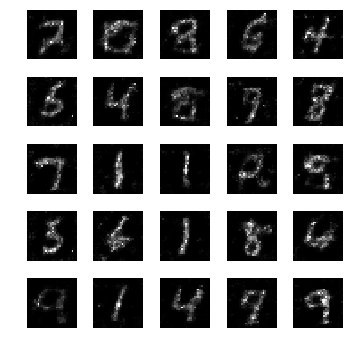

epoch: 691, time: 5.002334 | train_G_Loss: 0.354727, train_D_loss: 2.365266, train_acc: 0.935547
cv_G_Loss: 0.339912, cv_D_loss: 2.387250, cv_acc: 0.910400

epoch: 692, time: 4.984711 | train_G_Loss: 0.386312, train_D_loss: 2.291688, train_acc: 0.892578
cv_G_Loss: 0.923355, cv_D_loss: 2.858279, cv_acc: 0.912200

epoch: 693, time: 4.973731 | train_G_Loss: 0.374989, train_D_loss: 2.357849, train_acc: 0.912109
cv_G_Loss: 0.142524, cv_D_loss: 2.775044, cv_acc: 0.916100

epoch: 694, time: 4.987972 | train_G_Loss: 0.429862, train_D_loss: 2.228670, train_acc: 0.898438
cv_G_Loss: 0.732104, cv_D_loss: 2.629226, cv_acc: 0.913300

epoch: 695, time: 5.022744 | train_G_Loss: 0.397821, train_D_loss: 2.379427, train_acc: 0.892578
cv_G_Loss: 0.531059, cv_D_loss: 2.422909, cv_acc: 0.908500

epoch: 696, time: 4.985151 | train_G_Loss: 0.391549, train_D_loss: 2.486818, train_acc: 0.890625
cv_G_Loss: 0.766064, cv_D_loss: 2.661614, cv_acc: 0.909300

epoch: 697, time: 4.978544 | train_G_Loss: 0.382329, train

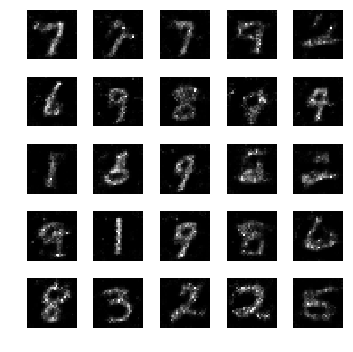

epoch: 701, time: 5.017063 | train_G_Loss: 0.337241, train_D_loss: 2.478122, train_acc: 0.910156
cv_G_Loss: 0.323362, cv_D_loss: 2.536535, cv_acc: 0.906500

epoch: 702, time: 4.971926 | train_G_Loss: 0.334354, train_D_loss: 2.474066, train_acc: 0.908203
cv_G_Loss: 0.342022, cv_D_loss: 2.442394, cv_acc: 0.904200

epoch: 703, time: 4.983286 | train_G_Loss: 0.353172, train_D_loss: 2.553745, train_acc: 0.906250
cv_G_Loss: 0.713542, cv_D_loss: 2.549046, cv_acc: 0.897800

epoch: 704, time: 4.970876 | train_G_Loss: 0.520831, train_D_loss: 2.232571, train_acc: 0.912109
cv_G_Loss: 0.544966, cv_D_loss: 2.403991, cv_acc: 0.912500

epoch: 705, time: 4.974039 | train_G_Loss: 0.366531, train_D_loss: 2.436417, train_acc: 0.904297
cv_G_Loss: 0.392325, cv_D_loss: 2.349492, cv_acc: 0.911900

epoch: 706, time: 4.984172 | train_G_Loss: 0.290766, train_D_loss: 2.333381, train_acc: 0.892578
cv_G_Loss: 0.264301, cv_D_loss: 2.390357, cv_acc: 0.920800
Model saved

epoch: 707, time: 4.987575 | train_G_Loss: 0.3

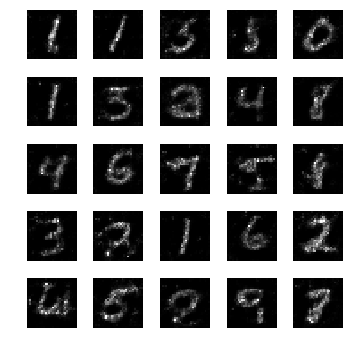

epoch: 711, time: 5.008918 | train_G_Loss: 0.339363, train_D_loss: 2.320963, train_acc: 0.892578
cv_G_Loss: 0.180332, cv_D_loss: 2.641381, cv_acc: 0.904300

epoch: 712, time: 4.974878 | train_G_Loss: 0.409195, train_D_loss: 2.461588, train_acc: 0.890625
cv_G_Loss: 1.014664, cv_D_loss: 2.945008, cv_acc: 0.921500
Model saved

epoch: 713, time: 4.994897 | train_G_Loss: 0.437216, train_D_loss: 2.405644, train_acc: 0.900391
cv_G_Loss: 0.995623, cv_D_loss: 2.877095, cv_acc: 0.919400

epoch: 714, time: 4.977325 | train_G_Loss: 0.369353, train_D_loss: 2.359286, train_acc: 0.914062
cv_G_Loss: 1.031469, cv_D_loss: 2.986702, cv_acc: 0.917700

epoch: 715, time: 4.965155 | train_G_Loss: 0.475944, train_D_loss: 2.282940, train_acc: 0.945312
cv_G_Loss: 1.147344, cv_D_loss: 3.080852, cv_acc: 0.919000

epoch: 716, time: 4.975687 | train_G_Loss: 0.340542, train_D_loss: 2.296798, train_acc: 0.896484
cv_G_Loss: 1.161436, cv_D_loss: 3.208753, cv_acc: 0.902300

epoch: 717, time: 5.012905 | train_G_Loss: 0.3

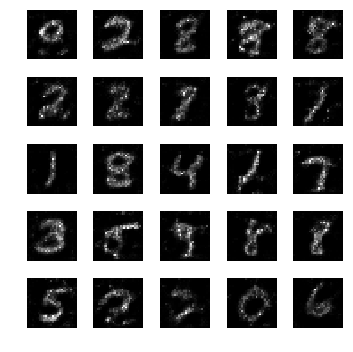

epoch: 721, time: 4.999598 | train_G_Loss: 0.450534, train_D_loss: 2.268665, train_acc: 0.923828
cv_G_Loss: 0.971538, cv_D_loss: 2.889378, cv_acc: 0.919400

epoch: 722, time: 4.983293 | train_G_Loss: 0.371246, train_D_loss: 2.411983, train_acc: 0.904297
cv_G_Loss: 0.298688, cv_D_loss: 2.365938, cv_acc: 0.919700

epoch: 723, time: 4.976659 | train_G_Loss: 0.431674, train_D_loss: 2.339010, train_acc: 0.917969
cv_G_Loss: 0.289375, cv_D_loss: 2.470204, cv_acc: 0.915300

epoch: 724, time: 4.960493 | train_G_Loss: 0.285474, train_D_loss: 2.391132, train_acc: 0.923828
cv_G_Loss: 0.409500, cv_D_loss: 2.362257, cv_acc: 0.921300

epoch: 725, time: 4.981102 | train_G_Loss: 0.448100, train_D_loss: 2.308833, train_acc: 0.910156
cv_G_Loss: 0.192287, cv_D_loss: 2.665374, cv_acc: 0.891900

epoch: 726, time: 4.974334 | train_G_Loss: 0.377318, train_D_loss: 2.216384, train_acc: 0.898438
cv_G_Loss: 0.233835, cv_D_loss: 2.482260, cv_acc: 0.917400

epoch: 727, time: 4.984043 | train_G_Loss: 0.377466, train

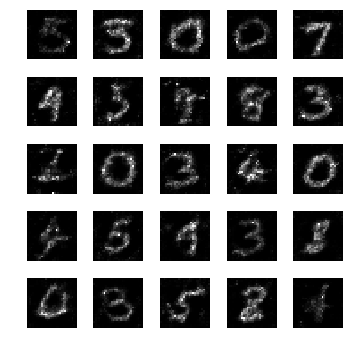

epoch: 731, time: 4.994036 | train_G_Loss: 0.480207, train_D_loss: 2.315300, train_acc: 0.923828
cv_G_Loss: 0.946472, cv_D_loss: 2.935175, cv_acc: 0.917500

epoch: 732, time: 4.994266 | train_G_Loss: 0.390822, train_D_loss: 2.333331, train_acc: 0.916016
cv_G_Loss: 0.519324, cv_D_loss: 2.519046, cv_acc: 0.902500

epoch: 733, time: 4.973487 | train_G_Loss: 0.424097, train_D_loss: 2.245254, train_acc: 0.925781
cv_G_Loss: 0.341216, cv_D_loss: 2.393808, cv_acc: 0.909800

epoch: 734, time: 4.994150 | train_G_Loss: 0.351566, train_D_loss: 2.325728, train_acc: 0.914062
cv_G_Loss: 0.381263, cv_D_loss: 2.424530, cv_acc: 0.900800

epoch: 735, time: 4.993410 | train_G_Loss: 0.465402, train_D_loss: 2.271569, train_acc: 0.933594
cv_G_Loss: 1.632517, cv_D_loss: 3.982704, cv_acc: 0.914800

epoch: 736, time: 4.993093 | train_G_Loss: 0.425867, train_D_loss: 2.459439, train_acc: 0.931641
cv_G_Loss: 0.784437, cv_D_loss: 2.660084, cv_acc: 0.919200

epoch: 737, time: 4.971795 | train_G_Loss: 0.490327, train

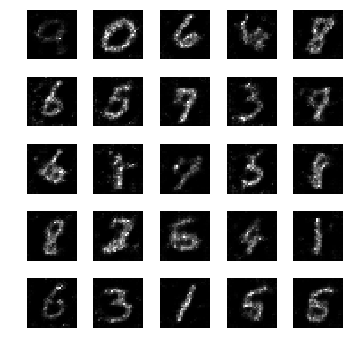

epoch: 741, time: 5.002520 | train_G_Loss: 0.390932, train_D_loss: 2.125331, train_acc: 0.937500
cv_G_Loss: 2.114332, cv_D_loss: 4.806160, cv_acc: 0.912600

epoch: 742, time: 4.976444 | train_G_Loss: 0.321550, train_D_loss: 2.214414, train_acc: 0.947266
cv_G_Loss: 0.105096, cv_D_loss: 2.968161, cv_acc: 0.907500

epoch: 743, time: 4.995515 | train_G_Loss: 0.436640, train_D_loss: 2.409615, train_acc: 0.923828
cv_G_Loss: 1.198620, cv_D_loss: 3.243332, cv_acc: 0.912900

epoch: 744, time: 4.981365 | train_G_Loss: 0.386499, train_D_loss: 2.340301, train_acc: 0.914062
cv_G_Loss: 0.272895, cv_D_loss: 2.465791, cv_acc: 0.909200

epoch: 745, time: 5.067205 | train_G_Loss: 0.312002, train_D_loss: 2.423336, train_acc: 0.921875
cv_G_Loss: 0.287033, cv_D_loss: 2.444968, cv_acc: 0.907700

epoch: 746, time: 4.990329 | train_G_Loss: 0.437555, train_D_loss: 2.367576, train_acc: 0.937500
cv_G_Loss: 0.769476, cv_D_loss: 2.813980, cv_acc: 0.898200

epoch: 747, time: 4.974906 | train_G_Loss: 0.365236, train

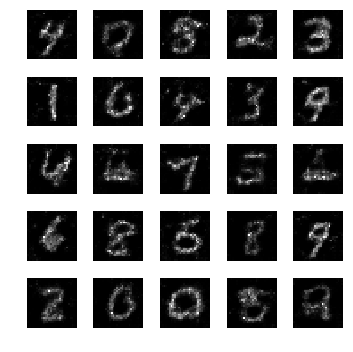

epoch: 751, time: 5.005298 | train_G_Loss: 0.314677, train_D_loss: 2.310544, train_acc: 0.923828
cv_G_Loss: 0.529897, cv_D_loss: 2.497215, cv_acc: 0.908400

epoch: 752, time: 4.982479 | train_G_Loss: 0.329163, train_D_loss: 2.269635, train_acc: 0.921875
cv_G_Loss: 0.135650, cv_D_loss: 2.825702, cv_acc: 0.900200

epoch: 753, time: 4.985768 | train_G_Loss: 0.417395, train_D_loss: 2.397432, train_acc: 0.908203
cv_G_Loss: 0.353806, cv_D_loss: 2.413567, cv_acc: 0.912100

epoch: 754, time: 5.185184 | train_G_Loss: 0.369533, train_D_loss: 2.330263, train_acc: 0.914062
cv_G_Loss: 1.288686, cv_D_loss: 3.435280, cv_acc: 0.908600

epoch: 755, time: 5.314366 | train_G_Loss: 0.363132, train_D_loss: 2.342390, train_acc: 0.882812
cv_G_Loss: 0.504217, cv_D_loss: 2.373770, cv_acc: 0.923400
Model saved

epoch: 756, time: 5.357303 | train_G_Loss: 0.442086, train_D_loss: 2.291288, train_acc: 0.890625
cv_G_Loss: 1.673295, cv_D_loss: 4.016655, cv_acc: 0.904900

epoch: 757, time: 5.236147 | train_G_Loss: 0.5

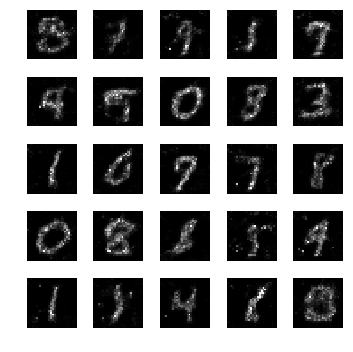

epoch: 761, time: 5.120544 | train_G_Loss: 0.386181, train_D_loss: 2.296907, train_acc: 0.917969
cv_G_Loss: 0.516927, cv_D_loss: 2.539536, cv_acc: 0.900600

epoch: 762, time: 5.078625 | train_G_Loss: 0.472155, train_D_loss: 2.140182, train_acc: 0.947266
cv_G_Loss: 0.829320, cv_D_loss: 2.769386, cv_acc: 0.910500

epoch: 763, time: 5.027547 | train_G_Loss: 0.447441, train_D_loss: 2.290329, train_acc: 0.939453
cv_G_Loss: 0.883682, cv_D_loss: 2.808636, cv_acc: 0.918500

epoch: 764, time: 5.040867 | train_G_Loss: 0.376402, train_D_loss: 2.240920, train_acc: 0.947266
cv_G_Loss: 0.098200, cv_D_loss: 3.087337, cv_acc: 0.885700

epoch: 765, time: 5.027921 | train_G_Loss: 0.502035, train_D_loss: 2.310683, train_acc: 0.917969
cv_G_Loss: 0.864883, cv_D_loss: 2.753770, cv_acc: 0.919300

epoch: 766, time: 5.033551 | train_G_Loss: 0.310216, train_D_loss: 2.594942, train_acc: 0.900391
cv_G_Loss: 0.623149, cv_D_loss: 2.491875, cv_acc: 0.917500

epoch: 767, time: 5.037430 | train_G_Loss: 0.358536, train

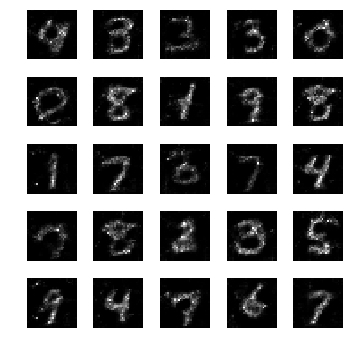

epoch: 771, time: 5.066329 | train_G_Loss: 0.329692, train_D_loss: 2.626490, train_acc: 0.892578
cv_G_Loss: 0.171506, cv_D_loss: 2.644232, cv_acc: 0.909100

epoch: 772, time: 5.040647 | train_G_Loss: 0.303210, train_D_loss: 2.312964, train_acc: 0.923828
cv_G_Loss: 0.870527, cv_D_loss: 2.788982, cv_acc: 0.920600

epoch: 773, time: 5.028050 | train_G_Loss: 0.423095, train_D_loss: 2.379968, train_acc: 0.906250
cv_G_Loss: 1.200595, cv_D_loss: 3.274048, cv_acc: 0.914300

epoch: 774, time: 5.026970 | train_G_Loss: 0.394230, train_D_loss: 2.428752, train_acc: 0.876953
cv_G_Loss: 0.689395, cv_D_loss: 2.566853, cv_acc: 0.916100

epoch: 775, time: 5.016376 | train_G_Loss: 0.418765, train_D_loss: 2.404211, train_acc: 0.888672
cv_G_Loss: 0.248027, cv_D_loss: 2.651161, cv_acc: 0.868100

epoch: 776, time: 5.029109 | train_G_Loss: 0.293104, train_D_loss: 2.552744, train_acc: 0.882812
cv_G_Loss: 1.002574, cv_D_loss: 2.939287, cv_acc: 0.921900

epoch: 777, time: 5.031376 | train_G_Loss: 0.336823, train

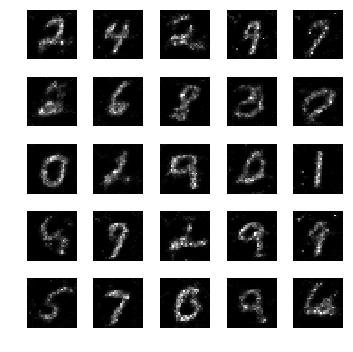

epoch: 781, time: 5.066899 | train_G_Loss: 0.330611, train_D_loss: 2.478662, train_acc: 0.923828
cv_G_Loss: 0.409466, cv_D_loss: 2.350917, cv_acc: 0.920300

epoch: 782, time: 5.019185 | train_G_Loss: 0.367045, train_D_loss: 2.283976, train_acc: 0.923828
cv_G_Loss: 0.389884, cv_D_loss: 2.378294, cv_acc: 0.909900

epoch: 783, time: 5.033450 | train_G_Loss: 0.434272, train_D_loss: 2.309992, train_acc: 0.914062
cv_G_Loss: 1.100532, cv_D_loss: 3.091708, cv_acc: 0.921600

epoch: 784, time: 5.058640 | train_G_Loss: 0.709467, train_D_loss: 2.527311, train_acc: 0.906250
cv_G_Loss: 1.829631, cv_D_loss: 4.238902, cv_acc: 0.911300

epoch: 785, time: 5.036057 | train_G_Loss: 0.465952, train_D_loss: 2.448061, train_acc: 0.923828
cv_G_Loss: 2.543961, cv_D_loss: 5.789187, cv_acc: 0.884500

epoch: 786, time: 5.020203 | train_G_Loss: 0.345360, train_D_loss: 2.384109, train_acc: 0.908203
cv_G_Loss: 0.531022, cv_D_loss: 2.410994, cv_acc: 0.921300

epoch: 787, time: 5.029774 | train_G_Loss: 0.367159, train

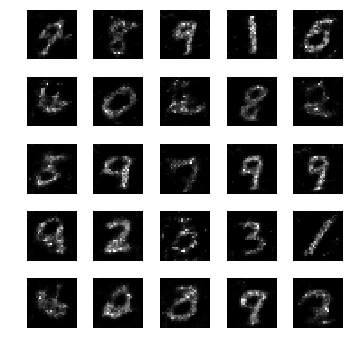

epoch: 791, time: 5.095263 | train_G_Loss: 0.420204, train_D_loss: 2.232280, train_acc: 0.937500
cv_G_Loss: 0.682435, cv_D_loss: 2.485098, cv_acc: 0.917200

epoch: 792, time: 5.052201 | train_G_Loss: 0.362804, train_D_loss: 2.333711, train_acc: 0.931641
cv_G_Loss: 0.822835, cv_D_loss: 2.779276, cv_acc: 0.902900

epoch: 793, time: 5.057914 | train_G_Loss: 0.380584, train_D_loss: 2.356378, train_acc: 0.939453
cv_G_Loss: 1.344649, cv_D_loss: 3.513822, cv_acc: 0.918800

epoch: 794, time: 5.057684 | train_G_Loss: 0.372955, train_D_loss: 2.401597, train_acc: 0.914062
cv_G_Loss: 1.956730, cv_D_loss: 5.120199, cv_acc: 0.701600

epoch: 795, time: 5.067804 | train_G_Loss: 0.450614, train_D_loss: 2.340892, train_acc: 0.939453
cv_G_Loss: 0.564790, cv_D_loss: 2.432543, cv_acc: 0.923400

epoch: 796, time: 5.060827 | train_G_Loss: 0.374149, train_D_loss: 2.158130, train_acc: 0.937500
cv_G_Loss: 0.372145, cv_D_loss: 2.371085, cv_acc: 0.915900

epoch: 797, time: 5.073797 | train_G_Loss: 0.359993, train

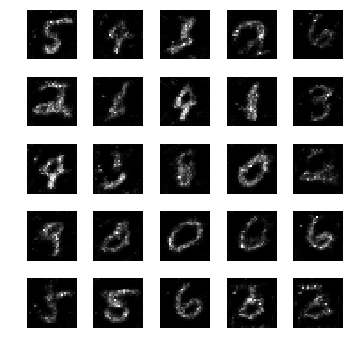

epoch: 801, time: 5.096872 | train_G_Loss: 0.414519, train_D_loss: 2.234790, train_acc: 0.917969
cv_G_Loss: 0.326749, cv_D_loss: 2.367093, cv_acc: 0.919400

epoch: 802, time: 5.079040 | train_G_Loss: 0.356372, train_D_loss: 2.492259, train_acc: 0.886719
cv_G_Loss: 0.185392, cv_D_loss: 2.557755, cv_acc: 0.908100

epoch: 803, time: 5.080078 | train_G_Loss: 0.385423, train_D_loss: 2.564385, train_acc: 0.886719
cv_G_Loss: 0.581778, cv_D_loss: 2.418108, cv_acc: 0.919400

epoch: 804, time: 5.078321 | train_G_Loss: 0.358535, train_D_loss: 2.299371, train_acc: 0.935547
cv_G_Loss: 1.468238, cv_D_loss: 3.717156, cv_acc: 0.915000

epoch: 805, time: 5.075064 | train_G_Loss: 0.408969, train_D_loss: 2.363137, train_acc: 0.935547
cv_G_Loss: 0.170695, cv_D_loss: 2.663884, cv_acc: 0.916100

epoch: 806, time: 5.129318 | train_G_Loss: 0.469861, train_D_loss: 2.272005, train_acc: 0.912109
cv_G_Loss: 0.213659, cv_D_loss: 2.658102, cv_acc: 0.877000

epoch: 807, time: 5.074815 | train_G_Loss: 0.448819, train

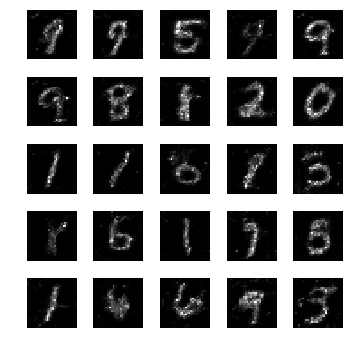

epoch: 811, time: 5.106058 | train_G_Loss: 0.403570, train_D_loss: 2.358084, train_acc: 0.916016
cv_G_Loss: 0.399331, cv_D_loss: 2.333961, cv_acc: 0.918800

epoch: 812, time: 5.072150 | train_G_Loss: 0.388368, train_D_loss: 2.337615, train_acc: 0.933594
cv_G_Loss: 0.631864, cv_D_loss: 2.475305, cv_acc: 0.917900

epoch: 813, time: 5.074974 | train_G_Loss: 0.414149, train_D_loss: 2.195280, train_acc: 0.941406
cv_G_Loss: 0.386094, cv_D_loss: 2.498990, cv_acc: 0.899600

epoch: 814, time: 5.060680 | train_G_Loss: 0.386391, train_D_loss: 2.367404, train_acc: 0.933594
cv_G_Loss: 1.450225, cv_D_loss: 3.651616, cv_acc: 0.914800

epoch: 815, time: 5.057894 | train_G_Loss: 0.361955, train_D_loss: 2.264884, train_acc: 0.931641
cv_G_Loss: 0.323288, cv_D_loss: 2.367484, cv_acc: 0.919000

epoch: 816, time: 5.974588 | train_G_Loss: 0.399823, train_D_loss: 2.428076, train_acc: 0.884766
cv_G_Loss: 0.256196, cv_D_loss: 2.427506, cv_acc: 0.915100

epoch: 817, time: 5.060699 | train_G_Loss: 0.424193, train

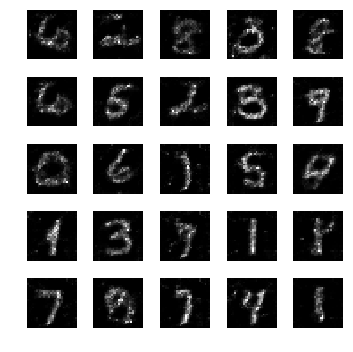

epoch: 821, time: 5.064065 | train_G_Loss: 0.425990, train_D_loss: 2.333966, train_acc: 0.937500
cv_G_Loss: 2.061008, cv_D_loss: 4.886537, cv_acc: 0.889500

epoch: 822, time: 5.043620 | train_G_Loss: 0.495125, train_D_loss: 2.311167, train_acc: 0.931641
cv_G_Loss: 0.608090, cv_D_loss: 2.517666, cv_acc: 0.908600

epoch: 823, time: 5.286298 | train_G_Loss: 0.406597, train_D_loss: 2.374167, train_acc: 0.919922
cv_G_Loss: 0.241550, cv_D_loss: 2.507701, cv_acc: 0.908700

epoch: 824, time: 5.393284 | train_G_Loss: 0.380998, train_D_loss: 2.364413, train_acc: 0.933594
cv_G_Loss: 0.902537, cv_D_loss: 2.886961, cv_acc: 0.898800

epoch: 825, time: 5.306451 | train_G_Loss: 0.389727, train_D_loss: 2.367571, train_acc: 0.917969
cv_G_Loss: 0.464292, cv_D_loss: 2.381204, cv_acc: 0.919100

epoch: 826, time: 5.179877 | train_G_Loss: 0.314467, train_D_loss: 2.474757, train_acc: 0.912109
cv_G_Loss: 0.426609, cv_D_loss: 2.353911, cv_acc: 0.915200

epoch: 827, time: 5.106993 | train_G_Loss: 0.296565, train

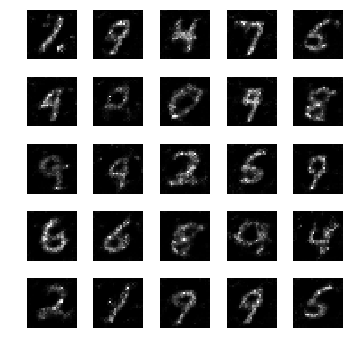

epoch: 831, time: 5.155938 | train_G_Loss: 0.353933, train_D_loss: 2.427733, train_acc: 0.894531
cv_G_Loss: 0.191678, cv_D_loss: 2.563409, cv_acc: 0.914100

epoch: 832, time: 5.261001 | train_G_Loss: 0.361088, train_D_loss: 2.349560, train_acc: 0.917969
cv_G_Loss: 0.558898, cv_D_loss: 2.521558, cv_acc: 0.910200

epoch: 833, time: 5.369663 | train_G_Loss: 0.402986, train_D_loss: 2.383115, train_acc: 0.906250
cv_G_Loss: 0.191567, cv_D_loss: 2.591221, cv_acc: 0.914500

epoch: 834, time: 5.090953 | train_G_Loss: 0.438097, train_D_loss: 2.645794, train_acc: 0.884766
cv_G_Loss: 1.858678, cv_D_loss: 4.460121, cv_acc: 0.898700

epoch: 835, time: 5.064083 | train_G_Loss: 0.317839, train_D_loss: 2.393659, train_acc: 0.878906
cv_G_Loss: 0.382276, cv_D_loss: 2.364055, cv_acc: 0.911800

epoch: 836, time: 5.069380 | train_G_Loss: 0.347493, train_D_loss: 2.477849, train_acc: 0.898438
cv_G_Loss: 0.263594, cv_D_loss: 2.464258, cv_acc: 0.911800

epoch: 837, time: 5.107071 | train_G_Loss: 0.584251, train

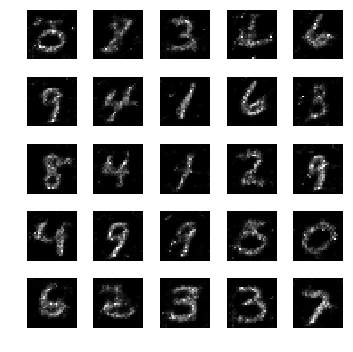

epoch: 841, time: 5.112122 | train_G_Loss: 0.365318, train_D_loss: 2.295055, train_acc: 0.962891
cv_G_Loss: 0.773474, cv_D_loss: 2.644296, cv_acc: 0.912300

epoch: 842, time: 5.076360 | train_G_Loss: 0.406802, train_D_loss: 2.320264, train_acc: 0.933594
cv_G_Loss: 0.181442, cv_D_loss: 2.618588, cv_acc: 0.916300

epoch: 843, time: 5.070798 | train_G_Loss: 0.378718, train_D_loss: 2.288214, train_acc: 0.908203
cv_G_Loss: 0.265033, cv_D_loss: 2.492082, cv_acc: 0.908300

epoch: 844, time: 5.072700 | train_G_Loss: 0.398742, train_D_loss: 2.425532, train_acc: 0.919922
cv_G_Loss: 0.396692, cv_D_loss: 2.436064, cv_acc: 0.908900

epoch: 845, time: 5.061275 | train_G_Loss: 0.422865, train_D_loss: 2.237837, train_acc: 0.925781
cv_G_Loss: 0.319551, cv_D_loss: 2.355248, cv_acc: 0.922000

epoch: 846, time: 5.073231 | train_G_Loss: 0.369099, train_D_loss: 2.310030, train_acc: 0.927734
cv_G_Loss: 0.248953, cv_D_loss: 2.432180, cv_acc: 0.925700
Model saved

epoch: 847, time: 5.082649 | train_G_Loss: 0.4

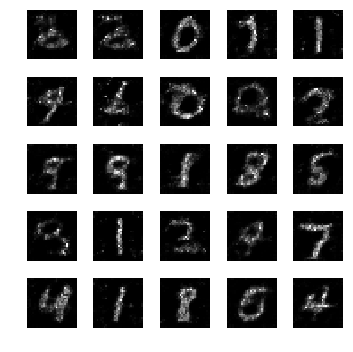

epoch: 851, time: 5.087728 | train_G_Loss: 0.321339, train_D_loss: 2.351706, train_acc: 0.921875
cv_G_Loss: 0.217949, cv_D_loss: 2.555664, cv_acc: 0.910500

epoch: 852, time: 5.067782 | train_G_Loss: 0.265454, train_D_loss: 2.437874, train_acc: 0.888672
cv_G_Loss: 0.108582, cv_D_loss: 3.000027, cv_acc: 0.896200

epoch: 853, time: 5.073528 | train_G_Loss: 0.488966, train_D_loss: 2.505540, train_acc: 0.869141
cv_G_Loss: 0.914369, cv_D_loss: 3.087739, cv_acc: 0.877900

epoch: 854, time: 5.062607 | train_G_Loss: 0.431191, train_D_loss: 2.339703, train_acc: 0.931641
cv_G_Loss: 0.619658, cv_D_loss: 2.454028, cv_acc: 0.925100

epoch: 855, time: 5.059568 | train_G_Loss: 0.363644, train_D_loss: 2.311828, train_acc: 0.935547
cv_G_Loss: 0.781884, cv_D_loss: 2.596904, cv_acc: 0.924700

epoch: 856, time: 5.069923 | train_G_Loss: 0.348025, train_D_loss: 2.360487, train_acc: 0.925781
cv_G_Loss: 0.308271, cv_D_loss: 2.347389, cv_acc: 0.925500

epoch: 857, time: 5.063605 | train_G_Loss: 0.420996, train

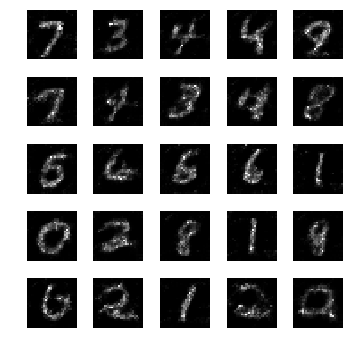

epoch: 861, time: 5.101992 | train_G_Loss: 0.356639, train_D_loss: 2.305041, train_acc: 0.914062
cv_G_Loss: 0.494802, cv_D_loss: 2.348250, cv_acc: 0.926400
Model saved

epoch: 862, time: 5.078219 | train_G_Loss: 0.432705, train_D_loss: 2.344576, train_acc: 0.921875
cv_G_Loss: 1.018613, cv_D_loss: 2.928533, cv_acc: 0.927000
Model saved

epoch: 863, time: 5.043914 | train_G_Loss: 0.483615, train_D_loss: 2.362691, train_acc: 0.923828
cv_G_Loss: 0.903929, cv_D_loss: 2.748092, cv_acc: 0.930300
Model saved

epoch: 864, time: 5.068852 | train_G_Loss: 0.450498, train_D_loss: 2.252934, train_acc: 0.931641
cv_G_Loss: 0.450460, cv_D_loss: 2.372312, cv_acc: 0.924100

epoch: 865, time: 5.051219 | train_G_Loss: 0.222220, train_D_loss: 2.390265, train_acc: 0.914062
cv_G_Loss: 0.033339, cv_D_loss: 3.923885, cv_acc: 0.915700

epoch: 866, time: 5.044727 | train_G_Loss: 0.377766, train_D_loss: 2.315570, train_acc: 0.906250
cv_G_Loss: 0.233484, cv_D_loss: 2.681369, cv_acc: 0.874500

epoch: 867, time: 5.04

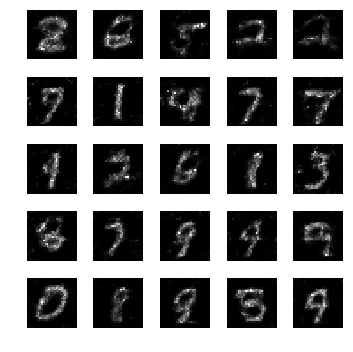

epoch: 871, time: 5.145798 | train_G_Loss: 0.334248, train_D_loss: 2.362694, train_acc: 0.890625
cv_G_Loss: 0.114492, cv_D_loss: 2.866802, cv_acc: 0.914300

epoch: 872, time: 5.072402 | train_G_Loss: 0.324906, train_D_loss: 2.440158, train_acc: 0.923828
cv_G_Loss: 0.436936, cv_D_loss: 2.319512, cv_acc: 0.930200

epoch: 873, time: 5.076824 | train_G_Loss: 0.434987, train_D_loss: 2.342966, train_acc: 0.949219
cv_G_Loss: 1.029509, cv_D_loss: 2.915497, cv_acc: 0.918200

epoch: 874, time: 5.068376 | train_G_Loss: 0.406628, train_D_loss: 2.321860, train_acc: 0.929688
cv_G_Loss: 0.456387, cv_D_loss: 2.530667, cv_acc: 0.890700

epoch: 875, time: 5.058372 | train_G_Loss: 0.505614, train_D_loss: 2.432926, train_acc: 0.902344
cv_G_Loss: 0.474829, cv_D_loss: 2.457167, cv_acc: 0.900600

epoch: 876, time: 5.068259 | train_G_Loss: 0.378547, train_D_loss: 2.425112, train_acc: 0.927734
cv_G_Loss: 0.914248, cv_D_loss: 2.779801, cv_acc: 0.922300

epoch: 877, time: 5.072037 | train_G_Loss: 0.361595, train

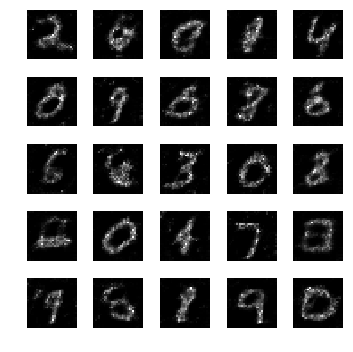

epoch: 881, time: 5.109930 | train_G_Loss: 0.439222, train_D_loss: 2.397514, train_acc: 0.898438
cv_G_Loss: 0.224445, cv_D_loss: 2.466419, cv_acc: 0.924000

epoch: 882, time: 5.069617 | train_G_Loss: 0.336282, train_D_loss: 2.473349, train_acc: 0.900391
cv_G_Loss: 0.133153, cv_D_loss: 2.750964, cv_acc: 0.923900

epoch: 883, time: 5.070653 | train_G_Loss: 0.384027, train_D_loss: 2.308270, train_acc: 0.919922
cv_G_Loss: 0.318494, cv_D_loss: 2.336385, cv_acc: 0.926200

epoch: 884, time: 5.078979 | train_G_Loss: 0.747614, train_D_loss: 2.444393, train_acc: 0.935547
cv_G_Loss: 2.069710, cv_D_loss: 4.767601, cv_acc: 0.924200

epoch: 885, time: 5.077247 | train_G_Loss: 0.428370, train_D_loss: 2.264871, train_acc: 0.923828
cv_G_Loss: 1.314975, cv_D_loss: 3.503415, cv_acc: 0.911000

epoch: 886, time: 5.075991 | train_G_Loss: 0.468163, train_D_loss: 2.189482, train_acc: 0.910156
cv_G_Loss: 0.888045, cv_D_loss: 2.988243, cv_acc: 0.881500

epoch: 887, time: 5.088732 | train_G_Loss: 0.304949, train

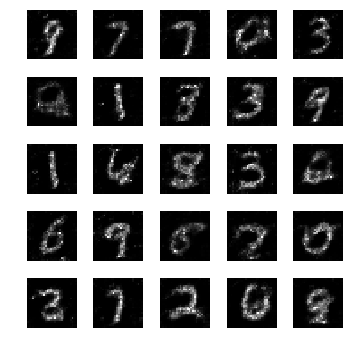

epoch: 891, time: 5.087872 | train_G_Loss: 0.381398, train_D_loss: 2.343222, train_acc: 0.908203
cv_G_Loss: 1.866029, cv_D_loss: 4.404465, cv_acc: 0.909700

epoch: 892, time: 5.045540 | train_G_Loss: 0.323186, train_D_loss: 2.354978, train_acc: 0.902344
cv_G_Loss: 0.222033, cv_D_loss: 2.490977, cv_acc: 0.918600

epoch: 893, time: 5.107447 | train_G_Loss: 0.412561, train_D_loss: 2.337165, train_acc: 0.878906
cv_G_Loss: 0.132855, cv_D_loss: 3.076991, cv_acc: 0.849600

epoch: 894, time: 5.049973 | train_G_Loss: 0.307897, train_D_loss: 2.518162, train_acc: 0.884766
cv_G_Loss: 0.936064, cv_D_loss: 2.878933, cv_acc: 0.904300

epoch: 895, time: 5.038772 | train_G_Loss: 0.503923, train_D_loss: 2.317719, train_acc: 0.927734
cv_G_Loss: 0.372413, cv_D_loss: 2.406221, cv_acc: 0.918400

epoch: 896, time: 5.060118 | train_G_Loss: 0.457592, train_D_loss: 2.401485, train_acc: 0.912109
cv_G_Loss: 0.683427, cv_D_loss: 2.526909, cv_acc: 0.922900

epoch: 897, time: 5.045884 | train_G_Loss: 0.294487, train

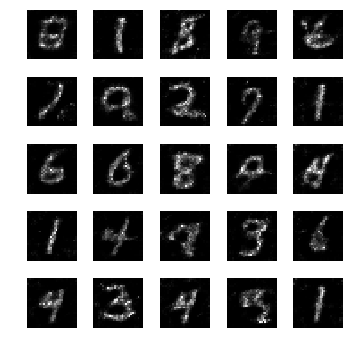

epoch: 901, time: 5.088382 | train_G_Loss: 0.496605, train_D_loss: 2.307851, train_acc: 0.945312
cv_G_Loss: 1.207637, cv_D_loss: 3.225766, cv_acc: 0.924100

epoch: 902, time: 5.044045 | train_G_Loss: 0.235931, train_D_loss: 2.364522, train_acc: 0.908203
cv_G_Loss: 0.583807, cv_D_loss: 2.383378, cv_acc: 0.927200

epoch: 903, time: 5.048383 | train_G_Loss: 0.339829, train_D_loss: 2.622691, train_acc: 0.916016
cv_G_Loss: 0.820208, cv_D_loss: 2.829540, cv_acc: 0.903800

epoch: 904, time: 5.060730 | train_G_Loss: 0.430844, train_D_loss: 2.297278, train_acc: 0.916016
cv_G_Loss: 0.760199, cv_D_loss: 2.608515, cv_acc: 0.930400
Model saved

epoch: 905, time: 5.061587 | train_G_Loss: 0.350450, train_D_loss: 2.528375, train_acc: 0.880859
cv_G_Loss: 0.280704, cv_D_loss: 2.360926, cv_acc: 0.926900

epoch: 906, time: 5.042308 | train_G_Loss: 0.413875, train_D_loss: 2.436358, train_acc: 0.931641
cv_G_Loss: 1.264785, cv_D_loss: 3.219608, cv_acc: 0.925900

epoch: 907, time: 5.032241 | train_G_Loss: 0.3

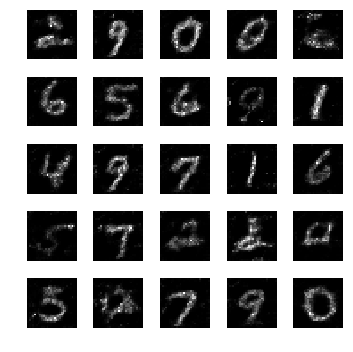

epoch: 911, time: 5.103881 | train_G_Loss: 0.469450, train_D_loss: 2.281370, train_acc: 0.921875
cv_G_Loss: 1.780324, cv_D_loss: 4.397766, cv_acc: 0.886600

epoch: 912, time: 5.071226 | train_G_Loss: 0.436482, train_D_loss: 2.278845, train_acc: 0.908203
cv_G_Loss: 1.947038, cv_D_loss: 4.367249, cv_acc: 0.921200

epoch: 913, time: 5.067057 | train_G_Loss: 0.355781, train_D_loss: 2.198534, train_acc: 0.933594
cv_G_Loss: 1.130028, cv_D_loss: 3.050094, cv_acc: 0.922800

epoch: 914, time: 5.057587 | train_G_Loss: 0.364215, train_D_loss: 2.321954, train_acc: 0.955078
cv_G_Loss: 0.288581, cv_D_loss: 2.382548, cv_acc: 0.924600

epoch: 915, time: 5.100541 | train_G_Loss: 0.345501, train_D_loss: 2.190696, train_acc: 0.939453
cv_G_Loss: 0.143710, cv_D_loss: 2.699713, cv_acc: 0.924900

epoch: 916, time: 5.055995 | train_G_Loss: 0.494742, train_D_loss: 2.219035, train_acc: 0.951172
cv_G_Loss: 1.415147, cv_D_loss: 3.536309, cv_acc: 0.927400

epoch: 917, time: 5.059742 | train_G_Loss: 0.349456, train

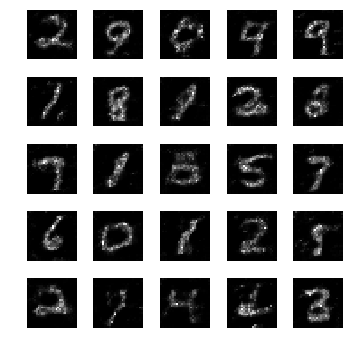

epoch: 921, time: 5.083304 | train_G_Loss: 0.430980, train_D_loss: 2.273025, train_acc: 0.933594
cv_G_Loss: 0.273527, cv_D_loss: 2.456715, cv_acc: 0.902900

epoch: 922, time: 5.046193 | train_G_Loss: 0.339127, train_D_loss: 2.420563, train_acc: 0.953125
cv_G_Loss: 1.237505, cv_D_loss: 3.342814, cv_acc: 0.922300

epoch: 923, time: 5.050733 | train_G_Loss: 0.454388, train_D_loss: 2.209543, train_acc: 0.955078
cv_G_Loss: 1.770949, cv_D_loss: 4.142629, cv_acc: 0.926600

epoch: 924, time: 5.059556 | train_G_Loss: 0.658137, train_D_loss: 2.336637, train_acc: 0.958984
cv_G_Loss: 1.062863, cv_D_loss: 2.945924, cv_acc: 0.928900

epoch: 925, time: 5.084201 | train_G_Loss: 0.390339, train_D_loss: 2.184719, train_acc: 0.970703
cv_G_Loss: 0.126088, cv_D_loss: 2.897114, cv_acc: 0.885400

epoch: 926, time: 5.051408 | train_G_Loss: 0.550074, train_D_loss: 2.126914, train_acc: 0.964844
cv_G_Loss: 1.035061, cv_D_loss: 2.887086, cv_acc: 0.930500

epoch: 927, time: 5.044134 | train_G_Loss: 0.359411, train

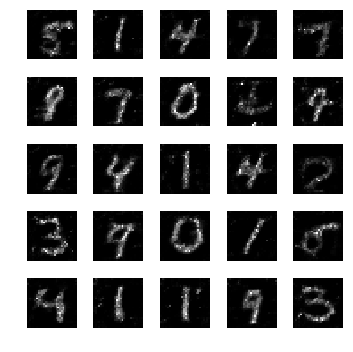

epoch: 931, time: 5.090526 | train_G_Loss: 0.358563, train_D_loss: 2.252051, train_acc: 0.937500
cv_G_Loss: 0.177367, cv_D_loss: 2.584524, cv_acc: 0.923200

epoch: 932, time: 5.048063 | train_G_Loss: 0.359460, train_D_loss: 2.342157, train_acc: 0.943359
cv_G_Loss: 0.332982, cv_D_loss: 2.380652, cv_acc: 0.915400

epoch: 933, time: 5.062828 | train_G_Loss: 0.343576, train_D_loss: 2.201358, train_acc: 0.962891
cv_G_Loss: 1.344536, cv_D_loss: 3.423795, cv_acc: 0.927600

epoch: 934, time: 5.056143 | train_G_Loss: 0.464802, train_D_loss: 2.373664, train_acc: 0.951172
cv_G_Loss: 1.101218, cv_D_loss: 3.095327, cv_acc: 0.917900

epoch: 935, time: 5.072199 | train_G_Loss: 0.462063, train_D_loss: 2.252232, train_acc: 0.908203
cv_G_Loss: 0.523233, cv_D_loss: 2.610612, cv_acc: 0.890000

epoch: 936, time: 5.049381 | train_G_Loss: 0.339977, train_D_loss: 2.461036, train_acc: 0.900391
cv_G_Loss: 0.924919, cv_D_loss: 3.098949, cv_acc: 0.871700

epoch: 937, time: 5.088793 | train_G_Loss: 0.393473, train

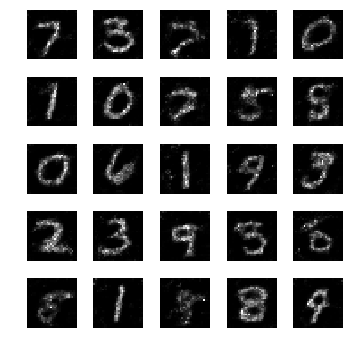

epoch: 941, time: 5.091979 | train_G_Loss: 0.349253, train_D_loss: 2.239179, train_acc: 0.896484
cv_G_Loss: 0.500603, cv_D_loss: 2.362379, cv_acc: 0.927900

epoch: 942, time: 5.068650 | train_G_Loss: 0.361958, train_D_loss: 2.584440, train_acc: 0.890625
cv_G_Loss: 0.688428, cv_D_loss: 2.600186, cv_acc: 0.924500

epoch: 943, time: 5.057734 | train_G_Loss: 0.384301, train_D_loss: 2.263493, train_acc: 0.923828
cv_G_Loss: 0.292939, cv_D_loss: 2.506703, cv_acc: 0.897500

epoch: 944, time: 5.071567 | train_G_Loss: 0.416432, train_D_loss: 2.411562, train_acc: 0.931641
cv_G_Loss: 0.533803, cv_D_loss: 2.358443, cv_acc: 0.927900

epoch: 945, time: 5.066896 | train_G_Loss: 0.353264, train_D_loss: 2.333986, train_acc: 0.945312
cv_G_Loss: 1.348974, cv_D_loss: 3.461377, cv_acc: 0.925000

epoch: 946, time: 5.035758 | train_G_Loss: 0.591688, train_D_loss: 2.192020, train_acc: 0.912109
cv_G_Loss: 1.896378, cv_D_loss: 4.409871, cv_acc: 0.923300

epoch: 947, time: 5.061992 | train_G_Loss: 0.354102, train

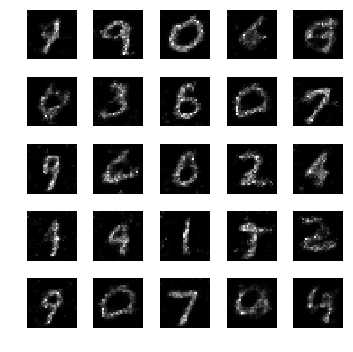

epoch: 951, time: 5.084461 | train_G_Loss: 0.359418, train_D_loss: 2.202623, train_acc: 0.914062
cv_G_Loss: 0.285305, cv_D_loss: 2.565432, cv_acc: 0.896800

epoch: 952, time: 5.058592 | train_G_Loss: 0.322420, train_D_loss: 2.461733, train_acc: 0.904297
cv_G_Loss: 0.163806, cv_D_loss: 2.745881, cv_acc: 0.889800

epoch: 953, time: 5.049705 | train_G_Loss: 0.379580, train_D_loss: 2.298555, train_acc: 0.923828
cv_G_Loss: 0.319149, cv_D_loss: 2.346326, cv_acc: 0.923900

epoch: 954, time: 5.043244 | train_G_Loss: 0.510612, train_D_loss: 2.379618, train_acc: 0.900391
cv_G_Loss: 1.966359, cv_D_loss: 4.777098, cv_acc: 0.856400

epoch: 955, time: 5.055692 | train_G_Loss: 0.414634, train_D_loss: 2.410478, train_acc: 0.912109
cv_G_Loss: 0.401816, cv_D_loss: 2.346388, cv_acc: 0.929300

epoch: 956, time: 5.060990 | train_G_Loss: 0.383572, train_D_loss: 2.332251, train_acc: 0.900391
cv_G_Loss: 0.297299, cv_D_loss: 2.418767, cv_acc: 0.907200

epoch: 957, time: 5.058721 | train_G_Loss: 0.321668, train

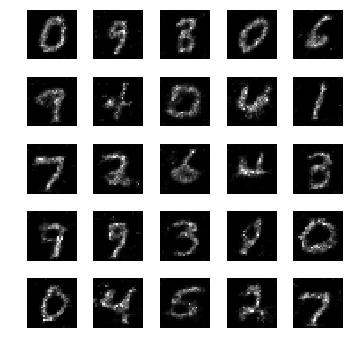

epoch: 961, time: 5.087972 | train_G_Loss: 0.313624, train_D_loss: 2.399325, train_acc: 0.896484
cv_G_Loss: 0.901889, cv_D_loss: 2.731602, cv_acc: 0.928400

epoch: 962, time: 5.048630 | train_G_Loss: 0.314370, train_D_loss: 2.479126, train_acc: 0.904297
cv_G_Loss: 1.206040, cv_D_loss: 3.321554, cv_acc: 0.901900

epoch: 963, time: 5.049780 | train_G_Loss: 0.447896, train_D_loss: 2.312294, train_acc: 0.931641
cv_G_Loss: 0.269637, cv_D_loss: 2.459345, cv_acc: 0.917400

epoch: 964, time: 5.052286 | train_G_Loss: 0.425016, train_D_loss: 2.325411, train_acc: 0.935547
cv_G_Loss: 0.975890, cv_D_loss: 2.828314, cv_acc: 0.932800
Model saved

epoch: 965, time: 5.041101 | train_G_Loss: 0.382934, train_D_loss: 2.268936, train_acc: 0.929688
cv_G_Loss: 0.979443, cv_D_loss: 2.845336, cv_acc: 0.929900

epoch: 966, time: 5.018669 | train_G_Loss: 0.379725, train_D_loss: 2.476340, train_acc: 0.904297
cv_G_Loss: 1.533861, cv_D_loss: 3.868898, cv_acc: 0.898700

epoch: 967, time: 5.011033 | train_G_Loss: 0.3

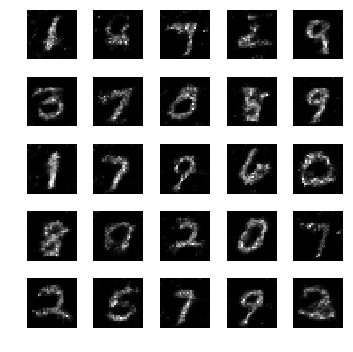

epoch: 971, time: 5.024285 | train_G_Loss: 0.293225, train_D_loss: 2.387725, train_acc: 0.929688
cv_G_Loss: 0.587919, cv_D_loss: 2.490616, cv_acc: 0.905000

epoch: 972, time: 4.999051 | train_G_Loss: 0.315223, train_D_loss: 2.444419, train_acc: 0.923828
cv_G_Loss: 0.441264, cv_D_loss: 2.348623, cv_acc: 0.927300

epoch: 973, time: 5.005787 | train_G_Loss: 0.364609, train_D_loss: 2.383879, train_acc: 0.931641
cv_G_Loss: 1.491946, cv_D_loss: 3.755331, cv_acc: 0.909900

epoch: 974, time: 5.017078 | train_G_Loss: 0.560532, train_D_loss: 2.229934, train_acc: 0.951172
cv_G_Loss: 1.133712, cv_D_loss: 3.373982, cv_acc: 0.896300

epoch: 975, time: 4.996722 | train_G_Loss: 0.465125, train_D_loss: 2.337319, train_acc: 0.929688
cv_G_Loss: 1.067306, cv_D_loss: 3.553359, cv_acc: 0.778200

epoch: 976, time: 5.007954 | train_G_Loss: 0.481519, train_D_loss: 2.228006, train_acc: 0.941406
cv_G_Loss: 2.338010, cv_D_loss: 5.199431, cv_acc: 0.908500

epoch: 977, time: 5.006338 | train_G_Loss: 0.323742, train

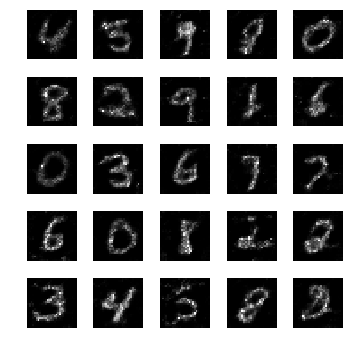

epoch: 981, time: 5.056269 | train_G_Loss: 0.735731, train_D_loss: 2.652048, train_acc: 0.939453
cv_G_Loss: 1.777284, cv_D_loss: 4.280638, cv_acc: 0.886500

epoch: 982, time: 5.028433 | train_G_Loss: 0.408888, train_D_loss: 2.136690, train_acc: 0.921875
cv_G_Loss: 0.240564, cv_D_loss: 2.490945, cv_acc: 0.905500

epoch: 983, time: 5.007517 | train_G_Loss: 0.332671, train_D_loss: 2.365894, train_acc: 0.919922
cv_G_Loss: 1.260663, cv_D_loss: 3.329796, cv_acc: 0.917300

epoch: 984, time: 5.011092 | train_G_Loss: 0.430634, train_D_loss: 2.305574, train_acc: 0.947266
cv_G_Loss: 0.136069, cv_D_loss: 2.807887, cv_acc: 0.918500

epoch: 985, time: 5.005173 | train_G_Loss: 0.335733, train_D_loss: 2.411720, train_acc: 0.958984
cv_G_Loss: 1.436014, cv_D_loss: 3.576508, cv_acc: 0.918300

epoch: 986, time: 4.996329 | train_G_Loss: 0.442019, train_D_loss: 2.313337, train_acc: 0.949219
cv_G_Loss: 1.206079, cv_D_loss: 3.286760, cv_acc: 0.916600

epoch: 987, time: 5.006943 | train_G_Loss: 0.354930, train

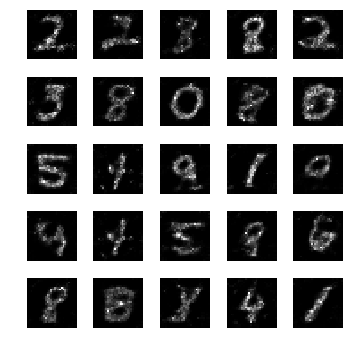

epoch: 991, time: 5.022639 | train_G_Loss: 0.526256, train_D_loss: 2.283826, train_acc: 0.943359
cv_G_Loss: 0.962123, cv_D_loss: 2.896726, cv_acc: 0.916800

epoch: 992, time: 5.014809 | train_G_Loss: 0.350780, train_D_loss: 2.260823, train_acc: 0.929688
cv_G_Loss: 0.373002, cv_D_loss: 2.263133, cv_acc: 0.934000
Model saved

epoch: 993, time: 5.020497 | train_G_Loss: 0.335709, train_D_loss: 2.291005, train_acc: 0.939453
cv_G_Loss: 0.918110, cv_D_loss: 2.859637, cv_acc: 0.911300

epoch: 994, time: 5.018379 | train_G_Loss: 0.277142, train_D_loss: 2.360721, train_acc: 0.916016
cv_G_Loss: 0.097178, cv_D_loss: 2.992088, cv_acc: 0.920800

epoch: 995, time: 5.007280 | train_G_Loss: 0.346548, train_D_loss: 2.232509, train_acc: 0.914062
cv_G_Loss: 0.343976, cv_D_loss: 2.281084, cv_acc: 0.928800

epoch: 996, time: 5.013498 | train_G_Loss: 0.388042, train_D_loss: 2.378012, train_acc: 0.900391
cv_G_Loss: 0.614130, cv_D_loss: 2.436749, cv_acc: 0.923200

epoch: 997, time: 5.006839 | train_G_Loss: 0.3

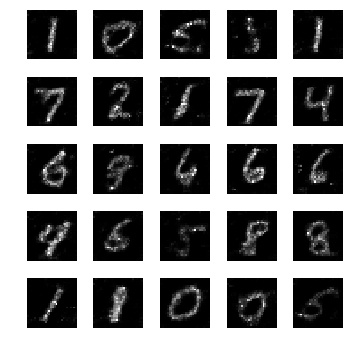

epoch: 1001, time: 5.037917 | train_G_Loss: 0.417472, train_D_loss: 2.181429, train_acc: 0.931641
cv_G_Loss: 1.619921, cv_D_loss: 3.918702, cv_acc: 0.918400

epoch: 1002, time: 5.014635 | train_G_Loss: 0.421356, train_D_loss: 2.469478, train_acc: 0.880859
cv_G_Loss: 0.852011, cv_D_loss: 2.674071, cv_acc: 0.933300

epoch: 1003, time: 5.025304 | train_G_Loss: 0.342016, train_D_loss: 2.520673, train_acc: 0.914062
cv_G_Loss: 0.334884, cv_D_loss: 2.323646, cv_acc: 0.929100

epoch: 1004, time: 5.031308 | train_G_Loss: 0.390842, train_D_loss: 2.212029, train_acc: 0.910156
cv_G_Loss: 0.151462, cv_D_loss: 2.757938, cv_acc: 0.903200

epoch: 1005, time: 5.013609 | train_G_Loss: 0.416500, train_D_loss: 2.248181, train_acc: 0.929688
cv_G_Loss: 0.426040, cv_D_loss: 2.282506, cv_acc: 0.931400

epoch: 1006, time: 5.013693 | train_G_Loss: 0.394663, train_D_loss: 2.234534, train_acc: 0.939453
cv_G_Loss: 1.290652, cv_D_loss: 3.426973, cv_acc: 0.903800

epoch: 1007, time: 5.008548 | train_G_Loss: 0.442232

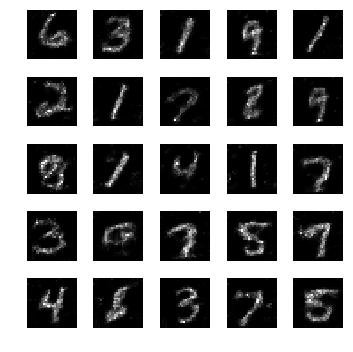

epoch: 1011, time: 5.039904 | train_G_Loss: 0.398263, train_D_loss: 2.381671, train_acc: 0.931641
cv_G_Loss: 1.709079, cv_D_loss: 4.051857, cv_acc: 0.899100

epoch: 1012, time: 5.009732 | train_G_Loss: 0.401978, train_D_loss: 2.306477, train_acc: 0.923828
cv_G_Loss: 0.441472, cv_D_loss: 2.306103, cv_acc: 0.924200

epoch: 1013, time: 5.013345 | train_G_Loss: 0.547548, train_D_loss: 2.492785, train_acc: 0.896484
cv_G_Loss: 0.888000, cv_D_loss: 2.771149, cv_acc: 0.917600

epoch: 1014, time: 5.006931 | train_G_Loss: 0.410322, train_D_loss: 2.398618, train_acc: 0.914062
cv_G_Loss: 0.156778, cv_D_loss: 2.642942, cv_acc: 0.918800

epoch: 1015, time: 5.017000 | train_G_Loss: 0.422570, train_D_loss: 2.196633, train_acc: 0.941406
cv_G_Loss: 1.423581, cv_D_loss: 3.562215, cv_acc: 0.908700

epoch: 1016, time: 4.998127 | train_G_Loss: 0.373358, train_D_loss: 2.355829, train_acc: 0.900391
cv_G_Loss: 0.113822, cv_D_loss: 2.861269, cv_acc: 0.919400

epoch: 1017, time: 5.007228 | train_G_Loss: 0.385269

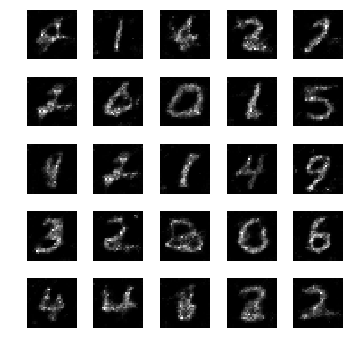

epoch: 1021, time: 5.029552 | train_G_Loss: 0.313916, train_D_loss: 2.439764, train_acc: 0.880859
cv_G_Loss: 0.257914, cv_D_loss: 2.413446, cv_acc: 0.926900

epoch: 1022, time: 5.001764 | train_G_Loss: 0.331241, train_D_loss: 2.442279, train_acc: 0.910156
cv_G_Loss: 0.402611, cv_D_loss: 2.465348, cv_acc: 0.909900

epoch: 1023, time: 5.005344 | train_G_Loss: 0.441078, train_D_loss: 2.249563, train_acc: 0.953125
cv_G_Loss: 0.235422, cv_D_loss: 2.493005, cv_acc: 0.912100

epoch: 1024, time: 5.012070 | train_G_Loss: 0.429463, train_D_loss: 2.221277, train_acc: 0.947266
cv_G_Loss: 0.998346, cv_D_loss: 2.842685, cv_acc: 0.925600

epoch: 1025, time: 5.000411 | train_G_Loss: 0.353682, train_D_loss: 2.261858, train_acc: 0.939453
cv_G_Loss: 0.218549, cv_D_loss: 2.514964, cv_acc: 0.921400

epoch: 1026, time: 5.053244 | train_G_Loss: 0.309212, train_D_loss: 2.264957, train_acc: 0.955078
cv_G_Loss: 0.128955, cv_D_loss: 2.799389, cv_acc: 0.920000

epoch: 1027, time: 4.995624 | train_G_Loss: 0.371469

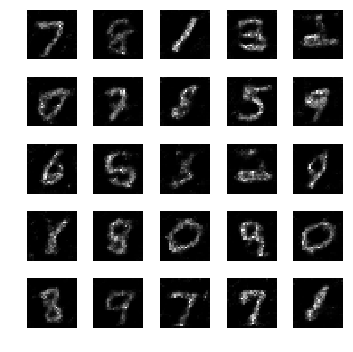

epoch: 1031, time: 5.045266 | train_G_Loss: 0.398879, train_D_loss: 2.175954, train_acc: 0.943359
cv_G_Loss: 0.258965, cv_D_loss: 2.440927, cv_acc: 0.920200

epoch: 1032, time: 5.011202 | train_G_Loss: 0.346315, train_D_loss: 2.201662, train_acc: 0.941406
cv_G_Loss: 0.543693, cv_D_loss: 2.368636, cv_acc: 0.932100

epoch: 1033, time: 5.008603 | train_G_Loss: 0.376135, train_D_loss: 2.274355, train_acc: 0.943359
cv_G_Loss: 0.178176, cv_D_loss: 2.592012, cv_acc: 0.923500

epoch: 1034, time: 4.996102 | train_G_Loss: 0.393031, train_D_loss: 2.289459, train_acc: 0.929688
cv_G_Loss: 0.353451, cv_D_loss: 2.283947, cv_acc: 0.935200
Model saved

epoch: 1035, time: 5.062964 | train_G_Loss: 0.275492, train_D_loss: 2.334002, train_acc: 0.933594
cv_G_Loss: 0.111063, cv_D_loss: 2.852717, cv_acc: 0.930600

epoch: 1036, time: 5.052628 | train_G_Loss: 0.443789, train_D_loss: 2.330676, train_acc: 0.927734
cv_G_Loss: 0.311657, cv_D_loss: 2.435509, cv_acc: 0.914400

epoch: 1037, time: 5.056281 | train_G_Lo

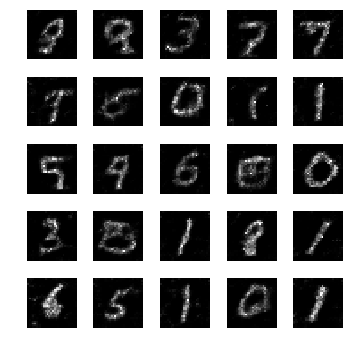

epoch: 1041, time: 5.067058 | train_G_Loss: 0.362810, train_D_loss: 2.258799, train_acc: 0.937500
cv_G_Loss: 0.144377, cv_D_loss: 2.685263, cv_acc: 0.932800

epoch: 1042, time: 5.051973 | train_G_Loss: 0.318176, train_D_loss: 2.350110, train_acc: 0.917969
cv_G_Loss: 0.213162, cv_D_loss: 2.507964, cv_acc: 0.927100

epoch: 1043, time: 5.050777 | train_G_Loss: 0.345598, train_D_loss: 2.437630, train_acc: 0.929688
cv_G_Loss: 0.138602, cv_D_loss: 2.756993, cv_acc: 0.916900

epoch: 1044, time: 5.049363 | train_G_Loss: 0.481272, train_D_loss: 2.155791, train_acc: 0.939453
cv_G_Loss: 0.244864, cv_D_loss: 2.494195, cv_acc: 0.907300

epoch: 1045, time: 5.044615 | train_G_Loss: 0.400320, train_D_loss: 2.241214, train_acc: 0.921875
cv_G_Loss: 0.921316, cv_D_loss: 2.757020, cv_acc: 0.928800

epoch: 1046, time: 5.046967 | train_G_Loss: 0.382054, train_D_loss: 2.419552, train_acc: 0.925781
cv_G_Loss: 2.700379, cv_D_loss: 5.915083, cv_acc: 0.893800

epoch: 1047, time: 5.045360 | train_G_Loss: 0.399972

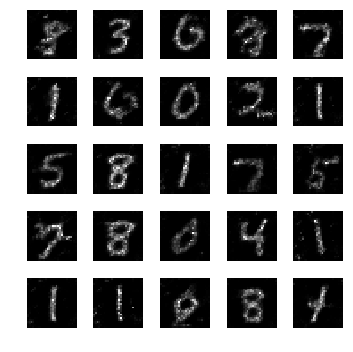

epoch: 1051, time: 5.075126 | train_G_Loss: 0.380537, train_D_loss: 2.281738, train_acc: 0.917969
cv_G_Loss: 0.644924, cv_D_loss: 2.463090, cv_acc: 0.928600

epoch: 1052, time: 5.047295 | train_G_Loss: 0.226013, train_D_loss: 2.451025, train_acc: 0.912109
cv_G_Loss: 0.076893, cv_D_loss: 3.112182, cv_acc: 0.931000

epoch: 1053, time: 5.053921 | train_G_Loss: 0.318161, train_D_loss: 2.393411, train_acc: 0.941406
cv_G_Loss: 0.323790, cv_D_loss: 2.309828, cv_acc: 0.933500

epoch: 1054, time: 5.041985 | train_G_Loss: 0.405350, train_D_loss: 2.299376, train_acc: 0.925781
cv_G_Loss: 0.711068, cv_D_loss: 2.498697, cv_acc: 0.933900

epoch: 1055, time: 5.048037 | train_G_Loss: 0.462961, train_D_loss: 2.322022, train_acc: 0.910156
cv_G_Loss: 0.118589, cv_D_loss: 2.844875, cv_acc: 0.919500

epoch: 1056, time: 5.058234 | train_G_Loss: 0.277427, train_D_loss: 2.429174, train_acc: 0.921875
cv_G_Loss: 0.190361, cv_D_loss: 2.527246, cv_acc: 0.928700

epoch: 1057, time: 5.046593 | train_G_Loss: 0.367820

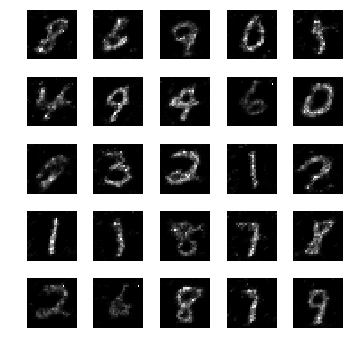

epoch: 1061, time: 5.097885 | train_G_Loss: 0.348287, train_D_loss: 2.290870, train_acc: 0.927734
cv_G_Loss: 0.670649, cv_D_loss: 2.431541, cv_acc: 0.935300

epoch: 1062, time: 5.057774 | train_G_Loss: 0.379556, train_D_loss: 2.311730, train_acc: 0.949219
cv_G_Loss: 0.511497, cv_D_loss: 2.307654, cv_acc: 0.936700
Model saved

epoch: 1063, time: 5.045467 | train_G_Loss: 0.326761, train_D_loss: 2.283976, train_acc: 0.943359
cv_G_Loss: 0.169224, cv_D_loss: 2.651926, cv_acc: 0.916600

epoch: 1064, time: 5.014973 | train_G_Loss: 0.346989, train_D_loss: 2.291870, train_acc: 0.923828
cv_G_Loss: 1.610356, cv_D_loss: 4.043845, cv_acc: 0.879600

epoch: 1065, time: 5.008332 | train_G_Loss: 0.391429, train_D_loss: 2.465609, train_acc: 0.929688
cv_G_Loss: 1.147833, cv_D_loss: 3.254963, cv_acc: 0.908300

epoch: 1066, time: 5.009087 | train_G_Loss: 0.486573, train_D_loss: 2.185439, train_acc: 0.919922
cv_G_Loss: 1.274016, cv_D_loss: 3.267950, cv_acc: 0.932200

epoch: 1067, time: 5.007116 | train_G_Lo

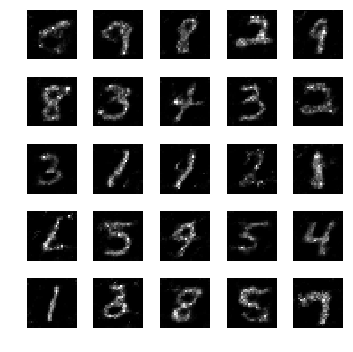

epoch: 1071, time: 5.042344 | train_G_Loss: 0.393540, train_D_loss: 2.346756, train_acc: 0.908203
cv_G_Loss: 0.506323, cv_D_loss: 2.396111, cv_acc: 0.922300

epoch: 1072, time: 5.006151 | train_G_Loss: 0.350593, train_D_loss: 2.258145, train_acc: 0.914062
cv_G_Loss: 0.166572, cv_D_loss: 2.607657, cv_acc: 0.924700

epoch: 1073, time: 5.017604 | train_G_Loss: 0.297942, train_D_loss: 2.460484, train_acc: 0.931641
cv_G_Loss: 0.260007, cv_D_loss: 2.431632, cv_acc: 0.921800

epoch: 1074, time: 5.011992 | train_G_Loss: 0.369768, train_D_loss: 2.350551, train_acc: 0.929688
cv_G_Loss: 0.572768, cv_D_loss: 2.352087, cv_acc: 0.936400

epoch: 1075, time: 5.011669 | train_G_Loss: 0.376358, train_D_loss: 2.244113, train_acc: 0.945312
cv_G_Loss: 0.471547, cv_D_loss: 2.368921, cv_acc: 0.933200

epoch: 1076, time: 5.011619 | train_G_Loss: 0.438986, train_D_loss: 2.373851, train_acc: 0.931641
cv_G_Loss: 0.799468, cv_D_loss: 2.794809, cv_acc: 0.909500

epoch: 1077, time: 5.014676 | train_G_Loss: 0.483360

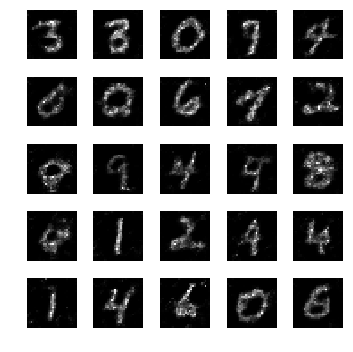

epoch: 1081, time: 5.059701 | train_G_Loss: 0.538850, train_D_loss: 2.338190, train_acc: 0.933594
cv_G_Loss: 0.843802, cv_D_loss: 2.699345, cv_acc: 0.927000

epoch: 1082, time: 5.029167 | train_G_Loss: 0.480598, train_D_loss: 2.315194, train_acc: 0.916016
cv_G_Loss: 1.628880, cv_D_loss: 3.902235, cv_acc: 0.929700

epoch: 1083, time: 5.014301 | train_G_Loss: 0.315568, train_D_loss: 2.547897, train_acc: 0.910156
cv_G_Loss: 0.475508, cv_D_loss: 2.406937, cv_acc: 0.925500

epoch: 1084, time: 5.017417 | train_G_Loss: 0.408640, train_D_loss: 2.295449, train_acc: 0.919922
cv_G_Loss: 0.455367, cv_D_loss: 2.412495, cv_acc: 0.916800

epoch: 1085, time: 5.024606 | train_G_Loss: 0.466197, train_D_loss: 2.222801, train_acc: 0.937500
cv_G_Loss: 1.162997, cv_D_loss: 3.099463, cv_acc: 0.932000

epoch: 1086, time: 5.024336 | train_G_Loss: 0.398796, train_D_loss: 2.372369, train_acc: 0.939453
cv_G_Loss: 0.796965, cv_D_loss: 2.729478, cv_acc: 0.901600

epoch: 1087, time: 5.020594 | train_G_Loss: 0.493551

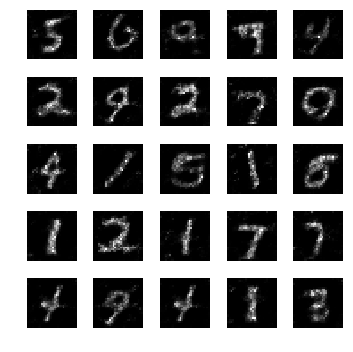

epoch: 1091, time: 5.048876 | train_G_Loss: 0.597306, train_D_loss: 2.483014, train_acc: 0.912109
cv_G_Loss: 0.619774, cv_D_loss: 2.569294, cv_acc: 0.904400

epoch: 1092, time: 5.055772 | train_G_Loss: 0.456336, train_D_loss: 2.336181, train_acc: 0.953125
cv_G_Loss: 0.716427, cv_D_loss: 2.529493, cv_acc: 0.925500

epoch: 1093, time: 5.018577 | train_G_Loss: 0.431379, train_D_loss: 2.173499, train_acc: 0.943359
cv_G_Loss: 0.488452, cv_D_loss: 2.328727, cv_acc: 0.931300

epoch: 1094, time: 5.019836 | train_G_Loss: 0.292729, train_D_loss: 2.372619, train_acc: 0.917969
cv_G_Loss: 0.173525, cv_D_loss: 2.565114, cv_acc: 0.933200

epoch: 1095, time: 5.021349 | train_G_Loss: 0.316331, train_D_loss: 2.366294, train_acc: 0.937500
cv_G_Loss: 0.362845, cv_D_loss: 2.392052, cv_acc: 0.916800

epoch: 1096, time: 5.011652 | train_G_Loss: 0.423420, train_D_loss: 2.159240, train_acc: 0.943359
cv_G_Loss: 0.754127, cv_D_loss: 2.542233, cv_acc: 0.934700

epoch: 1097, time: 5.024040 | train_G_Loss: 0.390357

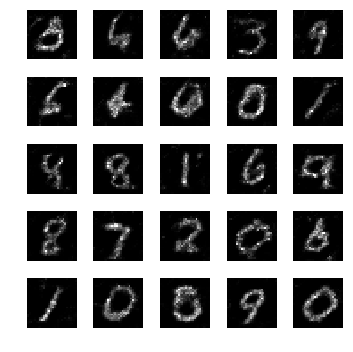

epoch: 1101, time: 5.059630 | train_G_Loss: 0.431830, train_D_loss: 2.232625, train_acc: 0.955078
cv_G_Loss: 1.038741, cv_D_loss: 2.949939, cv_acc: 0.925000

epoch: 1102, time: 5.011198 | train_G_Loss: 0.463414, train_D_loss: 2.206044, train_acc: 0.957031
cv_G_Loss: 1.306318, cv_D_loss: 3.489478, cv_acc: 0.914200

epoch: 1103, time: 5.024815 | train_G_Loss: 0.595862, train_D_loss: 2.361752, train_acc: 0.945312
cv_G_Loss: 3.525216, cv_D_loss: 8.301094, cv_acc: 0.731300

epoch: 1104, time: 5.015807 | train_G_Loss: 0.449951, train_D_loss: 2.281469, train_acc: 0.935547
cv_G_Loss: 1.631671, cv_D_loss: 4.033014, cv_acc: 0.926000

epoch: 1105, time: 5.018665 | train_G_Loss: 0.378991, train_D_loss: 2.142470, train_acc: 0.945312
cv_G_Loss: 0.865109, cv_D_loss: 2.891765, cv_acc: 0.906900

epoch: 1106, time: 5.019955 | train_G_Loss: 0.432380, train_D_loss: 2.246617, train_acc: 0.947266
cv_G_Loss: 2.162778, cv_D_loss: 4.829173, cv_acc: 0.931100

epoch: 1107, time: 5.012950 | train_G_Loss: 0.462685

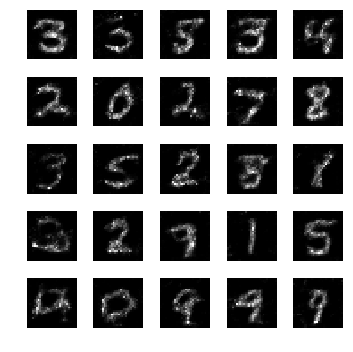

epoch: 1111, time: 5.055903 | train_G_Loss: 0.516572, train_D_loss: 2.222280, train_acc: 0.980469
cv_G_Loss: 2.402248, cv_D_loss: 5.260760, cv_acc: 0.927700

epoch: 1112, time: 5.020290 | train_G_Loss: 0.405866, train_D_loss: 2.073834, train_acc: 0.960938
cv_G_Loss: 0.283617, cv_D_loss: 2.503678, cv_acc: 0.898100

epoch: 1113, time: 5.020535 | train_G_Loss: 0.358505, train_D_loss: 2.290452, train_acc: 0.933594
cv_G_Loss: 0.261501, cv_D_loss: 2.376004, cv_acc: 0.931900

epoch: 1114, time: 5.059388 | train_G_Loss: 0.491299, train_D_loss: 2.141404, train_acc: 0.951172
cv_G_Loss: 0.638162, cv_D_loss: 2.398239, cv_acc: 0.934100

epoch: 1115, time: 5.020933 | train_G_Loss: 0.475751, train_D_loss: 2.186331, train_acc: 0.941406
cv_G_Loss: 0.868090, cv_D_loss: 2.716828, cv_acc: 0.934400

epoch: 1116, time: 5.017539 | train_G_Loss: 0.320571, train_D_loss: 2.417106, train_acc: 0.933594
cv_G_Loss: 0.309918, cv_D_loss: 2.362286, cv_acc: 0.931600

epoch: 1117, time: 5.027459 | train_G_Loss: 0.515050

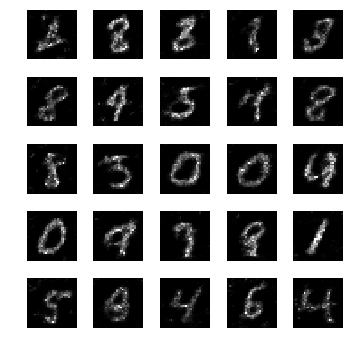

epoch: 1121, time: 5.046112 | train_G_Loss: 0.372449, train_D_loss: 2.211082, train_acc: 0.914062
cv_G_Loss: 0.683275, cv_D_loss: 2.471655, cv_acc: 0.935400

epoch: 1122, time: 5.013322 | train_G_Loss: 0.340805, train_D_loss: 2.389208, train_acc: 0.904297
cv_G_Loss: 0.520441, cv_D_loss: 2.392429, cv_acc: 0.930700

epoch: 1123, time: 5.099248 | train_G_Loss: 0.333259, train_D_loss: 2.483561, train_acc: 0.939453
cv_G_Loss: 0.194420, cv_D_loss: 2.497253, cv_acc: 0.930800

epoch: 1124, time: 5.011129 | train_G_Loss: 0.337465, train_D_loss: 2.218936, train_acc: 0.933594
cv_G_Loss: 0.373370, cv_D_loss: 2.305828, cv_acc: 0.931500

epoch: 1125, time: 5.029246 | train_G_Loss: 0.400512, train_D_loss: 2.354029, train_acc: 0.931641
cv_G_Loss: 0.087396, cv_D_loss: 3.080641, cv_acc: 0.918500

epoch: 1126, time: 5.013689 | train_G_Loss: 0.418206, train_D_loss: 2.273604, train_acc: 0.914062
cv_G_Loss: 0.327525, cv_D_loss: 2.454797, cv_acc: 0.900600

epoch: 1127, time: 5.004224 | train_G_Loss: 0.330310

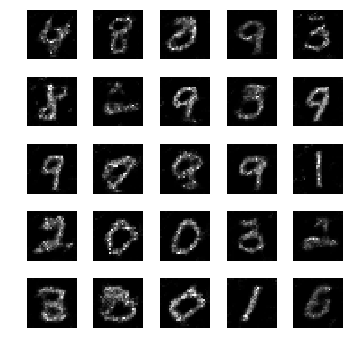

epoch: 1131, time: 5.037704 | train_G_Loss: 0.302803, train_D_loss: 2.331489, train_acc: 0.945312
cv_G_Loss: 1.366065, cv_D_loss: 3.505445, cv_acc: 0.925200

epoch: 1132, time: 5.002949 | train_G_Loss: 0.507513, train_D_loss: 2.196684, train_acc: 0.921875
cv_G_Loss: 1.182830, cv_D_loss: 3.065387, cv_acc: 0.936900
Model saved

epoch: 1133, time: 5.047716 | train_G_Loss: 0.304075, train_D_loss: 2.403155, train_acc: 0.937500
cv_G_Loss: 0.208185, cv_D_loss: 2.492922, cv_acc: 0.914100

epoch: 1134, time: 5.014910 | train_G_Loss: 0.368327, train_D_loss: 2.109337, train_acc: 0.964844
cv_G_Loss: 1.602876, cv_D_loss: 3.935963, cv_acc: 0.934300

epoch: 1135, time: 5.022163 | train_G_Loss: 0.713377, train_D_loss: 2.338246, train_acc: 0.955078
cv_G_Loss: 2.780162, cv_D_loss: 5.967701, cv_acc: 0.926900

epoch: 1136, time: 5.054601 | train_G_Loss: 0.343248, train_D_loss: 2.188374, train_acc: 0.957031
cv_G_Loss: 0.588373, cv_D_loss: 2.555366, cv_acc: 0.914600

epoch: 1137, time: 5.033024 | train_G_Lo

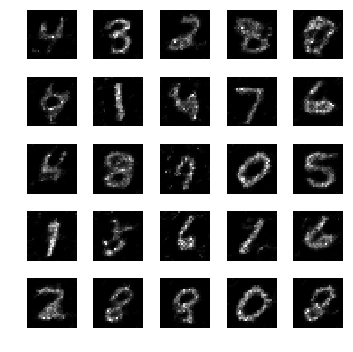

epoch: 1141, time: 5.056207 | train_G_Loss: 0.428975, train_D_loss: 2.359414, train_acc: 0.908203
cv_G_Loss: 0.201647, cv_D_loss: 2.474618, cv_acc: 0.930200

epoch: 1142, time: 5.024580 | train_G_Loss: 0.401095, train_D_loss: 2.288954, train_acc: 0.910156
cv_G_Loss: 0.610311, cv_D_loss: 2.470022, cv_acc: 0.920000

epoch: 1143, time: 5.005310 | train_G_Loss: 0.344957, train_D_loss: 2.310764, train_acc: 0.943359
cv_G_Loss: 1.360510, cv_D_loss: 3.421475, cv_acc: 0.931000

epoch: 1144, time: 5.010833 | train_G_Loss: 0.435493, train_D_loss: 2.171418, train_acc: 0.927734
cv_G_Loss: 1.583570, cv_D_loss: 3.751744, cv_acc: 0.932900

epoch: 1145, time: 5.052129 | train_G_Loss: 0.416174, train_D_loss: 2.329840, train_acc: 0.906250
cv_G_Loss: 0.766837, cv_D_loss: 2.592056, cv_acc: 0.916800

epoch: 1146, time: 5.027639 | train_G_Loss: 0.433777, train_D_loss: 2.342052, train_acc: 0.923828
cv_G_Loss: 1.153574, cv_D_loss: 3.302445, cv_acc: 0.928100

epoch: 1147, time: 5.026475 | train_G_Loss: 0.440875

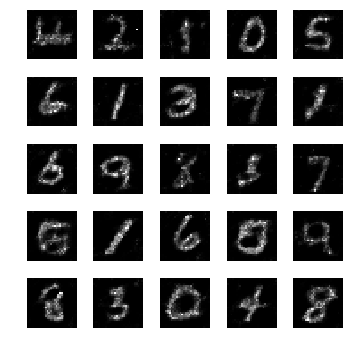

epoch: 1151, time: 5.064403 | train_G_Loss: 0.449559, train_D_loss: 2.269292, train_acc: 0.931641
cv_G_Loss: 0.547871, cv_D_loss: 2.485662, cv_acc: 0.882400

epoch: 1152, time: 5.019348 | train_G_Loss: 0.393347, train_D_loss: 2.354505, train_acc: 0.917969
cv_G_Loss: 0.587187, cv_D_loss: 2.357560, cv_acc: 0.929600

epoch: 1153, time: 5.029186 | train_G_Loss: 0.357318, train_D_loss: 2.233563, train_acc: 0.951172
cv_G_Loss: 0.050167, cv_D_loss: 3.531063, cv_acc: 0.925700

epoch: 1154, time: 5.011168 | train_G_Loss: 0.453949, train_D_loss: 2.244555, train_acc: 0.943359
cv_G_Loss: 3.315685, cv_D_loss: 7.217848, cv_acc: 0.901800

epoch: 1155, time: 5.022558 | train_G_Loss: 0.310338, train_D_loss: 2.347743, train_acc: 0.912109
cv_G_Loss: 1.487185, cv_D_loss: 3.661218, cv_acc: 0.919100

epoch: 1156, time: 5.032389 | train_G_Loss: 0.366004, train_D_loss: 2.342859, train_acc: 0.933594
cv_G_Loss: 0.288647, cv_D_loss: 2.352831, cv_acc: 0.928100

epoch: 1157, time: 5.037347 | train_G_Loss: 0.376188

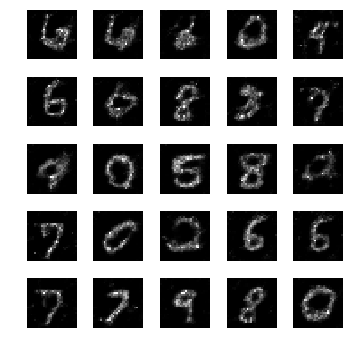

epoch: 1161, time: 5.043100 | train_G_Loss: 0.343656, train_D_loss: 2.268824, train_acc: 0.953125
cv_G_Loss: 0.748688, cv_D_loss: 2.516271, cv_acc: 0.934100

epoch: 1162, time: 5.014400 | train_G_Loss: 0.445156, train_D_loss: 2.179481, train_acc: 0.949219
cv_G_Loss: 2.267755, cv_D_loss: 5.142200, cv_acc: 0.902800

epoch: 1163, time: 5.016732 | train_G_Loss: 0.367338, train_D_loss: 2.290301, train_acc: 0.937500
cv_G_Loss: 0.382234, cv_D_loss: 2.287094, cv_acc: 0.941000
Model saved

epoch: 1164, time: 5.099141 | train_G_Loss: 0.357077, train_D_loss: 2.291785, train_acc: 0.927734
cv_G_Loss: 0.643189, cv_D_loss: 2.504063, cv_acc: 0.918900

epoch: 1165, time: 5.072519 | train_G_Loss: 0.503337, train_D_loss: 2.159392, train_acc: 0.947266
cv_G_Loss: 1.470997, cv_D_loss: 3.696319, cv_acc: 0.885300

epoch: 1166, time: 5.063212 | train_G_Loss: 0.433931, train_D_loss: 2.284725, train_acc: 0.927734
cv_G_Loss: 0.103359, cv_D_loss: 2.931313, cv_acc: 0.923900

epoch: 1167, time: 5.063542 | train_G_Lo

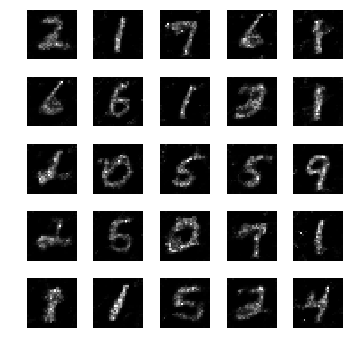

epoch: 1171, time: 5.108795 | train_G_Loss: 0.358140, train_D_loss: 2.274693, train_acc: 0.958984
cv_G_Loss: 0.114625, cv_D_loss: 2.849044, cv_acc: 0.923700

epoch: 1172, time: 5.075876 | train_G_Loss: 0.444455, train_D_loss: 2.172400, train_acc: 0.951172
cv_G_Loss: 2.305639, cv_D_loss: 5.244216, cv_acc: 0.922300

epoch: 1173, time: 5.073702 | train_G_Loss: 0.412746, train_D_loss: 2.154004, train_acc: 0.931641
cv_G_Loss: 0.759492, cv_D_loss: 2.622992, cv_acc: 0.928200

epoch: 1174, time: 5.080062 | train_G_Loss: 0.350071, train_D_loss: 2.184622, train_acc: 0.921875
cv_G_Loss: 0.644324, cv_D_loss: 2.378974, cv_acc: 0.939700

epoch: 1175, time: 5.068843 | train_G_Loss: 0.391563, train_D_loss: 2.398997, train_acc: 0.927734
cv_G_Loss: 0.535462, cv_D_loss: 2.339550, cv_acc: 0.938100

epoch: 1176, time: 5.072821 | train_G_Loss: 0.428141, train_D_loss: 2.178924, train_acc: 0.949219
cv_G_Loss: 0.642105, cv_D_loss: 2.390206, cv_acc: 0.939300

epoch: 1177, time: 5.074189 | train_G_Loss: 0.366704

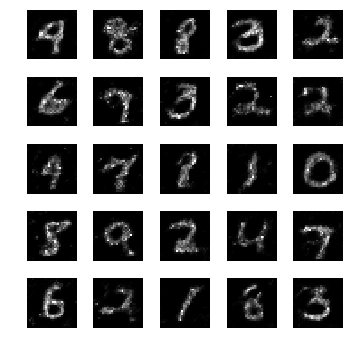

epoch: 1181, time: 5.105331 | train_G_Loss: 0.335028, train_D_loss: 2.267146, train_acc: 0.917969
cv_G_Loss: 0.382268, cv_D_loss: 2.414649, cv_acc: 0.904300

epoch: 1182, time: 5.074309 | train_G_Loss: 0.331395, train_D_loss: 2.311902, train_acc: 0.931641
cv_G_Loss: 0.110932, cv_D_loss: 2.919929, cv_acc: 0.924700

epoch: 1183, time: 5.083996 | train_G_Loss: 0.349033, train_D_loss: 2.215482, train_acc: 0.933594
cv_G_Loss: 0.197724, cv_D_loss: 2.517019, cv_acc: 0.918100

epoch: 1184, time: 5.077711 | train_G_Loss: 0.417111, train_D_loss: 2.253722, train_acc: 0.962891
cv_G_Loss: 1.239709, cv_D_loss: 3.311894, cv_acc: 0.912900

epoch: 1185, time: 5.089854 | train_G_Loss: 0.304288, train_D_loss: 2.296480, train_acc: 0.937500
cv_G_Loss: 0.304602, cv_D_loss: 2.369614, cv_acc: 0.925900

epoch: 1186, time: 5.067638 | train_G_Loss: 0.253713, train_D_loss: 2.340606, train_acc: 0.951172
cv_G_Loss: 0.131351, cv_D_loss: 2.711061, cv_acc: 0.932300

epoch: 1187, time: 5.072504 | train_G_Loss: 0.396647

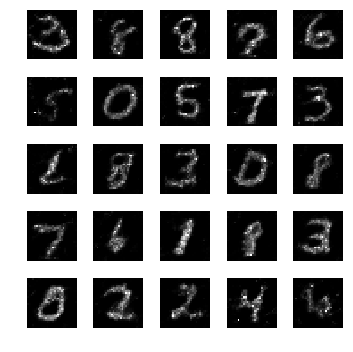

epoch: 1191, time: 5.089200 | train_G_Loss: 0.418407, train_D_loss: 2.207205, train_acc: 0.941406
cv_G_Loss: 0.587884, cv_D_loss: 2.571344, cv_acc: 0.882200

epoch: 1192, time: 5.073598 | train_G_Loss: 0.402814, train_D_loss: 2.346717, train_acc: 0.941406
cv_G_Loss: 0.241763, cv_D_loss: 2.550984, cv_acc: 0.918800

epoch: 1193, time: 5.077575 | train_G_Loss: 0.387878, train_D_loss: 2.159266, train_acc: 0.947266
cv_G_Loss: 2.433820, cv_D_loss: 5.253454, cv_acc: 0.915000

epoch: 1194, time: 5.064198 | train_G_Loss: 0.335707, train_D_loss: 2.238498, train_acc: 0.933594
cv_G_Loss: 0.370229, cv_D_loss: 2.292407, cv_acc: 0.939400

epoch: 1195, time: 5.075274 | train_G_Loss: 0.432581, train_D_loss: 2.224803, train_acc: 0.947266
cv_G_Loss: 0.142528, cv_D_loss: 2.658282, cv_acc: 0.928000

epoch: 1196, time: 5.080236 | train_G_Loss: 0.350361, train_D_loss: 2.205866, train_acc: 0.941406
cv_G_Loss: 0.937274, cv_D_loss: 2.886673, cv_acc: 0.903900

epoch: 1197, time: 5.053843 | train_G_Loss: 0.308078

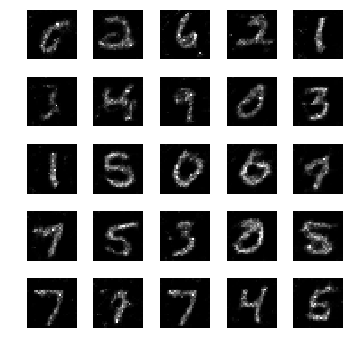

epoch: 1201, time: 5.100917 | train_G_Loss: 0.414824, train_D_loss: 2.221206, train_acc: 0.937500
cv_G_Loss: 0.605691, cv_D_loss: 2.426075, cv_acc: 0.926400

epoch: 1202, time: 5.106237 | train_G_Loss: 0.365273, train_D_loss: 2.424321, train_acc: 0.906250
cv_G_Loss: 0.510436, cv_D_loss: 2.356782, cv_acc: 0.926600

epoch: 1203, time: 5.079269 | train_G_Loss: 0.369599, train_D_loss: 2.432555, train_acc: 0.912109
cv_G_Loss: 0.176545, cv_D_loss: 2.640249, cv_acc: 0.909900

epoch: 1204, time: 5.062399 | train_G_Loss: 0.380959, train_D_loss: 2.375048, train_acc: 0.916016
cv_G_Loss: 1.240670, cv_D_loss: 3.214120, cv_acc: 0.937900

epoch: 1205, time: 5.074751 | train_G_Loss: 0.420757, train_D_loss: 2.211624, train_acc: 0.923828
cv_G_Loss: 0.960543, cv_D_loss: 2.974371, cv_acc: 0.893900

epoch: 1206, time: 5.068971 | train_G_Loss: 0.392604, train_D_loss: 2.368680, train_acc: 0.917969
cv_G_Loss: 0.152179, cv_D_loss: 2.671373, cv_acc: 0.931400

epoch: 1207, time: 5.067668 | train_G_Loss: 0.341037

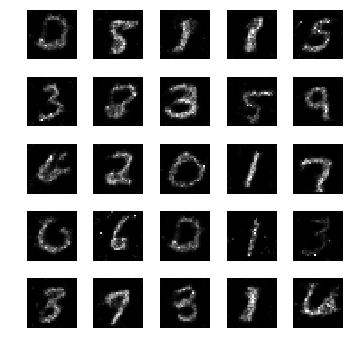

epoch: 1211, time: 5.100471 | train_G_Loss: 0.449852, train_D_loss: 2.254090, train_acc: 0.941406
cv_G_Loss: 0.996977, cv_D_loss: 2.880286, cv_acc: 0.938100

epoch: 1212, time: 5.061742 | train_G_Loss: 0.316863, train_D_loss: 2.239416, train_acc: 0.966797
cv_G_Loss: 0.195852, cv_D_loss: 2.479713, cv_acc: 0.937700

epoch: 1213, time: 5.069777 | train_G_Loss: 0.415764, train_D_loss: 2.113721, train_acc: 0.964844
cv_G_Loss: 0.177195, cv_D_loss: 2.579126, cv_acc: 0.927600

epoch: 1214, time: 5.072880 | train_G_Loss: 0.409391, train_D_loss: 2.181441, train_acc: 0.943359
cv_G_Loss: 0.162039, cv_D_loss: 2.670682, cv_acc: 0.918000

epoch: 1215, time: 5.055822 | train_G_Loss: 0.360909, train_D_loss: 2.321490, train_acc: 0.921875
cv_G_Loss: 0.405934, cv_D_loss: 2.306556, cv_acc: 0.932300

epoch: 1216, time: 5.067507 | train_G_Loss: 0.391164, train_D_loss: 2.206602, train_acc: 0.933594
cv_G_Loss: 0.763202, cv_D_loss: 2.539937, cv_acc: 0.938700

epoch: 1217, time: 5.063701 | train_G_Loss: 0.329609

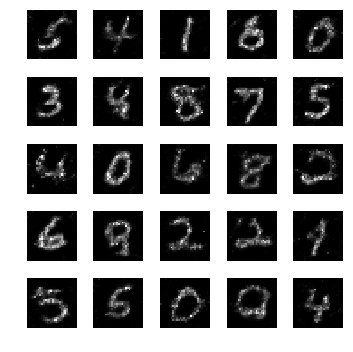

epoch: 1221, time: 5.103377 | train_G_Loss: 0.337713, train_D_loss: 2.240738, train_acc: 0.947266
cv_G_Loss: 0.442291, cv_D_loss: 2.422983, cv_acc: 0.902100

epoch: 1222, time: 5.072181 | train_G_Loss: 0.402865, train_D_loss: 2.199389, train_acc: 0.941406
cv_G_Loss: 0.109370, cv_D_loss: 2.903647, cv_acc: 0.916800

epoch: 1223, time: 5.056328 | train_G_Loss: 0.367887, train_D_loss: 2.347796, train_acc: 0.925781
cv_G_Loss: 0.239875, cv_D_loss: 2.377176, cv_acc: 0.936200

epoch: 1224, time: 5.072049 | train_G_Loss: 0.386246, train_D_loss: 2.340200, train_acc: 0.902344
cv_G_Loss: 0.333798, cv_D_loss: 2.298432, cv_acc: 0.931700

epoch: 1225, time: 5.098063 | train_G_Loss: 0.339072, train_D_loss: 2.449286, train_acc: 0.921875
cv_G_Loss: 0.161271, cv_D_loss: 2.574268, cv_acc: 0.938100

epoch: 1226, time: 5.084025 | train_G_Loss: 0.337922, train_D_loss: 2.261562, train_acc: 0.943359
cv_G_Loss: 1.077899, cv_D_loss: 2.912585, cv_acc: 0.933200

epoch: 1227, time: 5.065058 | train_G_Loss: 0.406690

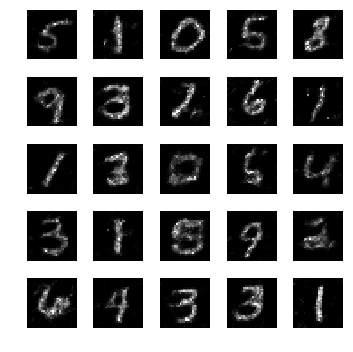

epoch: 1231, time: 5.102152 | train_G_Loss: 0.461010, train_D_loss: 2.190351, train_acc: 0.925781
cv_G_Loss: 0.791844, cv_D_loss: 2.611917, cv_acc: 0.937300

epoch: 1232, time: 5.077826 | train_G_Loss: 0.324152, train_D_loss: 2.304673, train_acc: 0.939453
cv_G_Loss: 0.135041, cv_D_loss: 2.697490, cv_acc: 0.935400

epoch: 1233, time: 5.059013 | train_G_Loss: 0.370951, train_D_loss: 2.334689, train_acc: 0.933594
cv_G_Loss: 0.337158, cv_D_loss: 2.450621, cv_acc: 0.908400

epoch: 1234, time: 5.075253 | train_G_Loss: 0.347475, train_D_loss: 2.265855, train_acc: 0.929688
cv_G_Loss: 0.430229, cv_D_loss: 2.584850, cv_acc: 0.873400

epoch: 1235, time: 5.069057 | train_G_Loss: 0.460742, train_D_loss: 2.224756, train_acc: 0.943359
cv_G_Loss: 0.699202, cv_D_loss: 2.637902, cv_acc: 0.917500

epoch: 1236, time: 5.072073 | train_G_Loss: 0.429626, train_D_loss: 2.270714, train_acc: 0.933594
cv_G_Loss: 0.532837, cv_D_loss: 2.397736, cv_acc: 0.928600

epoch: 1237, time: 5.073081 | train_G_Loss: 0.363249

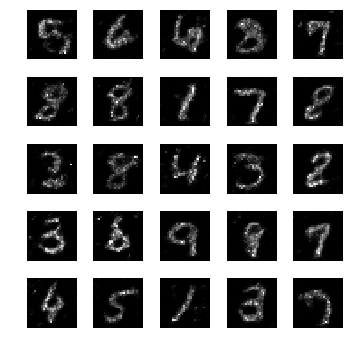

epoch: 1241, time: 5.086597 | train_G_Loss: 0.422132, train_D_loss: 2.287082, train_acc: 0.919922
cv_G_Loss: 0.539553, cv_D_loss: 2.315223, cv_acc: 0.939000

epoch: 1242, time: 5.076146 | train_G_Loss: 0.409950, train_D_loss: 2.465798, train_acc: 0.923828
cv_G_Loss: 0.782194, cv_D_loss: 2.597044, cv_acc: 0.937600

epoch: 1243, time: 5.066238 | train_G_Loss: 0.433561, train_D_loss: 2.207393, train_acc: 0.917969
cv_G_Loss: 0.572841, cv_D_loss: 2.549064, cv_acc: 0.884800

epoch: 1244, time: 5.083161 | train_G_Loss: 0.350018, train_D_loss: 2.415968, train_acc: 0.943359
cv_G_Loss: 0.086501, cv_D_loss: 3.197744, cv_acc: 0.896000

epoch: 1245, time: 5.066486 | train_G_Loss: 0.433013, train_D_loss: 2.180151, train_acc: 0.945312
cv_G_Loss: 0.757289, cv_D_loss: 2.548309, cv_acc: 0.937600

epoch: 1246, time: 5.073036 | train_G_Loss: 0.456356, train_D_loss: 2.239215, train_acc: 0.957031
cv_G_Loss: 1.909509, cv_D_loss: 4.386853, cv_acc: 0.918400

epoch: 1247, time: 5.138487 | train_G_Loss: 0.421689

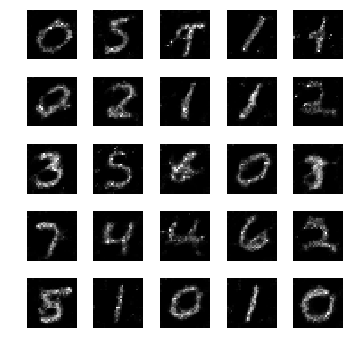

epoch: 1251, time: 5.095635 | train_G_Loss: 0.406858, train_D_loss: 2.372823, train_acc: 0.935547
cv_G_Loss: 0.107675, cv_D_loss: 2.883222, cv_acc: 0.930800

epoch: 1252, time: 5.071103 | train_G_Loss: 0.437149, train_D_loss: 2.364767, train_acc: 0.919922
cv_G_Loss: 0.640251, cv_D_loss: 2.505067, cv_acc: 0.926100

epoch: 1253, time: 5.057582 | train_G_Loss: 0.329370, train_D_loss: 2.253634, train_acc: 0.933594
cv_G_Loss: 0.527205, cv_D_loss: 2.402906, cv_acc: 0.924700

epoch: 1254, time: 5.122632 | train_G_Loss: 0.395784, train_D_loss: 2.411252, train_acc: 0.923828
cv_G_Loss: 0.596941, cv_D_loss: 2.378978, cv_acc: 0.938300

epoch: 1255, time: 5.073942 | train_G_Loss: 0.369323, train_D_loss: 2.418526, train_acc: 0.929688
cv_G_Loss: 0.415313, cv_D_loss: 2.495785, cv_acc: 0.904100

epoch: 1256, time: 5.064487 | train_G_Loss: 0.396475, train_D_loss: 2.208189, train_acc: 0.937500
cv_G_Loss: 0.722732, cv_D_loss: 2.499248, cv_acc: 0.935000

epoch: 1257, time: 5.074818 | train_G_Loss: 0.469873

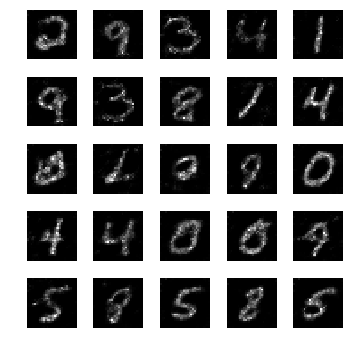

epoch: 1261, time: 5.105869 | train_G_Loss: 0.449437, train_D_loss: 2.206876, train_acc: 0.941406
cv_G_Loss: 0.836790, cv_D_loss: 2.623285, cv_acc: 0.941400
Model saved

epoch: 1262, time: 5.039108 | train_G_Loss: 0.391132, train_D_loss: 2.342146, train_acc: 0.939453
cv_G_Loss: 0.479230, cv_D_loss: 2.357363, cv_acc: 0.936500

epoch: 1263, time: 5.021209 | train_G_Loss: 0.325824, train_D_loss: 2.221825, train_acc: 0.925781
cv_G_Loss: 0.207610, cv_D_loss: 2.427468, cv_acc: 0.936900

epoch: 1264, time: 5.025262 | train_G_Loss: 0.364533, train_D_loss: 2.477950, train_acc: 0.929688
cv_G_Loss: 0.375122, cv_D_loss: 2.281510, cv_acc: 0.938500

epoch: 1265, time: 5.025947 | train_G_Loss: 0.362198, train_D_loss: 2.274792, train_acc: 0.912109
cv_G_Loss: 0.571470, cv_D_loss: 2.341666, cv_acc: 0.939100

epoch: 1266, time: 5.013583 | train_G_Loss: 0.446706, train_D_loss: 2.608852, train_acc: 0.925781
cv_G_Loss: 0.891470, cv_D_loss: 2.675104, cv_acc: 0.941500
Model saved

epoch: 1267, time: 5.054611 

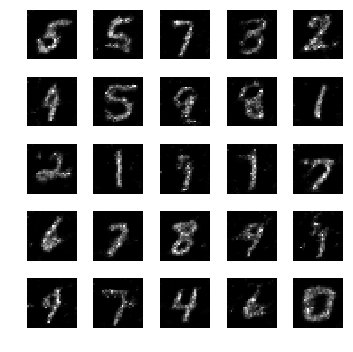

epoch: 1271, time: 5.054758 | train_G_Loss: 0.404866, train_D_loss: 2.182235, train_acc: 0.933594
cv_G_Loss: 0.511105, cv_D_loss: 2.328131, cv_acc: 0.931600

epoch: 1272, time: 5.029996 | train_G_Loss: 0.568066, train_D_loss: 2.332747, train_acc: 0.947266
cv_G_Loss: 2.529734, cv_D_loss: 5.599104, cv_acc: 0.938000

epoch: 1273, time: 5.026263 | train_G_Loss: 0.460774, train_D_loss: 2.189699, train_acc: 0.958984
cv_G_Loss: 0.485987, cv_D_loss: 2.314878, cv_acc: 0.938600

epoch: 1274, time: 5.025988 | train_G_Loss: 0.275582, train_D_loss: 2.286114, train_acc: 0.929688
cv_G_Loss: 0.924406, cv_D_loss: 2.949988, cv_acc: 0.915900

epoch: 1275, time: 5.028576 | train_G_Loss: 0.433910, train_D_loss: 2.305728, train_acc: 0.955078
cv_G_Loss: 1.074343, cv_D_loss: 3.179819, cv_acc: 0.921500

epoch: 1276, time: 5.033301 | train_G_Loss: 0.382416, train_D_loss: 2.129677, train_acc: 0.917969
cv_G_Loss: 0.371211, cv_D_loss: 2.329299, cv_acc: 0.930500

epoch: 1277, time: 5.029370 | train_G_Loss: 0.404857

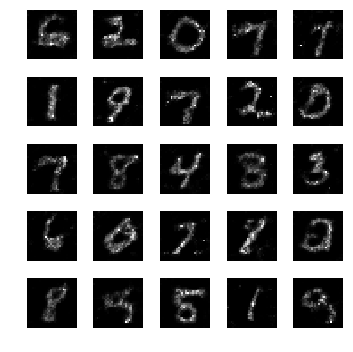

epoch: 1281, time: 5.051537 | train_G_Loss: 0.409502, train_D_loss: 2.351461, train_acc: 0.947266
cv_G_Loss: 1.989712, cv_D_loss: 4.701097, cv_acc: 0.924100

epoch: 1282, time: 5.026734 | train_G_Loss: 0.411499, train_D_loss: 2.181365, train_acc: 0.955078
cv_G_Loss: 1.425708, cv_D_loss: 3.586524, cv_acc: 0.921500

epoch: 1283, time: 5.030163 | train_G_Loss: 0.448855, train_D_loss: 2.278337, train_acc: 0.925781
cv_G_Loss: 1.148655, cv_D_loss: 3.325580, cv_acc: 0.849800

epoch: 1284, time: 5.020636 | train_G_Loss: 0.361116, train_D_loss: 2.471983, train_acc: 0.931641
cv_G_Loss: 0.294528, cv_D_loss: 2.323001, cv_acc: 0.939100

epoch: 1285, time: 5.022827 | train_G_Loss: 0.363217, train_D_loss: 2.177228, train_acc: 0.953125
cv_G_Loss: 0.216519, cv_D_loss: 2.469207, cv_acc: 0.929100

epoch: 1286, time: 5.010746 | train_G_Loss: 0.230288, train_D_loss: 2.383500, train_acc: 0.957031
cv_G_Loss: 1.202034, cv_D_loss: 3.179205, cv_acc: 0.937300

epoch: 1287, time: 5.013777 | train_G_Loss: 0.368984

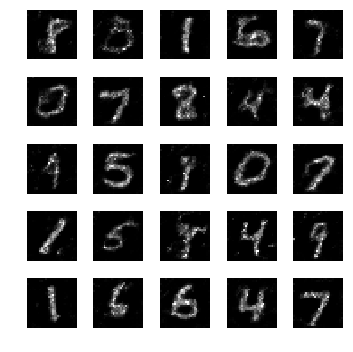

epoch: 1291, time: 5.098327 | train_G_Loss: 0.398224, train_D_loss: 2.140353, train_acc: 0.953125
cv_G_Loss: 0.253752, cv_D_loss: 2.401119, cv_acc: 0.934300

epoch: 1292, time: 5.028994 | train_G_Loss: 0.355451, train_D_loss: 2.318980, train_acc: 0.943359
cv_G_Loss: 0.224328, cv_D_loss: 2.418578, cv_acc: 0.932400

epoch: 1293, time: 5.022546 | train_G_Loss: 0.473638, train_D_loss: 2.243641, train_acc: 0.953125
cv_G_Loss: 0.724665, cv_D_loss: 2.536286, cv_acc: 0.932400

epoch: 1294, time: 5.023314 | train_G_Loss: 0.353491, train_D_loss: 2.212444, train_acc: 0.962891
cv_G_Loss: 0.637739, cv_D_loss: 2.397475, cv_acc: 0.941100

epoch: 1295, time: 5.028321 | train_G_Loss: 0.490178, train_D_loss: 2.099397, train_acc: 0.970703
cv_G_Loss: 0.508115, cv_D_loss: 2.339623, cv_acc: 0.933100

epoch: 1296, time: 5.019903 | train_G_Loss: 0.356748, train_D_loss: 2.193445, train_acc: 0.968750
cv_G_Loss: 0.604663, cv_D_loss: 2.398822, cv_acc: 0.934700

epoch: 1297, time: 5.038059 | train_G_Loss: 0.348594

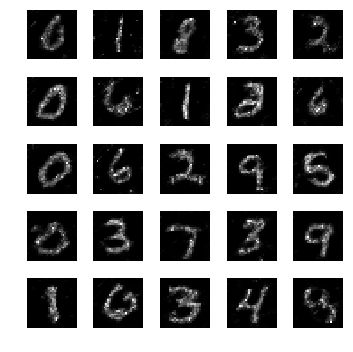

epoch: 1301, time: 5.057531 | train_G_Loss: 0.477528, train_D_loss: 2.224860, train_acc: 0.927734
cv_G_Loss: 0.259264, cv_D_loss: 2.585088, cv_acc: 0.891300

epoch: 1302, time: 5.024854 | train_G_Loss: 0.427642, train_D_loss: 2.221901, train_acc: 0.949219
cv_G_Loss: 1.537675, cv_D_loss: 3.732728, cv_acc: 0.937600

epoch: 1303, time: 5.018225 | train_G_Loss: 0.401747, train_D_loss: 2.275849, train_acc: 0.939453
cv_G_Loss: 0.456217, cv_D_loss: 2.330507, cv_acc: 0.931000

epoch: 1304, time: 5.027446 | train_G_Loss: 0.327043, train_D_loss: 2.361821, train_acc: 0.957031
cv_G_Loss: 0.746499, cv_D_loss: 2.593354, cv_acc: 0.926000

epoch: 1305, time: 5.030985 | train_G_Loss: 0.509999, train_D_loss: 2.299991, train_acc: 0.964844
cv_G_Loss: 0.835708, cv_D_loss: 2.740547, cv_acc: 0.937700

epoch: 1306, time: 5.049446 | train_G_Loss: 0.364730, train_D_loss: 2.256045, train_acc: 0.947266
cv_G_Loss: 0.515967, cv_D_loss: 2.367523, cv_acc: 0.927500

epoch: 1307, time: 5.018652 | train_G_Loss: 0.319782

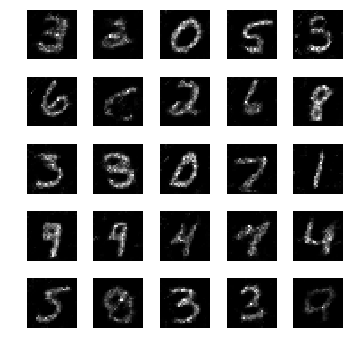

epoch: 1311, time: 5.059575 | train_G_Loss: 0.410037, train_D_loss: 2.326343, train_acc: 0.937500
cv_G_Loss: 0.569299, cv_D_loss: 2.610895, cv_acc: 0.903500

epoch: 1312, time: 5.028979 | train_G_Loss: 0.329104, train_D_loss: 2.354854, train_acc: 0.929688
cv_G_Loss: 0.565803, cv_D_loss: 2.418839, cv_acc: 0.923700

epoch: 1313, time: 5.063835 | train_G_Loss: 0.262530, train_D_loss: 2.512839, train_acc: 0.882812
cv_G_Loss: 0.236729, cv_D_loss: 2.626124, cv_acc: 0.890200

epoch: 1314, time: 5.037330 | train_G_Loss: 0.345866, train_D_loss: 2.468470, train_acc: 0.919922
cv_G_Loss: 0.246368, cv_D_loss: 2.558566, cv_acc: 0.891200

epoch: 1315, time: 5.025460 | train_G_Loss: 0.495449, train_D_loss: 2.239820, train_acc: 0.941406
cv_G_Loss: 3.733281, cv_D_loss: 7.953973, cv_acc: 0.921100

epoch: 1316, time: 5.031605 | train_G_Loss: 0.348335, train_D_loss: 2.309662, train_acc: 0.939453
cv_G_Loss: 0.642758, cv_D_loss: 2.498106, cv_acc: 0.924100

epoch: 1317, time: 5.031876 | train_G_Loss: 0.414094

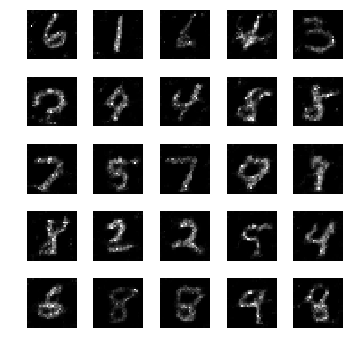

epoch: 1321, time: 5.047352 | train_G_Loss: 0.277465, train_D_loss: 2.241023, train_acc: 0.955078
cv_G_Loss: 0.651014, cv_D_loss: 3.178916, cv_acc: 0.768000

epoch: 1322, time: 5.019535 | train_G_Loss: 0.385438, train_D_loss: 2.179406, train_acc: 0.955078
cv_G_Loss: 1.952674, cv_D_loss: 4.523227, cv_acc: 0.921900

epoch: 1323, time: 5.018967 | train_G_Loss: 0.400855, train_D_loss: 2.209809, train_acc: 0.921875
cv_G_Loss: 0.481794, cv_D_loss: 2.309035, cv_acc: 0.938800

epoch: 1324, time: 5.025162 | train_G_Loss: 0.288224, train_D_loss: 2.531703, train_acc: 0.925781
cv_G_Loss: 0.215325, cv_D_loss: 2.456672, cv_acc: 0.932300

epoch: 1325, time: 5.028625 | train_G_Loss: 0.357990, train_D_loss: 2.263068, train_acc: 0.937500
cv_G_Loss: 0.596407, cv_D_loss: 2.449786, cv_acc: 0.925100

epoch: 1326, time: 5.023526 | train_G_Loss: 0.459608, train_D_loss: 2.357895, train_acc: 0.919922
cv_G_Loss: 0.438870, cv_D_loss: 2.278795, cv_acc: 0.937700

epoch: 1327, time: 5.020487 | train_G_Loss: 0.289044

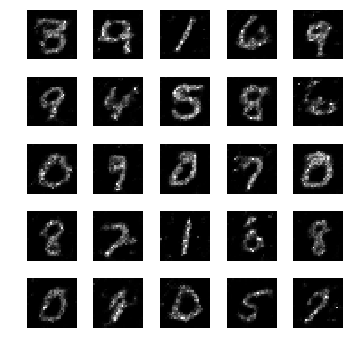

epoch: 1331, time: 5.042756 | train_G_Loss: 0.325035, train_D_loss: 2.257358, train_acc: 0.923828
cv_G_Loss: 0.306937, cv_D_loss: 2.294680, cv_acc: 0.939300

epoch: 1332, time: 5.031971 | train_G_Loss: 0.424610, train_D_loss: 2.346917, train_acc: 0.923828
cv_G_Loss: 0.429565, cv_D_loss: 2.247192, cv_acc: 0.942700
Model saved

epoch: 1333, time: 5.047451 | train_G_Loss: 0.412141, train_D_loss: 2.315382, train_acc: 0.904297
cv_G_Loss: 0.533089, cv_D_loss: 2.327466, cv_acc: 0.932500

epoch: 1334, time: 5.027982 | train_G_Loss: 0.284310, train_D_loss: 2.465811, train_acc: 0.929688
cv_G_Loss: 0.459527, cv_D_loss: 2.446621, cv_acc: 0.904500

epoch: 1335, time: 5.073026 | train_G_Loss: 0.485774, train_D_loss: 2.186467, train_acc: 0.947266
cv_G_Loss: 0.643318, cv_D_loss: 2.476745, cv_acc: 0.937200

epoch: 1336, time: 5.035500 | train_G_Loss: 0.511732, train_D_loss: 2.235103, train_acc: 0.945312
cv_G_Loss: 0.582301, cv_D_loss: 2.389456, cv_acc: 0.936200

epoch: 1337, time: 5.021600 | train_G_Lo

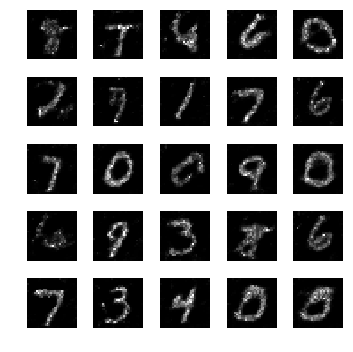

epoch: 1341, time: 5.056053 | train_G_Loss: 0.507871, train_D_loss: 2.332117, train_acc: 0.933594
cv_G_Loss: 1.744008, cv_D_loss: 4.206057, cv_acc: 0.891400

epoch: 1342, time: 5.024081 | train_G_Loss: 0.298300, train_D_loss: 2.378300, train_acc: 0.947266
cv_G_Loss: 0.118141, cv_D_loss: 2.905489, cv_acc: 0.923200

epoch: 1343, time: 5.024367 | train_G_Loss: 0.354645, train_D_loss: 2.211036, train_acc: 0.943359
cv_G_Loss: 1.190420, cv_D_loss: 3.188514, cv_acc: 0.933200

epoch: 1344, time: 5.022756 | train_G_Loss: 0.320033, train_D_loss: 2.307193, train_acc: 0.933594
cv_G_Loss: 0.165673, cv_D_loss: 2.628265, cv_acc: 0.919100

epoch: 1345, time: 5.033533 | train_G_Loss: 0.492417, train_D_loss: 2.220997, train_acc: 0.957031
cv_G_Loss: 0.851408, cv_D_loss: 2.667099, cv_acc: 0.926000

epoch: 1346, time: 5.017909 | train_G_Loss: 0.377415, train_D_loss: 2.172526, train_acc: 0.953125
cv_G_Loss: 0.314167, cv_D_loss: 2.283959, cv_acc: 0.942300

epoch: 1347, time: 5.021292 | train_G_Loss: 0.324644

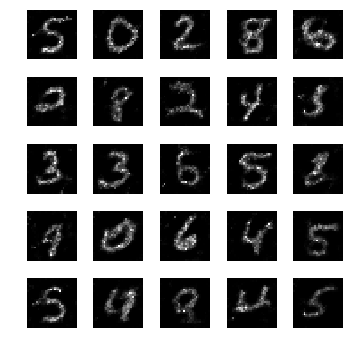

epoch: 1351, time: 5.054935 | train_G_Loss: 0.695355, train_D_loss: 2.320548, train_acc: 0.949219
cv_G_Loss: 1.828406, cv_D_loss: 4.467407, cv_acc: 0.883900

epoch: 1352, time: 5.021793 | train_G_Loss: 0.422264, train_D_loss: 2.297666, train_acc: 0.949219
cv_G_Loss: 0.378379, cv_D_loss: 2.307237, cv_acc: 0.937400

epoch: 1353, time: 5.038108 | train_G_Loss: 0.326279, train_D_loss: 2.265233, train_acc: 0.947266
cv_G_Loss: 0.445967, cv_D_loss: 2.384503, cv_acc: 0.927300

epoch: 1354, time: 5.036493 | train_G_Loss: 0.368589, train_D_loss: 2.217107, train_acc: 0.921875
cv_G_Loss: 0.284793, cv_D_loss: 2.347057, cv_acc: 0.934500

epoch: 1355, time: 5.028536 | train_G_Loss: 0.390111, train_D_loss: 2.357638, train_acc: 0.937500
cv_G_Loss: 2.300534, cv_D_loss: 5.066473, cv_acc: 0.934400

epoch: 1356, time: 5.032494 | train_G_Loss: 0.395681, train_D_loss: 2.143851, train_acc: 0.957031
cv_G_Loss: 1.053436, cv_D_loss: 2.924720, cv_acc: 0.936900

epoch: 1357, time: 5.040782 | train_G_Loss: 0.407236

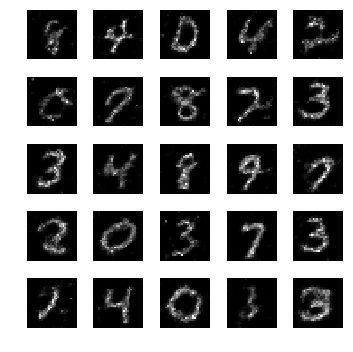

epoch: 1361, time: 5.064984 | train_G_Loss: 0.422105, train_D_loss: 2.326768, train_acc: 0.935547
cv_G_Loss: 1.111122, cv_D_loss: 3.057687, cv_acc: 0.927400

epoch: 1362, time: 5.025977 | train_G_Loss: 0.374786, train_D_loss: 2.199335, train_acc: 0.957031
cv_G_Loss: 0.300433, cv_D_loss: 2.360218, cv_acc: 0.929900

epoch: 1363, time: 5.034256 | train_G_Loss: 0.447015, train_D_loss: 2.166641, train_acc: 0.953125
cv_G_Loss: 0.395651, cv_D_loss: 2.295070, cv_acc: 0.940300

epoch: 1364, time: 5.036385 | train_G_Loss: 0.407710, train_D_loss: 2.282560, train_acc: 0.941406
cv_G_Loss: 0.138657, cv_D_loss: 2.798194, cv_acc: 0.908500

epoch: 1365, time: 5.027739 | train_G_Loss: 0.335409, train_D_loss: 2.307877, train_acc: 0.933594
cv_G_Loss: 0.367390, cv_D_loss: 2.322233, cv_acc: 0.926800

epoch: 1366, time: 5.026962 | train_G_Loss: 0.383557, train_D_loss: 2.237926, train_acc: 0.931641
cv_G_Loss: 0.964220, cv_D_loss: 2.831247, cv_acc: 0.922300

epoch: 1367, time: 5.030170 | train_G_Loss: 0.473301

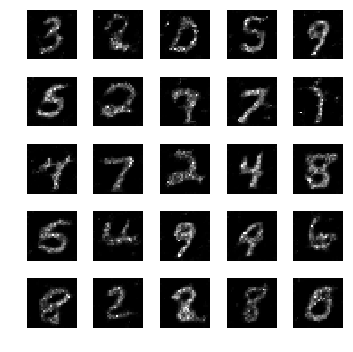

epoch: 1371, time: 5.056837 | train_G_Loss: 0.356217, train_D_loss: 2.167387, train_acc: 0.951172
cv_G_Loss: 0.790770, cv_D_loss: 2.687285, cv_acc: 0.908000

epoch: 1372, time: 5.036066 | train_G_Loss: 0.367367, train_D_loss: 2.302698, train_acc: 0.951172
cv_G_Loss: 0.296032, cv_D_loss: 2.373005, cv_acc: 0.928100

epoch: 1373, time: 5.030195 | train_G_Loss: 0.459208, train_D_loss: 2.176122, train_acc: 0.927734
cv_G_Loss: 0.348618, cv_D_loss: 2.387687, cv_acc: 0.920200

epoch: 1374, time: 5.038368 | train_G_Loss: 0.340550, train_D_loss: 2.434652, train_acc: 0.923828
cv_G_Loss: 1.900489, cv_D_loss: 4.384660, cv_acc: 0.927800

epoch: 1375, time: 5.030269 | train_G_Loss: 0.351829, train_D_loss: 2.352086, train_acc: 0.939453
cv_G_Loss: 0.640891, cv_D_loss: 2.474426, cv_acc: 0.921100

epoch: 1376, time: 5.031083 | train_G_Loss: 0.438787, train_D_loss: 2.388638, train_acc: 0.927734
cv_G_Loss: 1.432585, cv_D_loss: 3.579700, cv_acc: 0.934200

epoch: 1377, time: 5.040621 | train_G_Loss: 0.280889

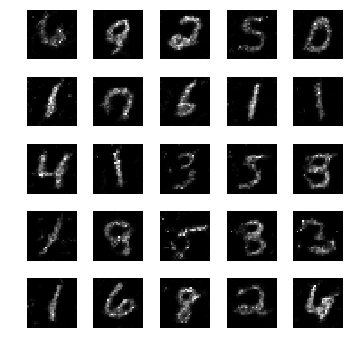

epoch: 1381, time: 5.058518 | train_G_Loss: 0.337406, train_D_loss: 2.325814, train_acc: 0.945312
cv_G_Loss: 0.528938, cv_D_loss: 2.451071, cv_acc: 0.910400

epoch: 1382, time: 5.023078 | train_G_Loss: 0.350939, train_D_loss: 2.260598, train_acc: 0.931641
cv_G_Loss: 0.654674, cv_D_loss: 2.401509, cv_acc: 0.939800

epoch: 1383, time: 5.024858 | train_G_Loss: 0.387479, train_D_loss: 2.343313, train_acc: 0.943359
cv_G_Loss: 0.343394, cv_D_loss: 2.278618, cv_acc: 0.940900

epoch: 1384, time: 5.020600 | train_G_Loss: 0.335360, train_D_loss: 2.214821, train_acc: 0.935547
cv_G_Loss: 0.427742, cv_D_loss: 2.261154, cv_acc: 0.939700

epoch: 1385, time: 5.040875 | train_G_Loss: 0.318077, train_D_loss: 2.387845, train_acc: 0.910156
cv_G_Loss: 0.513647, cv_D_loss: 2.332063, cv_acc: 0.939400

epoch: 1386, time: 5.036267 | train_G_Loss: 0.441226, train_D_loss: 2.367708, train_acc: 0.935547
cv_G_Loss: 0.405089, cv_D_loss: 2.294307, cv_acc: 0.932500

epoch: 1387, time: 5.035764 | train_G_Loss: 0.394977

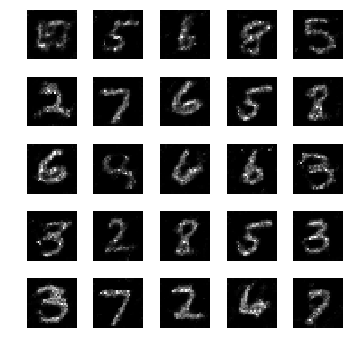

epoch: 1391, time: 5.059323 | train_G_Loss: 0.473292, train_D_loss: 2.240366, train_acc: 0.927734
cv_G_Loss: 0.534378, cv_D_loss: 2.332060, cv_acc: 0.932600

epoch: 1392, time: 5.040491 | train_G_Loss: 0.399241, train_D_loss: 2.279827, train_acc: 0.929688
cv_G_Loss: 0.765147, cv_D_loss: 2.581801, cv_acc: 0.934700

epoch: 1393, time: 5.029347 | train_G_Loss: 0.321883, train_D_loss: 2.339513, train_acc: 0.917969
cv_G_Loss: 0.462406, cv_D_loss: 2.307986, cv_acc: 0.941300

epoch: 1394, time: 5.035755 | train_G_Loss: 0.369183, train_D_loss: 2.397234, train_acc: 0.923828
cv_G_Loss: 0.269098, cv_D_loss: 2.349379, cv_acc: 0.937800

epoch: 1395, time: 5.041773 | train_G_Loss: 0.497116, train_D_loss: 2.347096, train_acc: 0.960938
cv_G_Loss: 0.526150, cv_D_loss: 2.297498, cv_acc: 0.946300
Model saved

epoch: 1396, time: 5.050762 | train_G_Loss: 0.413358, train_D_loss: 2.197530, train_acc: 0.943359
cv_G_Loss: 0.691337, cv_D_loss: 2.440998, cv_acc: 0.942600

epoch: 1397, time: 5.030416 | train_G_Lo

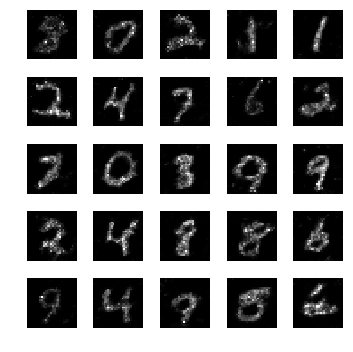

epoch: 1401, time: 5.111168 | train_G_Loss: 0.502404, train_D_loss: 2.335297, train_acc: 0.927734
cv_G_Loss: 0.693405, cv_D_loss: 2.790264, cv_acc: 0.893900

epoch: 1402, time: 5.034782 | train_G_Loss: 0.386731, train_D_loss: 2.277173, train_acc: 0.933594
cv_G_Loss: 0.220150, cv_D_loss: 2.382259, cv_acc: 0.940100

epoch: 1403, time: 5.047513 | train_G_Loss: 0.308988, train_D_loss: 2.259105, train_acc: 0.945312
cv_G_Loss: 0.278815, cv_D_loss: 2.302069, cv_acc: 0.945800

epoch: 1404, time: 5.045840 | train_G_Loss: 0.420241, train_D_loss: 2.236647, train_acc: 0.951172
cv_G_Loss: 0.322530, cv_D_loss: 2.297188, cv_acc: 0.945200

epoch: 1405, time: 5.026159 | train_G_Loss: 0.457254, train_D_loss: 2.184259, train_acc: 0.943359
cv_G_Loss: 0.871352, cv_D_loss: 3.038446, cv_acc: 0.864900

epoch: 1406, time: 5.140873 | train_G_Loss: 0.296366, train_D_loss: 2.357791, train_acc: 0.931641
cv_G_Loss: 0.314010, cv_D_loss: 2.527287, cv_acc: 0.891900

epoch: 1407, time: 5.036019 | train_G_Loss: 0.484701

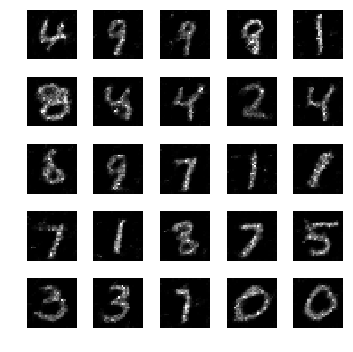

epoch: 1411, time: 5.073085 | train_G_Loss: 0.381006, train_D_loss: 2.354096, train_acc: 0.925781
cv_G_Loss: 0.473122, cv_D_loss: 2.439795, cv_acc: 0.924600

epoch: 1412, time: 5.030795 | train_G_Loss: 0.354557, train_D_loss: 2.275664, train_acc: 0.960938
cv_G_Loss: 0.112698, cv_D_loss: 2.825794, cv_acc: 0.933600

epoch: 1413, time: 5.038764 | train_G_Loss: 0.422844, train_D_loss: 2.238369, train_acc: 0.945312
cv_G_Loss: 0.539799, cv_D_loss: 2.350590, cv_acc: 0.934300

epoch: 1414, time: 5.031088 | train_G_Loss: 0.414245, train_D_loss: 2.273674, train_acc: 0.937500
cv_G_Loss: 0.454853, cv_D_loss: 2.275941, cv_acc: 0.940500

epoch: 1415, time: 5.045823 | train_G_Loss: 0.322715, train_D_loss: 2.251231, train_acc: 0.953125
cv_G_Loss: 0.301123, cv_D_loss: 2.512251, cv_acc: 0.901900

epoch: 1416, time: 5.038239 | train_G_Loss: 0.359557, train_D_loss: 2.236343, train_acc: 0.935547
cv_G_Loss: 0.114496, cv_D_loss: 2.906430, cv_acc: 0.910900

epoch: 1417, time: 5.038277 | train_G_Loss: 0.380771

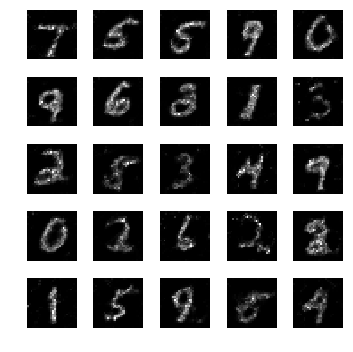

epoch: 1421, time: 5.077243 | train_G_Loss: 0.438891, train_D_loss: 2.233942, train_acc: 0.953125
cv_G_Loss: 0.499922, cv_D_loss: 2.289127, cv_acc: 0.945300

epoch: 1422, time: 5.041474 | train_G_Loss: 0.507035, train_D_loss: 2.215308, train_acc: 0.937500
cv_G_Loss: 0.970711, cv_D_loss: 2.811581, cv_acc: 0.942900

epoch: 1423, time: 5.078712 | train_G_Loss: 0.338591, train_D_loss: 2.291032, train_acc: 0.921875
cv_G_Loss: 0.334378, cv_D_loss: 2.299454, cv_acc: 0.939300

epoch: 1424, time: 5.047850 | train_G_Loss: 0.298907, train_D_loss: 2.432555, train_acc: 0.925781
cv_G_Loss: 0.219757, cv_D_loss: 2.411738, cv_acc: 0.943900

epoch: 1425, time: 5.049301 | train_G_Loss: 0.413460, train_D_loss: 2.219494, train_acc: 0.951172
cv_G_Loss: 0.250507, cv_D_loss: 2.442425, cv_acc: 0.929000

epoch: 1426, time: 5.041277 | train_G_Loss: 0.453321, train_D_loss: 2.246178, train_acc: 0.927734
cv_G_Loss: 0.149315, cv_D_loss: 2.696959, cv_acc: 0.928400

epoch: 1427, time: 5.048061 | train_G_Loss: 0.423417

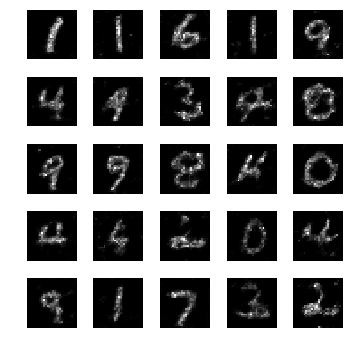

epoch: 1431, time: 5.071967 | train_G_Loss: 0.404323, train_D_loss: 2.189631, train_acc: 0.953125
cv_G_Loss: 0.303702, cv_D_loss: 2.319057, cv_acc: 0.934300

epoch: 1432, time: 5.040239 | train_G_Loss: 0.376642, train_D_loss: 2.282242, train_acc: 0.951172
cv_G_Loss: 0.353491, cv_D_loss: 2.330651, cv_acc: 0.935700

epoch: 1433, time: 5.032849 | train_G_Loss: 0.406884, train_D_loss: 2.263171, train_acc: 0.943359
cv_G_Loss: 0.452603, cv_D_loss: 2.247721, cv_acc: 0.946600
Model saved

epoch: 1434, time: 5.071750 | train_G_Loss: 0.462281, train_D_loss: 2.253624, train_acc: 0.958984
cv_G_Loss: 1.240622, cv_D_loss: 3.176810, cv_acc: 0.939200

epoch: 1435, time: 5.049160 | train_G_Loss: 0.379873, train_D_loss: 2.125412, train_acc: 0.943359
cv_G_Loss: 0.379662, cv_D_loss: 2.235801, cv_acc: 0.946900
Model saved

epoch: 1436, time: 5.065549 | train_G_Loss: 0.371107, train_D_loss: 2.312977, train_acc: 0.923828
cv_G_Loss: 1.597674, cv_D_loss: 3.809862, cv_acc: 0.932400

epoch: 1437, time: 5.036164 

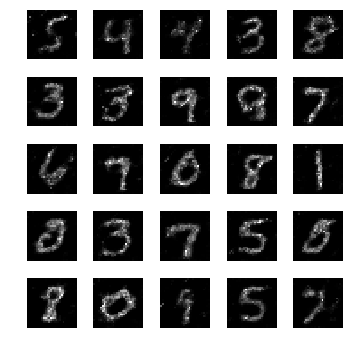

epoch: 1441, time: 5.075720 | train_G_Loss: 0.343309, train_D_loss: 2.369246, train_acc: 0.933594
cv_G_Loss: 0.715734, cv_D_loss: 2.528008, cv_acc: 0.939200

epoch: 1442, time: 5.033423 | train_G_Loss: 0.450183, train_D_loss: 2.182154, train_acc: 0.941406
cv_G_Loss: 0.782547, cv_D_loss: 2.569067, cv_acc: 0.947000
Model saved

epoch: 1443, time: 5.064366 | train_G_Loss: 0.339480, train_D_loss: 2.172692, train_acc: 0.931641
cv_G_Loss: 0.694673, cv_D_loss: 2.503541, cv_acc: 0.936600

epoch: 1444, time: 5.036366 | train_G_Loss: 0.336214, train_D_loss: 2.486771, train_acc: 0.914062
cv_G_Loss: 0.262226, cv_D_loss: 2.346749, cv_acc: 0.941200

epoch: 1445, time: 5.075254 | train_G_Loss: 0.353278, train_D_loss: 2.294427, train_acc: 0.933594
cv_G_Loss: 0.592428, cv_D_loss: 2.423456, cv_acc: 0.940300

epoch: 1446, time: 5.053299 | train_G_Loss: 0.409764, train_D_loss: 2.171420, train_acc: 0.935547
cv_G_Loss: 1.270893, cv_D_loss: 3.417838, cv_acc: 0.932900

epoch: 1447, time: 5.030604 | train_G_Lo

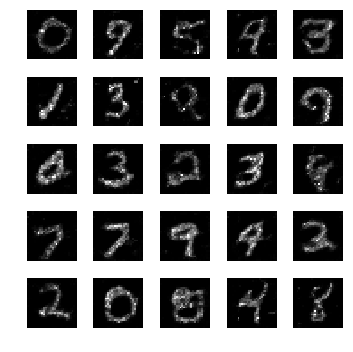

epoch: 1451, time: 5.062426 | train_G_Loss: 0.436368, train_D_loss: 2.185174, train_acc: 0.912109
cv_G_Loss: 0.264036, cv_D_loss: 2.366768, cv_acc: 0.936700

epoch: 1452, time: 5.047619 | train_G_Loss: 0.406251, train_D_loss: 2.398790, train_acc: 0.941406
cv_G_Loss: 0.246988, cv_D_loss: 2.341295, cv_acc: 0.945800

epoch: 1453, time: 5.031430 | train_G_Loss: 0.414275, train_D_loss: 2.443929, train_acc: 0.929688
cv_G_Loss: 1.812629, cv_D_loss: 4.499570, cv_acc: 0.910200

epoch: 1454, time: 5.047936 | train_G_Loss: 0.346060, train_D_loss: 2.366846, train_acc: 0.919922
cv_G_Loss: 0.866783, cv_D_loss: 2.633989, cv_acc: 0.941600

epoch: 1455, time: 5.052985 | train_G_Loss: 0.328222, train_D_loss: 2.285146, train_acc: 0.927734
cv_G_Loss: 0.918115, cv_D_loss: 2.748657, cv_acc: 0.937500

epoch: 1456, time: 5.044457 | train_G_Loss: 0.393699, train_D_loss: 2.271931, train_acc: 0.943359
cv_G_Loss: 0.975426, cv_D_loss: 2.863899, cv_acc: 0.937100

epoch: 1457, time: 5.042953 | train_G_Loss: 0.474846

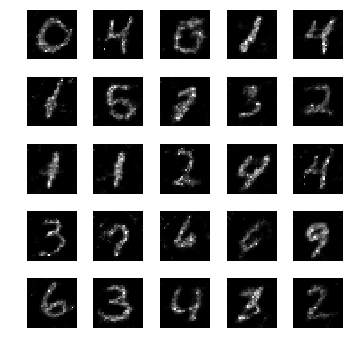

epoch: 1461, time: 5.127299 | train_G_Loss: 0.391391, train_D_loss: 2.201342, train_acc: 0.958984
cv_G_Loss: 0.905998, cv_D_loss: 2.692176, cv_acc: 0.942900

epoch: 1462, time: 5.096953 | train_G_Loss: 0.358788, train_D_loss: 2.148780, train_acc: 0.910156
cv_G_Loss: 0.170187, cv_D_loss: 2.609673, cv_acc: 0.931700

epoch: 1463, time: 5.090496 | train_G_Loss: 0.493867, train_D_loss: 2.498043, train_acc: 0.923828
cv_G_Loss: 1.240250, cv_D_loss: 3.341389, cv_acc: 0.930200

epoch: 1464, time: 5.080883 | train_G_Loss: 0.433183, train_D_loss: 2.239669, train_acc: 0.951172
cv_G_Loss: 3.097602, cv_D_loss: 6.754119, cv_acc: 0.903800

epoch: 1465, time: 5.090641 | train_G_Loss: 0.383375, train_D_loss: 2.143536, train_acc: 0.935547
cv_G_Loss: 0.646276, cv_D_loss: 2.449651, cv_acc: 0.939000

epoch: 1466, time: 5.087730 | train_G_Loss: 0.297106, train_D_loss: 2.213984, train_acc: 0.943359
cv_G_Loss: 0.356922, cv_D_loss: 2.257100, cv_acc: 0.945900

epoch: 1467, time: 5.122211 | train_G_Loss: 0.402447

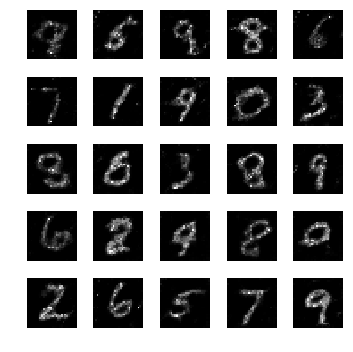

epoch: 1471, time: 5.134885 | train_G_Loss: 0.369600, train_D_loss: 2.110648, train_acc: 0.964844
cv_G_Loss: 1.308549, cv_D_loss: 3.352768, cv_acc: 0.933100

epoch: 1472, time: 5.113600 | train_G_Loss: 0.389232, train_D_loss: 2.182562, train_acc: 0.949219
cv_G_Loss: 1.682840, cv_D_loss: 3.993481, cv_acc: 0.936300

epoch: 1473, time: 5.090098 | train_G_Loss: 0.431116, train_D_loss: 2.219559, train_acc: 0.960938
cv_G_Loss: 1.179590, cv_D_loss: 3.207053, cv_acc: 0.935400

epoch: 1474, time: 5.093013 | train_G_Loss: 0.370530, train_D_loss: 2.170754, train_acc: 0.964844
cv_G_Loss: 1.945277, cv_D_loss: 4.481505, cv_acc: 0.915100

epoch: 1475, time: 5.110032 | train_G_Loss: 0.272849, train_D_loss: 2.317677, train_acc: 0.949219
cv_G_Loss: 0.915486, cv_D_loss: 2.721683, cv_acc: 0.932500

epoch: 1476, time: 5.090714 | train_G_Loss: 0.367449, train_D_loss: 2.147331, train_acc: 0.960938
cv_G_Loss: 0.308322, cv_D_loss: 2.354958, cv_acc: 0.938200

epoch: 1477, time: 5.094452 | train_G_Loss: 0.335503

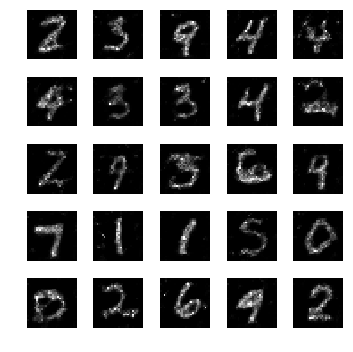

epoch: 1481, time: 5.067495 | train_G_Loss: 0.438928, train_D_loss: 2.054574, train_acc: 0.968750
cv_G_Loss: 0.165510, cv_D_loss: 2.551183, cv_acc: 0.942000

epoch: 1482, time: 5.027761 | train_G_Loss: 0.416002, train_D_loss: 2.099579, train_acc: 0.980469
cv_G_Loss: 0.642734, cv_D_loss: 2.439877, cv_acc: 0.942400

epoch: 1483, time: 5.043859 | train_G_Loss: 0.523111, train_D_loss: 2.253938, train_acc: 0.986328
cv_G_Loss: 1.099825, cv_D_loss: 3.146144, cv_acc: 0.928900

epoch: 1484, time: 5.037345 | train_G_Loss: 0.420405, train_D_loss: 2.076452, train_acc: 0.968750
cv_G_Loss: 0.670520, cv_D_loss: 2.433692, cv_acc: 0.940000

epoch: 1485, time: 5.038554 | train_G_Loss: 0.322950, train_D_loss: 2.374578, train_acc: 0.951172
cv_G_Loss: 0.205833, cv_D_loss: 2.552358, cv_acc: 0.923300

epoch: 1486, time: 5.049756 | train_G_Loss: 0.372057, train_D_loss: 2.400019, train_acc: 0.947266
cv_G_Loss: 0.221397, cv_D_loss: 2.491932, cv_acc: 0.922600

epoch: 1487, time: 5.035615 | train_G_Loss: 0.366450

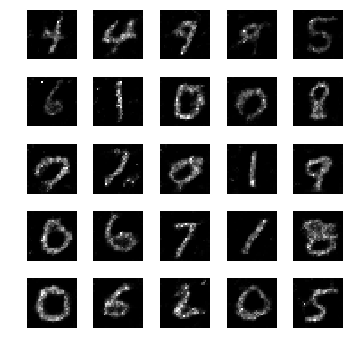

epoch: 1491, time: 5.101679 | train_G_Loss: 0.411763, train_D_loss: 2.164933, train_acc: 0.968750
cv_G_Loss: 1.218874, cv_D_loss: 3.216077, cv_acc: 0.929500

epoch: 1492, time: 5.068466 | train_G_Loss: 0.432377, train_D_loss: 2.269623, train_acc: 0.937500
cv_G_Loss: 1.207034, cv_D_loss: 3.180675, cv_acc: 0.943300

epoch: 1493, time: 5.079108 | train_G_Loss: 0.474203, train_D_loss: 2.233382, train_acc: 0.933594
cv_G_Loss: 0.520818, cv_D_loss: 2.286123, cv_acc: 0.936600

epoch: 1494, time: 5.060801 | train_G_Loss: 0.416868, train_D_loss: 2.243016, train_acc: 0.929688
cv_G_Loss: 0.781407, cv_D_loss: 2.957258, cv_acc: 0.861400

epoch: 1495, time: 5.063060 | train_G_Loss: 0.354198, train_D_loss: 2.327708, train_acc: 0.947266
cv_G_Loss: 0.470479, cv_D_loss: 2.268032, cv_acc: 0.945500

epoch: 1496, time: 5.061224 | train_G_Loss: 0.466667, train_D_loss: 2.171325, train_acc: 0.951172
cv_G_Loss: 0.908387, cv_D_loss: 2.853400, cv_acc: 0.925500

epoch: 1497, time: 5.059170 | train_G_Loss: 0.379883

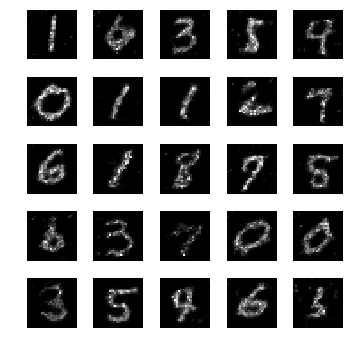

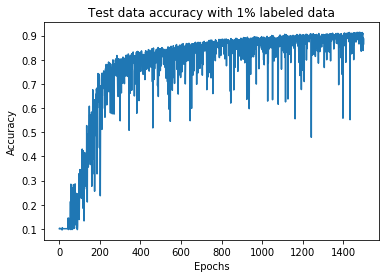

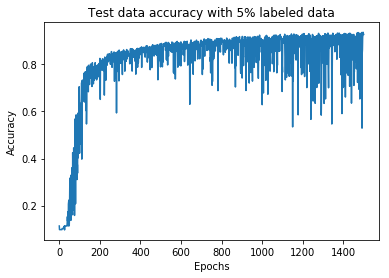

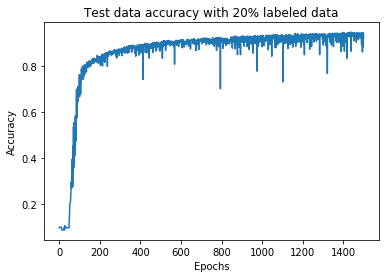

In [20]:
fractions = [0.01, 0.05, 0.2]
losses = []
for fraction in fractions:
    labeled_rate = fraction
    loss_acc = train_SSL_GAN(512, 1501)
    losses.append(loss_acc)

for i, loss in enumerate(losses):
    plt.figure(figsize=(10,10))
    plt.plot(loss[5])
    plt.title("Test data accuracy with %d%% labeled data" % (int(fractions[i]*100)))
    plt.xlabel("Epochs")
    plt.ylabel("Accuracy")
    plt.savefig("Plot_%.2f.png" % fractions[i])
    
for i, loss in enumerate(losses):
    print("Best accuracy for %d%% labeled data: %.3f" % (int(fractions[i]*100), np.max(loss[-1])))

In [22]:
for i, loss in enumerate(losses):
    print("Best accuracy for %d%% labeled data: %.3f" % (int(fractions[i]*100), np.max(loss[-1])))

Best accuracy for 1% labeled data: 0.914
Best accuracy for 5% labeled data: 0.936
Best accuracy for 20% labeled data: 0.947


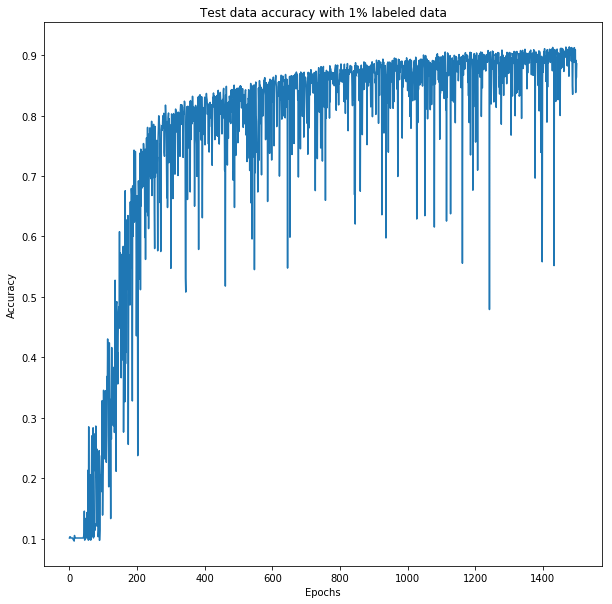

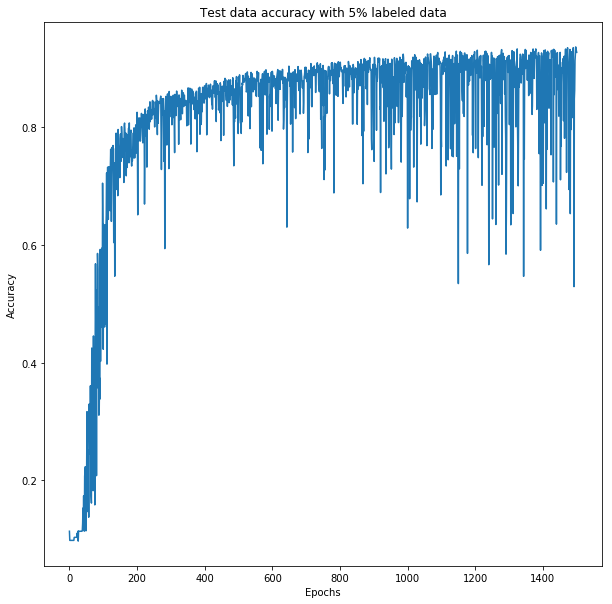

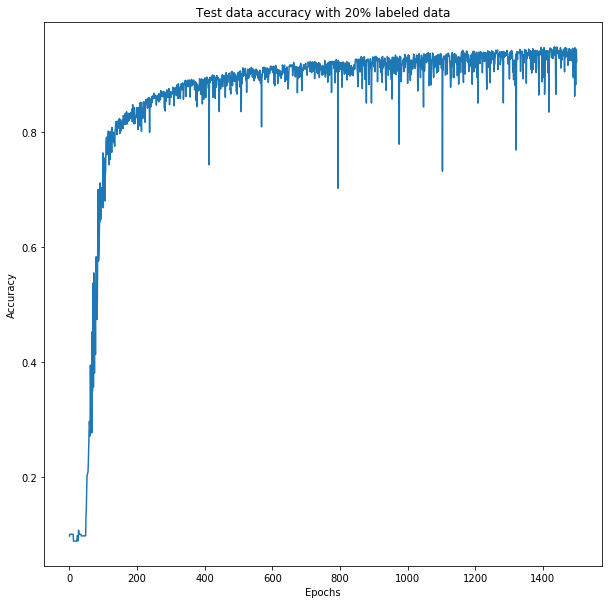

In [26]:
for i, loss in enumerate(losses):
    plt.figure(figsize=(10,10))
    plt.plot(loss[5])
    plt.title("Test data accuracy with %d%% labeled data" % (int(fractions[i]*100)))
    plt.xlabel("Epochs")
    plt.ylabel("Accuracy")
    plt.savefig("Plot_%.2f.png" % fractions[i])

In [27]:
print(losses)

[([4.772695, 4.072649, 3.5055995, 3.2447388, 2.9376569, 2.9917727, 2.7202425, 2.5598397, 2.5745077, 2.5863433, 2.463457, 2.4590085, 2.6082296, 2.397247, 2.5386682, 2.303018, 2.3779917, 2.4324892, 2.4716146, 2.4168315, 2.493832, 2.3200178, 2.2956817, 2.38439, 2.365979, 2.4248548, 2.357767, 2.2647998, 2.3866615, 2.4366043, 2.5493534, 2.40828, 2.3953876, 2.4756513, 2.5572784, 2.6495926, 2.6631212, 2.6657019, 2.8075361, 2.844002, 2.906787, 2.8697739, 2.9892023, 3.016481, 3.076643, 3.1803648, 3.332755, 3.4461174, 3.3747969, 3.485568, 3.534264, 3.4621546, 3.5344534, 3.7061007, 3.719521, 3.7029846, 3.760892, 3.7863412, 3.7663693, 3.7682822, 3.7151396, 3.7691255, 3.970217, 3.8908863, 4.092052, 3.9343443, 3.916492, 4.1729765, 3.8703554, 3.9231396, 3.9846563, 3.9650774, 3.8375535, 3.943161, 4.030421, 3.8427176, 3.8519018, 4.0366173, 3.9855154, 4.0618563, 4.108312, 4.048328, 4.1471148, 3.8725631, 4.135356, 4.0067077, 4.14219, 4.1728644, 4.1001415, 4.2593412, 4.019867, 4.088571, 4.090353, 4.106011